# Plotting the results of simulated outbreaks on networks after targeted immunization strategies were implemented with incomplete network data

- Since the actual simulations are so computationally intensive, it is not feasible for all code for this project to be presented in Jupyter notebooks


- However, when creating many plots which are similar but different in subtle aspects and require multiple rounds of individualized tweaking and re-plotting, Jupyter can help expedite that process


- Plus, with so many similar plots, the readability of the code which makes them depends largely on the narrative of the thread through them, which can be expressed more easily with the accessible visual storytelling of Jupyter Notebooks


- The call this paper was answering specifically requested "Authors are encouraged to provide executable documents, where applicable, such as a Jupyter Notebook or an RMarkdown." https://collections.plos.org/s/mathematical-disease-dynamics

# This notebook contains the code used to create nearly every visualization in our paper and in the Supplementary Information document

## The only visualizations which are *not* reproduced in this document are:
- Fig 1. (i) and (iii) 
    because they used the edge lists of the true  Colorado Springs network and one of the true Add Health networks and  it is unclear at this point whether we are allowed to share this data. If we  find out we are so we will add that plotting here and those edgelists, or at least their degree distributions to the data/ folder
    
    
- Fig 1. (ii) and (iii) because these were created manually using Gephi



### Before we get started lets import what we need:

In [2]:
import scipy
from scipy.io import loadmat
import numpy as np
# import networkx as nx
# import statistics
import scipy.stats



import matplotlib.pyplot as plt
# import operator


import pandas as pd
# from collections import defaultdict as dd
# from mpl_toolkits.mplot3d import Axes3D



# import itertools
# import csv

import time

import collections



# import os
import glob

# import time
# from PIL import Image

import ast

## Now lets set some constants that are going to be used throughout

In [3]:
arrowWidth = 0.42
gamma = 1.0

# Unless otherwise specified, we are going to want to plot all strategies every time in this same order
strategies = [ "Bet",   "DegKK",      "Srd" ,      "acqKK2", "acqKG2", "acqKG2_up", "acqGG2"]

# We want to be consistent the the color and shape represntation of each strategy regardless of the figure so we set that up here

stratColorMap =  {'RandSamp':'#1f77b4', 'Bet':'#ff7f0e', 'DegKK':'#2ca02c', "Srd":'#d62728',
                  "acqKK2":'#9467bd', "acqKG2":'#8c564b', "acqKG2_up":'#e377c2', "acqGG2":'#7f7f7f'}
# Also we set it up so that the pairs of strategies we compare the most have shapes that mirror each other in some way
# stratMarkerMap = {'Bet': 'd', 'DegKK':'*', "Srd":'p', "acqKK2":'>', "acqKG2":'<', "acqKG2_up":"^", "acqGG2":"v"}

# The above is a better mapping and the one we were planning on using but somehwere along  the way everything got offset and the paper was accepted without us noticing the tick marks werent the shapes we wanted. Ah well
# This is  the mapping  used in the paper
stratMarkerMap = {'Bet': 'p', 'DegKK':'h', "Srd":'v', "acqKK2":'^', "acqKG2":'*', "acqKG2_up":"d", "acqGG2":"<"}




# mapping from the name of each strategy used in the simulation code to how we want it to be displayed in the figures
stratNameMap = { 'RandSamp':'Rand','Bet':'Bet', 'DegKK':"Deg","Srd":"S.R.D.", "acqKK2":"Acq($G^\prime, G^\prime$)", "acqGG2":"Acq($G, G$)", "acqKG2":"Acq($G^\prime,G$)", "acqKG2_up":"Acq($\overline{G},G$)"}

# we will be storing all our figures in one folder that is in the same directory we are so nothing fancy here
# In the future maybe store subfigures together in subfolders
OUTDIR = 'figures/' 


#all our data is stored in data/results/{subfolder}

INDIR = 'data/results/'



### Now we make some utility functions to help us along the way

In [4]:

# Why dont I just use str.replace?
def pointify(floatVal):
    """  convert all floats to strings with the decimal points ('.') replaced with 'pt'
    
    Overleaf specifically does not allow decimal points in the file names of figures

    
    """
    
    strWithDecimal = str(floatVal)
    
    
    newStr = ''
    for char in strWithDecimal:
        if char != '.':
            newStr+=char
        elif char == '.':
            newStr += 'pt'
    return newStr
 

###  Many of the figures in both our paper and supplement  follow the  same general plotting schema, which evolved slowly from a simple line plot (these evolutions are apparent from the function name)

Since we are using the same, somewhat complicated figure to analyze so many different results, we made it quite flexible. To understand all the arguments, we figured it would be best to be able to scroll back up here and see it whenever needed

In [5]:
from matplotlib.transforms import Transform
from matplotlib.ticker import (
    AutoLocator, AutoMinorLocator)

def makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation(figFileName ,  folderName , title,  legendLoc, yLims, beta , gamma, pctImmunized, text_y='auto', extension='.pdf' ):

    
    path = INDIR+ folderName
    
    all_filenames = [i for i in glob.glob(path+'/*Beta={}Gamma={}*pctsImmunized{}.csv'.format(str(beta), str(gamma), str(pctImmunized)))]
    
#     cols = list(pd.read_csv(all_filenames[0], nrows =1))
#     colsWeWant = [i for i in cols if i != 'finalSizeDist']

#     obsDF = pd.concat([pd.read_csv(f, usecols=colsWeWant) for f in all_filenames ], sort=False)
    
    obsDF =  pd.concat([pd.read_csv(f, usecols = ['strategy', 'fracMissing', 'pctImmunized', 'beta',  'gamma', 'pctTotalPopInf', 'R0_empirical']) for f in all_filenames ], sort=False)

    


    plt.rcParams['text.usetex'] = True
    plt.rcParams.update({'font.size': 11})

    obsDFmean = obsDF.groupby(['strategy', 'fracMissing', 'pctImmunized', 'beta', 'gamma'], as_index=False).mean()

    randObs =  obsDFmean.loc[(obsDFmean['strategy']=="RandSamp")&(obsDFmean['pctImmunized']==pctImmunized)&(obsDFmean['beta']==beta)&(obsDFmean['gamma']==gamma)]
    randDist = randObs['pctTotalPopInf'].values
    randMean = 100*np.mean(randDist)
    
    noImmObs =  obsDFmean.loc[(obsDFmean['strategy']=="No_imm")&(obsDFmean['pctImmunized']==pctImmunized)&(obsDFmean['beta']==beta)&(obsDFmean['gamma']==gamma)]
    noImmDist = noImmObs['pctTotalPopInf'].values
    noImmMean = 100*np.mean(noImmDist) #Pool these to get a more accurate value for no_immunization
    
    
    # For convenience, since we only reported the estimated R0 values for every plot we showed in the main text,
    #   we just printed it out with the plot and added them at the same time
    #
    # an estimate of R0 was assessed on each of the 5000 networks used for each of combo of network-type, beta, gamma
    #  by running just the beginning of an outbreak simulation 10,000 times for each of these networks for each of these combinations
    #  here we take the mean of those 5000 estimated R0 values (which differ because the networks differ slightly within the same type)
    # Since R0 is already a mean by definition, then this is the R0 value for that network type and parameter combination in general
    # However, in some cases, the distributions of these individually estimated R0s were pretty varied within a given network-type, param set combo
    # and the values were often very different from analytic estimates of R0 using the formula R0 ~= (beta/(beta+gamma)) * (avg_excess_degree/avg_degree - 1) or the similar estimation formula used in Salathé and Jones (2010) (beta/(gamma)) * (avg_excess_degree/avg_degree - 1)  [note these two formulas converge when beta << gamma]
    # Since we were reporting R0 not for direct use but only to give readers familiar with R0 but not with this type of simulation a way to anchor their understanding,
    #  some variation in the distributions of these R0s for individual network-paramter set combos is not an issue
    #  However, if a future reader/user wishes to use these values for any purpose more than simple understanding, 
    #  they should watch out for high variance, heteroscedasticity, or multimodality in the distributions of the network-individual R0 estimations
    #  as these may be a sign that the mean R0 is either not a meaningful value,
    #   or even possibly that this ensemble of networks varies so widely or weirdly in its outbreak scenarios that it should not be considered as a single ensemble
    R0_emp = float(np.mean(obsDF['R0_empirical'].values))

    print("Mean Pct Infected with No Immunization: ", format(noImmMean, '0.2f'))
    print("Mean Pct Infected with Random Immunization: ", format(randMean, '0.2f'))
    print("Mean R0: ",format(R0_emp, '0.2f'))


    for strat in strategies:
            totalTrials = len(obsDF.loc[(obsDF['strategy']==strat)&(obsDF['fracMissing']==0.0)&(obsDF['pctImmunized']==pctImmunized)&(obsDF['beta']==beta)&(obsDF['gamma']==gamma)])
            
            print('trials for strategy ', strat, ': ', totalTrials) 

    
    


    
    
    
    
    fig, ax = plt.subplots(figsize=(7, 5), constrained_layout=True)

    
    minLineAboveText = 9999 #start with a big number
    for i, strat in enumerate(strategies):
        #print(strat)

        relevantObs = obsDFmean.loc[(obsDFmean['strategy']==strat)&(obsDFmean['pctImmunized']==pctImmunized)&(obsDFmean['beta']==beta)&(obsDFmean['gamma']==gamma)]
        x = list(100*relevantObs['fracMissing'].values)
        pctInf  = list(relevantObs['pctTotalPopInf'].values) #make this a list to make it easy to slice for the next thing

        if strat == "acqKK2" and pctImmunized==0.1:
            x = x[0:8]
            pctInf = pctInf[0:8]
            
        y = [randMean - 100*pctInf[j] for j in range(len(pctInf))]
        
        if y[1] < minLineAboveText:
            minLineAboveText = y[1]

        
        

        lines = ax.plot(x,y,'-o', markersize=3.6, marker=stratMarkerMap[strat], label=stratNameMap[strat], alpha=0.5, linewidth=1, color=stratColorMap[strat])

        
    if text_y == 'auto':
        text_y = 0.75*minLineAboveText  #Put the text between 0 and the first line above it
    
    
    
    
    
    ax.axhline(0, color=stratColorMap["RandSamp"], ls='--', linewidth=1, alpha=0.69)
    
    info = "Mean Outbreak Size\nRandom  Immunization: "+format(randMean, '0.2f')
    ax.annotate(info,fontsize=11,multialignment='center',
                   xy=(39, 0.1),  xycoords='data',
                   xytext=(28, text_y), textcoords='data',
                   arrowprops=dict(lw=arrowWidth, arrowstyle="->",connectionstyle="arc3"),
                   horizontalalignment='right', verticalalignment='top', annotation_clip=False
                  )

    
    

        
        
        
        
    plt.title(title, fontsize=15)
#    plt.title(title + "\n Outbreak Size with Random Immunization: "+str(format(100*randMean, '.2f'))+"\n Outbreak Size with No Immunization: "+str(format(100*noImmMean, '.2f'))) #In all these alternate nets they are getting 5% immunization so no need to put it in the title, better in the caption
#     plt.xlim(-0.9, 85)
    
    

    #plt.xlim(-0.02*x[-1], x[-1]*1.02)
    plt.xlim(-1.5, 81.5)
    
    
    if yLims != None:
        plt.ylim(*yLims)
    
    plt.xlabel(r"Percent of Nodes Missing From Sample",  fontsize=14)
    #plt.ylabel(r"\textbf{Reduction in Mean Final Outbreak Size (\% of Population)}")
    #plt.ylabel('Reduction in Mean Outbreak Size Compared to Random Immunization', fontsize = 10)
    #plt.ylabel('Reduction in Outbreak Size vs Random Immunization')
    plt.ylabel('$\Delta$ in Outbreak Size vs Random Immunization',  fontsize=14)


    
#     if transLevel == 'Low' or pctImmunized <= 0.05:
#         legendLoc = 'lower right'
#     else:
#         legendLoc = 'upper right'

    plt.legend(fancybox=True, ncol=2, loc=legendLoc, columnspacing=-1.42, handlelength=1.5)
    
    
    
    
    
    

    
    # TODO: I know it is very bad style defining functions in functions but 
    #   basically the secondary axis is like black magic to me at this point so this will have to do till I figure out how it works
    # use lambda functions maybe instead?
    def pctReduction2raw(pctReduction):
        return randMean - pctReduction


    def raw2pctReduction(raw):
        return  randMean - raw

    secax = ax.secondary_yaxis('right', functions=(pctReduction2raw, raw2pctReduction))
    secax.set_ylabel('Mean Outbreak Size (\% of Population)', rotation=270, labelpad=17, fontsize=14)

    
    
    if figFileName != None:
        plt.savefig(OUTDIR+figFileName+"secondAxis_withAnnotation"+extension, dpi=600, bbox_inches = 'tight', pad_inches = 0)
    plt.show()

## We will proceed by creating the figures in order of appearance, starting with Fig 2. (i) in the main text, proceeding through Fig 5 (iv) of the main text and then on to Supp. Fig . 1 (i) through Supp. Fig. 26 (iv)

### Figures 2.i-2.iii

Mean Pct Infected with No Immunization:  58.12
Mean Pct Infected with Random Immunization:  53.36
Mean R0:  4.84
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


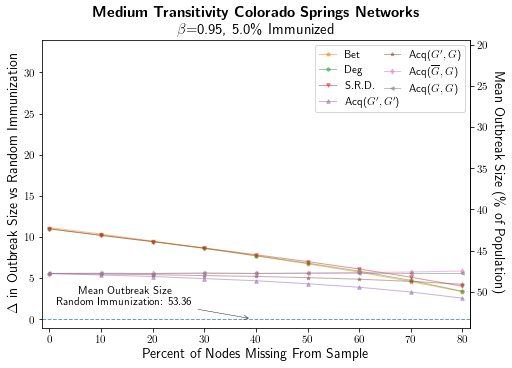

Mean Pct Infected with No Immunization:  58.12
Mean Pct Infected with Random Immunization:  48.66
Mean R0:  4.85
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


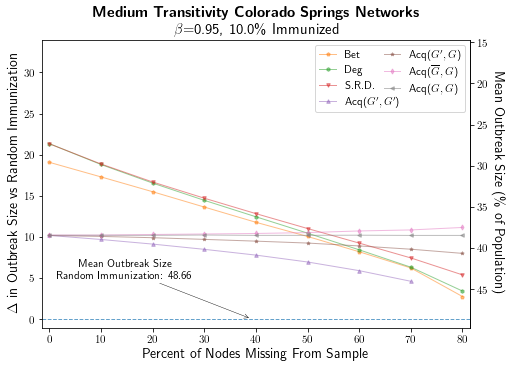

Mean Pct Infected with No Immunization:  58.13
Mean Pct Infected with Random Immunization:  44.09
Mean R0:  4.85
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


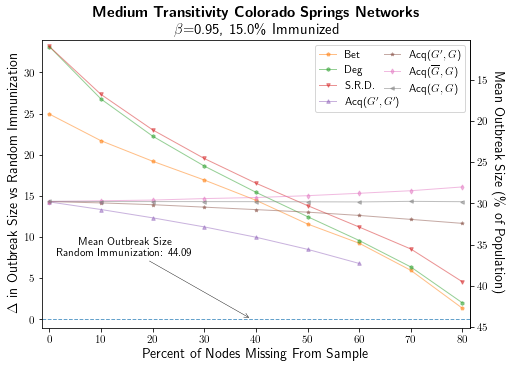

In [6]:

beta = 0.95
gamma = 1.0
legend = "upper right"
ylims=(-1, 34)
arrowWidth = 0.42
suptitle = "Medium Transitivity Colorado Springs Networks"
netType = 'med'





pctImmunized = 0.05
folder = 'allMedResults5and15'


figFileName = netType+"_Gamma"+pointify(gamma)+"_Beta"+pointify(beta)+"_pctImmunized"+pointify(100*pctImmunized)

makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation(figFileName = figFileName,
                         beta=beta,
                         gamma=gamma,
                         folderName= folder,
                         title='\\textbf{'+suptitle+'}\n $\\beta$='+str(beta)+', '+str(100*pctImmunized)+'\% Immunized',
                         legendLoc="upper right",
                         yLims = ylims,
                         pctImmunized = pctImmunized)



pctImmunized = 0.1
folder = 'newMedResults_gamma1_beta20to220'



figFileName = netType+"_Gamma"+pointify(gamma)+"_Beta"+pointify(beta)+"_pctImmunized"+pointify(100*pctImmunized)

makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation(figFileName = figFileName,
                         beta=beta,
                         gamma=gamma,
                         folderName= folder,
                         title='\\textbf{'+suptitle+'}\n $\\beta$='+str(beta)+', '+str(100*pctImmunized)+'\% Immunized',
                         legendLoc="upper right",
                         yLims = ylims,
                         pctImmunized = pctImmunized)



pctImmunized = 0.15
folder = 'allMedResults5and15'



figFileName = netType+"_Gamma"+pointify(gamma)+"_Beta"+pointify(beta)+"_pctImmunized"+pointify(100*pctImmunized)

makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation(figFileName = figFileName,
                         beta=beta,
                         gamma=gamma,
                         folderName= folder,
                         title='\\textbf{'+suptitle+'}\n $\\beta$='+str(beta)+', '+str(100*pctImmunized)+'\% Immunized',
                         legendLoc="upper right",
                         yLims = ylims,
                         pctImmunized = pctImmunized)





### Fig. 3

Mean Pct Infected with No Immunization:  52.58
Mean Pct Infected with Random Immunization:  43.65
Mean R0:  4.64
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


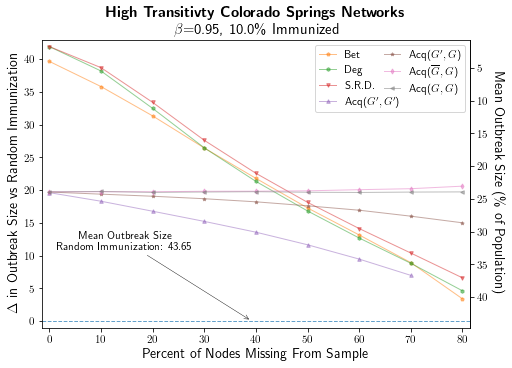

Mean Pct Infected with No Immunization:  65.88
Mean Pct Infected with Random Immunization:  55.70
Mean R0:  6.98
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


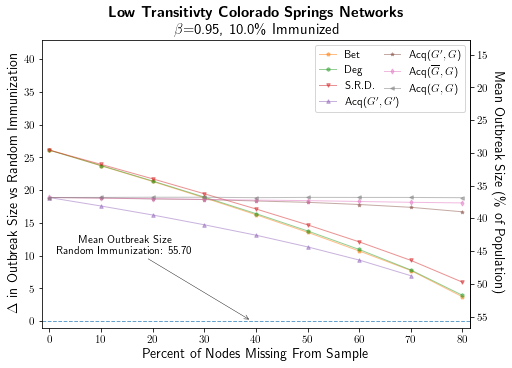

In [35]:

beta = 0.95
gamma = 1.0
legend = "upper right"
ylims=(-1, 43)
arrowWidth = 0.42
pctImmunized = 0.1






folder = 'newHighResults_gamma1_beta20to220'
suptitle = 'High Transitivty Colorado Springs Networks'
netType = 'high'


figFileName = netType+"_Gamma"+pointify(gamma)+"_Beta"+pointify(beta)+"_pctImmunized"+pointify(100*pctImmunized)

makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation(figFileName = figFileName,
                         beta=beta,
                         gamma=gamma,
                         folderName= folder,
                         title='\\textbf{'+suptitle+'}\n $\\beta$='+str(beta)+', '+str(100*pctImmunized)+'\% Immunized',
                         legendLoc="upper right",
                         yLims = ylims,
                         pctImmunized = pctImmunized)




folder = 'newLowResults_gamma1_beta20to220'
suptitle = 'Low Transitivty Colorado Springs Networks'
netType = 'low'



figFileName = netType+"_Gamma"+pointify(gamma)+"_Beta"+pointify(beta)+"_pctImmunized"+pointify(100*pctImmunized)

makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation(figFileName = figFileName,
                         beta=beta,
                         gamma=gamma,
                         folderName= folder,
                         title='\\textbf{'+suptitle+'}\n $\\beta$='+str(beta)+', '+str(100*pctImmunized)+'\% Immunized',
                         legendLoc="upper right",
                         yLims = ylims,
                         pctImmunized = pctImmunized)



### Fig. 4

Mean Pct Infected with No Immunization:  11.12
Mean Pct Infected with Random Immunization:  5.32
Mean R0:  1.40
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


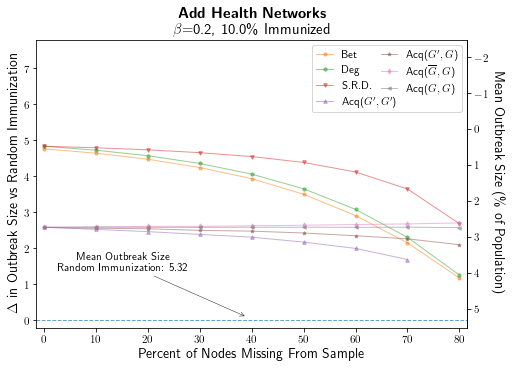

Mean Pct Infected with No Immunization:  75.68
Mean Pct Infected with Random Immunization:  64.54
Mean R0:  3.34
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


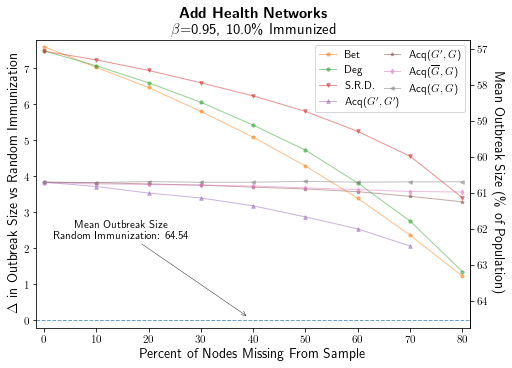

Mean Pct Infected with No Immunization:  86.23
Mean Pct Infected with Random Immunization:  75.18
Mean R0:  3.84
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


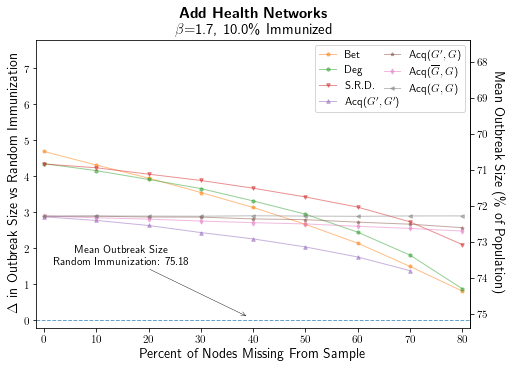

In [36]:
betas = [0.2,  0.95, 1.7]
gamma = 1.0
pctImmunized = 0.1
ylims =  (-0.2, 7.8)
folder = 'schoolResults10_gamma1_newCode_beta02to220'

for beta in betas:
    netType = 'schoolnet'
    figFileName = netType+"_Gamma"+pointify(gamma)+"_Beta"+pointify(beta)+"_pctImmunized"+pointify(100*pctImmunized)
    
    legendLoc = 'upper right'
    

    makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation(figFileName = figFileName,
                             beta=beta,
                             gamma=gamma,
                             folderName= folder,
                             title='\\textbf{Add Health Networks}\n $\\beta$='+str(beta)+', '+str(100*pctImmunized)+'\% Immunized',
                             legendLoc=legendLoc,
                             yLims = ylims,
                             pctImmunized = pctImmunized)


### Fig 5

In [67]:
plt.rc('text', usetex = True)
plt.rcParams['text.latex.preamble']=[r'\usepackage{amsmath}\usepackage{relsize}']



In [68]:
def make_lolipop(folderName, title, savename,
                 ylims = (-1.25, 1.6),
                 pctImmunized=0.1,
                 betas=[0.2, 0.325, 0.45, 0.575, 0.7, 0.825, 0.95, 1.075, 1.2, 1.325, 1.45, 1.575, 1.7],
                 gamma=1.0):
    
    G_barG = []
    GG = []

    all_filenames = [i for i in glob.glob(indir+"/"+folderName+'/*.csv')]

    obsDF = pd.concat([pd.read_csv(f, usecols = ['strategy', 'fracMissing', 'pctImmunized', 'beta',  'gamma', 'pctTotalPopInf']) for f in all_filenames ], sort=False)

    fracMissing = 0.8
    titleFont=18

    obsDFmean = obsDF.groupby(['strategy', 'fracMissing', 'pctImmunized', 'beta', 'gamma'], as_index=False).mean()



    for beta in betas:
        # G_barG
        strat = 'acqKG2_up'
        relevantObs = obsDFmean.loc[(obsDFmean['strategy']==strat)&(obsDFmean['fracMissing']==fracMissing)&(obsDFmean['pctImmunized']==pctImmunized)&(obsDFmean['beta']==beta)&(obsDFmean['gamma']==gamma)]['pctTotalPopInf'].values 
        G_barG.append(relevantObs[0])

        # GG
        strat = 'acqGG2'
        relevantObs = obsDFmean.loc[(obsDFmean['strategy']==strat)&(obsDFmean['fracMissing']==fracMissing)&(obsDFmean['pctImmunized']==pctImmunized)&(obsDFmean['beta']==beta)&(obsDFmean['gamma']==gamma)]['pctTotalPopInf'].values 
        GG.append(relevantObs[0])



    ys = [100*(GG[i] - G_barG[i]) for i in range(len(GG))]

    ys = np.asarray(ys)

    my_color=np.where(ys>=0, stratColorMap['acqKG2_up'], stratColorMap['acqGG2'])
    plt.vlines(x=betas, ymin=0, ymax=ys, color=my_color, linewidth=4.2, alpha=0.4)

    plt.scatter(betas, ys, marker = 'D', color=my_color, s=32, alpha=1) 

    plt.axhline(0, color='k', ls='--', linewidth=1, alpha=0.69)

    ax = plt.gca()
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)


    ax.tick_params(axis='both', which='major', labelsize=15)




    plt.ylim(*ylims)
    plt.xlabel(r'$\beta$', fontsize = 32, fontweight=14)
    plt.ylabel('$S_{\\text{Acq}(G,G)}-S_{\\text{Acq}(\overline{G},G)}\, (\%)$', fontsize = 22)


    plt.title(title, fontsize=titleFont)
    plt.savefig(outdir+"/"+savename+".pdf", bbox_inches='tight')
    
    plt.show()


    

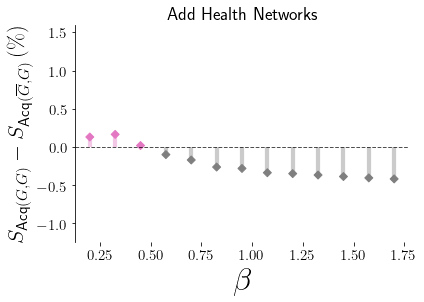

In [69]:
make_lolipop(folderName='schoolResults10_gamma1_newCode_beta02to220_extraBetasForGGandGbarG', title="Add Health Networks", savename="G_barG_vsGG_school_difference_lollipop.pdf")





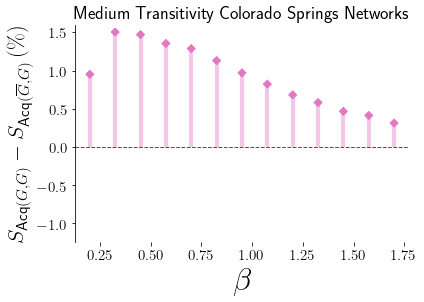

In [70]:
make_lolipop(folderName='newMedResults_gamma1_beta20to220_extraBetasForGGandGbarG', title="Medium Transitivity Colorado Springs Networks", savename="G_barG_vsGG_med_difference_lollipop.pdf")


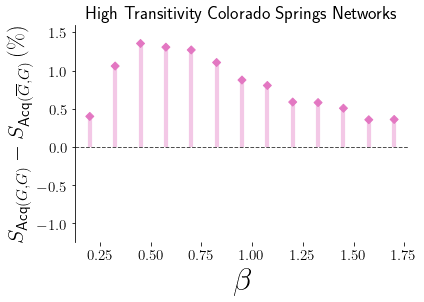

In [71]:
make_lolipop(folderName='newHighResults_gamma1_beta20to220_extraBetasForGGandGbarG', title="High Transitivity Colorado Springs Networks", savename="G_barG_vsGG_high_difference_lollipop.pdf")


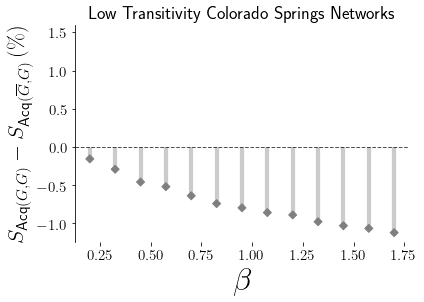

In [72]:
make_lolipop(folderName='newLowResults_gamma1_beta20to220_extraBetasForGGandGbarG', title="Low Transitivity Colorado Springs Networks", savename="G_barG_vsGG_low_difference_lollipop.pdf")


## Thats it for the figures in the main text! 


## On to the supplement!  (theres alot  of figures there)

# Section 1: Mechanistically Generated Networks

### Supp. Fig 1. 

Mean Pct Infected with No Immunization:  16.94
Mean Pct Infected with Random Immunization:  8.38
Mean R0:  1.40
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


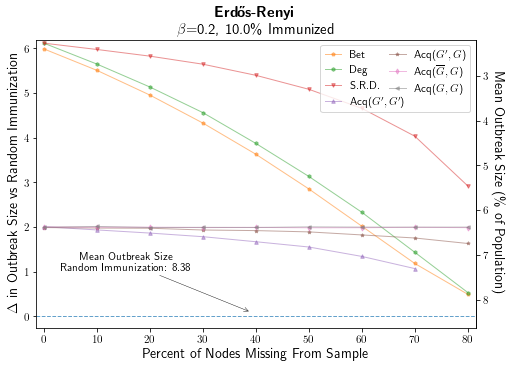

Mean Pct Infected with No Immunization:  84.21
Mean Pct Infected with Random Immunization:  73.34
Mean R0:  3.50
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


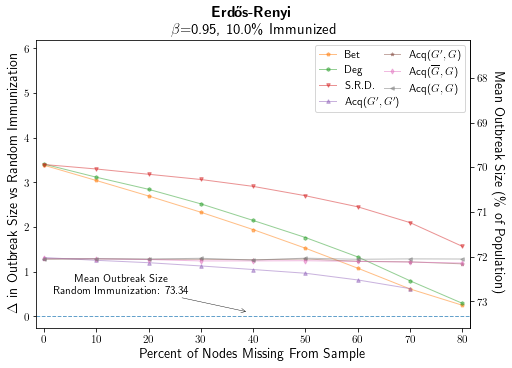

Mean Pct Infected with No Immunization:  91.53
Mean Pct Infected with Random Immunization:  81.08
Mean R0:  4.03
trials for strategy  Bet :  4900
trials for strategy  DegKK :  4900
trials for strategy  Srd :  4900
trials for strategy  acqKK2 :  4900
trials for strategy  acqKG2 :  4900
trials for strategy  acqKG2_up :  4900
trials for strategy  acqGG2 :  4900


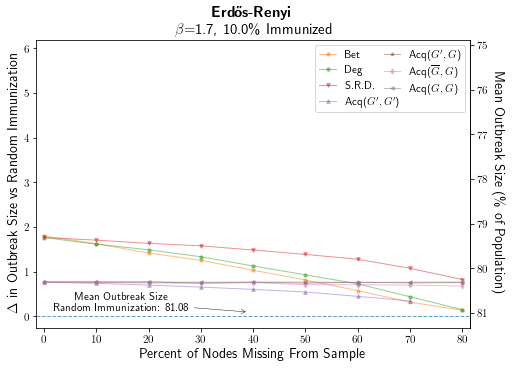

In [61]:
betas = [0.2,  0.95,  1.7]
gamma = 1.0
pctImmunized = 0.1
legend = 'upper left'
ylims = (-0.25, 6.2)

netType = 'ER'

folder = 'ER_betaSweep02to170_results'


suptitle = "Erdős-Renyi"


for beta in betas:
    figFileName = netType+"_Gamma"+pointify(gamma)+"_Beta"+pointify(beta)+"_pctImmunized"+pointify(100*pctImmunized)
    
    legendLoc = 'upper right'
    

    makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation(figFileName = figFileName,
                             beta=beta,
                             gamma=gamma,
                             folderName= folder,
                             title='\\textbf{'+suptitle+'}\n $\\beta$='+str(beta)+', '+str(100*pctImmunized)+'\% Immunized',
                             legendLoc=legendLoc ,
                             yLims = ylims,
                             pctImmunized = pctImmunized)


### Supp. Fig. 2.

Mean Pct Infected with No Immunization:  6.95
Mean Pct Infected with Random Immunization:  4.03
Mean R0:  2.23
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


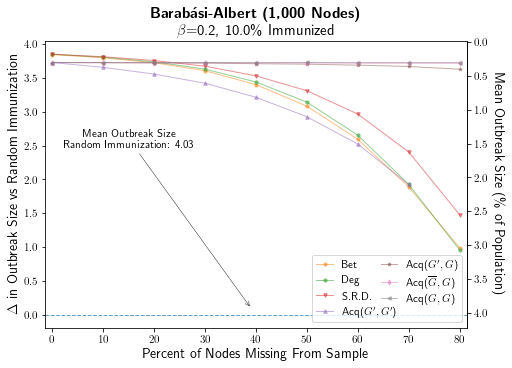

Mean Pct Infected with No Immunization:  69.47
Mean Pct Infected with Random Immunization:  57.48
Mean R0:  5.48
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


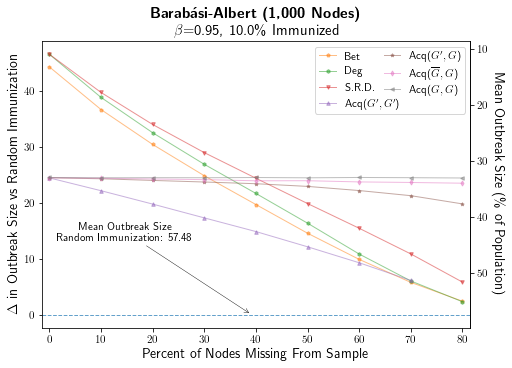

Mean Pct Infected with No Immunization:  84.01
Mean Pct Infected with Random Immunization:  72.19
Mean R0:  6.33
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


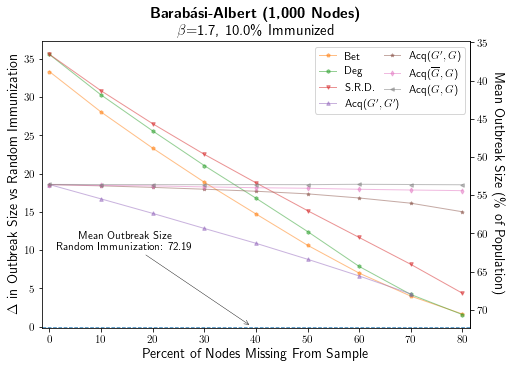

In [76]:

betas = [0.2,  0.95,  1.7]
gamma = 1.0
pctImmunized = 0.1
legend = 'upper left'
ylims = None

netType = 'BA1000'

folder = 'BAruns3betas_1000Nodes_results'


suptitle = "Barabási-Albert (1,000 Nodes)"
legendLocs = ["lower right", "upper right", "upper right"]

for i, beta in enumerate(betas):
    figFileName = netType+"_Gamma"+pointify(gamma)+"_Beta"+pointify(beta)+"_pctImmunized"+pointify(100*pctImmunized)
    

    makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation(figFileName = figFileName,
                             beta=beta,
                             gamma=gamma,
                             folderName= folder,
                             title='\\textbf{'+suptitle+'}\n $\\beta$='+str(beta)+', '+str(100*pctImmunized)+'\% Immunized',
                             legendLoc=legendLocs[i],
                             yLims = ylims,
                             pctImmunized = pctImmunized)


### Supp Fig. 3.

Mean Pct Infected with No Immunization:  69.42
Mean Pct Infected with Random Immunization:  57.42
Mean R0:  7.68
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


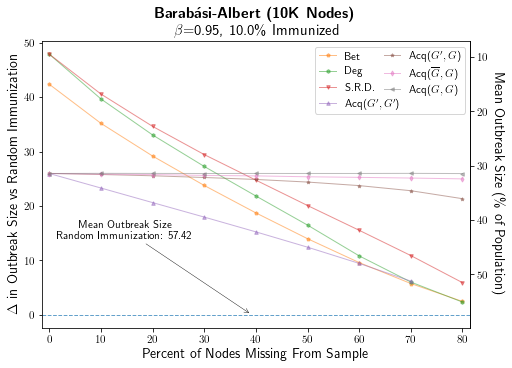

In [77]:
betas = [0.95]
gamma = 1.0
pctImmunized = 0.1
ylims = None

text_ys = ['auto', 2,  2]

netType = 'BA10K'

folder = 'BAruns3betas_10KNodes_results'


suptitle = "Barabási-Albert (10K Nodes)"


for i, beta in enumerate(betas):
    figFileName = netType+"_Gamma"+pointify(gamma)+"_Beta"+pointify(beta)+"_pctImmunized"+pointify(100*pctImmunized)
    
    
    

    makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation(figFileName = figFileName,
                             beta=beta,
                             gamma=gamma,
                             folderName= folder,
                             title='\\textbf{'+suptitle+'}\n$\\beta$='+str(beta)+', '+str(100*pctImmunized)+'\% Immunized',
                             legendLoc="upper right",
                             yLims = ylims,
                             pctImmunized = pctImmunized,
                             text_y = text_ys[i])
  

### Supp. Fig. 4.i, 4.iii, and 4.v

Mean Pct Infected with No Immunization:  20.69
Mean Pct Infected with Random Immunization:  8.34
Mean R0:  1.44
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


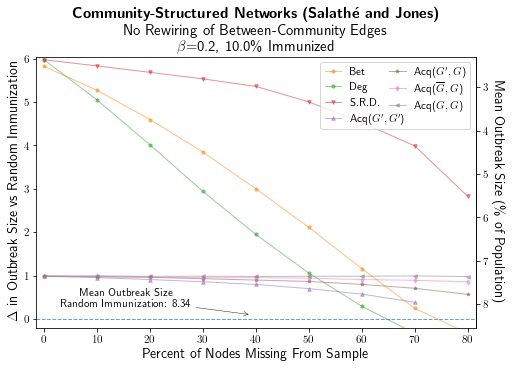

Mean Pct Infected with No Immunization:  88.87
Mean Pct Infected with Random Immunization:  78.26
Mean R0:  3.04
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


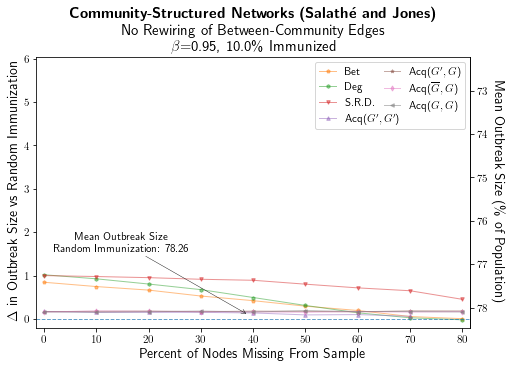

Mean Pct Infected with No Immunization:  93.88
Mean Pct Infected with Random Immunization:  83.74
Mean R0:  3.38
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


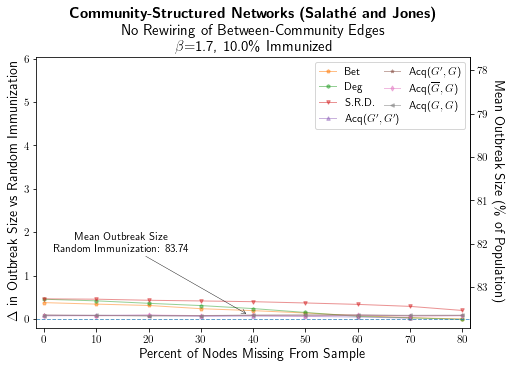

In [85]:

betas = [0.2,  0.95,  1.7]
gamma = 1.0
pctImmunized = 0.1
ylims = (-0.2, 6.05)

text_ys = ['auto', 2,  2]

netType = 'SalatheNoRewire'

folder = 'salatheNoRewireRuns3betas_results'


suptitle = "Community-Structured Networks (Salathé and Jones)"


for i, beta in enumerate(betas):
    figFileName = netType+"_Gamma"+pointify(gamma)+"_Beta"+pointify(beta)+"_pctImmunized"+pointify(100*pctImmunized)
    
    legendLoc = 'upper right'
    

    makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation(figFileName = figFileName,
                             beta=beta,
                             gamma=gamma,
                             folderName= folder,
                             title='\\textbf{'+suptitle+'}\nNo Rewiring of Between-Community Edges\n$\\beta$='+str(beta)+', '+str(100*pctImmunized)+'\% Immunized',
                             legendLoc=legendLoc,
                             yLims = ylims,
                             pctImmunized = pctImmunized,
                             text_y = text_ys[i])
    
    

### Supp. Fig. 4.ii, 4.iv, and 4.vi

Mean Pct Infected with No Immunization:  1.02
Mean Pct Infected with Random Immunization:  0.64
Mean R0:  1.38
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


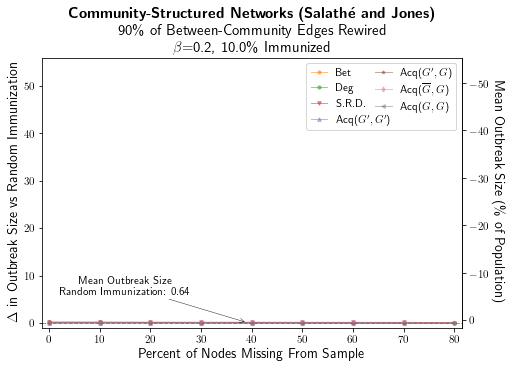

Mean Pct Infected with No Immunization:  82.71
Mean Pct Infected with Random Immunization:  66.20
Mean R0:  2.53
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


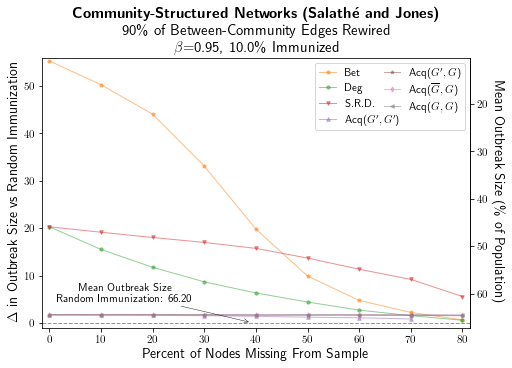

Mean Pct Infected with No Immunization:  92.23
Mean Pct Infected with Random Immunization:  79.72
Mean R0:  2.72
trials for strategy  Bet :  4950
trials for strategy  DegKK :  4950
trials for strategy  Srd :  4950
trials for strategy  acqKK2 :  4950
trials for strategy  acqKG2 :  4950
trials for strategy  acqKG2_up :  4950
trials for strategy  acqGG2 :  4950


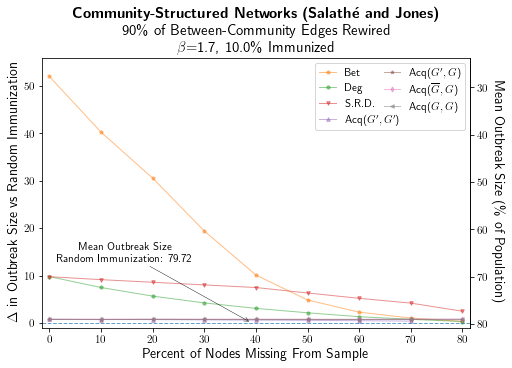

In [88]:

betas = [0.2,  0.95,  1.7]
gamma = 1.0
pctImmunized = 0.1

ylims = (-1, 56)

text_ys = [10, 8.5,  17]

netType = 'SalatheRewire1800'

folder = 'salatheRewireRuns3betas_results'


suptitle = "Community-Structured Networks (Salathé and Jones)"


for i, beta in enumerate(betas):
    figFileName = netType+"_Gamma"+pointify(gamma)+"_Beta"+pointify(beta)+"_pctImmunized"+pointify(100*pctImmunized)
    

    makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation(figFileName = figFileName,
                             beta=beta,
                             gamma=gamma,
                             folderName= folder,
                             title='\\textbf{'+suptitle+'}\n90\% of Between-Community Edges Rewired\n$\\beta$='+str(beta)+', '+str(100*pctImmunized)+'\% Immunized',
                             legendLoc="upper right",
                             yLims = ylims,
                             pctImmunized = pctImmunized,
                             text_y = text_ys[i])
    
    

# Section 2: Supplementary Tests

In [8]:
#Make a new colormap so we can grey out the values that didnt converge

from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap


RdBu = cm.get_cmap('RdBu', 256)
newcolors = RdBu(np.linspace(0, 1, 256))
grey = np.array([119/256,119/256,119/256,0.5])
newcolors[100:120, :] = grey
newcmp = ListedColormap(newcolors)


In [9]:

def getSignifArrs(foldername, pctImmunized, beta, gamma, alpha=0.001, numTests = None):




    all_filenames = [i for i in glob.glob(INDIR+foldername+'/*Beta={}Gamma={}*pctsImmunized{}.csv'.format(str(beta), str(gamma), str(pctImmunized)))]    

    obsDF = pd.concat([pd.read_csv(f) for f in all_filenames ], sort=False)



    strategies = ["Bet",    "DegKK",        "Srd",         "acqKK2", "acqKG2", "acqKG2_up", "acqGG2",  "RandSamp"]


    

    fracsMissing = [0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1, 0.0]
    
    if numTests == None:
        N = len(strategies)*len(fracsMissing) #Length of the entire matrix not just the subplots
        numTests = ((N**2)-N)/2
    
    bonf_thresh = alpha/numTests #bonferroni threshhold

    
    signifArrs =  []




    plotNum = 1
    for i, strategyA in enumerate(strategies[::-1]):
        for j, strategyB in enumerate(strategies):
            print(strategyA, strategyB)
            subplotNum = plotNum
            plotNum = plotNum+1

            signifArr = np.ones([len(fracsMissing), len(fracsMissing)])
            for k, fracMissingK in enumerate(fracsMissing):
                aDist = obsDF.loc[(obsDF['strategy']==strategyA)&(obsDF['pctImmunized']==pctImmunized)&(obsDF['fracMissing']==fracMissingK)]['pctTotalPopInf'].values

                for l, fracMissingL in enumerate(fracsMissing):
                    bDist = obsDF.loc[(obsDF['strategy']==strategyB)&(obsDF['pctImmunized']==pctImmunized)&(obsDF['fracMissing']==fracMissingL)]['pctTotalPopInf'].values                    
                    
                    
                    resultT = scipy.stats.ttest_ind(a=aDist, b=bDist)
                    print(strategyA, fracMissingK, ", ",  strategyB, fracMissingL, ": ", resultT[1] )






                    if resultT[1] < bonf_thresh:
                        meanA = np.mean(aDist)
                        meanB = np.mean(bDist)
                        if meanA<meanB:
                            signifArr[k, l] = 1
                        else:
                            signifArr[k, l] = 0
                        
                    else:
                        signifArr[k, l] = 0.5


            
            signifArrs.append(signifArr)
    return(signifArrs)


In [10]:
def makeSignifPlot(figFileName, signifArrs, title):




    fracsMissLabls = [0, 40, 80]

    strategies = ["Bet",    "DegKK",        "Srd",         "acqKK2", "acqKG2", "acqKG2_up", "acqGG2",  "RandSamp"]
    stratNameMap = {'Rand':'Rand', 'RandSamp':'Rand','Bet':'Bet', 'DegKK':"Deg","Srd":"S.R.D.", "acqKK2":"Acq($G^\prime, G^\prime$)", "acqGG2":"Acq($G, G$)", "acqKG2":"Acq($G^\prime,G$)", "acqKG2_up":"Acq($\overline{G},G$)"}

    


    tickLocs = np.array([8, 4, 0])+0.05

    fig, axes = plt.subplots(nrows=len(strategies), ncols=len(strategies), figsize=(7, 7))

    plotNum = 1
    for a, strategyA in enumerate(strategies[::-1]):
        for b, strategyB in enumerate(strategies):
            subplotNum = plotNum



            plt.subplot(len(strategies), len(strategies), subplotNum)
            signifArr = signifArrs[plotNum-1]



            #Dim the colors except on the diagonal that we want people to pay attention to:

            signifArrCopy = signifArr.copy()



            for i in range(signifArrCopy.shape[0]):
                for j in range(signifArrCopy.shape[1]):


                    if i == j: #if on the diagonal where A and B both have the same level of missing data
                        #Then change the value for the color map
                        if signifArrCopy[i, j] == 0:
                            signifArrCopy[i, j] = 0.1
                        elif signifArrCopy[i, j] == 1:
                            signifArrCopy[i, j] = 0.9

                    # If we are in the few data points where acq didnt always convege
                    # TO DO: Make this more flexible to work not just for the specific immunization and missing data levels we plot
                    if pctImmunized == 0.1 and ((strategyA=="acqKK2" and i==0 ) or (strategyB=="acqKK2" and j==0)):
                        signifArrCopy[i, j] = 111/256
                        #print("FLARGLE")
                    elif pctImmunized == 0.15 and ((strategyA=="acqKK2" and i<=1) or (strategyB=="acqKK2" and j<=1)):
                        signifArrCopy[i, j] = 111/256
                        #print("FLARGLE")








            print(plotNum)
            plotNum = plotNum+1

            #tickLocs = np.arange(signifArr.shape[1]+0.5)-.5

#             print("tickLocs")
#             print(tickLocs)


            print(signifArrCopy)        
            plt.imshow(signifArrCopy,cmap= newcmp, vmin=0.0, vmax=1.0 )
            myAx = plt.gca()
            myAx.set_xticks(tickLocs, minor=True)
            myAx.set_yticks(tickLocs, minor=True)

            myAx.set_xticks([], minor=False)
            myAx.set_yticks([], minor=False)

            myAx.set_yticklabels(labels = fracsMissLabls,minor=True, fontdict={'fontsize':8})
            myAx.set_xticklabels(labels = fracsMissLabls, minor=True, fontdict={'fontsize':8})
            myAx.invert_xaxis()

            if b==0:
                plt.ylabel(stratNameMap[strategyA], rotation=35,  labelpad=30, fontdict={'fontsize':14})
            else:

                myAx.set_yticks([], minor=True)

            if a==len(strategies)-1:
                plt.xlabel(stratNameMap[strategyB], rotation=60, labelpad=10, fontdict={'fontsize':15})
            else:
                myAx.set_xticks([], minor=True)











    plt.title(title, y=8.69, x=-3.3, size=15)
    plt.subplots_adjust(top=0.92, bottom=0.23, left=0.17, right=0.88, hspace=0.09, wspace=0.0)

    plt.savefig(OUTDIR+"/"+figFileName+'.pdf', bbox_inches = 'tight', pad_inches = 0)
    plt.show()

In [11]:
# We gotta let this run for a while so we will store the significance arrays,
#  in case we want to tweak the plot we dont have to recalculate the probabilities

params2signifArrs = {}

RandSamp Bet
RandSamp 0.8 ,  Bet 0.8 :  0.0
RandSamp 0.8 ,  Bet 0.7 :  0.0
RandSamp 0.8 ,  Bet 0.6 :  0.0
RandSamp 0.8 ,  Bet 0.5 :  0.0
RandSamp 0.8 ,  Bet 0.4 :  0.0
RandSamp 0.8 ,  Bet 0.3 :  0.0
RandSamp 0.8 ,  Bet 0.2 :  0.0
RandSamp 0.8 ,  Bet 0.1 :  0.0
RandSamp 0.8 ,  Bet 0.0 :  0.0
RandSamp 0.7 ,  Bet 0.8 :  0.0
RandSamp 0.7 ,  Bet 0.7 :  0.0
RandSamp 0.7 ,  Bet 0.6 :  0.0
RandSamp 0.7 ,  Bet 0.5 :  0.0
RandSamp 0.7 ,  Bet 0.4 :  0.0
RandSamp 0.7 ,  Bet 0.3 :  0.0
RandSamp 0.7 ,  Bet 0.2 :  0.0
RandSamp 0.7 ,  Bet 0.1 :  0.0
RandSamp 0.7 ,  Bet 0.0 :  0.0
RandSamp 0.6 ,  Bet 0.8 :  0.0
RandSamp 0.6 ,  Bet 0.7 :  0.0
RandSamp 0.6 ,  Bet 0.6 :  0.0
RandSamp 0.6 ,  Bet 0.5 :  0.0
RandSamp 0.6 ,  Bet 0.4 :  0.0
RandSamp 0.6 ,  Bet 0.3 :  0.0
RandSamp 0.6 ,  Bet 0.2 :  0.0
RandSamp 0.6 ,  Bet 0.1 :  0.0
RandSamp 0.6 ,  Bet 0.0 :  0.0
RandSamp 0.5 ,  Bet 0.8 :  0.0
RandSamp 0.5 ,  Bet 0.7 :  0.0
RandSamp 0.5 ,  Bet 0.6 :  0.0
RandSamp 0.5 ,  Bet 0.5 :  0.0
RandSamp 0.5 ,  Bet 0.4 : 

RandSamp 0.6 ,  acqKK2 0.7 :  0.0
RandSamp 0.6 ,  acqKK2 0.6 :  0.0
RandSamp 0.6 ,  acqKK2 0.5 :  0.0
RandSamp 0.6 ,  acqKK2 0.4 :  0.0
RandSamp 0.6 ,  acqKK2 0.3 :  0.0
RandSamp 0.6 ,  acqKK2 0.2 :  0.0
RandSamp 0.6 ,  acqKK2 0.1 :  0.0
RandSamp 0.6 ,  acqKK2 0.0 :  0.0
RandSamp 0.5 ,  acqKK2 0.8 :  nan
RandSamp 0.5 ,  acqKK2 0.7 :  0.0
RandSamp 0.5 ,  acqKK2 0.6 :  0.0
RandSamp 0.5 ,  acqKK2 0.5 :  0.0
RandSamp 0.5 ,  acqKK2 0.4 :  0.0
RandSamp 0.5 ,  acqKK2 0.3 :  0.0
RandSamp 0.5 ,  acqKK2 0.2 :  0.0
RandSamp 0.5 ,  acqKK2 0.1 :  0.0
RandSamp 0.5 ,  acqKK2 0.0 :  0.0
RandSamp 0.4 ,  acqKK2 0.8 :  nan
RandSamp 0.4 ,  acqKK2 0.7 :  0.0
RandSamp 0.4 ,  acqKK2 0.6 :  0.0
RandSamp 0.4 ,  acqKK2 0.5 :  0.0
RandSamp 0.4 ,  acqKK2 0.4 :  0.0
RandSamp 0.4 ,  acqKK2 0.3 :  0.0
RandSamp 0.4 ,  acqKK2 0.2 :  0.0
RandSamp 0.4 ,  acqKK2 0.1 :  0.0
RandSamp 0.4 ,  acqKK2 0.0 :  0.0
RandSamp 0.3 ,  acqKK2 0.8 :  nan
RandSamp 0.3 ,  acqKK2 0.7 :  0.0
RandSamp 0.3 ,  acqKK2 0.6 :  0.0
RandSamp 0.3 ,

RandSamp 0.7 ,  acqGG2 0.2 :  0.0
RandSamp 0.7 ,  acqGG2 0.1 :  0.0
RandSamp 0.7 ,  acqGG2 0.0 :  0.0
RandSamp 0.6 ,  acqGG2 0.8 :  0.0
RandSamp 0.6 ,  acqGG2 0.7 :  0.0
RandSamp 0.6 ,  acqGG2 0.6 :  0.0
RandSamp 0.6 ,  acqGG2 0.5 :  0.0
RandSamp 0.6 ,  acqGG2 0.4 :  0.0
RandSamp 0.6 ,  acqGG2 0.3 :  0.0
RandSamp 0.6 ,  acqGG2 0.2 :  0.0
RandSamp 0.6 ,  acqGG2 0.1 :  0.0
RandSamp 0.6 ,  acqGG2 0.0 :  0.0
RandSamp 0.5 ,  acqGG2 0.8 :  0.0
RandSamp 0.5 ,  acqGG2 0.7 :  0.0
RandSamp 0.5 ,  acqGG2 0.6 :  0.0
RandSamp 0.5 ,  acqGG2 0.5 :  0.0
RandSamp 0.5 ,  acqGG2 0.4 :  0.0
RandSamp 0.5 ,  acqGG2 0.3 :  0.0
RandSamp 0.5 ,  acqGG2 0.2 :  0.0
RandSamp 0.5 ,  acqGG2 0.1 :  0.0
RandSamp 0.5 ,  acqGG2 0.0 :  0.0
RandSamp 0.4 ,  acqGG2 0.8 :  0.0
RandSamp 0.4 ,  acqGG2 0.7 :  0.0
RandSamp 0.4 ,  acqGG2 0.6 :  0.0
RandSamp 0.4 ,  acqGG2 0.5 :  0.0
RandSamp 0.4 ,  acqGG2 0.4 :  0.0
RandSamp 0.4 ,  acqGG2 0.3 :  0.0
RandSamp 0.4 ,  acqGG2 0.2 :  0.0
RandSamp 0.4 ,  acqGG2 0.1 :  0.0
RandSamp 0.4 ,

acqGG2 0.1 ,  Bet 0.8 :  0.0
acqGG2 0.1 ,  Bet 0.7 :  0.0
acqGG2 0.1 ,  Bet 0.6 :  0.0
acqGG2 0.1 ,  Bet 0.5 :  0.0
acqGG2 0.1 ,  Bet 0.4 :  0.0
acqGG2 0.1 ,  Bet 0.3 :  0.25307917472640384
acqGG2 0.1 ,  Bet 0.2 :  0.0
acqGG2 0.1 ,  Bet 0.1 :  0.0
acqGG2 0.1 ,  Bet 0.0 :  0.0
acqGG2 0.0 ,  Bet 0.8 :  0.0
acqGG2 0.0 ,  Bet 0.7 :  0.0
acqGG2 0.0 ,  Bet 0.6 :  0.0
acqGG2 0.0 ,  Bet 0.5 :  0.0
acqGG2 0.0 ,  Bet 0.4 :  0.0
acqGG2 0.0 ,  Bet 0.3 :  0.3417808622255317
acqGG2 0.0 ,  Bet 0.2 :  0.0
acqGG2 0.0 ,  Bet 0.1 :  0.0
acqGG2 0.0 ,  Bet 0.0 :  0.0
acqGG2 DegKK
acqGG2 0.8 ,  DegKK 0.8 :  0.0
acqGG2 0.8 ,  DegKK 0.7 :  0.0
acqGG2 0.8 ,  DegKK 0.6 :  0.0
acqGG2 0.8 ,  DegKK 0.5 :  0.0
acqGG2 0.8 ,  DegKK 0.4 :  0.0
acqGG2 0.8 ,  DegKK 0.3 :  0.057420471542512244
acqGG2 0.8 ,  DegKK 0.2 :  0.0
acqGG2 0.8 ,  DegKK 0.1 :  0.0
acqGG2 0.8 ,  DegKK 0.0 :  0.0
acqGG2 0.7 ,  DegKK 0.8 :  0.0
acqGG2 0.7 ,  DegKK 0.7 :  0.0
acqGG2 0.7 ,  DegKK 0.6 :  0.0
acqGG2 0.7 ,  DegKK 0.5 :  0.0
acqGG2 0.7 ,  

acqGG2 0.1 ,  acqKK2 0.5 :  0.0
acqGG2 0.1 ,  acqKK2 0.4 :  0.0
acqGG2 0.1 ,  acqKK2 0.3 :  0.0
acqGG2 0.1 ,  acqKK2 0.2 :  0.0
acqGG2 0.1 ,  acqKK2 0.1 :  8.654099092666815e-154
acqGG2 0.1 ,  acqKK2 0.0 :  0.7509697868258981
acqGG2 0.0 ,  acqKK2 0.8 :  nan
acqGG2 0.0 ,  acqKK2 0.7 :  0.0
acqGG2 0.0 ,  acqKK2 0.6 :  0.0
acqGG2 0.0 ,  acqKK2 0.5 :  0.0
acqGG2 0.0 ,  acqKK2 0.4 :  0.0
acqGG2 0.0 ,  acqKK2 0.3 :  0.0
acqGG2 0.0 ,  acqKK2 0.2 :  0.0
acqGG2 0.0 ,  acqKK2 0.1 :  1.271430490684394e-153
acqGG2 0.0 ,  acqKK2 0.0 :  0.8999569588561566
acqGG2 acqKG2
acqGG2 0.8 ,  acqKG2 0.8 :  0.0
acqGG2 0.8 ,  acqKG2 0.7 :  6.772819039179441e-197
acqGG2 0.8 ,  acqKG2 0.6 :  3.2808670318685964e-100
acqGG2 0.8 ,  acqKG2 0.5 :  1.0238874177119357e-48
acqGG2 0.8 ,  acqKG2 0.4 :  2.5689245959990463e-25
acqGG2 0.8 ,  acqKG2 0.3 :  3.956630378938416e-09
acqGG2 0.8 ,  acqKG2 0.2 :  4.0008342895554135e-05
acqGG2 0.8 ,  acqKG2 0.1 :  0.2591570286594557
acqGG2 0.8 ,  acqKG2 0.0 :  0.6034219240591635
acqGG2

acqGG2 0.0 ,  acqKG2_up 0.5 :  1.4602636880036882e-22
acqGG2 0.0 ,  acqKG2_up 0.4 :  2.5692131135122604e-16
acqGG2 0.0 ,  acqKG2_up 0.3 :  5.522306419508206e-09
acqGG2 0.0 ,  acqKG2_up 0.2 :  0.00032265653106867997
acqGG2 0.0 ,  acqKG2_up 0.1 :  0.08905492491800701
acqGG2 0.0 ,  acqKG2_up 0.0 :  0.9432931650583973
acqGG2 acqGG2
acqGG2 0.8 ,  acqGG2 0.8 :  1.0
acqGG2 0.8 ,  acqGG2 0.7 :  0.4664513268675339
acqGG2 0.8 ,  acqGG2 0.6 :  0.458336803121816
acqGG2 0.8 ,  acqGG2 0.5 :  0.3587227609120426
acqGG2 0.8 ,  acqGG2 0.4 :  0.9457273760318438
acqGG2 0.8 ,  acqGG2 0.3 :  0.18757158875526028
acqGG2 0.8 ,  acqGG2 0.2 :  0.15239973605092164
acqGG2 0.8 ,  acqGG2 0.1 :  0.45638010962215303
acqGG2 0.8 ,  acqGG2 0.0 :  0.5791130422395763
acqGG2 0.7 ,  acqGG2 0.8 :  0.4664513268675339
acqGG2 0.7 ,  acqGG2 0.7 :  1.0
acqGG2 0.7 ,  acqGG2 0.6 :  0.9882474064560163
acqGG2 0.7 ,  acqGG2 0.5 :  0.8486245658838356
acqGG2 0.7 ,  acqGG2 0.4 :  0.5087795078909549
acqGG2 0.7 ,  acqGG2 0.3 :  0.5566779504

acqKG2_up 0.3 ,  Bet 0.8 :  0.0
acqKG2_up 0.3 ,  Bet 0.7 :  0.0
acqKG2_up 0.3 ,  Bet 0.6 :  0.0
acqKG2_up 0.3 ,  Bet 0.5 :  0.0
acqKG2_up 0.3 ,  Bet 0.4 :  0.0
acqKG2_up 0.3 ,  Bet 0.3 :  4.4209983302742883e-07
acqKG2_up 0.3 ,  Bet 0.2 :  0.0
acqKG2_up 0.3 ,  Bet 0.1 :  0.0
acqKG2_up 0.3 ,  Bet 0.0 :  0.0
acqKG2_up 0.2 ,  Bet 0.8 :  0.0
acqKG2_up 0.2 ,  Bet 0.7 :  0.0
acqKG2_up 0.2 ,  Bet 0.6 :  0.0
acqKG2_up 0.2 ,  Bet 0.5 :  0.0
acqKG2_up 0.2 ,  Bet 0.4 :  0.0
acqKG2_up 0.2 ,  Bet 0.3 :  0.005947148595188337
acqKG2_up 0.2 ,  Bet 0.2 :  0.0
acqKG2_up 0.2 ,  Bet 0.1 :  0.0
acqKG2_up 0.2 ,  Bet 0.0 :  0.0
acqKG2_up 0.1 ,  Bet 0.8 :  0.0
acqKG2_up 0.1 ,  Bet 0.7 :  0.0
acqKG2_up 0.1 ,  Bet 0.6 :  0.0
acqKG2_up 0.1 ,  Bet 0.5 :  0.0
acqKG2_up 0.1 ,  Bet 0.4 :  0.0
acqKG2_up 0.1 ,  Bet 0.3 :  0.4218350928211698
acqKG2_up 0.1 ,  Bet 0.2 :  0.0
acqKG2_up 0.1 ,  Bet 0.1 :  0.0
acqKG2_up 0.1 ,  Bet 0.0 :  0.0
acqKG2_up 0.0 ,  Bet 0.8 :  0.0
acqKG2_up 0.0 ,  Bet 0.7 :  0.0
acqKG2_up 0.0 ,  Bet 

acqKG2_up 0.5 ,  acqKK2 0.3 :  0.0
acqKG2_up 0.5 ,  acqKK2 0.2 :  0.0
acqKG2_up 0.5 ,  acqKK2 0.1 :  4.00143603994623e-64
acqKG2_up 0.5 ,  acqKK2 0.0 :  7.458125166274063e-22
acqKG2_up 0.4 ,  acqKK2 0.8 :  nan
acqKG2_up 0.4 ,  acqKK2 0.7 :  0.0
acqKG2_up 0.4 ,  acqKK2 0.6 :  0.0
acqKG2_up 0.4 ,  acqKK2 0.5 :  0.0
acqKG2_up 0.4 ,  acqKK2 0.4 :  0.0
acqKG2_up 0.4 ,  acqKK2 0.3 :  0.0
acqKG2_up 0.4 ,  acqKK2 0.2 :  0.0
acqKG2_up 0.4 ,  acqKK2 0.1 :  2.4054775670692705e-76
acqKG2_up 0.4 ,  acqKK2 0.0 :  9.611688042087792e-16
acqKG2_up 0.3 ,  acqKK2 0.8 :  nan
acqKG2_up 0.3 ,  acqKK2 0.7 :  0.0
acqKG2_up 0.3 ,  acqKK2 0.6 :  0.0
acqKG2_up 0.3 ,  acqKK2 0.5 :  0.0
acqKG2_up 0.3 ,  acqKK2 0.4 :  0.0
acqKG2_up 0.3 ,  acqKK2 0.3 :  0.0
acqKG2_up 0.3 ,  acqKK2 0.2 :  0.0
acqKG2_up 0.3 ,  acqKK2 0.1 :  1.724268283681682e-97
acqKG2_up 0.3 ,  acqKK2 0.0 :  1.3540856376871902e-08
acqKG2_up 0.2 ,  acqKK2 0.8 :  nan
acqKG2_up 0.2 ,  acqKK2 0.7 :  0.0
acqKG2_up 0.2 ,  acqKK2 0.6 :  0.0
acqKG2_up 0.2 , 

acqKG2_up 0.4 ,  acqKG2_up 0.6 :  1.2491240649174126e-05
acqKG2_up 0.4 ,  acqKG2_up 0.5 :  0.10961153795773851
acqKG2_up 0.4 ,  acqKG2_up 0.4 :  1.0
acqKG2_up 0.4 ,  acqKG2_up 0.3 :  0.015569915704850983
acqKG2_up 0.4 ,  acqKG2_up 0.2 :  3.7681767317655087e-06
acqKG2_up 0.4 ,  acqKG2_up 0.1 :  9.894269786060022e-11
acqKG2_up 0.4 ,  acqKG2_up 0.0 :  1.816284510711196e-16
acqKG2_up 0.3 ,  acqKG2_up 0.8 :  1.9070757483472215e-29
acqKG2_up 0.3 ,  acqKG2_up 0.7 :  5.2665925954241604e-21
acqKG2_up 0.3 ,  acqKG2_up 0.6 :  1.0159548804778726e-11
acqKG2_up 0.3 ,  acqKG2_up 0.5 :  5.708341930789151e-05
acqKG2_up 0.3 ,  acqKG2_up 0.4 :  0.015569915704850983
acqKG2_up 0.3 ,  acqKG2_up 0.3 :  1.0
acqKG2_up 0.3 ,  acqKG2_up 0.2 :  0.025803858363659764
acqKG2_up 0.3 ,  acqKG2_up 0.1 :  4.1006804916460856e-05
acqKG2_up 0.3 ,  acqKG2_up 0.0 :  4.078811254784483e-09
acqKG2_up 0.2 ,  acqKG2_up 0.8 :  5.365502233172192e-41
acqKG2_up 0.2 ,  acqKG2_up 0.7 :  6.072682882573115e-31
acqKG2_up 0.2 ,  acqKG2_up 

acqKG2_up 0.3 ,  RandSamp 0.8 :  0.0
acqKG2_up 0.3 ,  RandSamp 0.7 :  0.0
acqKG2_up 0.3 ,  RandSamp 0.6 :  0.0
acqKG2_up 0.3 ,  RandSamp 0.5 :  0.0
acqKG2_up 0.3 ,  RandSamp 0.4 :  0.0
acqKG2_up 0.3 ,  RandSamp 0.3 :  0.0
acqKG2_up 0.3 ,  RandSamp 0.2 :  0.0
acqKG2_up 0.3 ,  RandSamp 0.1 :  0.0
acqKG2_up 0.3 ,  RandSamp 0.0 :  0.0
acqKG2_up 0.2 ,  RandSamp 0.8 :  0.0
acqKG2_up 0.2 ,  RandSamp 0.7 :  0.0
acqKG2_up 0.2 ,  RandSamp 0.6 :  0.0
acqKG2_up 0.2 ,  RandSamp 0.5 :  0.0
acqKG2_up 0.2 ,  RandSamp 0.4 :  0.0
acqKG2_up 0.2 ,  RandSamp 0.3 :  0.0
acqKG2_up 0.2 ,  RandSamp 0.2 :  0.0
acqKG2_up 0.2 ,  RandSamp 0.1 :  0.0
acqKG2_up 0.2 ,  RandSamp 0.0 :  0.0
acqKG2_up 0.1 ,  RandSamp 0.8 :  0.0
acqKG2_up 0.1 ,  RandSamp 0.7 :  0.0
acqKG2_up 0.1 ,  RandSamp 0.6 :  0.0
acqKG2_up 0.1 ,  RandSamp 0.5 :  0.0
acqKG2_up 0.1 ,  RandSamp 0.4 :  0.0
acqKG2_up 0.1 ,  RandSamp 0.3 :  0.0
acqKG2_up 0.1 ,  RandSamp 0.2 :  0.0
acqKG2_up 0.1 ,  RandSamp 0.1 :  0.0
acqKG2_up 0.1 ,  RandSamp 0.0 :  0.0
a

acqKG2 0.2 ,  Srd 0.8 :  0.0
acqKG2 0.2 ,  Srd 0.7 :  0.0
acqKG2 0.2 ,  Srd 0.6 :  0.0
acqKG2 0.2 ,  Srd 0.5 :  0.0
acqKG2 0.2 ,  Srd 0.4 :  2.877904578961913e-215
acqKG2 0.2 ,  Srd 0.3 :  9.133512105645144e-63
acqKG2 0.2 ,  Srd 0.2 :  0.0
acqKG2 0.2 ,  Srd 0.1 :  0.0
acqKG2 0.2 ,  Srd 0.0 :  0.0
acqKG2 0.1 ,  Srd 0.8 :  0.0
acqKG2 0.1 ,  Srd 0.7 :  0.0
acqKG2 0.1 ,  Srd 0.6 :  0.0
acqKG2 0.1 ,  Srd 0.5 :  0.0
acqKG2 0.1 ,  Srd 0.4 :  3.0162162984792904e-253
acqKG2 0.1 ,  Srd 0.3 :  8.488629104087734e-43
acqKG2 0.1 ,  Srd 0.2 :  0.0
acqKG2 0.1 ,  Srd 0.1 :  0.0
acqKG2 0.1 ,  Srd 0.0 :  0.0
acqKG2 0.0 ,  Srd 0.8 :  0.0
acqKG2 0.0 ,  Srd 0.7 :  0.0
acqKG2 0.0 ,  Srd 0.6 :  0.0
acqKG2 0.0 ,  Srd 0.5 :  0.0
acqKG2 0.0 ,  Srd 0.4 :  4.701173130411959e-275
acqKG2 0.0 ,  Srd 0.3 :  2.3373860947077517e-33
acqKG2 0.0 ,  Srd 0.2 :  0.0
acqKG2 0.0 ,  Srd 0.1 :  0.0
acqKG2 0.0 ,  Srd 0.0 :  0.0
acqKG2 acqKK2
acqKG2 0.8 ,  acqKK2 0.8 :  nan
acqKG2 0.8 ,  acqKK2 0.7 :  0.0
acqKG2 0.8 ,  acqKK2 0.6 :

acqKG2 0.7 ,  acqKG2_up 0.1 :  9.100790187147925e-181
acqKG2 0.7 ,  acqKG2_up 0.0 :  3.9598466492956997e-202
acqKG2 0.6 ,  acqKG2_up 0.8 :  6.006505826476851e-07
acqKG2 0.6 ,  acqKG2_up 0.7 :  5.222499196494427e-12
acqKG2 0.6 ,  acqKG2_up 0.6 :  3.780169476001122e-21
acqKG2 0.6 ,  acqKG2_up 0.5 :  4.143589849914189e-34
acqKG2 0.6 ,  acqKG2_up 0.4 :  4.354837255059764e-43
acqKG2 0.6 ,  acqKG2_up 0.3 :  4.586050790580612e-59
acqKG2 0.6 ,  acqKG2_up 0.2 :  8.192431226975889e-75
acqKG2 0.6 ,  acqKG2_up 0.1 :  4.410603143303395e-89
acqKG2 0.6 ,  acqKG2_up 0.0 :  1.4145036877434274e-104
acqKG2 0.5 ,  acqKG2_up 0.8 :  0.06740540709097075
acqKG2 0.5 ,  acqKG2_up 0.7 :  0.9408447292878348
acqKG2 0.5 ,  acqKG2_up 0.6 :  0.00789414959311518
acqKG2 0.5 ,  acqKG2_up 0.5 :  5.592228084610264e-08
acqKG2 0.5 ,  acqKG2_up 0.4 :  1.976807708178366e-12
acqKG2 0.5 ,  acqKG2_up 0.3 :  2.3603098097168284e-21
acqKG2 0.5 ,  acqKG2_up 0.2 :  2.229833012303514e-31
acqKG2 0.5 ,  acqKG2_up 0.1 :  3.47636507076544

acqKG2 0.5 ,  RandSamp 0.4 :  0.0
acqKG2 0.5 ,  RandSamp 0.3 :  0.0
acqKG2 0.5 ,  RandSamp 0.2 :  0.0
acqKG2 0.5 ,  RandSamp 0.1 :  0.0
acqKG2 0.5 ,  RandSamp 0.0 :  0.0
acqKG2 0.4 ,  RandSamp 0.8 :  0.0
acqKG2 0.4 ,  RandSamp 0.7 :  0.0
acqKG2 0.4 ,  RandSamp 0.6 :  0.0
acqKG2 0.4 ,  RandSamp 0.5 :  0.0
acqKG2 0.4 ,  RandSamp 0.4 :  0.0
acqKG2 0.4 ,  RandSamp 0.3 :  0.0
acqKG2 0.4 ,  RandSamp 0.2 :  0.0
acqKG2 0.4 ,  RandSamp 0.1 :  0.0
acqKG2 0.4 ,  RandSamp 0.0 :  0.0
acqKG2 0.3 ,  RandSamp 0.8 :  0.0
acqKG2 0.3 ,  RandSamp 0.7 :  0.0
acqKG2 0.3 ,  RandSamp 0.6 :  0.0
acqKG2 0.3 ,  RandSamp 0.5 :  0.0
acqKG2 0.3 ,  RandSamp 0.4 :  0.0
acqKG2 0.3 ,  RandSamp 0.3 :  0.0
acqKG2 0.3 ,  RandSamp 0.2 :  0.0
acqKG2 0.3 ,  RandSamp 0.1 :  0.0
acqKG2 0.3 ,  RandSamp 0.0 :  0.0
acqKG2 0.2 ,  RandSamp 0.8 :  0.0
acqKG2 0.2 ,  RandSamp 0.7 :  0.0
acqKG2 0.2 ,  RandSamp 0.6 :  0.0
acqKG2 0.2 ,  RandSamp 0.5 :  0.0
acqKG2 0.2 ,  RandSamp 0.4 :  0.0
acqKG2 0.2 ,  RandSamp 0.3 :  0.0
acqKG2 0.2 ,  

acqKK2 0.4 ,  Srd 0.0 :  0.0
acqKK2 0.3 ,  Srd 0.8 :  0.0
acqKK2 0.3 ,  Srd 0.7 :  0.0
acqKK2 0.3 ,  Srd 0.6 :  0.0
acqKK2 0.3 ,  Srd 0.5 :  0.8162110792326742
acqKK2 0.3 ,  Srd 0.4 :  0.0
acqKK2 0.3 ,  Srd 0.3 :  0.0
acqKK2 0.3 ,  Srd 0.2 :  0.0
acqKK2 0.3 ,  Srd 0.1 :  0.0
acqKK2 0.3 ,  Srd 0.0 :  0.0
acqKK2 0.2 ,  Srd 0.8 :  0.0
acqKK2 0.2 ,  Srd 0.7 :  0.0
acqKK2 0.2 ,  Srd 0.6 :  0.0
acqKK2 0.2 ,  Srd 0.5 :  7.162471010007876e-218
acqKK2 0.2 ,  Srd 0.4 :  4.108977603984311e-84
acqKK2 0.2 ,  Srd 0.3 :  0.0
acqKK2 0.2 ,  Srd 0.2 :  0.0
acqKK2 0.2 ,  Srd 0.1 :  0.0
acqKK2 0.2 ,  Srd 0.0 :  0.0
acqKK2 0.1 ,  Srd 0.8 :  0.0
acqKK2 0.1 ,  Srd 0.7 :  0.0
acqKK2 0.1 ,  Srd 0.6 :  0.0
acqKK2 0.1 ,  Srd 0.5 :  0.0
acqKK2 0.1 ,  Srd 0.4 :  3.894017153984989e-21
acqKK2 0.1 ,  Srd 0.3 :  0.0
acqKK2 0.1 ,  Srd 0.2 :  0.0
acqKK2 0.1 ,  Srd 0.1 :  0.0
acqKK2 0.1 ,  Srd 0.0 :  0.0
acqKK2 0.0 ,  Srd 0.8 :  0.0
acqKK2 0.0 ,  Srd 0.7 :  0.0
acqKK2 0.0 ,  Srd 0.6 :  0.0
acqKK2 0.0 ,  Srd 0.5 :  0.0
ac

acqKK2 0.3 ,  acqKG2_up 0.8 :  0.0
acqKK2 0.3 ,  acqKG2_up 0.7 :  0.0
acqKK2 0.3 ,  acqKG2_up 0.6 :  0.0
acqKK2 0.3 ,  acqKG2_up 0.5 :  0.0
acqKK2 0.3 ,  acqKG2_up 0.4 :  0.0
acqKK2 0.3 ,  acqKG2_up 0.3 :  0.0
acqKK2 0.3 ,  acqKG2_up 0.2 :  0.0
acqKK2 0.3 ,  acqKG2_up 0.1 :  0.0
acqKK2 0.3 ,  acqKG2_up 0.0 :  0.0
acqKK2 0.2 ,  acqKG2_up 0.8 :  4.519692850436331e-302
acqKK2 0.2 ,  acqKG2_up 0.7 :  0.0
acqKK2 0.2 ,  acqKG2_up 0.6 :  0.0
acqKK2 0.2 ,  acqKG2_up 0.5 :  0.0
acqKK2 0.2 ,  acqKG2_up 0.4 :  0.0
acqKK2 0.2 ,  acqKG2_up 0.3 :  0.0
acqKK2 0.2 ,  acqKG2_up 0.2 :  0.0
acqKK2 0.2 ,  acqKG2_up 0.1 :  0.0
acqKK2 0.2 ,  acqKG2_up 0.0 :  0.0
acqKK2 0.1 ,  acqKG2_up 0.8 :  2.711313802864838e-22
acqKK2 0.1 ,  acqKG2_up 0.7 :  2.59318677152412e-31
acqKK2 0.1 ,  acqKG2_up 0.6 :  1.3935267942323661e-45
acqKK2 0.1 ,  acqKG2_up 0.5 :  4.00143603994623e-64
acqKK2 0.1 ,  acqKG2_up 0.4 :  2.4054775670692705e-76
acqKK2 0.1 ,  acqKG2_up 0.3 :  1.724268283681682e-97
acqKK2 0.1 ,  acqKG2_up 0.2 :  3.

Srd 0.4 ,  Bet 0.8 :  0.0
Srd 0.4 ,  Bet 0.7 :  0.0
Srd 0.4 ,  Bet 0.6 :  0.0
Srd 0.4 ,  Bet 0.5 :  0.0
Srd 0.4 ,  Bet 0.4 :  4.555238362331996e-78
Srd 0.4 ,  Bet 0.3 :  9.644313887270998e-278
Srd 0.4 ,  Bet 0.2 :  0.0
Srd 0.4 ,  Bet 0.1 :  0.0
Srd 0.4 ,  Bet 0.0 :  0.0
Srd 0.3 ,  Bet 0.8 :  0.0
Srd 0.3 ,  Bet 0.7 :  0.0
Srd 0.3 ,  Bet 0.6 :  0.0
Srd 0.3 ,  Bet 0.5 :  0.0
Srd 0.3 ,  Bet 0.4 :  0.0
Srd 0.3 ,  Bet 0.3 :  1.7892299377454494e-40
Srd 0.3 ,  Bet 0.2 :  0.0
Srd 0.3 ,  Bet 0.1 :  0.0
Srd 0.3 ,  Bet 0.0 :  0.0
Srd 0.2 ,  Bet 0.8 :  0.0
Srd 0.2 ,  Bet 0.7 :  0.0
Srd 0.2 ,  Bet 0.6 :  0.0
Srd 0.2 ,  Bet 0.5 :  0.0
Srd 0.2 ,  Bet 0.4 :  0.0
Srd 0.2 ,  Bet 0.3 :  0.0
Srd 0.2 ,  Bet 0.2 :  1.0934717122891968e-17
Srd 0.2 ,  Bet 0.1 :  0.0
Srd 0.2 ,  Bet 0.0 :  0.0
Srd 0.1 ,  Bet 0.8 :  0.0
Srd 0.1 ,  Bet 0.7 :  0.0
Srd 0.1 ,  Bet 0.6 :  0.0
Srd 0.1 ,  Bet 0.5 :  0.0
Srd 0.1 ,  Bet 0.4 :  0.0
Srd 0.1 ,  Bet 0.3 :  0.0
Srd 0.1 ,  Bet 0.2 :  0.0
Srd 0.1 ,  Bet 0.1 :  2.939853660076597e-

Srd 0.8 ,  acqKG2 0.8 :  0.0
Srd 0.8 ,  acqKG2 0.7 :  0.0
Srd 0.8 ,  acqKG2 0.6 :  0.0
Srd 0.8 ,  acqKG2 0.5 :  0.0
Srd 0.8 ,  acqKG2 0.4 :  0.0
Srd 0.8 ,  acqKG2 0.3 :  0.0
Srd 0.8 ,  acqKG2 0.2 :  0.0
Srd 0.8 ,  acqKG2 0.1 :  0.0
Srd 0.8 ,  acqKG2 0.0 :  0.0
Srd 0.7 ,  acqKG2 0.8 :  0.0
Srd 0.7 ,  acqKG2 0.7 :  0.0
Srd 0.7 ,  acqKG2 0.6 :  0.0
Srd 0.7 ,  acqKG2 0.5 :  0.0
Srd 0.7 ,  acqKG2 0.4 :  0.0
Srd 0.7 ,  acqKG2 0.3 :  0.0
Srd 0.7 ,  acqKG2 0.2 :  0.0
Srd 0.7 ,  acqKG2 0.1 :  0.0
Srd 0.7 ,  acqKG2 0.0 :  0.0
Srd 0.6 ,  acqKG2 0.8 :  0.0
Srd 0.6 ,  acqKG2 0.7 :  0.0
Srd 0.6 ,  acqKG2 0.6 :  0.0
Srd 0.6 ,  acqKG2 0.5 :  0.0
Srd 0.6 ,  acqKG2 0.4 :  0.0
Srd 0.6 ,  acqKG2 0.3 :  0.0
Srd 0.6 ,  acqKG2 0.2 :  0.0
Srd 0.6 ,  acqKG2 0.1 :  0.0
Srd 0.6 ,  acqKG2 0.0 :  0.0
Srd 0.5 ,  acqKG2 0.8 :  0.0
Srd 0.5 ,  acqKG2 0.7 :  0.0
Srd 0.5 ,  acqKG2 0.6 :  0.0
Srd 0.5 ,  acqKG2 0.5 :  0.0
Srd 0.5 ,  acqKG2 0.4 :  0.0
Srd 0.5 ,  acqKG2 0.3 :  0.0
Srd 0.5 ,  acqKG2 0.2 :  0.0
Srd 0.5 ,  acq

Srd 0.8 ,  RandSamp 0.8 :  0.0
Srd 0.8 ,  RandSamp 0.7 :  0.0
Srd 0.8 ,  RandSamp 0.6 :  0.0
Srd 0.8 ,  RandSamp 0.5 :  0.0
Srd 0.8 ,  RandSamp 0.4 :  0.0
Srd 0.8 ,  RandSamp 0.3 :  0.0
Srd 0.8 ,  RandSamp 0.2 :  0.0
Srd 0.8 ,  RandSamp 0.1 :  0.0
Srd 0.8 ,  RandSamp 0.0 :  0.0
Srd 0.7 ,  RandSamp 0.8 :  0.0
Srd 0.7 ,  RandSamp 0.7 :  0.0
Srd 0.7 ,  RandSamp 0.6 :  0.0
Srd 0.7 ,  RandSamp 0.5 :  0.0
Srd 0.7 ,  RandSamp 0.4 :  0.0
Srd 0.7 ,  RandSamp 0.3 :  0.0
Srd 0.7 ,  RandSamp 0.2 :  0.0
Srd 0.7 ,  RandSamp 0.1 :  0.0
Srd 0.7 ,  RandSamp 0.0 :  0.0
Srd 0.6 ,  RandSamp 0.8 :  0.0
Srd 0.6 ,  RandSamp 0.7 :  0.0
Srd 0.6 ,  RandSamp 0.6 :  0.0
Srd 0.6 ,  RandSamp 0.5 :  0.0
Srd 0.6 ,  RandSamp 0.4 :  0.0
Srd 0.6 ,  RandSamp 0.3 :  0.0
Srd 0.6 ,  RandSamp 0.2 :  0.0
Srd 0.6 ,  RandSamp 0.1 :  0.0
Srd 0.6 ,  RandSamp 0.0 :  0.0
Srd 0.5 ,  RandSamp 0.8 :  0.0
Srd 0.5 ,  RandSamp 0.7 :  0.0
Srd 0.5 ,  RandSamp 0.6 :  0.0
Srd 0.5 ,  RandSamp 0.5 :  0.0
Srd 0.5 ,  RandSamp 0.4 :  0.0
Srd 0.5 

DegKK 0.4 ,  Srd 0.8 :  0.0
DegKK 0.4 ,  Srd 0.7 :  0.0
DegKK 0.4 ,  Srd 0.6 :  0.0
DegKK 0.4 ,  Srd 0.5 :  3.9117619509652254e-278
DegKK 0.4 ,  Srd 0.4 :  2.2484774238240878e-51
DegKK 0.4 ,  Srd 0.3 :  0.0
DegKK 0.4 ,  Srd 0.2 :  0.0
DegKK 0.4 ,  Srd 0.1 :  0.0
DegKK 0.4 ,  Srd 0.0 :  0.0
DegKK 0.3 ,  Srd 0.8 :  0.0
DegKK 0.3 ,  Srd 0.7 :  0.0
DegKK 0.3 ,  Srd 0.6 :  0.0
DegKK 0.3 ,  Srd 0.5 :  0.0
DegKK 0.3 ,  Srd 0.4 :  3.5186466770776994e-301
DegKK 0.3 ,  Srd 0.3 :  3.504102932763307e-27
DegKK 0.3 ,  Srd 0.2 :  0.0
DegKK 0.3 ,  Srd 0.1 :  0.0
DegKK 0.3 ,  Srd 0.0 :  0.0
DegKK 0.2 ,  Srd 0.8 :  0.0
DegKK 0.2 ,  Srd 0.7 :  0.0
DegKK 0.2 ,  Srd 0.6 :  0.0
DegKK 0.2 ,  Srd 0.5 :  0.0
DegKK 0.2 ,  Srd 0.4 :  0.0
DegKK 0.2 ,  Srd 0.3 :  0.0
DegKK 0.2 ,  Srd 0.2 :  2.6320792988545146e-12
DegKK 0.2 ,  Srd 0.1 :  0.0
DegKK 0.2 ,  Srd 0.0 :  0.0
DegKK 0.1 ,  Srd 0.8 :  0.0
DegKK 0.1 ,  Srd 0.7 :  0.0
DegKK 0.1 ,  Srd 0.6 :  0.0
DegKK 0.1 ,  Srd 0.5 :  0.0
DegKK 0.1 ,  Srd 0.4 :  0.0
DegKK 0.

DegKK 0.3 ,  acqKG2_up 0.8 :  1.6925613787576134e-75
DegKK 0.3 ,  acqKG2_up 0.7 :  1.224953692439376e-61
DegKK 0.3 ,  acqKG2_up 0.6 :  2.3179847983160185e-44
DegKK 0.3 ,  acqKG2_up 0.5 :  3.7188952329215313e-29
DegKK 0.3 ,  acqKG2_up 0.4 :  7.030290122025631e-22
DegKK 0.3 ,  acqKG2_up 0.3 :  4.570197848213169e-13
DegKK 0.3 ,  acqKG2_up 0.2 :  6.546151333482693e-07
DegKK 0.3 ,  acqKG2_up 0.1 :  0.00229156969384497
DegKK 0.3 ,  acqKG2_up 0.0 :  0.20821969468594517
DegKK 0.2 ,  acqKG2_up 0.8 :  0.0
DegKK 0.2 ,  acqKG2_up 0.7 :  0.0
DegKK 0.2 ,  acqKG2_up 0.6 :  0.0
DegKK 0.2 ,  acqKG2_up 0.5 :  0.0
DegKK 0.2 ,  acqKG2_up 0.4 :  0.0
DegKK 0.2 ,  acqKG2_up 0.3 :  0.0
DegKK 0.2 ,  acqKG2_up 0.2 :  0.0
DegKK 0.2 ,  acqKG2_up 0.1 :  0.0
DegKK 0.2 ,  acqKG2_up 0.0 :  0.0
DegKK 0.1 ,  acqKG2_up 0.8 :  0.0
DegKK 0.1 ,  acqKG2_up 0.7 :  0.0
DegKK 0.1 ,  acqKG2_up 0.6 :  0.0
DegKK 0.1 ,  acqKG2_up 0.5 :  0.0
DegKK 0.1 ,  acqKG2_up 0.4 :  0.0
DegKK 0.1 ,  acqKG2_up 0.3 :  0.0
DegKK 0.1 ,  acqKG2_up 

Bet 0.1 ,  Bet 0.8 :  0.0
Bet 0.1 ,  Bet 0.7 :  0.0
Bet 0.1 ,  Bet 0.6 :  0.0
Bet 0.1 ,  Bet 0.5 :  0.0
Bet 0.1 ,  Bet 0.4 :  0.0
Bet 0.1 ,  Bet 0.3 :  0.0
Bet 0.1 ,  Bet 0.2 :  0.0
Bet 0.1 ,  Bet 0.1 :  1.0
Bet 0.1 ,  Bet 0.0 :  0.0
Bet 0.0 ,  Bet 0.8 :  0.0
Bet 0.0 ,  Bet 0.7 :  0.0
Bet 0.0 ,  Bet 0.6 :  0.0
Bet 0.0 ,  Bet 0.5 :  0.0
Bet 0.0 ,  Bet 0.4 :  0.0
Bet 0.0 ,  Bet 0.3 :  0.0
Bet 0.0 ,  Bet 0.2 :  0.0
Bet 0.0 ,  Bet 0.1 :  0.0
Bet 0.0 ,  Bet 0.0 :  1.0
Bet DegKK
Bet 0.8 ,  DegKK 0.8 :  1.302917020699548e-09
Bet 0.8 ,  DegKK 0.7 :  0.0
Bet 0.8 ,  DegKK 0.6 :  0.0
Bet 0.8 ,  DegKK 0.5 :  0.0
Bet 0.8 ,  DegKK 0.4 :  0.0
Bet 0.8 ,  DegKK 0.3 :  0.0
Bet 0.8 ,  DegKK 0.2 :  0.0
Bet 0.8 ,  DegKK 0.1 :  0.0
Bet 0.8 ,  DegKK 0.0 :  0.0
Bet 0.7 ,  DegKK 0.8 :  0.0
Bet 0.7 ,  DegKK 0.7 :  0.03865957486600659
Bet 0.7 ,  DegKK 0.6 :  0.0
Bet 0.7 ,  DegKK 0.5 :  0.0
Bet 0.7 ,  DegKK 0.4 :  0.0
Bet 0.7 ,  DegKK 0.3 :  0.0
Bet 0.7 ,  DegKK 0.2 :  0.0
Bet 0.7 ,  DegKK 0.1 :  0.0
Bet 0.7 ,  D

Bet 0.6 ,  acqKG2 0.5 :  0.0
Bet 0.6 ,  acqKG2 0.4 :  0.0
Bet 0.6 ,  acqKG2 0.3 :  0.0
Bet 0.6 ,  acqKG2 0.2 :  0.0
Bet 0.6 ,  acqKG2 0.1 :  0.0
Bet 0.6 ,  acqKG2 0.0 :  0.0
Bet 0.5 ,  acqKG2 0.8 :  0.0
Bet 0.5 ,  acqKG2 0.7 :  0.0
Bet 0.5 ,  acqKG2 0.6 :  0.0
Bet 0.5 ,  acqKG2 0.5 :  0.0
Bet 0.5 ,  acqKG2 0.4 :  0.0
Bet 0.5 ,  acqKG2 0.3 :  0.0
Bet 0.5 ,  acqKG2 0.2 :  0.0
Bet 0.5 ,  acqKG2 0.1 :  0.0
Bet 0.5 ,  acqKG2 0.0 :  0.0
Bet 0.4 ,  acqKG2 0.8 :  1.8366291478858278e-20
Bet 0.4 ,  acqKG2 0.7 :  1.319722061127143e-122
Bet 0.4 ,  acqKG2 0.6 :  6.209529682912037e-223
Bet 0.4 ,  acqKG2 0.5 :  0.0
Bet 0.4 ,  acqKG2 0.4 :  0.0
Bet 0.4 ,  acqKG2 0.3 :  0.0
Bet 0.4 ,  acqKG2 0.2 :  0.0
Bet 0.4 ,  acqKG2 0.1 :  0.0
Bet 0.4 ,  acqKG2 0.0 :  0.0
Bet 0.3 ,  acqKG2 0.8 :  0.0
Bet 0.3 ,  acqKG2 0.7 :  2.910787021445711e-202
Bet 0.3 ,  acqKG2 0.6 :  6.8977307433006936e-102
Bet 0.3 ,  acqKG2 0.5 :  8.596624862753434e-49
Bet 0.3 ,  acqKG2 0.4 :  7.542247273132283e-25
Bet 0.3 ,  acqKG2 0.3 :  1.

Bet 0.4 ,  RandSamp 0.7 :  0.0
Bet 0.4 ,  RandSamp 0.6 :  0.0
Bet 0.4 ,  RandSamp 0.5 :  0.0
Bet 0.4 ,  RandSamp 0.4 :  0.0
Bet 0.4 ,  RandSamp 0.3 :  0.0
Bet 0.4 ,  RandSamp 0.2 :  0.0
Bet 0.4 ,  RandSamp 0.1 :  0.0
Bet 0.4 ,  RandSamp 0.0 :  0.0
Bet 0.3 ,  RandSamp 0.8 :  0.0
Bet 0.3 ,  RandSamp 0.7 :  0.0
Bet 0.3 ,  RandSamp 0.6 :  0.0
Bet 0.3 ,  RandSamp 0.5 :  0.0
Bet 0.3 ,  RandSamp 0.4 :  0.0
Bet 0.3 ,  RandSamp 0.3 :  0.0
Bet 0.3 ,  RandSamp 0.2 :  0.0
Bet 0.3 ,  RandSamp 0.1 :  0.0
Bet 0.3 ,  RandSamp 0.0 :  0.0
Bet 0.2 ,  RandSamp 0.8 :  0.0
Bet 0.2 ,  RandSamp 0.7 :  0.0
Bet 0.2 ,  RandSamp 0.6 :  0.0
Bet 0.2 ,  RandSamp 0.5 :  0.0
Bet 0.2 ,  RandSamp 0.4 :  0.0
Bet 0.2 ,  RandSamp 0.3 :  0.0
Bet 0.2 ,  RandSamp 0.2 :  0.0
Bet 0.2 ,  RandSamp 0.1 :  0.0
Bet 0.2 ,  RandSamp 0.0 :  0.0
Bet 0.1 ,  RandSamp 0.8 :  0.0
Bet 0.1 ,  RandSamp 0.7 :  0.0
Bet 0.1 ,  RandSamp 0.6 :  0.0
Bet 0.1 ,  RandSamp 0.5 :  0.0
Bet 0.1 ,  RandSamp 0.4 :  0.0
Bet 0.1 ,  RandSamp 0.3 :  0.0
Bet 0.1 

FLARGLE
FLARGLE
FLARGLE
FLARGLE
FLARGLE
FLARGLE
FLARGLE
FLARGLE
FLARGLE
20
[[0.43359375 1.         1.         1.         1.         1.
  1.         1.         0.        ]
 [0.43359375 0.9        1.         1.         1.         1.
  1.         1.         0.        ]
 [0.43359375 1.         0.9        1.         1.         1.
  1.         1.         0.        ]
 [0.43359375 1.         1.         0.9        1.         1.
  1.         1.         0.        ]
 [0.43359375 1.         1.         1.         0.9        1.
  1.         1.         0.        ]
 [0.43359375 1.         1.         1.         1.         0.9
  1.         1.         0.        ]
 [0.43359375 1.         1.         1.         1.         1.
  0.9        1.         0.5       ]
 [0.43359375 1.         1.         1.         1.         1.
  1.         0.9        0.5       ]
 [0.43359375 1.         1.         1.         1.         1.
  1.         1.         0.5       ]]
21
[[0.9 1.  0.5 0.5 0.  0.  0.  0.  0. ]
 [1.  0.9 1.  0.5

FLARGLE
FLARGLE
FLARGLE
FLARGLE
FLARGLE
FLARGLE
FLARGLE
FLARGLE
FLARGLE
44
[[0.43359375 0.         0.         0.         0.         0.
  0.         0.         0.        ]
 [0.43359375 0.9        0.5        0.         0.         0.
  0.         0.         0.        ]
 [0.43359375 1.         0.9        1.         0.         0.
  0.         0.         0.        ]
 [0.43359375 1.         1.         0.9        1.         0.5
  0.         0.         0.        ]
 [0.43359375 1.         1.         1.         0.9        1.
  1.         0.         0.        ]
 [0.43359375 1.         1.         1.         1.         0.9
  1.         1.         1.        ]
 [0.43359375 1.         1.         1.         1.         1.
  0.9        1.         1.        ]
 [0.43359375 1.         1.         1.         1.         1.
  1.         0.9        1.        ]
 [0.43359375 1.         1.         1.         1.         1.
  1.         1.         0.9       ]]
45
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.

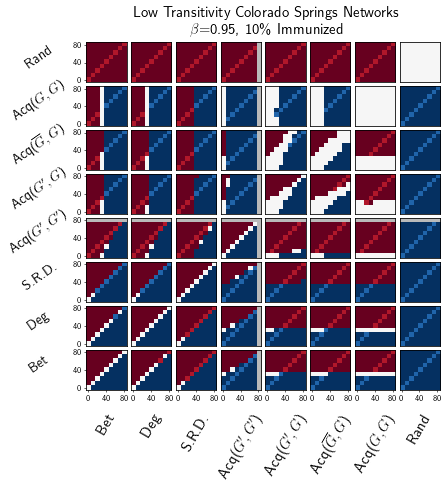

In [103]:
beta= 0.95
gamma=1.0
pctImmunized = .10
folder = 'newLowResults_gamma1_beta20to220'
params2signifArrs[(folder,  pctImmunized, beta, gamma)] = getSignifArrs(folder, pctImmunized, beta, gamma)


title="Low Transitivity Colorado Springs Networks\n" + r'$\beta$='+str(beta)+", "+str(int(100*pctImmunized)) +"\% Immunized"



figFileName="sigs"+folder[:12]+"beta"+pointify(beta)+"gamma"+pointify(gamma)+"pctImmunized"+pointify(pctImmunized)
signifArrs=params2signifArrs[(folder,  pctImmunized, beta, gamma)]
makeSignifPlot(figFileName, signifArrs, title)


In [116]:
beta= 0.95
gamma=1.0
pctImmunized = .10
folder = 'newHighResults_gamma1_beta20to220'
params2signifArrs[(folder,  pctImmunized, beta, gamma)] = getSignifArrs(folder, pctImmunized, beta, gamma)



RandSamp Bet
RandSamp 0.8 ,  Bet 0.8 :  0.0
RandSamp 0.8 ,  Bet 0.7 :  0.0
RandSamp 0.8 ,  Bet 0.6 :  0.0
RandSamp 0.8 ,  Bet 0.5 :  0.0
RandSamp 0.8 ,  Bet 0.4 :  0.0
RandSamp 0.8 ,  Bet 0.3 :  0.0
RandSamp 0.8 ,  Bet 0.2 :  0.0
RandSamp 0.8 ,  Bet 0.1 :  0.0
RandSamp 0.8 ,  Bet 0.0 :  0.0
RandSamp 0.7 ,  Bet 0.8 :  0.0
RandSamp 0.7 ,  Bet 0.7 :  0.0
RandSamp 0.7 ,  Bet 0.6 :  0.0
RandSamp 0.7 ,  Bet 0.5 :  0.0
RandSamp 0.7 ,  Bet 0.4 :  0.0
RandSamp 0.7 ,  Bet 0.3 :  0.0
RandSamp 0.7 ,  Bet 0.2 :  0.0
RandSamp 0.7 ,  Bet 0.1 :  0.0
RandSamp 0.7 ,  Bet 0.0 :  0.0
RandSamp 0.6 ,  Bet 0.8 :  0.0
RandSamp 0.6 ,  Bet 0.7 :  0.0
RandSamp 0.6 ,  Bet 0.6 :  0.0
RandSamp 0.6 ,  Bet 0.5 :  0.0
RandSamp 0.6 ,  Bet 0.4 :  0.0
RandSamp 0.6 ,  Bet 0.3 :  0.0
RandSamp 0.6 ,  Bet 0.2 :  0.0
RandSamp 0.6 ,  Bet 0.1 :  0.0
RandSamp 0.6 ,  Bet 0.0 :  0.0
RandSamp 0.5 ,  Bet 0.8 :  0.0
RandSamp 0.5 ,  Bet 0.7 :  0.0
RandSamp 0.5 ,  Bet 0.6 :  0.0
RandSamp 0.5 ,  Bet 0.5 :  0.0
RandSamp 0.5 ,  Bet 0.4 : 

RandSamp 0.7 ,  acqKK2 0.4 :  0.0
RandSamp 0.7 ,  acqKK2 0.3 :  0.0
RandSamp 0.7 ,  acqKK2 0.2 :  0.0
RandSamp 0.7 ,  acqKK2 0.1 :  0.0
RandSamp 0.7 ,  acqKK2 0.0 :  0.0
RandSamp 0.6 ,  acqKK2 0.8 :  nan
RandSamp 0.6 ,  acqKK2 0.7 :  0.0
RandSamp 0.6 ,  acqKK2 0.6 :  0.0
RandSamp 0.6 ,  acqKK2 0.5 :  0.0
RandSamp 0.6 ,  acqKK2 0.4 :  0.0
RandSamp 0.6 ,  acqKK2 0.3 :  0.0
RandSamp 0.6 ,  acqKK2 0.2 :  0.0
RandSamp 0.6 ,  acqKK2 0.1 :  0.0
RandSamp 0.6 ,  acqKK2 0.0 :  0.0
RandSamp 0.5 ,  acqKK2 0.8 :  nan
RandSamp 0.5 ,  acqKK2 0.7 :  0.0
RandSamp 0.5 ,  acqKK2 0.6 :  0.0
RandSamp 0.5 ,  acqKK2 0.5 :  0.0
RandSamp 0.5 ,  acqKK2 0.4 :  0.0
RandSamp 0.5 ,  acqKK2 0.3 :  0.0
RandSamp 0.5 ,  acqKK2 0.2 :  0.0
RandSamp 0.5 ,  acqKK2 0.1 :  0.0
RandSamp 0.5 ,  acqKK2 0.0 :  0.0
RandSamp 0.4 ,  acqKK2 0.8 :  nan
RandSamp 0.4 ,  acqKK2 0.7 :  0.0
RandSamp 0.4 ,  acqKK2 0.6 :  0.0
RandSamp 0.4 ,  acqKK2 0.5 :  0.0
RandSamp 0.4 ,  acqKK2 0.4 :  0.0
RandSamp 0.4 ,  acqKK2 0.3 :  0.0
RandSamp 0.4 ,

RandSamp 0.8 ,  acqGG2 0.1 :  0.0
RandSamp 0.8 ,  acqGG2 0.0 :  0.0
RandSamp 0.7 ,  acqGG2 0.8 :  0.0
RandSamp 0.7 ,  acqGG2 0.7 :  0.0
RandSamp 0.7 ,  acqGG2 0.6 :  0.0
RandSamp 0.7 ,  acqGG2 0.5 :  0.0
RandSamp 0.7 ,  acqGG2 0.4 :  0.0
RandSamp 0.7 ,  acqGG2 0.3 :  0.0
RandSamp 0.7 ,  acqGG2 0.2 :  0.0
RandSamp 0.7 ,  acqGG2 0.1 :  0.0
RandSamp 0.7 ,  acqGG2 0.0 :  0.0
RandSamp 0.6 ,  acqGG2 0.8 :  0.0
RandSamp 0.6 ,  acqGG2 0.7 :  0.0
RandSamp 0.6 ,  acqGG2 0.6 :  0.0
RandSamp 0.6 ,  acqGG2 0.5 :  0.0
RandSamp 0.6 ,  acqGG2 0.4 :  0.0
RandSamp 0.6 ,  acqGG2 0.3 :  0.0
RandSamp 0.6 ,  acqGG2 0.2 :  0.0
RandSamp 0.6 ,  acqGG2 0.1 :  0.0
RandSamp 0.6 ,  acqGG2 0.0 :  0.0
RandSamp 0.5 ,  acqGG2 0.8 :  0.0
RandSamp 0.5 ,  acqGG2 0.7 :  0.0
RandSamp 0.5 ,  acqGG2 0.6 :  0.0
RandSamp 0.5 ,  acqGG2 0.5 :  0.0
RandSamp 0.5 ,  acqGG2 0.4 :  0.0
RandSamp 0.5 ,  acqGG2 0.3 :  0.0
RandSamp 0.5 ,  acqGG2 0.2 :  0.0
RandSamp 0.5 ,  acqGG2 0.1 :  0.0
RandSamp 0.5 ,  acqGG2 0.0 :  0.0
RandSamp 0.4 ,

acqGG2 0.2 ,  Bet 0.8 :  0.0
acqGG2 0.2 ,  Bet 0.7 :  0.0
acqGG2 0.2 ,  Bet 0.6 :  0.0
acqGG2 0.2 ,  Bet 0.5 :  2.052106187496781e-173
acqGG2 0.2 ,  Bet 0.4 :  1.9057896827157863e-139
acqGG2 0.2 ,  Bet 0.3 :  0.0
acqGG2 0.2 ,  Bet 0.2 :  0.0
acqGG2 0.2 ,  Bet 0.1 :  0.0
acqGG2 0.2 ,  Bet 0.0 :  0.0
acqGG2 0.1 ,  Bet 0.8 :  0.0
acqGG2 0.1 ,  Bet 0.7 :  0.0
acqGG2 0.1 ,  Bet 0.6 :  0.0
acqGG2 0.1 ,  Bet 0.5 :  1.8431090536240623e-191
acqGG2 0.1 ,  Bet 0.4 :  1.829777144428753e-120
acqGG2 0.1 ,  Bet 0.3 :  0.0
acqGG2 0.1 ,  Bet 0.2 :  0.0
acqGG2 0.1 ,  Bet 0.1 :  0.0
acqGG2 0.1 ,  Bet 0.0 :  0.0
acqGG2 0.0 ,  Bet 0.8 :  0.0
acqGG2 0.0 ,  Bet 0.7 :  0.0
acqGG2 0.0 ,  Bet 0.6 :  0.0
acqGG2 0.0 ,  Bet 0.5 :  1.3672502026143966e-179
acqGG2 0.0 ,  Bet 0.4 :  8.916309507054939e-128
acqGG2 0.0 ,  Bet 0.3 :  0.0
acqGG2 0.0 ,  Bet 0.2 :  0.0
acqGG2 0.0 ,  Bet 0.1 :  0.0
acqGG2 0.0 ,  Bet 0.0 :  0.0
acqGG2 DegKK
acqGG2 0.8 ,  DegKK 0.8 :  0.0
acqGG2 0.8 ,  DegKK 0.7 :  0.0
acqGG2 0.8 ,  DegKK 0.6 :

acqGG2 0.2 ,  acqKK2 0.8 :  nan
acqGG2 0.2 ,  acqKK2 0.7 :  0.0
acqGG2 0.2 ,  acqKK2 0.6 :  0.0
acqGG2 0.2 ,  acqKK2 0.5 :  0.0
acqGG2 0.2 ,  acqKK2 0.4 :  0.0
acqGG2 0.2 ,  acqKK2 0.3 :  0.0
acqGG2 0.2 ,  acqKK2 0.2 :  4.07331058053877e-242
acqGG2 0.2 ,  acqKK2 0.1 :  5.6858837051512174e-55
acqGG2 0.2 ,  acqKK2 0.0 :  0.6635320014321642
acqGG2 0.1 ,  acqKK2 0.8 :  nan
acqGG2 0.1 ,  acqKK2 0.7 :  0.0
acqGG2 0.1 ,  acqKK2 0.6 :  0.0
acqGG2 0.1 ,  acqKK2 0.5 :  0.0
acqGG2 0.1 ,  acqKK2 0.4 :  0.0
acqGG2 0.1 ,  acqKK2 0.3 :  0.0
acqGG2 0.1 ,  acqKK2 0.2 :  4.2147218498405416e-262
acqGG2 0.1 ,  acqKK2 0.1 :  5.732447920552408e-66
acqGG2 0.1 ,  acqKK2 0.0 :  0.0366841905952874
acqGG2 0.0 ,  acqKK2 0.8 :  nan
acqGG2 0.0 ,  acqKK2 0.7 :  0.0
acqGG2 0.0 ,  acqKK2 0.6 :  0.0
acqGG2 0.0 ,  acqKK2 0.5 :  0.0
acqGG2 0.0 ,  acqKK2 0.4 :  0.0
acqGG2 0.0 ,  acqKK2 0.3 :  0.0
acqGG2 0.0 ,  acqKK2 0.2 :  2.2828871136113262e-248
acqGG2 0.0 ,  acqKK2 0.1 :  1.6633771929835933e-59
acqGG2 0.0 ,  acqKK2 0.0

acqGG2 0.0 ,  acqKG2_up 0.8 :  3.572577464451095e-22
acqGG2 0.0 ,  acqKG2_up 0.7 :  4.0941463182470175e-08
acqGG2 0.0 ,  acqKG2_up 0.6 :  0.0001400133587518079
acqGG2 0.0 ,  acqKG2_up 0.5 :  0.061926928249213344
acqGG2 0.0 ,  acqKG2_up 0.4 :  0.22601743346563669
acqGG2 0.0 ,  acqKG2_up 0.3 :  0.2798114532111651
acqGG2 0.0 ,  acqKG2_up 0.2 :  0.8030348791137508
acqGG2 0.0 ,  acqKG2_up 0.1 :  0.827890697053842
acqGG2 0.0 ,  acqKG2_up 0.0 :  0.8211941512889206
acqGG2 acqGG2
acqGG2 0.8 ,  acqGG2 0.8 :  1.0
acqGG2 0.8 ,  acqGG2 0.7 :  0.7383893508626606
acqGG2 0.8 ,  acqGG2 0.6 :  0.29650344305614446
acqGG2 0.8 ,  acqGG2 0.5 :  0.5212559736792274
acqGG2 0.8 ,  acqGG2 0.4 :  0.7331796407440831
acqGG2 0.8 ,  acqGG2 0.3 :  0.8059357322750118
acqGG2 0.8 ,  acqGG2 0.2 :  0.385137717633518
acqGG2 0.8 ,  acqGG2 0.1 :  0.42944620045505055
acqGG2 0.8 ,  acqGG2 0.0 :  0.9727565103253704
acqGG2 0.7 ,  acqGG2 0.8 :  0.7383893508626606
acqGG2 0.7 ,  acqGG2 0.7 :  1.0
acqGG2 0.7 ,  acqGG2 0.6 :  0.486324

acqKG2_up 0.4 ,  Bet 0.8 :  0.0
acqKG2_up 0.4 ,  Bet 0.7 :  0.0
acqKG2_up 0.4 ,  Bet 0.6 :  0.0
acqKG2_up 0.4 ,  Bet 0.5 :  7.062484562430643e-192
acqKG2_up 0.4 ,  Bet 0.4 :  1.2266059843175807e-113
acqKG2_up 0.4 ,  Bet 0.3 :  0.0
acqKG2_up 0.4 ,  Bet 0.2 :  0.0
acqKG2_up 0.4 ,  Bet 0.1 :  0.0
acqKG2_up 0.4 ,  Bet 0.0 :  0.0
acqKG2_up 0.3 ,  Bet 0.8 :  0.0
acqKG2_up 0.3 ,  Bet 0.7 :  0.0
acqKG2_up 0.3 ,  Bet 0.6 :  0.0
acqKG2_up 0.3 ,  Bet 0.5 :  1.6258290785083667e-192
acqKG2_up 0.3 ,  Bet 0.4 :  2.162422273721451e-116
acqKG2_up 0.3 ,  Bet 0.3 :  0.0
acqKG2_up 0.3 ,  Bet 0.2 :  0.0
acqKG2_up 0.3 ,  Bet 0.1 :  0.0
acqKG2_up 0.3 ,  Bet 0.0 :  0.0
acqKG2_up 0.2 ,  Bet 0.8 :  0.0
acqKG2_up 0.2 ,  Bet 0.7 :  0.0
acqKG2_up 0.2 ,  Bet 0.6 :  0.0
acqKG2_up 0.2 ,  Bet 0.5 :  6.356574014836953e-182
acqKG2_up 0.2 ,  Bet 0.4 :  1.1078453913553268e-124
acqKG2_up 0.2 ,  Bet 0.3 :  0.0
acqKG2_up 0.2 ,  Bet 0.2 :  0.0
acqKG2_up 0.2 ,  Bet 0.1 :  0.0
acqKG2_up 0.2 ,  Bet 0.0 :  0.0
acqKG2_up 0.1 ,  Be

acqKG2_up 0.7 ,  acqKK2 0.2 :  0.0
acqKG2_up 0.7 ,  acqKK2 0.1 :  2.063946751901349e-102
acqKG2_up 0.7 ,  acqKK2 0.0 :  1.3608187002386376e-11
acqKG2_up 0.6 ,  acqKK2 0.8 :  nan
acqKG2_up 0.6 ,  acqKK2 0.7 :  0.0
acqKG2_up 0.6 ,  acqKK2 0.6 :  0.0
acqKG2_up 0.6 ,  acqKK2 0.5 :  0.0
acqKG2_up 0.6 ,  acqKK2 0.4 :  0.0
acqKG2_up 0.6 ,  acqKK2 0.3 :  0.0
acqKG2_up 0.6 ,  acqKK2 0.2 :  2.756624605988972e-298
acqKG2_up 0.6 ,  acqKK2 0.1 :  6.418319415364184e-88
acqKG2_up 0.6 ,  acqKK2 0.0 :  3.830948072449673e-07
acqKG2_up 0.5 ,  acqKK2 0.8 :  nan
acqKG2_up 0.5 ,  acqKK2 0.7 :  0.0
acqKG2_up 0.5 ,  acqKK2 0.6 :  0.0
acqKG2_up 0.5 ,  acqKK2 0.5 :  0.0
acqKG2_up 0.5 ,  acqKK2 0.4 :  0.0
acqKG2_up 0.5 ,  acqKK2 0.3 :  0.0
acqKG2_up 0.5 ,  acqKK2 0.2 :  1.7274081672358682e-270
acqKG2_up 0.5 ,  acqKK2 0.1 :  2.716524240024743e-72
acqKG2_up 0.5 ,  acqKK2 0.0 :  0.0017734945536135444
acqKG2_up 0.4 ,  acqKK2 0.8 :  nan
acqKG2_up 0.4 ,  acqKK2 0.7 :  0.0
acqKG2_up 0.4 ,  acqKK2 0.6 :  0.0
acqKG2_up 0

acqKG2_up 0.5 ,  acqKG2_up 0.7 :  0.0003178903922783305
acqKG2_up 0.5 ,  acqKG2_up 0.6 :  0.05374457417604973
acqKG2_up 0.5 ,  acqKG2_up 0.5 :  1.0
acqKG2_up 0.5 ,  acqKG2_up 0.4 :  0.5137654542780956
acqKG2_up 0.5 ,  acqKG2_up 0.3 :  0.4279455314970153
acqKG2_up 0.5 ,  acqKG2_up 0.2 :  0.10609892520142117
acqKG2_up 0.5 ,  acqKG2_up 0.1 :  0.09629717391568234
acqKG2_up 0.5 ,  acqKG2_up 0.0 :  0.09746211610335562
acqKG2_up 0.4 ,  acqKG2_up 0.8 :  3.1172545924530135e-17
acqKG2_up 0.4 ,  acqKG2_up 0.7 :  2.0988489540061496e-05
acqKG2_up 0.4 ,  acqKG2_up 0.6 :  0.009795333981947802
acqKG2_up 0.4 ,  acqKG2_up 0.5 :  0.5137654542780956
acqKG2_up 0.4 ,  acqKG2_up 0.4 :  1.0
acqKG2_up 0.4 ,  acqKG2_up 0.3 :  0.8917391253568141
acqKG2_up 0.4 ,  acqKG2_up 0.2 :  0.33667051724349784
acqKG2_up 0.4 ,  acqKG2_up 0.1 :  0.316084232632512
acqKG2_up 0.4 ,  acqKG2_up 0.0 :  0.319357952902921
acqKG2_up 0.3 ,  acqKG2_up 0.8 :  6.564436956128195e-18
acqKG2_up 0.3 ,  acqKG2_up 0.7 :  1.0158310894512644e-05


acqKG2_up 0.4 ,  RandSamp 0.6 :  0.0
acqKG2_up 0.4 ,  RandSamp 0.5 :  0.0
acqKG2_up 0.4 ,  RandSamp 0.4 :  0.0
acqKG2_up 0.4 ,  RandSamp 0.3 :  0.0
acqKG2_up 0.4 ,  RandSamp 0.2 :  0.0
acqKG2_up 0.4 ,  RandSamp 0.1 :  0.0
acqKG2_up 0.4 ,  RandSamp 0.0 :  0.0
acqKG2_up 0.3 ,  RandSamp 0.8 :  0.0
acqKG2_up 0.3 ,  RandSamp 0.7 :  0.0
acqKG2_up 0.3 ,  RandSamp 0.6 :  0.0
acqKG2_up 0.3 ,  RandSamp 0.5 :  0.0
acqKG2_up 0.3 ,  RandSamp 0.4 :  0.0
acqKG2_up 0.3 ,  RandSamp 0.3 :  0.0
acqKG2_up 0.3 ,  RandSamp 0.2 :  0.0
acqKG2_up 0.3 ,  RandSamp 0.1 :  0.0
acqKG2_up 0.3 ,  RandSamp 0.0 :  0.0
acqKG2_up 0.2 ,  RandSamp 0.8 :  0.0
acqKG2_up 0.2 ,  RandSamp 0.7 :  0.0
acqKG2_up 0.2 ,  RandSamp 0.6 :  0.0
acqKG2_up 0.2 ,  RandSamp 0.5 :  0.0
acqKG2_up 0.2 ,  RandSamp 0.4 :  0.0
acqKG2_up 0.2 ,  RandSamp 0.3 :  0.0
acqKG2_up 0.2 ,  RandSamp 0.2 :  0.0
acqKG2_up 0.2 ,  RandSamp 0.1 :  0.0
acqKG2_up 0.2 ,  RandSamp 0.0 :  0.0
acqKG2_up 0.1 ,  RandSamp 0.8 :  0.0
acqKG2_up 0.1 ,  RandSamp 0.7 :  0.0
a

acqKG2 0.4 ,  Srd 0.8 :  0.0
acqKG2 0.4 ,  Srd 0.7 :  0.0
acqKG2 0.4 ,  Srd 0.6 :  0.0
acqKG2 0.4 ,  Srd 0.5 :  0.3235316118604399
acqKG2 0.4 ,  Srd 0.4 :  0.0
acqKG2 0.4 ,  Srd 0.3 :  0.0
acqKG2 0.4 ,  Srd 0.2 :  0.0
acqKG2 0.4 ,  Srd 0.1 :  0.0
acqKG2 0.4 ,  Srd 0.0 :  0.0
acqKG2 0.3 ,  Srd 0.8 :  0.0
acqKG2 0.3 ,  Srd 0.7 :  0.0
acqKG2 0.3 ,  Srd 0.6 :  0.0
acqKG2 0.3 ,  Srd 0.5 :  5.478670848888296e-11
acqKG2 0.3 ,  Srd 0.4 :  0.0
acqKG2 0.3 ,  Srd 0.3 :  0.0
acqKG2 0.3 ,  Srd 0.2 :  0.0
acqKG2 0.3 ,  Srd 0.1 :  0.0
acqKG2 0.3 ,  Srd 0.0 :  0.0
acqKG2 0.2 ,  Srd 0.8 :  0.0
acqKG2 0.2 ,  Srd 0.7 :  0.0
acqKG2 0.2 ,  Srd 0.6 :  0.0
acqKG2 0.2 ,  Srd 0.5 :  2.127748355131358e-28
acqKG2 0.2 ,  Srd 0.4 :  0.0
acqKG2 0.2 ,  Srd 0.3 :  0.0
acqKG2 0.2 ,  Srd 0.2 :  0.0
acqKG2 0.2 ,  Srd 0.1 :  0.0
acqKG2 0.2 ,  Srd 0.0 :  0.0
acqKG2 0.1 ,  Srd 0.8 :  0.0
acqKG2 0.1 ,  Srd 0.7 :  0.0
acqKG2 0.1 ,  Srd 0.6 :  0.0
acqKG2 0.1 ,  Srd 0.5 :  2.4197321508995344e-50
acqKG2 0.1 ,  Srd 0.4 :  1.1597

acqKG2 0.8 ,  acqKG2_up 0.3 :  0.0
acqKG2 0.8 ,  acqKG2_up 0.2 :  0.0
acqKG2 0.8 ,  acqKG2_up 0.1 :  0.0
acqKG2 0.8 ,  acqKG2_up 0.0 :  0.0
acqKG2 0.7 ,  acqKG2_up 0.8 :  0.0
acqKG2 0.7 ,  acqKG2_up 0.7 :  0.0
acqKG2 0.7 ,  acqKG2_up 0.6 :  0.0
acqKG2 0.7 ,  acqKG2_up 0.5 :  0.0
acqKG2 0.7 ,  acqKG2_up 0.4 :  0.0
acqKG2 0.7 ,  acqKG2_up 0.3 :  0.0
acqKG2 0.7 ,  acqKG2_up 0.2 :  0.0
acqKG2 0.7 ,  acqKG2_up 0.1 :  0.0
acqKG2 0.7 ,  acqKG2_up 0.0 :  0.0
acqKG2 0.6 ,  acqKG2_up 0.8 :  0.0
acqKG2 0.6 ,  acqKG2_up 0.7 :  8.911208706734383e-284
acqKG2 0.6 ,  acqKG2_up 0.6 :  3.05833142255507e-261
acqKG2 0.6 ,  acqKG2_up 0.5 :  1.6954866941255852e-235
acqKG2 0.6 ,  acqKG2_up 0.4 :  2.3517419084638365e-227
acqKG2 0.6 ,  acqKG2_up 0.3 :  3.801262383122291e-228
acqKG2 0.6 ,  acqKG2_up 0.2 :  3.824747993527404e-217
acqKG2 0.6 ,  acqKG2_up 0.1 :  3.180531603383484e-220
acqKG2 0.6 ,  acqKG2_up 0.0 :  5.850955972548521e-221
acqKG2 0.5 ,  acqKG2_up 0.8 :  2.603235074325394e-232
acqKG2 0.5 ,  acqKG2_up

acqKG2 0.6 ,  RandSamp 0.3 :  0.0
acqKG2 0.6 ,  RandSamp 0.2 :  0.0
acqKG2 0.6 ,  RandSamp 0.1 :  0.0
acqKG2 0.6 ,  RandSamp 0.0 :  0.0
acqKG2 0.5 ,  RandSamp 0.8 :  0.0
acqKG2 0.5 ,  RandSamp 0.7 :  0.0
acqKG2 0.5 ,  RandSamp 0.6 :  0.0
acqKG2 0.5 ,  RandSamp 0.5 :  0.0
acqKG2 0.5 ,  RandSamp 0.4 :  0.0
acqKG2 0.5 ,  RandSamp 0.3 :  0.0
acqKG2 0.5 ,  RandSamp 0.2 :  0.0
acqKG2 0.5 ,  RandSamp 0.1 :  0.0
acqKG2 0.5 ,  RandSamp 0.0 :  0.0
acqKG2 0.4 ,  RandSamp 0.8 :  0.0
acqKG2 0.4 ,  RandSamp 0.7 :  0.0
acqKG2 0.4 ,  RandSamp 0.6 :  0.0
acqKG2 0.4 ,  RandSamp 0.5 :  0.0
acqKG2 0.4 ,  RandSamp 0.4 :  0.0
acqKG2 0.4 ,  RandSamp 0.3 :  0.0
acqKG2 0.4 ,  RandSamp 0.2 :  0.0
acqKG2 0.4 ,  RandSamp 0.1 :  0.0
acqKG2 0.4 ,  RandSamp 0.0 :  0.0
acqKG2 0.3 ,  RandSamp 0.8 :  0.0
acqKG2 0.3 ,  RandSamp 0.7 :  0.0
acqKG2 0.3 ,  RandSamp 0.6 :  0.0
acqKG2 0.3 ,  RandSamp 0.5 :  0.0
acqKG2 0.3 ,  RandSamp 0.4 :  0.0
acqKG2 0.3 ,  RandSamp 0.3 :  0.0
acqKG2 0.3 ,  RandSamp 0.2 :  0.0
acqKG2 0.3 ,  

acqKK2 0.4 ,  Srd 0.8 :  0.0
acqKK2 0.4 ,  Srd 0.7 :  0.0
acqKK2 0.4 ,  Srd 0.6 :  1.2007641807714444e-13
acqKK2 0.4 ,  Srd 0.5 :  0.0
acqKK2 0.4 ,  Srd 0.4 :  0.0
acqKK2 0.4 ,  Srd 0.3 :  0.0
acqKK2 0.4 ,  Srd 0.2 :  0.0
acqKK2 0.4 ,  Srd 0.1 :  0.0
acqKK2 0.4 ,  Srd 0.0 :  0.0
acqKK2 0.3 ,  Srd 0.8 :  0.0
acqKK2 0.3 ,  Srd 0.7 :  0.0
acqKK2 0.3 ,  Srd 0.6 :  4.837741160583609e-46
acqKK2 0.3 ,  Srd 0.5 :  2.9514124774145336e-269
acqKK2 0.3 ,  Srd 0.4 :  0.0
acqKK2 0.3 ,  Srd 0.3 :  0.0
acqKK2 0.3 ,  Srd 0.2 :  0.0
acqKK2 0.3 ,  Srd 0.1 :  0.0
acqKK2 0.3 ,  Srd 0.0 :  0.0
acqKK2 0.2 ,  Srd 0.8 :  0.0
acqKK2 0.2 ,  Srd 0.7 :  0.0
acqKK2 0.2 ,  Srd 0.6 :  9.553878405438813e-241
acqKK2 0.2 ,  Srd 0.5 :  6.087913837597341e-61
acqKK2 0.2 ,  Srd 0.4 :  0.0
acqKK2 0.2 ,  Srd 0.3 :  0.0
acqKK2 0.2 ,  Srd 0.2 :  0.0
acqKK2 0.2 ,  Srd 0.1 :  0.0
acqKK2 0.2 ,  Srd 0.0 :  0.0
acqKK2 0.1 ,  Srd 0.8 :  0.0
acqKK2 0.1 ,  Srd 0.7 :  0.0
acqKK2 0.1 ,  Srd 0.6 :  0.0
acqKK2 0.1 ,  Srd 0.5 :  0.037947095

acqKK2 0.6 ,  acqKG2_up 0.4 :  0.0
acqKK2 0.6 ,  acqKG2_up 0.3 :  0.0
acqKK2 0.6 ,  acqKG2_up 0.2 :  0.0
acqKK2 0.6 ,  acqKG2_up 0.1 :  0.0
acqKK2 0.6 ,  acqKG2_up 0.0 :  0.0
acqKK2 0.5 ,  acqKG2_up 0.8 :  0.0
acqKK2 0.5 ,  acqKG2_up 0.7 :  0.0
acqKK2 0.5 ,  acqKG2_up 0.6 :  0.0
acqKK2 0.5 ,  acqKG2_up 0.5 :  0.0
acqKK2 0.5 ,  acqKG2_up 0.4 :  0.0
acqKK2 0.5 ,  acqKG2_up 0.3 :  0.0
acqKK2 0.5 ,  acqKG2_up 0.2 :  0.0
acqKK2 0.5 ,  acqKG2_up 0.1 :  0.0
acqKK2 0.5 ,  acqKG2_up 0.0 :  0.0
acqKK2 0.4 ,  acqKG2_up 0.8 :  0.0
acqKK2 0.4 ,  acqKG2_up 0.7 :  0.0
acqKK2 0.4 ,  acqKG2_up 0.6 :  0.0
acqKK2 0.4 ,  acqKG2_up 0.5 :  0.0
acqKK2 0.4 ,  acqKG2_up 0.4 :  0.0
acqKK2 0.4 ,  acqKG2_up 0.3 :  0.0
acqKK2 0.4 ,  acqKG2_up 0.2 :  0.0
acqKK2 0.4 ,  acqKG2_up 0.1 :  0.0
acqKK2 0.4 ,  acqKG2_up 0.0 :  0.0
acqKK2 0.3 ,  acqKG2_up 0.8 :  0.0
acqKK2 0.3 ,  acqKG2_up 0.7 :  0.0
acqKK2 0.3 ,  acqKG2_up 0.6 :  0.0
acqKK2 0.3 ,  acqKG2_up 0.5 :  0.0
acqKK2 0.3 ,  acqKG2_up 0.4 :  0.0
acqKK2 0.3 ,  acqKG2

acqKK2 0.0 ,  RandSamp 0.3 :  0.0
acqKK2 0.0 ,  RandSamp 0.2 :  0.0
acqKK2 0.0 ,  RandSamp 0.1 :  0.0
acqKK2 0.0 ,  RandSamp 0.0 :  0.0
Srd Bet
Srd 0.8 ,  Bet 0.8 :  0.0
Srd 0.8 ,  Bet 0.7 :  5.687429696462599e-251
Srd 0.8 ,  Bet 0.6 :  0.0
Srd 0.8 ,  Bet 0.5 :  0.0
Srd 0.8 ,  Bet 0.4 :  0.0
Srd 0.8 ,  Bet 0.3 :  0.0
Srd 0.8 ,  Bet 0.2 :  0.0
Srd 0.8 ,  Bet 0.1 :  0.0
Srd 0.8 ,  Bet 0.0 :  0.0
Srd 0.7 ,  Bet 0.8 :  0.0
Srd 0.7 ,  Bet 0.7 :  6.084126924225806e-100
Srd 0.7 ,  Bet 0.6 :  1.375807880524018e-308
Srd 0.7 ,  Bet 0.5 :  0.0
Srd 0.7 ,  Bet 0.4 :  0.0
Srd 0.7 ,  Bet 0.3 :  0.0
Srd 0.7 ,  Bet 0.2 :  0.0
Srd 0.7 ,  Bet 0.1 :  0.0
Srd 0.7 ,  Bet 0.0 :  0.0
Srd 0.6 ,  Bet 0.8 :  0.0
Srd 0.6 ,  Bet 0.7 :  0.0
Srd 0.6 ,  Bet 0.6 :  4.28800787289172e-40
Srd 0.6 ,  Bet 0.5 :  0.0
Srd 0.6 ,  Bet 0.4 :  0.0
Srd 0.6 ,  Bet 0.3 :  0.0
Srd 0.6 ,  Bet 0.2 :  0.0
Srd 0.6 ,  Bet 0.1 :  0.0
Srd 0.6 ,  Bet 0.0 :  0.0
Srd 0.5 ,  Bet 0.8 :  0.0
Srd 0.5 ,  Bet 0.7 :  0.0
Srd 0.5 ,  Bet 0.6 :  0.0
Sr

Srd 0.4 ,  acqKK2 0.4 :  0.0
Srd 0.4 ,  acqKK2 0.3 :  0.0
Srd 0.4 ,  acqKK2 0.2 :  0.0
Srd 0.4 ,  acqKK2 0.1 :  0.0
Srd 0.4 ,  acqKK2 0.0 :  7.143032319291178e-238
Srd 0.3 ,  acqKK2 0.8 :  nan
Srd 0.3 ,  acqKK2 0.7 :  0.0
Srd 0.3 ,  acqKK2 0.6 :  0.0
Srd 0.3 ,  acqKK2 0.5 :  0.0
Srd 0.3 ,  acqKK2 0.4 :  0.0
Srd 0.3 ,  acqKK2 0.3 :  0.0
Srd 0.3 ,  acqKK2 0.2 :  0.0
Srd 0.3 ,  acqKK2 0.1 :  0.0
Srd 0.3 ,  acqKK2 0.0 :  0.0
Srd 0.2 ,  acqKK2 0.8 :  nan
Srd 0.2 ,  acqKK2 0.7 :  0.0
Srd 0.2 ,  acqKK2 0.6 :  0.0
Srd 0.2 ,  acqKK2 0.5 :  0.0
Srd 0.2 ,  acqKK2 0.4 :  0.0
Srd 0.2 ,  acqKK2 0.3 :  0.0
Srd 0.2 ,  acqKK2 0.2 :  0.0
Srd 0.2 ,  acqKK2 0.1 :  0.0
Srd 0.2 ,  acqKK2 0.0 :  0.0
Srd 0.1 ,  acqKK2 0.8 :  nan
Srd 0.1 ,  acqKK2 0.7 :  0.0
Srd 0.1 ,  acqKK2 0.6 :  0.0
Srd 0.1 ,  acqKK2 0.5 :  0.0
Srd 0.1 ,  acqKK2 0.4 :  0.0
Srd 0.1 ,  acqKK2 0.3 :  0.0
Srd 0.1 ,  acqKK2 0.2 :  0.0
Srd 0.1 ,  acqKK2 0.1 :  0.0
Srd 0.1 ,  acqKK2 0.0 :  0.0
Srd 0.0 ,  acqKK2 0.8 :  nan
Srd 0.0 ,  acqKK2 0.7 : 

Srd 0.3 ,  acqGG2 0.8 :  0.0
Srd 0.3 ,  acqGG2 0.7 :  0.0
Srd 0.3 ,  acqGG2 0.6 :  0.0
Srd 0.3 ,  acqGG2 0.5 :  0.0
Srd 0.3 ,  acqGG2 0.4 :  0.0
Srd 0.3 ,  acqGG2 0.3 :  0.0
Srd 0.3 ,  acqGG2 0.2 :  0.0
Srd 0.3 ,  acqGG2 0.1 :  0.0
Srd 0.3 ,  acqGG2 0.0 :  0.0
Srd 0.2 ,  acqGG2 0.8 :  0.0
Srd 0.2 ,  acqGG2 0.7 :  0.0
Srd 0.2 ,  acqGG2 0.6 :  0.0
Srd 0.2 ,  acqGG2 0.5 :  0.0
Srd 0.2 ,  acqGG2 0.4 :  0.0
Srd 0.2 ,  acqGG2 0.3 :  0.0
Srd 0.2 ,  acqGG2 0.2 :  0.0
Srd 0.2 ,  acqGG2 0.1 :  0.0
Srd 0.2 ,  acqGG2 0.0 :  0.0
Srd 0.1 ,  acqGG2 0.8 :  0.0
Srd 0.1 ,  acqGG2 0.7 :  0.0
Srd 0.1 ,  acqGG2 0.6 :  0.0
Srd 0.1 ,  acqGG2 0.5 :  0.0
Srd 0.1 ,  acqGG2 0.4 :  0.0
Srd 0.1 ,  acqGG2 0.3 :  0.0
Srd 0.1 ,  acqGG2 0.2 :  0.0
Srd 0.1 ,  acqGG2 0.1 :  0.0
Srd 0.1 ,  acqGG2 0.0 :  0.0
Srd 0.0 ,  acqGG2 0.8 :  0.0
Srd 0.0 ,  acqGG2 0.7 :  0.0
Srd 0.0 ,  acqGG2 0.6 :  0.0
Srd 0.0 ,  acqGG2 0.5 :  0.0
Srd 0.0 ,  acqGG2 0.4 :  0.0
Srd 0.0 ,  acqGG2 0.3 :  0.0
Srd 0.0 ,  acqGG2 0.2 :  0.0
Srd 0.0 ,  acq

DegKK 0.8 ,  Srd 0.8 :  4.664204347339953e-193
DegKK 0.8 ,  Srd 0.7 :  0.0
DegKK 0.8 ,  Srd 0.6 :  0.0
DegKK 0.8 ,  Srd 0.5 :  0.0
DegKK 0.8 ,  Srd 0.4 :  0.0
DegKK 0.8 ,  Srd 0.3 :  0.0
DegKK 0.8 ,  Srd 0.2 :  0.0
DegKK 0.8 ,  Srd 0.1 :  0.0
DegKK 0.8 ,  Srd 0.0 :  0.0
DegKK 0.7 ,  Srd 0.8 :  1.651508793912978e-231
DegKK 0.7 ,  Srd 0.7 :  1.598683322227379e-113
DegKK 0.7 ,  Srd 0.6 :  0.0
DegKK 0.7 ,  Srd 0.5 :  0.0
DegKK 0.7 ,  Srd 0.4 :  0.0
DegKK 0.7 ,  Srd 0.3 :  0.0
DegKK 0.7 ,  Srd 0.2 :  0.0
DegKK 0.7 ,  Srd 0.1 :  0.0
DegKK 0.7 ,  Srd 0.0 :  0.0
DegKK 0.6 ,  Srd 0.8 :  0.0
DegKK 0.6 ,  Srd 0.7 :  2.526290606536755e-221
DegKK 0.6 ,  Srd 0.6 :  1.4093587389535208e-85
DegKK 0.6 ,  Srd 0.5 :  0.0
DegKK 0.6 ,  Srd 0.4 :  0.0
DegKK 0.6 ,  Srd 0.3 :  0.0
DegKK 0.6 ,  Srd 0.2 :  0.0
DegKK 0.6 ,  Srd 0.1 :  0.0
DegKK 0.6 ,  Srd 0.0 :  0.0
DegKK 0.5 ,  Srd 0.8 :  0.0
DegKK 0.5 ,  Srd 0.7 :  0.0
DegKK 0.5 ,  Srd 0.6 :  3.3696018635977364e-259
DegKK 0.5 ,  Srd 0.5 :  3.3413969661719646e-6

DegKK 0.8 ,  acqKG2_up 0.4 :  0.0
DegKK 0.8 ,  acqKG2_up 0.3 :  0.0
DegKK 0.8 ,  acqKG2_up 0.2 :  0.0
DegKK 0.8 ,  acqKG2_up 0.1 :  0.0
DegKK 0.8 ,  acqKG2_up 0.0 :  0.0
DegKK 0.7 ,  acqKG2_up 0.8 :  0.0
DegKK 0.7 ,  acqKG2_up 0.7 :  0.0
DegKK 0.7 ,  acqKG2_up 0.6 :  0.0
DegKK 0.7 ,  acqKG2_up 0.5 :  0.0
DegKK 0.7 ,  acqKG2_up 0.4 :  0.0
DegKK 0.7 ,  acqKG2_up 0.3 :  0.0
DegKK 0.7 ,  acqKG2_up 0.2 :  0.0
DegKK 0.7 ,  acqKG2_up 0.1 :  0.0
DegKK 0.7 ,  acqKG2_up 0.0 :  0.0
DegKK 0.6 ,  acqKG2_up 0.8 :  0.0
DegKK 0.6 ,  acqKG2_up 0.7 :  0.0
DegKK 0.6 ,  acqKG2_up 0.6 :  0.0
DegKK 0.6 ,  acqKG2_up 0.5 :  0.0
DegKK 0.6 ,  acqKG2_up 0.4 :  0.0
DegKK 0.6 ,  acqKG2_up 0.3 :  0.0
DegKK 0.6 ,  acqKG2_up 0.2 :  0.0
DegKK 0.6 ,  acqKG2_up 0.1 :  0.0
DegKK 0.6 ,  acqKG2_up 0.0 :  0.0
DegKK 0.5 ,  acqKG2_up 0.8 :  0.0
DegKK 0.5 ,  acqKG2_up 0.7 :  0.0
DegKK 0.5 ,  acqKG2_up 0.6 :  5.460121004607085e-303
DegKK 0.5 ,  acqKG2_up 0.5 :  1.7900220659291812e-274
DegKK 0.5 ,  acqKG2_up 0.4 :  1.76291628890

Bet 0.8 ,  Bet 0.8 :  1.0
Bet 0.8 ,  Bet 0.7 :  0.0
Bet 0.8 ,  Bet 0.6 :  0.0
Bet 0.8 ,  Bet 0.5 :  0.0
Bet 0.8 ,  Bet 0.4 :  0.0
Bet 0.8 ,  Bet 0.3 :  0.0
Bet 0.8 ,  Bet 0.2 :  0.0
Bet 0.8 ,  Bet 0.1 :  0.0
Bet 0.8 ,  Bet 0.0 :  0.0
Bet 0.7 ,  Bet 0.8 :  0.0
Bet 0.7 ,  Bet 0.7 :  1.0
Bet 0.7 ,  Bet 0.6 :  0.0
Bet 0.7 ,  Bet 0.5 :  0.0
Bet 0.7 ,  Bet 0.4 :  0.0
Bet 0.7 ,  Bet 0.3 :  0.0
Bet 0.7 ,  Bet 0.2 :  0.0
Bet 0.7 ,  Bet 0.1 :  0.0
Bet 0.7 ,  Bet 0.0 :  0.0
Bet 0.6 ,  Bet 0.8 :  0.0
Bet 0.6 ,  Bet 0.7 :  0.0
Bet 0.6 ,  Bet 0.6 :  1.0
Bet 0.6 ,  Bet 0.5 :  0.0
Bet 0.6 ,  Bet 0.4 :  0.0
Bet 0.6 ,  Bet 0.3 :  0.0
Bet 0.6 ,  Bet 0.2 :  0.0
Bet 0.6 ,  Bet 0.1 :  0.0
Bet 0.6 ,  Bet 0.0 :  0.0
Bet 0.5 ,  Bet 0.8 :  0.0
Bet 0.5 ,  Bet 0.7 :  0.0
Bet 0.5 ,  Bet 0.6 :  0.0
Bet 0.5 ,  Bet 0.5 :  1.0
Bet 0.5 ,  Bet 0.4 :  0.0
Bet 0.5 ,  Bet 0.3 :  0.0
Bet 0.5 ,  Bet 0.2 :  0.0
Bet 0.5 ,  Bet 0.1 :  0.0
Bet 0.5 ,  Bet 0.0 :  0.0
Bet 0.4 ,  Bet 0.8 :  0.0
Bet 0.4 ,  Bet 0.7 :  0.0
Bet 0.4 ,  B

Bet 0.3 ,  acqKK2 0.8 :  nan
Bet 0.3 ,  acqKK2 0.7 :  0.0
Bet 0.3 ,  acqKK2 0.6 :  0.0
Bet 0.3 ,  acqKK2 0.5 :  0.0
Bet 0.3 ,  acqKK2 0.4 :  0.0
Bet 0.3 ,  acqKK2 0.3 :  0.0
Bet 0.3 ,  acqKK2 0.2 :  0.0
Bet 0.3 ,  acqKK2 0.1 :  0.0
Bet 0.3 ,  acqKK2 0.0 :  0.0
Bet 0.2 ,  acqKK2 0.8 :  nan
Bet 0.2 ,  acqKK2 0.7 :  0.0
Bet 0.2 ,  acqKK2 0.6 :  0.0
Bet 0.2 ,  acqKK2 0.5 :  0.0
Bet 0.2 ,  acqKK2 0.4 :  0.0
Bet 0.2 ,  acqKK2 0.3 :  0.0
Bet 0.2 ,  acqKK2 0.2 :  0.0
Bet 0.2 ,  acqKK2 0.1 :  0.0
Bet 0.2 ,  acqKK2 0.0 :  0.0
Bet 0.1 ,  acqKK2 0.8 :  nan
Bet 0.1 ,  acqKK2 0.7 :  0.0
Bet 0.1 ,  acqKK2 0.6 :  0.0
Bet 0.1 ,  acqKK2 0.5 :  0.0
Bet 0.1 ,  acqKK2 0.4 :  0.0
Bet 0.1 ,  acqKK2 0.3 :  0.0
Bet 0.1 ,  acqKK2 0.2 :  0.0
Bet 0.1 ,  acqKK2 0.1 :  0.0
Bet 0.1 ,  acqKK2 0.0 :  0.0
Bet 0.0 ,  acqKK2 0.8 :  nan
Bet 0.0 ,  acqKK2 0.7 :  0.0
Bet 0.0 ,  acqKK2 0.6 :  0.0
Bet 0.0 ,  acqKK2 0.5 :  0.0
Bet 0.0 ,  acqKK2 0.4 :  0.0
Bet 0.0 ,  acqKK2 0.3 :  0.0
Bet 0.0 ,  acqKK2 0.2 :  0.0
Bet 0.0 ,  acq

Bet 0.3 ,  acqGG2 0.3 :  0.0
Bet 0.3 ,  acqGG2 0.2 :  0.0
Bet 0.3 ,  acqGG2 0.1 :  0.0
Bet 0.3 ,  acqGG2 0.0 :  0.0
Bet 0.2 ,  acqGG2 0.8 :  0.0
Bet 0.2 ,  acqGG2 0.7 :  0.0
Bet 0.2 ,  acqGG2 0.6 :  0.0
Bet 0.2 ,  acqGG2 0.5 :  0.0
Bet 0.2 ,  acqGG2 0.4 :  0.0
Bet 0.2 ,  acqGG2 0.3 :  0.0
Bet 0.2 ,  acqGG2 0.2 :  0.0
Bet 0.2 ,  acqGG2 0.1 :  0.0
Bet 0.2 ,  acqGG2 0.0 :  0.0
Bet 0.1 ,  acqGG2 0.8 :  0.0
Bet 0.1 ,  acqGG2 0.7 :  0.0
Bet 0.1 ,  acqGG2 0.6 :  0.0
Bet 0.1 ,  acqGG2 0.5 :  0.0
Bet 0.1 ,  acqGG2 0.4 :  0.0
Bet 0.1 ,  acqGG2 0.3 :  0.0
Bet 0.1 ,  acqGG2 0.2 :  0.0
Bet 0.1 ,  acqGG2 0.1 :  0.0
Bet 0.1 ,  acqGG2 0.0 :  0.0
Bet 0.0 ,  acqGG2 0.8 :  0.0
Bet 0.0 ,  acqGG2 0.7 :  0.0
Bet 0.0 ,  acqGG2 0.6 :  0.0
Bet 0.0 ,  acqGG2 0.5 :  0.0
Bet 0.0 ,  acqGG2 0.4 :  0.0
Bet 0.0 ,  acqGG2 0.3 :  0.0
Bet 0.0 ,  acqGG2 0.2 :  0.0
Bet 0.0 ,  acqGG2 0.1 :  0.0
Bet 0.0 ,  acqGG2 0.0 :  0.0
Bet RandSamp
Bet 0.8 ,  RandSamp 0.8 :  0.0
Bet 0.8 ,  RandSamp 0.7 :  0.0
Bet 0.8 ,  RandSamp 0.6 : 

1
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.1 0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.1 0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.1 0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.1 0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.1 0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.  0.1 0. ]
 [0.  0.  0.  0.  0.  0.  0.  0.  0.1]]
2
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.1 0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.1 0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.1 0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.1 0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.1 0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.  0.1 0. ]
 [0.  0.  0.  0.  0.  0.  0.  0.  0.1]]
3
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.1 0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.1 0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.1 0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.1 0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.1 0.  0. ]
 [0.  0.  0.  0. 

21
[[0.9 1.  1.  1.  1.  1.  1.  1.  1. ]
 [1.  0.9 1.  1.  1.  1.  1.  1.  1. ]
 [1.  1.  0.9 1.  1.  1.  1.  1.  0.5]
 [1.  1.  1.  0.9 1.  1.  1.  1.  0.5]
 [1.  1.  1.  1.  0.9 1.  1.  1.  0.5]
 [1.  1.  1.  1.  1.  0.9 1.  0.5 0.5]
 [1.  1.  1.  1.  1.  1.  0.9 0.5 0.5]
 [1.  1.  1.  1.  1.  1.  1.  0.5 0.5]
 [1.  1.  1.  1.  1.  1.  1.  0.5 0.5]]
22
[[0.5 0.5 1.  1.  1.  1.  1.  1.  1. ]
 [0.5 0.5 0.5 0.5 0.5 0.5 1.  1.  1. ]
 [0.  0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [0.  0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [0.  0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [0.  0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [0.  0.  0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [0.  0.  0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [0.  0.  0.5 0.5 0.5 0.5 0.5 0.5 0.5]]
23
[[0.9 1.  1.  1.  1.  1.  1.  1.  1. ]
 [1.  0.9 1.  1.  1.  1.  1.  0.5 1. ]
 [0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [0.5 0.5 0.5 

52
[[0.43359375 0.         0.         0.         0.         0.
  0.         0.         0.        ]
 [0.43359375 0.9        0.         0.         0.         0.
  0.         0.         0.        ]
 [0.43359375 1.         0.9        1.         0.         0.
  0.         0.         0.        ]
 [0.43359375 1.         1.         0.9        1.         1.
  0.5        0.         0.        ]
 [0.43359375 1.         1.         1.         0.9        1.
  1.         1.         1.        ]
 [0.43359375 1.         1.         1.         1.         0.9
  1.         1.         1.        ]
 [0.43359375 1.         1.         1.         1.         1.
  0.9        1.         1.        ]
 [0.43359375 1.         1.         1.         1.         1.
  1.         0.9        1.        ]
 [0.43359375 1.         1.         1.         1.         1.
  1.         1.         0.9       ]]
53
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.1 0.  0.  0.  0.  0.  0. ]
 [1.  1.  0

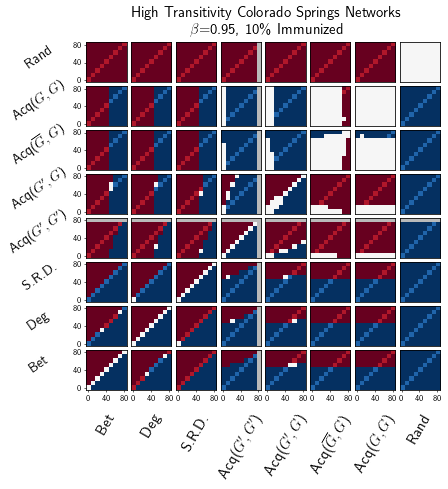

In [117]:



title="High Transitivity Colorado Springs Networks\n" + r'$\beta$='+str(beta)+", "+str(int(100*pctImmunized)) +"\% Immunized"

figFileName="sigs"+folder[:12]+"beta"+pointify(beta)+"gamma"+pointify(gamma)+"pctImmunized"+pointify(pctImmunized)
signifArrs=params2signifArrs[(folder,  pctImmunized, beta, gamma)]
makeSignifPlot(figFileName, signifArrs, title)


### Supp. Fig. 6.i

In [12]:
beta= 0.95
gamma=1.0
pctImmunized = .05
folder = 'allMedResults5and15'
params2signifArrs[(folder,  pctImmunized, beta, gamma)] = getSignifArrs(folder, pctImmunized, beta, gamma)




RandSamp Bet
RandSamp 0.8 ,  Bet 0.8 :  0.0
RandSamp 0.8 ,  Bet 0.7 :  0.0
RandSamp 0.8 ,  Bet 0.6 :  0.0
RandSamp 0.8 ,  Bet 0.5 :  0.0
RandSamp 0.8 ,  Bet 0.4 :  0.0
RandSamp 0.8 ,  Bet 0.3 :  0.0
RandSamp 0.8 ,  Bet 0.2 :  0.0
RandSamp 0.8 ,  Bet 0.1 :  0.0
RandSamp 0.8 ,  Bet 0.0 :  0.0
RandSamp 0.7 ,  Bet 0.8 :  0.0
RandSamp 0.7 ,  Bet 0.7 :  0.0
RandSamp 0.7 ,  Bet 0.6 :  0.0
RandSamp 0.7 ,  Bet 0.5 :  0.0
RandSamp 0.7 ,  Bet 0.4 :  0.0
RandSamp 0.7 ,  Bet 0.3 :  0.0
RandSamp 0.7 ,  Bet 0.2 :  0.0
RandSamp 0.7 ,  Bet 0.1 :  0.0
RandSamp 0.7 ,  Bet 0.0 :  0.0
RandSamp 0.6 ,  Bet 0.8 :  0.0
RandSamp 0.6 ,  Bet 0.7 :  0.0
RandSamp 0.6 ,  Bet 0.6 :  0.0
RandSamp 0.6 ,  Bet 0.5 :  0.0
RandSamp 0.6 ,  Bet 0.4 :  0.0
RandSamp 0.6 ,  Bet 0.3 :  0.0
RandSamp 0.6 ,  Bet 0.2 :  0.0
RandSamp 0.6 ,  Bet 0.1 :  0.0
RandSamp 0.6 ,  Bet 0.0 :  0.0
RandSamp 0.5 ,  Bet 0.8 :  0.0
RandSamp 0.5 ,  Bet 0.7 :  0.0
RandSamp 0.5 ,  Bet 0.6 :  0.0
RandSamp 0.5 ,  Bet 0.5 :  0.0
RandSamp 0.5 ,  Bet 0.4 : 

RandSamp 0.7 ,  acqKK2 0.4 :  0.0
RandSamp 0.7 ,  acqKK2 0.3 :  0.0
RandSamp 0.7 ,  acqKK2 0.2 :  0.0
RandSamp 0.7 ,  acqKK2 0.1 :  0.0
RandSamp 0.7 ,  acqKK2 0.0 :  0.0
RandSamp 0.6 ,  acqKK2 0.8 :  0.0
RandSamp 0.6 ,  acqKK2 0.7 :  0.0
RandSamp 0.6 ,  acqKK2 0.6 :  0.0
RandSamp 0.6 ,  acqKK2 0.5 :  0.0
RandSamp 0.6 ,  acqKK2 0.4 :  0.0
RandSamp 0.6 ,  acqKK2 0.3 :  0.0
RandSamp 0.6 ,  acqKK2 0.2 :  0.0
RandSamp 0.6 ,  acqKK2 0.1 :  0.0
RandSamp 0.6 ,  acqKK2 0.0 :  0.0
RandSamp 0.5 ,  acqKK2 0.8 :  0.0
RandSamp 0.5 ,  acqKK2 0.7 :  0.0
RandSamp 0.5 ,  acqKK2 0.6 :  0.0
RandSamp 0.5 ,  acqKK2 0.5 :  0.0
RandSamp 0.5 ,  acqKK2 0.4 :  0.0
RandSamp 0.5 ,  acqKK2 0.3 :  0.0
RandSamp 0.5 ,  acqKK2 0.2 :  0.0
RandSamp 0.5 ,  acqKK2 0.1 :  0.0
RandSamp 0.5 ,  acqKK2 0.0 :  0.0
RandSamp 0.4 ,  acqKK2 0.8 :  0.0
RandSamp 0.4 ,  acqKK2 0.7 :  0.0
RandSamp 0.4 ,  acqKK2 0.6 :  0.0
RandSamp 0.4 ,  acqKK2 0.5 :  0.0
RandSamp 0.4 ,  acqKK2 0.4 :  0.0
RandSamp 0.4 ,  acqKK2 0.3 :  0.0
RandSamp 0.4 ,

RandSamp 0.8 ,  acqGG2 0.0 :  0.0
RandSamp 0.7 ,  acqGG2 0.8 :  0.0
RandSamp 0.7 ,  acqGG2 0.7 :  0.0
RandSamp 0.7 ,  acqGG2 0.6 :  0.0
RandSamp 0.7 ,  acqGG2 0.5 :  0.0
RandSamp 0.7 ,  acqGG2 0.4 :  0.0
RandSamp 0.7 ,  acqGG2 0.3 :  0.0
RandSamp 0.7 ,  acqGG2 0.2 :  0.0
RandSamp 0.7 ,  acqGG2 0.1 :  0.0
RandSamp 0.7 ,  acqGG2 0.0 :  0.0
RandSamp 0.6 ,  acqGG2 0.8 :  0.0
RandSamp 0.6 ,  acqGG2 0.7 :  0.0
RandSamp 0.6 ,  acqGG2 0.6 :  0.0
RandSamp 0.6 ,  acqGG2 0.5 :  0.0
RandSamp 0.6 ,  acqGG2 0.4 :  0.0
RandSamp 0.6 ,  acqGG2 0.3 :  0.0
RandSamp 0.6 ,  acqGG2 0.2 :  0.0
RandSamp 0.6 ,  acqGG2 0.1 :  0.0
RandSamp 0.6 ,  acqGG2 0.0 :  0.0
RandSamp 0.5 ,  acqGG2 0.8 :  0.0
RandSamp 0.5 ,  acqGG2 0.7 :  0.0
RandSamp 0.5 ,  acqGG2 0.6 :  0.0
RandSamp 0.5 ,  acqGG2 0.5 :  0.0
RandSamp 0.5 ,  acqGG2 0.4 :  0.0
RandSamp 0.5 ,  acqGG2 0.3 :  0.0
RandSamp 0.5 ,  acqGG2 0.2 :  0.0
RandSamp 0.5 ,  acqGG2 0.1 :  0.0
RandSamp 0.5 ,  acqGG2 0.0 :  0.0
RandSamp 0.4 ,  acqGG2 0.8 :  0.0
RandSamp 0.4 ,

acqGG2 0.3 ,  Bet 0.3 :  0.0
acqGG2 0.3 ,  Bet 0.2 :  0.0
acqGG2 0.3 ,  Bet 0.1 :  0.0
acqGG2 0.3 ,  Bet 0.0 :  0.0
acqGG2 0.2 ,  Bet 0.8 :  0.0
acqGG2 0.2 ,  Bet 0.7 :  1.3074746541397515e-108
acqGG2 0.2 ,  Bet 0.6 :  0.0002698001683045196
acqGG2 0.2 ,  Bet 0.5 :  5.961472964346529e-148
acqGG2 0.2 ,  Bet 0.4 :  0.0
acqGG2 0.2 ,  Bet 0.3 :  0.0
acqGG2 0.2 ,  Bet 0.2 :  0.0
acqGG2 0.2 ,  Bet 0.1 :  0.0
acqGG2 0.2 ,  Bet 0.0 :  0.0
acqGG2 0.1 ,  Bet 0.8 :  0.0
acqGG2 0.1 ,  Bet 0.7 :  4.890303919941498e-115
acqGG2 0.1 ,  Bet 0.6 :  0.0036816128688729045
acqGG2 0.1 ,  Bet 0.5 :  1.443237300324748e-139
acqGG2 0.1 ,  Bet 0.4 :  0.0
acqGG2 0.1 ,  Bet 0.3 :  0.0
acqGG2 0.1 ,  Bet 0.2 :  0.0
acqGG2 0.1 ,  Bet 0.1 :  0.0
acqGG2 0.1 ,  Bet 0.0 :  0.0
acqGG2 0.0 ,  Bet 0.8 :  0.0
acqGG2 0.0 ,  Bet 0.7 :  7.275897425064671e-112
acqGG2 0.0 ,  Bet 0.6 :  0.0010649664461235358
acqGG2 0.0 ,  Bet 0.5 :  8.936862550085669e-144
acqGG2 0.0 ,  Bet 0.4 :  0.0
acqGG2 0.0 ,  Bet 0.3 :  0.0
acqGG2 0.0 ,  Bet 0

acqGG2 0.5 ,  acqKK2 0.8 :  0.0
acqGG2 0.5 ,  acqKK2 0.7 :  0.0
acqGG2 0.5 ,  acqKK2 0.6 :  3.071381010705716e-308
acqGG2 0.5 ,  acqKK2 0.5 :  1.3548848311104778e-177
acqGG2 0.5 ,  acqKK2 0.4 :  6.864954546773591e-91
acqGG2 0.5 ,  acqKK2 0.3 :  3.871283380604051e-46
acqGG2 0.5 ,  acqKK2 0.2 :  7.438128198262213e-18
acqGG2 0.5 ,  acqKK2 0.1 :  4.661993725679766e-06
acqGG2 0.5 ,  acqKK2 0.0 :  0.8487590960634394
acqGG2 0.4 ,  acqKK2 0.8 :  0.0
acqGG2 0.4 ,  acqKK2 0.7 :  0.0
acqGG2 0.4 ,  acqKK2 0.6 :  1.5730084811530145e-302
acqGG2 0.4 ,  acqKK2 0.5 :  4.627342105451076e-173
acqGG2 0.4 ,  acqKK2 0.4 :  1.4035853023465576e-87
acqGG2 0.4 ,  acqKK2 0.3 :  8.731105932518318e-44
acqGG2 0.4 ,  acqKK2 0.2 :  2.000486659406678e-16
acqGG2 0.4 ,  acqKK2 0.1 :  2.757766623230881e-05
acqGG2 0.4 ,  acqKK2 0.0 :  0.8415242612564586
acqGG2 0.3 ,  acqKK2 0.8 :  0.0
acqGG2 0.3 ,  acqKK2 0.7 :  0.0
acqGG2 0.3 ,  acqKK2 0.6 :  0.0
acqGG2 0.3 ,  acqKK2 0.5 :  1.841457371162613e-182
acqGG2 0.3 ,  acqKK2 0.4

acqGG2 0.4 ,  acqKG2_up 0.7 :  0.000113989213007013
acqGG2 0.4 ,  acqKG2_up 0.6 :  0.008955966382125032
acqGG2 0.4 ,  acqKG2_up 0.5 :  0.21524312103849497
acqGG2 0.4 ,  acqKG2_up 0.4 :  0.9124316853726917
acqGG2 0.4 ,  acqKG2_up 0.3 :  0.3703255839176808
acqGG2 0.4 ,  acqKG2_up 0.2 :  0.8639781673851445
acqGG2 0.4 ,  acqKG2_up 0.1 :  0.9858479256147595
acqGG2 0.4 ,  acqKG2_up 0.0 :  0.8916100658533366
acqGG2 0.3 ,  acqKG2_up 0.8 :  6.962799359335753e-09
acqGG2 0.3 ,  acqKG2_up 0.7 :  0.0017039619075319126
acqGG2 0.3 ,  acqKG2_up 0.6 :  0.05927172447761096
acqGG2 0.3 ,  acqKG2_up 0.5 :  0.6089334443055272
acqGG2 0.3 ,  acqKG2_up 0.4 :  0.5338126525679923
acqGG2 0.3 ,  acqKG2_up 0.3 :  0.869456287974856
acqGG2 0.3 ,  acqKG2_up 0.2 :  0.574898932715724
acqGG2 0.3 ,  acqKG2_up 0.1 :  0.47380491659861357
acqGG2 0.3 ,  acqKG2_up 0.0 :  0.38325201061623915
acqGG2 0.2 ,  acqKG2_up 0.8 :  1.9908373126962925e-11
acqGG2 0.2 ,  acqKG2_up 0.7 :  4.8274509931190195e-05
acqGG2 0.2 ,  acqKG2_up 0.6 : 

acqGG2 0.1 ,  RandSamp 0.2 :  0.0
acqGG2 0.1 ,  RandSamp 0.1 :  0.0
acqGG2 0.1 ,  RandSamp 0.0 :  0.0
acqGG2 0.0 ,  RandSamp 0.8 :  0.0
acqGG2 0.0 ,  RandSamp 0.7 :  0.0
acqGG2 0.0 ,  RandSamp 0.6 :  0.0
acqGG2 0.0 ,  RandSamp 0.5 :  0.0
acqGG2 0.0 ,  RandSamp 0.4 :  0.0
acqGG2 0.0 ,  RandSamp 0.3 :  0.0
acqGG2 0.0 ,  RandSamp 0.2 :  0.0
acqGG2 0.0 ,  RandSamp 0.1 :  0.0
acqGG2 0.0 ,  RandSamp 0.0 :  0.0
acqKG2_up Bet
acqKG2_up 0.8 ,  Bet 0.8 :  0.0
acqKG2_up 0.8 ,  Bet 0.7 :  9.192687593787911e-177
acqKG2_up 0.8 ,  Bet 0.6 :  0.00124635708773663
acqKG2_up 0.8 ,  Bet 0.5 :  5.611787817386519e-80
acqKG2_up 0.8 ,  Bet 0.4 :  0.0
acqKG2_up 0.8 ,  Bet 0.3 :  0.0
acqKG2_up 0.8 ,  Bet 0.2 :  0.0
acqKG2_up 0.8 ,  Bet 0.1 :  0.0
acqKG2_up 0.8 ,  Bet 0.0 :  0.0
acqKG2_up 0.7 ,  Bet 0.8 :  0.0
acqKG2_up 0.7 ,  Bet 0.7 :  4.2032040055367023e-147
acqKG2_up 0.7 ,  Bet 0.6 :  0.5944776613456544
acqKG2_up 0.7 ,  Bet 0.5 :  1.578967979111437e-103
acqKG2_up 0.7 ,  Bet 0.4 :  0.0
acqKG2_up 0.7 ,  Bet 0.

acqKG2_up 0.4 ,  Srd 0.1 :  0.0
acqKG2_up 0.4 ,  Srd 0.0 :  0.0
acqKG2_up 0.3 ,  Srd 0.8 :  6.761346984345896e-277
acqKG2_up 0.3 ,  Srd 0.7 :  3.314121158867262e-29
acqKG2_up 0.3 ,  Srd 0.6 :  1.4654149437341687e-28
acqKG2_up 0.3 ,  Srd 0.5 :  2.91993784320714e-197
acqKG2_up 0.3 ,  Srd 0.4 :  0.0
acqKG2_up 0.3 ,  Srd 0.3 :  0.0
acqKG2_up 0.3 ,  Srd 0.2 :  0.0
acqKG2_up 0.3 ,  Srd 0.1 :  0.0
acqKG2_up 0.3 ,  Srd 0.0 :  0.0
acqKG2_up 0.2 ,  Srd 0.8 :  5.3607808746393314e-266
acqKG2_up 0.2 ,  Srd 0.7 :  1.1712873467917462e-25
acqKG2_up 0.2 ,  Srd 0.6 :  3.6869161474171463e-32
acqKG2_up 0.2 ,  Srd 0.5 :  6.453355443935635e-206
acqKG2_up 0.2 ,  Srd 0.4 :  0.0
acqKG2_up 0.2 ,  Srd 0.3 :  0.0
acqKG2_up 0.2 ,  Srd 0.2 :  0.0
acqKG2_up 0.2 ,  Srd 0.1 :  0.0
acqKG2_up 0.2 ,  Srd 0.0 :  0.0
acqKG2_up 0.1 ,  Srd 0.8 :  5.36445870471472e-265
acqKG2_up 0.1 ,  Srd 0.7 :  4.710456582660414e-25
acqKG2_up 0.1 ,  Srd 0.6 :  4.210718191280727e-33
acqKG2_up 0.1 ,  Srd 0.5 :  1.0623458202318714e-208
acqKG2_

acqKG2_up 0.2 ,  acqKG2 0.8 :  1.3005607297450155e-184
acqKG2_up 0.2 ,  acqKG2 0.7 :  8.109251642081993e-102
acqKG2_up 0.2 ,  acqKG2 0.6 :  1.753503938932731e-54
acqKG2_up 0.2 ,  acqKG2 0.5 :  1.0775785282815382e-29
acqKG2_up 0.2 ,  acqKG2 0.4 :  8.003782319400616e-16
acqKG2_up 0.2 ,  acqKG2 0.3 :  4.785869224114582e-09
acqKG2_up 0.2 ,  acqKG2 0.2 :  0.0006789525651997256
acqKG2_up 0.2 ,  acqKG2 0.1 :  0.10835440250755815
acqKG2_up 0.2 ,  acqKG2 0.0 :  0.45574877005969305
acqKG2_up 0.1 ,  acqKG2 0.8 :  1.4111945551957572e-183
acqKG2_up 0.1 ,  acqKG2 0.7 :  7.27891826954517e-101
acqKG2_up 0.1 ,  acqKG2 0.6 :  1.0890140139006667e-53
acqKG2_up 0.1 ,  acqKG2 0.5 :  4.5731861427999925e-29
acqKG2_up 0.1 ,  acqKG2 0.4 :  2.3908662692046172e-15
acqKG2_up 0.1 ,  acqKG2 0.3 :  1.1060928723404759e-08
acqKG2_up 0.1 ,  acqKG2 0.2 :  0.001145432283767756
acqKG2_up 0.1 ,  acqKG2 0.1 :  0.14542554399160262
acqKG2_up 0.1 ,  acqKG2 0.0 :  0.5521750418709473
acqKG2_up 0.0 ,  acqKG2 0.8 :  2.0755412072052

acqKG2_up 0.3 ,  acqGG2 0.0 :  0.45546097391893636
acqKG2_up 0.2 ,  acqGG2 0.8 :  0.8631734721120159
acqKG2_up 0.2 ,  acqGG2 0.7 :  0.7823808852558013
acqKG2_up 0.2 ,  acqGG2 0.6 :  0.6339873285221571
acqKG2_up 0.2 ,  acqGG2 0.5 :  0.8294851066304437
acqKG2_up 0.2 ,  acqGG2 0.4 :  0.8639781673851445
acqKG2_up 0.2 ,  acqGG2 0.3 :  0.574898932715724
acqKG2_up 0.2 ,  acqGG2 0.2 :  0.7023984750058403
acqKG2_up 0.2 ,  acqGG2 0.1 :  0.7395301656798967
acqKG2_up 0.2 ,  acqGG2 0.0 :  0.9813076025941572
acqKG2_up 0.1 ,  acqGG2 0.8 :  0.9848056649511286
acqKG2_up 0.1 ,  acqGG2 0.7 :  0.9020490817041644
acqKG2_up 0.1 ,  acqGG2 0.6 :  0.5277894378683146
acqKG2_up 0.1 ,  acqGG2 0.5 :  0.7115651071741711
acqKG2_up 0.1 ,  acqGG2 0.4 :  0.9858479256147595
acqKG2_up 0.1 ,  acqGG2 0.3 :  0.47380491659861357
acqKG2_up 0.1 ,  acqGG2 0.2 :  0.8187491293271716
acqKG2_up 0.1 ,  acqGG2 0.1 :  0.626529004594708
acqKG2_up 0.1 ,  acqGG2 0.0 :  0.8964510811092592
acqKG2_up 0.0 ,  acqGG2 0.8 :  0.8928687947445746


acqKG2 0.5 ,  DegKK 0.8 :  2.6447455444284628e-306
acqKG2 0.5 ,  DegKK 0.7 :  2.4688085888973985e-14
acqKG2 0.5 ,  DegKK 0.6 :  3.266541956781312e-70
acqKG2 0.5 ,  DegKK 0.5 :  0.0
acqKG2 0.5 ,  DegKK 0.4 :  0.0
acqKG2 0.5 ,  DegKK 0.3 :  0.0
acqKG2 0.5 ,  DegKK 0.2 :  0.0
acqKG2 0.5 ,  DegKK 0.1 :  0.0
acqKG2 0.5 ,  DegKK 0.0 :  0.0
acqKG2 0.4 ,  DegKK 0.8 :  0.0
acqKG2 0.4 ,  DegKK 0.7 :  7.2234557553266e-28
acqKG2 0.4 ,  DegKK 0.6 :  5.458077234450175e-47
acqKG2 0.4 ,  DegKK 0.5 :  3.758460272623111e-263
acqKG2 0.4 ,  DegKK 0.4 :  0.0
acqKG2 0.4 ,  DegKK 0.3 :  0.0
acqKG2 0.4 ,  DegKK 0.2 :  0.0
acqKG2 0.4 ,  DegKK 0.1 :  0.0
acqKG2 0.4 ,  DegKK 0.0 :  0.0
acqKG2 0.3 ,  DegKK 0.8 :  0.0
acqKG2 0.3 ,  DegKK 0.7 :  1.774539707163115e-40
acqKG2 0.3 ,  DegKK 0.6 :  2.865698075838553e-34
acqKG2 0.3 ,  DegKK 0.5 :  4.682551846472118e-235
acqKG2 0.3 ,  DegKK 0.4 :  0.0
acqKG2 0.3 ,  DegKK 0.3 :  0.0
acqKG2 0.3 ,  DegKK 0.2 :  0.0
acqKG2 0.3 ,  DegKK 0.1 :  0.0
acqKG2 0.3 ,  DegKK 0.0 :  0.

acqKG2 0.1 ,  acqKK2 0.1 :  0.006247337639896528
acqKG2 0.1 ,  acqKK2 0.0 :  0.09920275697656822
acqKG2 0.0 ,  acqKK2 0.8 :  0.0
acqKG2 0.0 ,  acqKK2 0.7 :  0.0
acqKG2 0.0 ,  acqKK2 0.6 :  3.7072049513502805e-290
acqKG2 0.0 ,  acqKK2 0.5 :  3.9352568901507175e-164
acqKG2 0.0 ,  acqKK2 0.4 :  1.2473201002807404e-81
acqKG2 0.0 ,  acqKK2 0.3 :  7.40928299340852e-40
acqKG2 0.0 ,  acqKK2 0.2 :  3.137192491508312e-14
acqKG2 0.0 ,  acqKK2 0.1 :  0.0003321731649068516
acqKG2 0.0 ,  acqKK2 0.0 :  0.43531605566169773
acqKG2 acqKG2
acqKG2 0.8 ,  acqKG2 0.8 :  1.0
acqKG2 0.8 ,  acqKG2 0.7 :  8.850546945205466e-16
acqKG2 0.8 ,  acqKG2 0.6 :  1.196569791076533e-44
acqKG2 0.8 ,  acqKG2 0.5 :  2.1077435350435003e-73
acqKG2 0.8 ,  acqKG2 0.4 :  1.7246626296846437e-100
acqKG2 0.8 ,  acqKG2 0.3 :  2.4779918356251542e-123
acqKG2 0.8 ,  acqKG2 0.2 :  2.120991883847875e-147
acqKG2 0.8 ,  acqKG2 0.1 :  2.4317908963909417e-167
acqKG2 0.8 ,  acqKG2 0.0 :  1.0862171608473373e-176
acqKG2 0.7 ,  acqKG2 0.8 :  8.8

acqKG2 0.0 ,  acqKG2_up 0.7 :  1.049223771756776e-05
acqKG2 0.0 ,  acqKG2_up 0.6 :  0.001510566847566607
acqKG2 0.0 ,  acqKG2_up 0.5 :  0.07105681943070451
acqKG2 0.0 ,  acqKG2_up 0.4 :  0.4934495439767186
acqKG2 0.0 ,  acqKG2_up 0.3 :  0.1425614742547446
acqKG2 0.0 ,  acqKG2_up 0.2 :  0.45574877005969305
acqKG2 0.0 ,  acqKG2_up 0.1 :  0.5521750418709473
acqKG2 0.0 ,  acqKG2_up 0.0 :  0.6581154208743427
acqKG2 acqGG2
acqKG2 0.8 ,  acqGG2 0.8 :  3.486659020410587e-185
acqKG2 0.8 ,  acqGG2 0.7 :  3.9546045972886354e-184
acqKG2 0.8 ,  acqGG2 0.6 :  1.9260865550408982e-194
acqKG2 0.8 ,  acqGG2 0.5 :  1.6460955733357847e-190
acqKG2 0.8 ,  acqGG2 0.4 :  6.9789471907019745e-186
acqKG2 0.8 ,  acqGG2 0.3 :  1.6992121505414254e-195
acqKG2 0.8 ,  acqGG2 0.2 :  6.659335815165196e-183
acqKG2 0.8 ,  acqGG2 0.1 :  1.0488494235639247e-190
acqKG2 0.8 ,  acqGG2 0.0 :  6.986084845518923e-187
acqKG2 0.7 ,  acqGG2 0.8 :  1.0575060790116406e-101
acqKG2 0.7 ,  acqGG2 0.7 :  7.336452332993871e-101
acqKG2 0.7 

acqKK2 0.5 ,  Bet 0.3 :  0.0
acqKK2 0.5 ,  Bet 0.2 :  0.0
acqKK2 0.5 ,  Bet 0.1 :  0.0
acqKK2 0.5 ,  Bet 0.0 :  0.0
acqKK2 0.4 ,  Bet 0.8 :  1.4209269740210298e-208
acqKK2 0.4 ,  Bet 0.7 :  0.015222407179530674
acqKK2 0.4 ,  Bet 0.6 :  5.61342579352247e-122
acqKK2 0.4 ,  Bet 0.5 :  0.0
acqKK2 0.4 ,  Bet 0.4 :  0.0
acqKK2 0.4 ,  Bet 0.3 :  0.0
acqKK2 0.4 ,  Bet 0.2 :  0.0
acqKK2 0.4 ,  Bet 0.1 :  0.0
acqKK2 0.4 ,  Bet 0.0 :  0.0
acqKK2 0.3 ,  Bet 0.8 :  4.723995581648415e-285
acqKK2 0.3 ,  Bet 0.7 :  3.0368736978986104e-17
acqKK2 0.3 ,  Bet 0.6 :  2.854494532059901e-68
acqKK2 0.3 ,  Bet 0.5 :  0.0
acqKK2 0.3 ,  Bet 0.4 :  0.0
acqKK2 0.3 ,  Bet 0.3 :  0.0
acqKK2 0.3 ,  Bet 0.2 :  0.0
acqKK2 0.3 ,  Bet 0.1 :  0.0
acqKK2 0.3 ,  Bet 0.0 :  0.0
acqKK2 0.2 ,  Bet 0.8 :  0.0
acqKK2 0.2 ,  Bet 0.7 :  3.2449216983612044e-45
acqKK2 0.2 ,  Bet 0.6 :  7.873718598334745e-32
acqKK2 0.2 ,  Bet 0.5 :  2.3867269636962457e-246
acqKK2 0.2 ,  Bet 0.4 :  0.0
acqKK2 0.2 ,  Bet 0.3 :  0.0
acqKK2 0.2 ,  Bet 0.

acqKK2 0.6 ,  acqKK2 0.6 :  1.0
acqKK2 0.6 ,  acqKK2 0.5 :  8.961069103507646e-24
acqKK2 0.6 ,  acqKK2 0.4 :  9.867747923739232e-76
acqKK2 0.6 ,  acqKK2 0.3 :  5.374430449292567e-128
acqKK2 0.6 ,  acqKK2 0.2 :  1.0157038432056033e-189
acqKK2 0.6 ,  acqKK2 0.1 :  4.950976960679577e-240
acqKK2 0.6 ,  acqKK2 0.0 :  3.4231252899810416e-306
acqKK2 0.5 ,  acqKK2 0.8 :  0.0
acqKK2 0.5 ,  acqKK2 0.7 :  3.3494815048522716e-124
acqKK2 0.5 ,  acqKK2 0.6 :  8.961069103507646e-24
acqKK2 0.5 ,  acqKK2 0.5 :  1.0
acqKK2 0.5 ,  acqKK2 0.4 :  1.3226313619945203e-17
acqKK2 0.5 ,  acqKK2 0.3 :  3.651674607203004e-47
acqKK2 0.5 ,  acqKK2 0.2 :  1.3150413582346492e-88
acqKK2 0.5 ,  acqKK2 0.1 :  1.5050323605553871e-125
acqKK2 0.5 ,  acqKK2 0.0 :  8.26676510011188e-176
acqKK2 0.4 ,  acqKK2 0.8 :  0.0
acqKK2 0.4 ,  acqKK2 0.7 :  5.494175423629396e-220
acqKK2 0.4 ,  acqKK2 0.6 :  9.867747923739232e-76
acqKK2 0.4 ,  acqKK2 0.5 :  1.3226313619945203e-17
acqKK2 0.4 ,  acqKK2 0.4 :  1.0
acqKK2 0.4 ,  acqKK2 0.3 :

acqKK2 0.4 ,  acqKG2_up 0.0 :  1.5065510780091014e-85
acqKK2 0.3 ,  acqKG2_up 0.8 :  2.380287970511026e-89
acqKK2 0.3 ,  acqKG2_up 0.7 :  2.0247348529076854e-68
acqKK2 0.3 ,  acqKG2_up 0.6 :  6.155016535232396e-60
acqKK2 0.3 ,  acqKG2_up 0.5 :  2.220596497257118e-50
acqKK2 0.3 ,  acqKG2_up 0.4 :  1.1496621203321867e-43
acqKK2 0.3 ,  acqKG2_up 0.3 :  1.3859888210054036e-48
acqKK2 0.3 ,  acqKG2_up 0.2 :  4.798160003851233e-44
acqKK2 0.3 ,  acqKG2_up 0.1 :  2.606970763804524e-43
acqKK2 0.3 ,  acqKG2_up 0.0 :  1.5041682591154338e-42
acqKK2 0.2 ,  acqKG2_up 0.8 :  8.553463138006681e-48
acqKK2 0.2 ,  acqKG2_up 0.7 :  8.383377354644482e-33
acqKK2 0.2 ,  acqKG2_up 0.6 :  6.650555570917444e-27
acqKK2 0.2 ,  acqKG2_up 0.5 :  8.831840840377318e-21
acqKK2 0.2 ,  acqKG2_up 0.4 :  1.5086137451510007e-16
acqKK2 0.2 ,  acqKG2_up 0.3 :  1.507772034456814e-19
acqKK2 0.2 ,  acqKG2_up 0.2 :  8.956021622501356e-17
acqKK2 0.2 ,  acqKG2_up 0.1 :  2.763981134034651e-16
acqKK2 0.2 ,  acqKG2_up 0.0 :  8.6128888

acqKK2 0.0 ,  RandSamp 0.5 :  0.0
acqKK2 0.0 ,  RandSamp 0.4 :  0.0
acqKK2 0.0 ,  RandSamp 0.3 :  0.0
acqKK2 0.0 ,  RandSamp 0.2 :  0.0
acqKK2 0.0 ,  RandSamp 0.1 :  0.0
acqKK2 0.0 ,  RandSamp 0.0 :  0.0
Srd Bet
Srd 0.8 ,  Bet 0.8 :  3.459179888081291e-58
Srd 0.8 ,  Bet 0.7 :  5.681095117587581e-42
Srd 0.8 ,  Bet 0.6 :  0.0
Srd 0.8 ,  Bet 0.5 :  0.0
Srd 0.8 ,  Bet 0.4 :  0.0
Srd 0.8 ,  Bet 0.3 :  0.0
Srd 0.8 ,  Bet 0.2 :  0.0
Srd 0.8 ,  Bet 0.1 :  0.0
Srd 0.8 ,  Bet 0.0 :  0.0
Srd 0.7 ,  Bet 0.8 :  0.0
Srd 0.7 ,  Bet 0.7 :  2.5200773212676715e-36
Srd 0.7 ,  Bet 0.6 :  8.282312652499741e-45
Srd 0.7 ,  Bet 0.5 :  4.845975386587071e-288
Srd 0.7 ,  Bet 0.4 :  0.0
Srd 0.7 ,  Bet 0.3 :  0.0
Srd 0.7 ,  Bet 0.2 :  0.0
Srd 0.7 ,  Bet 0.1 :  0.0
Srd 0.7 ,  Bet 0.0 :  0.0
Srd 0.6 ,  Bet 0.8 :  0.0
Srd 0.6 ,  Bet 0.7 :  3.933388280869262e-260
Srd 0.6 ,  Bet 0.6 :  1.3233080022730766e-18
Srd 0.6 ,  Bet 0.5 :  9.688346335768422e-46
Srd 0.6 ,  Bet 0.4 :  7.470395914305548e-258
Srd 0.6 ,  Bet 0.3 :  0

Srd 0.0 ,  Srd 0.1 :  9.001197802488302e-53
Srd 0.0 ,  Srd 0.0 :  1.0
Srd acqKK2
Srd 0.8 ,  acqKK2 0.8 :  9.114386347753502e-263
Srd 0.8 ,  acqKK2 0.7 :  2.731166146245749e-64
Srd 0.8 ,  acqKK2 0.6 :  0.003502363330586857
Srd 0.8 ,  acqKK2 0.5 :  3.313047547488114e-13
Srd 0.8 ,  acqKK2 0.4 :  2.5796414618223724e-56
Srd 0.8 ,  acqKK2 0.3 :  1.7657751708541073e-103
Srd 0.8 ,  acqKK2 0.2 :  5.375988620014382e-161
Srd 0.8 ,  acqKK2 0.1 :  9.609161294571015e-209
Srd 0.8 ,  acqKK2 0.0 :  5.207320225478044e-272
Srd 0.7 ,  acqKK2 0.8 :  0.0
Srd 0.7 ,  acqKK2 0.7 :  0.0
Srd 0.7 ,  acqKK2 0.6 :  1.4034132329706026e-177
Srd 0.7 ,  acqKK2 0.5 :  1.3850950215175704e-77
Srd 0.7 ,  acqKK2 0.4 :  1.2440133666262452e-23
Srd 0.7 ,  acqKK2 0.3 :  0.00010908229790817924
Srd 0.7 ,  acqKK2 0.2 :  0.052263228790922316
Srd 0.7 ,  acqKK2 0.1 :  1.4208034578238642e-09
Srd 0.7 ,  acqKK2 0.0 :  2.609380510870143e-26
Srd 0.6 ,  acqKK2 0.8 :  0.0
Srd 0.6 ,  acqKK2 0.7 :  0.0
Srd 0.6 ,  acqKK2 0.6 :  0.0
Srd 0.6 ,  

Srd 0.2 ,  acqKG2_up 0.0 :  0.0
Srd 0.1 ,  acqKG2_up 0.8 :  0.0
Srd 0.1 ,  acqKG2_up 0.7 :  0.0
Srd 0.1 ,  acqKG2_up 0.6 :  0.0
Srd 0.1 ,  acqKG2_up 0.5 :  0.0
Srd 0.1 ,  acqKG2_up 0.4 :  0.0
Srd 0.1 ,  acqKG2_up 0.3 :  0.0
Srd 0.1 ,  acqKG2_up 0.2 :  0.0
Srd 0.1 ,  acqKG2_up 0.1 :  0.0
Srd 0.1 ,  acqKG2_up 0.0 :  0.0
Srd 0.0 ,  acqKG2_up 0.8 :  0.0
Srd 0.0 ,  acqKG2_up 0.7 :  0.0
Srd 0.0 ,  acqKG2_up 0.6 :  0.0
Srd 0.0 ,  acqKG2_up 0.5 :  0.0
Srd 0.0 ,  acqKG2_up 0.4 :  0.0
Srd 0.0 ,  acqKG2_up 0.3 :  0.0
Srd 0.0 ,  acqKG2_up 0.2 :  0.0
Srd 0.0 ,  acqKG2_up 0.1 :  0.0
Srd 0.0 ,  acqKG2_up 0.0 :  0.0
Srd acqGG2
Srd 0.8 ,  acqGG2 0.8 :  1.797834043654527e-267
Srd 0.8 ,  acqGG2 0.7 :  2.876513194554084e-266
Srd 0.8 ,  acqGG2 0.6 :  6.180323785576205e-279
Srd 0.8 ,  acqGG2 0.5 :  5.029694656474697e-274
Srd 0.8 ,  acqGG2 0.4 :  1.6331575246945874e-268
Srd 0.8 ,  acqGG2 0.3 :  3.4008653302678117e-280
Srd 0.8 ,  acqGG2 0.2 :  8.217959935191507e-265
Srd 0.8 ,  acqGG2 0.1 :  6.872450214680228e

DegKK 0.1 ,  Bet 0.5 :  0.0
DegKK 0.1 ,  Bet 0.4 :  0.0
DegKK 0.1 ,  Bet 0.3 :  2.5751658938879215e-208
DegKK 0.1 ,  Bet 0.2 :  4.057942795104912e-46
DegKK 0.1 ,  Bet 0.1 :  0.004436468305476743
DegKK 0.1 ,  Bet 0.0 :  1.7188911953798604e-73
DegKK 0.0 ,  Bet 0.8 :  0.0
DegKK 0.0 ,  Bet 0.7 :  0.0
DegKK 0.0 ,  Bet 0.6 :  0.0
DegKK 0.0 ,  Bet 0.5 :  0.0
DegKK 0.0 ,  Bet 0.4 :  0.0
DegKK 0.0 ,  Bet 0.3 :  0.0
DegKK 0.0 ,  Bet 0.2 :  6.741313912196842e-181
DegKK 0.0 ,  Bet 0.1 :  1.5081627112298082e-34
DegKK 0.0 ,  Bet 0.0 :  0.002034959504336175
DegKK DegKK
DegKK 0.8 ,  DegKK 0.8 :  1.0
DegKK 0.8 ,  DegKK 0.7 :  4.925729587700561e-215
DegKK 0.8 ,  DegKK 0.6 :  0.0
DegKK 0.8 ,  DegKK 0.5 :  0.0
DegKK 0.8 ,  DegKK 0.4 :  0.0
DegKK 0.8 ,  DegKK 0.3 :  0.0
DegKK 0.8 ,  DegKK 0.2 :  0.0
DegKK 0.8 ,  DegKK 0.1 :  0.0
DegKK 0.8 ,  DegKK 0.0 :  0.0
DegKK 0.7 ,  DegKK 0.8 :  4.925729587700561e-215
DegKK 0.7 ,  DegKK 0.7 :  1.0
DegKK 0.7 ,  DegKK 0.6 :  1.8523337699331068e-145
DegKK 0.7 ,  DegKK 0.

DegKK 0.3 ,  acqKK2 0.1 :  0.0
DegKK 0.3 ,  acqKK2 0.0 :  0.0
DegKK 0.2 ,  acqKK2 0.8 :  0.0
DegKK 0.2 ,  acqKK2 0.7 :  0.0
DegKK 0.2 ,  acqKK2 0.6 :  0.0
DegKK 0.2 ,  acqKK2 0.5 :  0.0
DegKK 0.2 ,  acqKK2 0.4 :  0.0
DegKK 0.2 ,  acqKK2 0.3 :  0.0
DegKK 0.2 ,  acqKK2 0.2 :  0.0
DegKK 0.2 ,  acqKK2 0.1 :  0.0
DegKK 0.2 ,  acqKK2 0.0 :  0.0
DegKK 0.1 ,  acqKK2 0.8 :  0.0
DegKK 0.1 ,  acqKK2 0.7 :  0.0
DegKK 0.1 ,  acqKK2 0.6 :  0.0
DegKK 0.1 ,  acqKK2 0.5 :  0.0
DegKK 0.1 ,  acqKK2 0.4 :  0.0
DegKK 0.1 ,  acqKK2 0.3 :  0.0
DegKK 0.1 ,  acqKK2 0.2 :  0.0
DegKK 0.1 ,  acqKK2 0.1 :  0.0
DegKK 0.1 ,  acqKK2 0.0 :  0.0
DegKK 0.0 ,  acqKK2 0.8 :  0.0
DegKK 0.0 ,  acqKK2 0.7 :  0.0
DegKK 0.0 ,  acqKK2 0.6 :  0.0
DegKK 0.0 ,  acqKK2 0.5 :  0.0
DegKK 0.0 ,  acqKK2 0.4 :  0.0
DegKK 0.0 ,  acqKK2 0.3 :  0.0
DegKK 0.0 ,  acqKK2 0.2 :  0.0
DegKK 0.0 ,  acqKK2 0.1 :  0.0
DegKK 0.0 ,  acqKK2 0.0 :  0.0
DegKK acqKG2
DegKK 0.8 ,  acqKG2 0.8 :  5.694060741003884e-91
DegKK 0.8 ,  acqKG2 0.7 :  4.8658890151

DegKK 0.5 ,  acqGG2 0.3 :  3.6721221994302673e-156
DegKK 0.5 ,  acqGG2 0.2 :  6.040056240347211e-166
DegKK 0.5 ,  acqGG2 0.1 :  4.014696293173305e-157
DegKK 0.5 ,  acqGG2 0.0 :  1.478274161739736e-161
DegKK 0.4 ,  acqGG2 0.8 :  0.0
DegKK 0.4 ,  acqGG2 0.7 :  0.0
DegKK 0.4 ,  acqGG2 0.6 :  0.0
DegKK 0.4 ,  acqGG2 0.5 :  0.0
DegKK 0.4 ,  acqGG2 0.4 :  0.0
DegKK 0.4 ,  acqGG2 0.3 :  0.0
DegKK 0.4 ,  acqGG2 0.2 :  0.0
DegKK 0.4 ,  acqGG2 0.1 :  0.0
DegKK 0.4 ,  acqGG2 0.0 :  0.0
DegKK 0.3 ,  acqGG2 0.8 :  0.0
DegKK 0.3 ,  acqGG2 0.7 :  0.0
DegKK 0.3 ,  acqGG2 0.6 :  0.0
DegKK 0.3 ,  acqGG2 0.5 :  0.0
DegKK 0.3 ,  acqGG2 0.4 :  0.0
DegKK 0.3 ,  acqGG2 0.3 :  0.0
DegKK 0.3 ,  acqGG2 0.2 :  0.0
DegKK 0.3 ,  acqGG2 0.1 :  0.0
DegKK 0.3 ,  acqGG2 0.0 :  0.0
DegKK 0.2 ,  acqGG2 0.8 :  0.0
DegKK 0.2 ,  acqGG2 0.7 :  0.0
DegKK 0.2 ,  acqGG2 0.6 :  0.0
DegKK 0.2 ,  acqGG2 0.5 :  0.0
DegKK 0.2 ,  acqGG2 0.4 :  0.0
DegKK 0.2 ,  acqGG2 0.3 :  0.0
DegKK 0.2 ,  acqGG2 0.2 :  0.0
DegKK 0.2 ,  acqGG2 0.1 

Bet 0.4 ,  DegKK 0.3 :  4.1281223990642843e-81
Bet 0.4 ,  DegKK 0.2 :  3.5298804577496604e-266
Bet 0.4 ,  DegKK 0.1 :  0.0
Bet 0.4 ,  DegKK 0.0 :  0.0
Bet 0.3 ,  DegKK 0.8 :  0.0
Bet 0.3 ,  DegKK 0.7 :  0.0
Bet 0.3 ,  DegKK 0.6 :  0.0
Bet 0.3 ,  DegKK 0.5 :  0.0
Bet 0.3 ,  DegKK 0.4 :  2.6801660475550045e-84
Bet 0.3 ,  DegKK 0.3 :  0.3846943758378606
Bet 0.3 ,  DegKK 0.2 :  2.885839397103047e-56
Bet 0.3 ,  DegKK 0.1 :  2.5751658938879215e-208
Bet 0.3 ,  DegKK 0.0 :  0.0
Bet 0.2 ,  DegKK 0.8 :  0.0
Bet 0.2 ,  DegKK 0.7 :  0.0
Bet 0.2 ,  DegKK 0.6 :  0.0
Bet 0.2 ,  DegKK 0.5 :  0.0
Bet 0.2 ,  DegKK 0.4 :  3.6402480519405456e-284
Bet 0.2 ,  DegKK 0.3 :  4.6192067665575644e-73
Bet 0.2 ,  DegKK 0.2 :  0.1812946002409834
Bet 0.2 ,  DegKK 0.1 :  4.057942795104912e-46
Bet 0.2 ,  DegKK 0.0 :  6.741313912196842e-181
Bet 0.1 ,  DegKK 0.8 :  0.0
Bet 0.1 ,  DegKK 0.7 :  0.0
Bet 0.1 ,  DegKK 0.6 :  0.0
Bet 0.1 ,  DegKK 0.5 :  0.0
Bet 0.1 ,  DegKK 0.4 :  0.0
Bet 0.1 ,  DegKK 0.3 :  1.3562023582633827

Bet 0.5 ,  acqKG2 0.4 :  1.0204128448789296e-241
Bet 0.5 ,  acqKG2 0.3 :  2.2129197027664947e-214
Bet 0.5 ,  acqKG2 0.2 :  6.728248277679388e-182
Bet 0.5 ,  acqKG2 0.1 :  1.0183393884322148e-160
Bet 0.5 ,  acqKG2 0.0 :  1.6828889318904192e-150
Bet 0.4 ,  acqKG2 0.8 :  0.0
Bet 0.4 ,  acqKG2 0.7 :  0.0
Bet 0.4 ,  acqKG2 0.6 :  0.0
Bet 0.4 ,  acqKG2 0.5 :  0.0
Bet 0.4 ,  acqKG2 0.4 :  0.0
Bet 0.4 ,  acqKG2 0.3 :  0.0
Bet 0.4 ,  acqKG2 0.2 :  0.0
Bet 0.4 ,  acqKG2 0.1 :  0.0
Bet 0.4 ,  acqKG2 0.0 :  0.0
Bet 0.3 ,  acqKG2 0.8 :  0.0
Bet 0.3 ,  acqKG2 0.7 :  0.0
Bet 0.3 ,  acqKG2 0.6 :  0.0
Bet 0.3 ,  acqKG2 0.5 :  0.0
Bet 0.3 ,  acqKG2 0.4 :  0.0
Bet 0.3 ,  acqKG2 0.3 :  0.0
Bet 0.3 ,  acqKG2 0.2 :  0.0
Bet 0.3 ,  acqKG2 0.1 :  0.0
Bet 0.3 ,  acqKG2 0.0 :  0.0
Bet 0.2 ,  acqKG2 0.8 :  0.0
Bet 0.2 ,  acqKG2 0.7 :  0.0
Bet 0.2 ,  acqKG2 0.6 :  0.0
Bet 0.2 ,  acqKG2 0.5 :  0.0
Bet 0.2 ,  acqKG2 0.4 :  0.0
Bet 0.2 ,  acqKG2 0.3 :  0.0
Bet 0.2 ,  acqKG2 0.2 :  0.0
Bet 0.2 ,  acqKG2 0.1 :  0.0
Be

Bet 0.6 ,  RandSamp 0.3 :  0.0
Bet 0.6 ,  RandSamp 0.2 :  0.0
Bet 0.6 ,  RandSamp 0.1 :  0.0
Bet 0.6 ,  RandSamp 0.0 :  0.0
Bet 0.5 ,  RandSamp 0.8 :  0.0
Bet 0.5 ,  RandSamp 0.7 :  0.0
Bet 0.5 ,  RandSamp 0.6 :  0.0
Bet 0.5 ,  RandSamp 0.5 :  0.0
Bet 0.5 ,  RandSamp 0.4 :  0.0
Bet 0.5 ,  RandSamp 0.3 :  0.0
Bet 0.5 ,  RandSamp 0.2 :  0.0
Bet 0.5 ,  RandSamp 0.1 :  0.0
Bet 0.5 ,  RandSamp 0.0 :  0.0
Bet 0.4 ,  RandSamp 0.8 :  0.0
Bet 0.4 ,  RandSamp 0.7 :  0.0
Bet 0.4 ,  RandSamp 0.6 :  0.0
Bet 0.4 ,  RandSamp 0.5 :  0.0
Bet 0.4 ,  RandSamp 0.4 :  0.0
Bet 0.4 ,  RandSamp 0.3 :  0.0
Bet 0.4 ,  RandSamp 0.2 :  0.0
Bet 0.4 ,  RandSamp 0.1 :  0.0
Bet 0.4 ,  RandSamp 0.0 :  0.0
Bet 0.3 ,  RandSamp 0.8 :  0.0
Bet 0.3 ,  RandSamp 0.7 :  0.0
Bet 0.3 ,  RandSamp 0.6 :  0.0
Bet 0.3 ,  RandSamp 0.5 :  0.0
Bet 0.3 ,  RandSamp 0.4 :  0.0
Bet 0.3 ,  RandSamp 0.3 :  0.0
Bet 0.3 ,  RandSamp 0.2 :  0.0
Bet 0.3 ,  RandSamp 0.1 :  0.0
Bet 0.3 ,  RandSamp 0.0 :  0.0
Bet 0.2 ,  RandSamp 0.8 :  0.0
Bet 0.2 

1
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.1 0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.1 0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.1 0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.1 0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.1 0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.  0.1 0. ]
 [0.  0.  0.  0.  0.  0.  0.  0.  0.1]]
2
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.1 0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.1 0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.1 0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.1 0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.1 0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.  0.1 0. ]
 [0.  0.  0.  0.  0.  0.  0.  0.  0.1]]
3
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.1 0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.1 0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.1 0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.1 0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.1 0.  0. ]
 [0.  0.  0.  0. 

37
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.1 0.  0.  0.  0.  0.  0. ]
 [0.5 0.  0.  0.1 0.  0.  0.  0.  0. ]
 [1.  0.5 0.5 0.  0.1 0.  0.  0.  0. ]
 [1.  1.  0.5 0.5 0.  0.1 0.  0.  0. ]
 [1.  1.  1.  0.5 0.5 0.5 0.5 0.  0. ]
 [1.  1.  1.  1.  0.5 0.5 0.5 0.5 0.5]
 [1.  1.  1.  1.  1.  1.  0.5 0.5 0.5]]
38
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.1 0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.1 0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.1 0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.1 0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.1 0.  0. ]
 [0.  0.  0.  0.  0.5 0.5 0.5 0.5 0.5]
 [0.  0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]]
39
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.1 0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.1 0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.1 0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.1 0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.1 0.  0. ]
 [0.5 0.5 0.5 

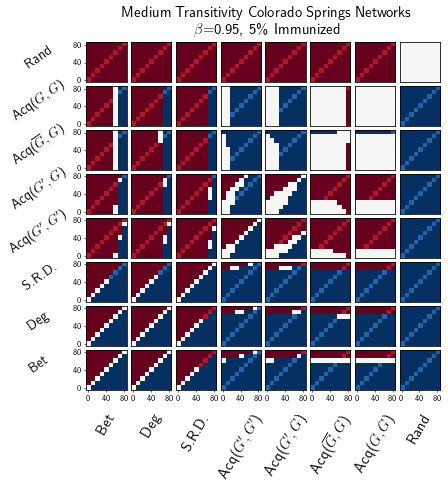

In [119]:
beta= 0.95
gamma=1.0
pctImmunized = .05
folder = 'allMedResults5and15'



title="Medium Transitivity Colorado Springs Networks\n" + r'$\beta$='+str(beta)+", "+str(int(100*pctImmunized)) +"\% Immunized"


figFileName="sigs"+folder[:12]+"beta"+pointify(beta)+"gamma"+pointify(gamma)+"pctImmunized"+pointify(pctImmunized)
signifArrs=params2signifArrs[(folder,  pctImmunized, beta, gamma)]
makeSignifPlot(figFileName, signifArrs, title)


###  Supp. Fig.6.ii

In [120]:
beta= 0.95
gamma=1.0
pctImmunized = .10
folder = 'newMedResults_gamma1_beta20to220'
params2signifArrs[(folder,  pctImmunized, beta, gamma)] = getSignifArrs(folder, pctImmunized, beta, gamma)




RandSamp Bet
RandSamp 0.8 ,  Bet 0.8 :  0.0
RandSamp 0.8 ,  Bet 0.7 :  0.0
RandSamp 0.8 ,  Bet 0.6 :  0.0
RandSamp 0.8 ,  Bet 0.5 :  0.0
RandSamp 0.8 ,  Bet 0.4 :  0.0
RandSamp 0.8 ,  Bet 0.3 :  0.0
RandSamp 0.8 ,  Bet 0.2 :  0.0
RandSamp 0.8 ,  Bet 0.1 :  0.0
RandSamp 0.8 ,  Bet 0.0 :  0.0
RandSamp 0.7 ,  Bet 0.8 :  0.0
RandSamp 0.7 ,  Bet 0.7 :  0.0
RandSamp 0.7 ,  Bet 0.6 :  0.0
RandSamp 0.7 ,  Bet 0.5 :  0.0
RandSamp 0.7 ,  Bet 0.4 :  0.0
RandSamp 0.7 ,  Bet 0.3 :  0.0
RandSamp 0.7 ,  Bet 0.2 :  0.0
RandSamp 0.7 ,  Bet 0.1 :  0.0
RandSamp 0.7 ,  Bet 0.0 :  0.0
RandSamp 0.6 ,  Bet 0.8 :  0.0
RandSamp 0.6 ,  Bet 0.7 :  0.0
RandSamp 0.6 ,  Bet 0.6 :  0.0
RandSamp 0.6 ,  Bet 0.5 :  0.0
RandSamp 0.6 ,  Bet 0.4 :  0.0
RandSamp 0.6 ,  Bet 0.3 :  0.0
RandSamp 0.6 ,  Bet 0.2 :  0.0
RandSamp 0.6 ,  Bet 0.1 :  0.0
RandSamp 0.6 ,  Bet 0.0 :  0.0
RandSamp 0.5 ,  Bet 0.8 :  0.0
RandSamp 0.5 ,  Bet 0.7 :  0.0
RandSamp 0.5 ,  Bet 0.6 :  0.0
RandSamp 0.5 ,  Bet 0.5 :  0.0
RandSamp 0.5 ,  Bet 0.4 : 

RandSamp 0.7 ,  acqKK2 0.3 :  0.0
RandSamp 0.7 ,  acqKK2 0.2 :  0.0
RandSamp 0.7 ,  acqKK2 0.1 :  0.0
RandSamp 0.7 ,  acqKK2 0.0 :  0.0
RandSamp 0.6 ,  acqKK2 0.8 :  nan
RandSamp 0.6 ,  acqKK2 0.7 :  0.0
RandSamp 0.6 ,  acqKK2 0.6 :  0.0
RandSamp 0.6 ,  acqKK2 0.5 :  0.0
RandSamp 0.6 ,  acqKK2 0.4 :  0.0
RandSamp 0.6 ,  acqKK2 0.3 :  0.0
RandSamp 0.6 ,  acqKK2 0.2 :  0.0
RandSamp 0.6 ,  acqKK2 0.1 :  0.0
RandSamp 0.6 ,  acqKK2 0.0 :  0.0
RandSamp 0.5 ,  acqKK2 0.8 :  nan
RandSamp 0.5 ,  acqKK2 0.7 :  0.0
RandSamp 0.5 ,  acqKK2 0.6 :  0.0
RandSamp 0.5 ,  acqKK2 0.5 :  0.0
RandSamp 0.5 ,  acqKK2 0.4 :  0.0
RandSamp 0.5 ,  acqKK2 0.3 :  0.0
RandSamp 0.5 ,  acqKK2 0.2 :  0.0
RandSamp 0.5 ,  acqKK2 0.1 :  0.0
RandSamp 0.5 ,  acqKK2 0.0 :  0.0
RandSamp 0.4 ,  acqKK2 0.8 :  nan
RandSamp 0.4 ,  acqKK2 0.7 :  0.0
RandSamp 0.4 ,  acqKK2 0.6 :  0.0
RandSamp 0.4 ,  acqKK2 0.5 :  0.0
RandSamp 0.4 ,  acqKK2 0.4 :  0.0
RandSamp 0.4 ,  acqKK2 0.3 :  0.0
RandSamp 0.4 ,  acqKK2 0.2 :  0.0
RandSamp 0.4 ,

RandSamp 0.8 ,  acqGG2 0.4 :  0.0
RandSamp 0.8 ,  acqGG2 0.3 :  0.0
RandSamp 0.8 ,  acqGG2 0.2 :  0.0
RandSamp 0.8 ,  acqGG2 0.1 :  0.0
RandSamp 0.8 ,  acqGG2 0.0 :  0.0
RandSamp 0.7 ,  acqGG2 0.8 :  0.0
RandSamp 0.7 ,  acqGG2 0.7 :  0.0
RandSamp 0.7 ,  acqGG2 0.6 :  0.0
RandSamp 0.7 ,  acqGG2 0.5 :  0.0
RandSamp 0.7 ,  acqGG2 0.4 :  0.0
RandSamp 0.7 ,  acqGG2 0.3 :  0.0
RandSamp 0.7 ,  acqGG2 0.2 :  0.0
RandSamp 0.7 ,  acqGG2 0.1 :  0.0
RandSamp 0.7 ,  acqGG2 0.0 :  0.0
RandSamp 0.6 ,  acqGG2 0.8 :  0.0
RandSamp 0.6 ,  acqGG2 0.7 :  0.0
RandSamp 0.6 ,  acqGG2 0.6 :  0.0
RandSamp 0.6 ,  acqGG2 0.5 :  0.0
RandSamp 0.6 ,  acqGG2 0.4 :  0.0
RandSamp 0.6 ,  acqGG2 0.3 :  0.0
RandSamp 0.6 ,  acqGG2 0.2 :  0.0
RandSamp 0.6 ,  acqGG2 0.1 :  0.0
RandSamp 0.6 ,  acqGG2 0.0 :  0.0
RandSamp 0.5 ,  acqGG2 0.8 :  0.0
RandSamp 0.5 ,  acqGG2 0.7 :  0.0
RandSamp 0.5 ,  acqGG2 0.6 :  0.0
RandSamp 0.5 ,  acqGG2 0.5 :  0.0
RandSamp 0.5 ,  acqGG2 0.4 :  0.0
RandSamp 0.5 ,  acqGG2 0.3 :  0.0
RandSamp 0.5 ,

acqGG2 0.3 ,  Bet 0.1 :  0.0
acqGG2 0.3 ,  Bet 0.0 :  0.0
acqGG2 0.2 ,  Bet 0.8 :  0.0
acqGG2 0.2 ,  Bet 0.7 :  0.0
acqGG2 0.2 ,  Bet 0.6 :  0.0
acqGG2 0.2 ,  Bet 0.5 :  0.003751384442290902
acqGG2 0.2 ,  Bet 0.4 :  1.1468924123880543e-243
acqGG2 0.2 ,  Bet 0.3 :  0.0
acqGG2 0.2 ,  Bet 0.2 :  0.0
acqGG2 0.2 ,  Bet 0.1 :  0.0
acqGG2 0.2 ,  Bet 0.0 :  0.0
acqGG2 0.1 ,  Bet 0.8 :  0.0
acqGG2 0.1 ,  Bet 0.7 :  0.0
acqGG2 0.1 ,  Bet 0.6 :  0.0
acqGG2 0.1 ,  Bet 0.5 :  0.0017245430237925214
acqGG2 0.1 ,  Bet 0.4 :  7.245525563963378e-241
acqGG2 0.1 ,  Bet 0.3 :  0.0
acqGG2 0.1 ,  Bet 0.2 :  0.0
acqGG2 0.1 ,  Bet 0.1 :  0.0
acqGG2 0.1 ,  Bet 0.0 :  0.0
acqGG2 0.0 ,  Bet 0.8 :  0.0
acqGG2 0.0 ,  Bet 0.7 :  0.0
acqGG2 0.0 ,  Bet 0.6 :  0.0
acqGG2 0.0 ,  Bet 0.5 :  0.0015807402772625948
acqGG2 0.0 ,  Bet 0.4 :  2.3219195013149324e-240
acqGG2 0.0 ,  Bet 0.3 :  0.0
acqGG2 0.0 ,  Bet 0.2 :  0.0
acqGG2 0.0 ,  Bet 0.1 :  0.0
acqGG2 0.0 ,  Bet 0.0 :  0.0
acqGG2 DegKK
acqGG2 0.8 ,  DegKK 0.8 :  0.0
acq

acqGG2 0.3 ,  acqKK2 0.8 :  nan
acqGG2 0.3 ,  acqKK2 0.7 :  0.0
acqGG2 0.3 ,  acqKK2 0.6 :  0.0
acqGG2 0.3 ,  acqKK2 0.5 :  0.0
acqGG2 0.3 ,  acqKK2 0.4 :  0.0
acqGG2 0.3 ,  acqKK2 0.3 :  1.3583760412688049e-292
acqGG2 0.3 ,  acqKK2 0.2 :  4.372100181343033e-121
acqGG2 0.3 ,  acqKK2 0.1 :  1.1983706245661937e-30
acqGG2 0.3 ,  acqKK2 0.0 :  0.31651361975170117
acqGG2 0.2 ,  acqKK2 0.8 :  nan
acqGG2 0.2 ,  acqKK2 0.7 :  0.0
acqGG2 0.2 ,  acqKK2 0.6 :  0.0
acqGG2 0.2 ,  acqKK2 0.5 :  0.0
acqGG2 0.2 ,  acqKK2 0.4 :  0.0
acqGG2 0.2 ,  acqKK2 0.3 :  2.381272882155984e-280
acqGG2 0.2 ,  acqKK2 0.2 :  9.017299057967614e-113
acqGG2 0.2 ,  acqKK2 0.1 :  1.768456824617797e-26
acqGG2 0.2 ,  acqKK2 0.0 :  0.8928931749712062
acqGG2 0.1 ,  acqKK2 0.8 :  nan
acqGG2 0.1 ,  acqKK2 0.7 :  0.0
acqGG2 0.1 ,  acqKK2 0.6 :  0.0
acqGG2 0.1 ,  acqKK2 0.5 :  0.0
acqGG2 0.1 ,  acqKK2 0.4 :  0.0
acqGG2 0.1 ,  acqKK2 0.3 :  4.9290984230999626e-284
acqGG2 0.1 ,  acqKK2 0.2 :  3.983100242579136e-115
acqGG2 0.1 ,  ac

acqGG2 0.2 ,  acqKG2_up 0.3 :  0.0004546553501126313
acqGG2 0.2 ,  acqKG2_up 0.2 :  0.027140956387296213
acqGG2 0.2 ,  acqKG2_up 0.1 :  0.5209478578846496
acqGG2 0.2 ,  acqKG2_up 0.0 :  0.478804993641597
acqGG2 0.1 ,  acqKG2_up 0.8 :  9.041883617178932e-81
acqGG2 0.1 ,  acqKG2_up 0.7 :  7.197669241526511e-40
acqGG2 0.1 ,  acqKG2_up 0.6 :  5.109314172196735e-27
acqGG2 0.1 ,  acqKG2_up 0.5 :  1.741524856745218e-11
acqGG2 0.1 ,  acqKG2_up 0.4 :  5.064243471716202e-06
acqGG2 0.1 ,  acqKG2_up 0.3 :  0.0010302496315499879
acqGG2 0.1 ,  acqKG2_up 0.2 :  0.0471692114368216
acqGG2 0.1 ,  acqKG2_up 0.1 :  0.6785367271226417
acqGG2 0.1 ,  acqKG2_up 0.0 :  0.6300302698926263
acqGG2 0.0 ,  acqKG2_up 0.8 :  1.595227732910007e-80
acqGG2 0.0 ,  acqKG2_up 0.7 :  1.0550693682206996e-39
acqGG2 0.0 ,  acqKG2_up 0.6 :  6.946317618984215e-27
acqGG2 0.0 ,  acqKG2_up 0.5 :  2.1021591011229936e-11
acqGG2 0.0 ,  acqKG2_up 0.4 :  5.7564648940374505e-06
acqGG2 0.0 ,  acqKG2_up 0.3 :  0.0011323817718595446
acqGG2 

acqKG2_up 0.6 ,  Bet 0.7 :  0.0
acqKG2_up 0.6 ,  Bet 0.6 :  0.0
acqKG2_up 0.6 ,  Bet 0.5 :  1.0811424016761686e-44
acqKG2_up 0.6 ,  Bet 0.4 :  7.861853273340764e-106
acqKG2_up 0.6 ,  Bet 0.3 :  0.0
acqKG2_up 0.6 ,  Bet 0.2 :  0.0
acqKG2_up 0.6 ,  Bet 0.1 :  0.0
acqKG2_up 0.6 ,  Bet 0.0 :  0.0
acqKG2_up 0.5 ,  Bet 0.8 :  0.0
acqKG2_up 0.5 ,  Bet 0.7 :  0.0
acqKG2_up 0.5 ,  Bet 0.6 :  0.0
acqKG2_up 0.5 ,  Bet 0.5 :  2.7415643067652256e-23
acqKG2_up 0.5 ,  Bet 0.4 :  7.290882652045233e-150
acqKG2_up 0.5 ,  Bet 0.3 :  0.0
acqKG2_up 0.5 ,  Bet 0.2 :  0.0
acqKG2_up 0.5 ,  Bet 0.1 :  0.0
acqKG2_up 0.5 ,  Bet 0.0 :  0.0
acqKG2_up 0.4 ,  Bet 0.8 :  0.0
acqKG2_up 0.4 ,  Bet 0.7 :  0.0
acqKG2_up 0.4 ,  Bet 0.6 :  0.0
acqKG2_up 0.4 ,  Bet 0.5 :  9.084646823614716e-15
acqKG2_up 0.4 ,  Bet 0.4 :  1.1851329965899623e-176
acqKG2_up 0.4 ,  Bet 0.3 :  0.0
acqKG2_up 0.4 ,  Bet 0.2 :  0.0
acqKG2_up 0.4 ,  Bet 0.1 :  0.0
acqKG2_up 0.4 ,  Bet 0.0 :  0.0
acqKG2_up 0.3 ,  Bet 0.8 :  0.0
acqKG2_up 0.3 ,  Bet 0

acqKG2_up 0.8 ,  acqKK2 0.6 :  0.0
acqKG2_up 0.8 ,  acqKK2 0.5 :  0.0
acqKG2_up 0.8 ,  acqKK2 0.4 :  0.0
acqKG2_up 0.8 ,  acqKK2 0.3 :  0.0
acqKG2_up 0.8 ,  acqKK2 0.2 :  0.0
acqKG2_up 0.8 ,  acqKK2 0.1 :  3.6652534724173463e-187
acqKG2_up 0.8 ,  acqKK2 0.0 :  4.313505391011644e-83
acqKG2_up 0.7 ,  acqKK2 0.8 :  nan
acqKG2_up 0.7 ,  acqKK2 0.7 :  0.0
acqKG2_up 0.7 ,  acqKK2 0.6 :  0.0
acqKG2_up 0.7 ,  acqKK2 0.5 :  0.0
acqKG2_up 0.7 ,  acqKK2 0.4 :  0.0
acqKG2_up 0.7 ,  acqKK2 0.3 :  0.0
acqKG2_up 0.7 ,  acqKK2 0.2 :  2.5341007042587915e-265
acqKG2_up 0.7 ,  acqKK2 0.1 :  2.4023204430173072e-123
acqKG2_up 0.7 ,  acqKK2 0.0 :  1.2161273292876216e-41
acqKG2_up 0.6 ,  acqKK2 0.8 :  nan
acqKG2_up 0.6 ,  acqKK2 0.7 :  0.0
acqKG2_up 0.6 ,  acqKK2 0.6 :  0.0
acqKG2_up 0.6 ,  acqKK2 0.5 :  0.0
acqKG2_up 0.6 ,  acqKK2 0.4 :  0.0
acqKG2_up 0.6 ,  acqKK2 0.3 :  0.0
acqKG2_up 0.6 ,  acqKK2 0.2 :  6.7822824937540725e-233
acqKG2_up 0.6 ,  acqKK2 0.1 :  2.4058665408353065e-100
acqKG2_up 0.6 ,  acqKK2

acqKG2_up 0.6 ,  acqKG2_up 0.8 :  6.135226768725114e-17
acqKG2_up 0.6 ,  acqKG2_up 0.7 :  0.013654163801468187
acqKG2_up 0.6 ,  acqKG2_up 0.6 :  1.0
acqKG2_up 0.6 ,  acqKG2_up 0.5 :  5.414521460187391e-05
acqKG2_up 0.6 ,  acqKG2_up 0.4 :  5.664871602596733e-10
acqKG2_up 0.6 ,  acqKG2_up 0.3 :  6.11355827972208e-14
acqKG2_up 0.6 ,  acqKG2_up 0.2 :  2.0779124349193486e-18
acqKG2_up 0.6 ,  acqKG2_up 0.1 :  4.321769346295492e-25
acqKG2_up 0.6 ,  acqKG2_up 0.0 :  1.2538000578291952e-24
acqKG2_up 0.5 ,  acqKG2_up 0.8 :  4.044550372794223e-35
acqKG2_up 0.5 ,  acqKG2_up 0.7 :  8.161170156567214e-11
acqKG2_up 0.5 ,  acqKG2_up 0.6 :  5.414521460187391e-05
acqKG2_up 0.5 ,  acqKG2_up 0.5 :  1.0
acqKG2_up 0.5 ,  acqKG2_up 0.4 :  0.030541261199865253
acqKG2_up 0.5 ,  acqKG2_up 0.3 :  0.000541008720819
acqKG2_up 0.5 ,  acqKG2_up 0.2 :  2.3007544781574913e-06
acqKG2_up 0.5 ,  acqKG2_up 0.1 :  2.7848697505292235e-10
acqKG2_up 0.5 ,  acqKG2_up 0.0 :  4.95198238059907e-10
acqKG2_up 0.4 ,  acqKG2_up 0.8 :

acqKG2_up 0.7 ,  RandSamp 0.2 :  0.0
acqKG2_up 0.7 ,  RandSamp 0.1 :  0.0
acqKG2_up 0.7 ,  RandSamp 0.0 :  0.0
acqKG2_up 0.6 ,  RandSamp 0.8 :  0.0
acqKG2_up 0.6 ,  RandSamp 0.7 :  0.0
acqKG2_up 0.6 ,  RandSamp 0.6 :  0.0
acqKG2_up 0.6 ,  RandSamp 0.5 :  0.0
acqKG2_up 0.6 ,  RandSamp 0.4 :  0.0
acqKG2_up 0.6 ,  RandSamp 0.3 :  0.0
acqKG2_up 0.6 ,  RandSamp 0.2 :  0.0
acqKG2_up 0.6 ,  RandSamp 0.1 :  0.0
acqKG2_up 0.6 ,  RandSamp 0.0 :  0.0
acqKG2_up 0.5 ,  RandSamp 0.8 :  0.0
acqKG2_up 0.5 ,  RandSamp 0.7 :  0.0
acqKG2_up 0.5 ,  RandSamp 0.6 :  0.0
acqKG2_up 0.5 ,  RandSamp 0.5 :  0.0
acqKG2_up 0.5 ,  RandSamp 0.4 :  0.0
acqKG2_up 0.5 ,  RandSamp 0.3 :  0.0
acqKG2_up 0.5 ,  RandSamp 0.2 :  0.0
acqKG2_up 0.5 ,  RandSamp 0.1 :  0.0
acqKG2_up 0.5 ,  RandSamp 0.0 :  0.0
acqKG2_up 0.4 ,  RandSamp 0.8 :  0.0
acqKG2_up 0.4 ,  RandSamp 0.7 :  0.0
acqKG2_up 0.4 ,  RandSamp 0.6 :  0.0
acqKG2_up 0.4 ,  RandSamp 0.5 :  0.0
acqKG2_up 0.4 ,  RandSamp 0.4 :  0.0
acqKG2_up 0.4 ,  RandSamp 0.3 :  0.0
a

acqKG2 0.7 ,  Srd 0.8 :  0.0
acqKG2 0.7 ,  Srd 0.7 :  1.9002423309610324e-124
acqKG2 0.7 ,  Srd 0.6 :  5.27391832618176e-60
acqKG2 0.7 ,  Srd 0.5 :  0.0
acqKG2 0.7 ,  Srd 0.4 :  0.0
acqKG2 0.7 ,  Srd 0.3 :  0.0
acqKG2 0.7 ,  Srd 0.2 :  0.0
acqKG2 0.7 ,  Srd 0.1 :  0.0
acqKG2 0.7 ,  Srd 0.0 :  0.0
acqKG2 0.6 ,  Srd 0.8 :  0.0
acqKG2 0.6 ,  Srd 0.7 :  1.130191506333602e-225
acqKG2 0.6 ,  Srd 0.6 :  3.7794003941047214e-14
acqKG2 0.6 ,  Srd 0.5 :  0.0
acqKG2 0.6 ,  Srd 0.4 :  0.0
acqKG2 0.6 ,  Srd 0.3 :  0.0
acqKG2 0.6 ,  Srd 0.2 :  0.0
acqKG2 0.6 ,  Srd 0.1 :  0.0
acqKG2 0.6 ,  Srd 0.0 :  0.0
acqKG2 0.5 ,  Srd 0.8 :  0.0
acqKG2 0.5 ,  Srd 0.7 :  0.0
acqKG2 0.5 ,  Srd 0.6 :  0.9342324670374386
acqKG2 0.5 ,  Srd 0.5 :  3.7378147242950787e-293
acqKG2 0.5 ,  Srd 0.4 :  0.0
acqKG2 0.5 ,  Srd 0.3 :  0.0
acqKG2 0.5 ,  Srd 0.2 :  0.0
acqKG2 0.5 ,  Srd 0.1 :  0.0
acqKG2 0.5 ,  Srd 0.0 :  0.0
acqKG2 0.4 ,  Srd 0.8 :  0.0
acqKG2 0.4 ,  Srd 0.7 :  0.0
acqKG2 0.4 ,  Srd 0.6 :  1.9699532474555965e-07
a

acqKG2 0.2 ,  acqKG2 0.8 :  0.0
acqKG2 0.2 ,  acqKG2 0.7 :  5.6692620802430535e-188
acqKG2 0.2 ,  acqKG2 0.6 :  5.7548223695872554e-98
acqKG2 0.2 ,  acqKG2 0.5 :  4.215803924005653e-43
acqKG2 0.2 ,  acqKG2 0.4 :  4.553264731034691e-19
acqKG2 0.2 ,  acqKG2 0.3 :  1.755159978412971e-05
acqKG2 0.2 ,  acqKG2 0.2 :  1.0
acqKG2 0.2 ,  acqKG2 0.1 :  0.0010419447360118944
acqKG2 0.2 ,  acqKG2 0.0 :  1.946103462259234e-08
acqKG2 0.1 ,  acqKG2 0.8 :  0.0
acqKG2 0.1 ,  acqKG2 0.7 :  9.797198754349849e-231
acqKG2 0.1 ,  acqKG2 0.6 :  4.987348668694867e-130
acqKG2 0.1 ,  acqKG2 0.5 :  2.693172691916421e-65
acqKG2 0.1 ,  acqKG2 0.4 :  1.5425936874461877e-34
acqKG2 0.1 ,  acqKG2 0.3 :  2.9956695175105457e-14
acqKG2 0.1 ,  acqKG2 0.2 :  0.0010419447360118944
acqKG2 0.1 ,  acqKG2 0.1 :  1.0
acqKG2 0.1 ,  acqKG2 0.0 :  0.01811383027578149
acqKG2 0.0 ,  acqKG2 0.8 :  0.0
acqKG2 0.0 ,  acqKG2 0.7 :  1.3426159894151255e-260
acqKG2 0.0 ,  acqKG2 0.6 :  7.909261850271547e-154
acqKG2 0.0 ,  acqKG2 0.5 :  4.35

acqKG2 0.1 ,  acqGG2 0.3 :  0.00035068885194363384
acqKG2 0.1 ,  acqGG2 0.2 :  0.0067449004059418885
acqKG2 0.1 ,  acqGG2 0.1 :  0.003297181510853798
acqKG2 0.1 ,  acqGG2 0.0 :  0.003041841946854025
acqKG2 0.0 ,  acqGG2 0.8 :  0.9131273525422746
acqKG2 0.0 ,  acqGG2 0.7 :  0.8979674859790766
acqKG2 0.0 ,  acqGG2 0.6 :  0.4550997993815773
acqKG2 0.0 ,  acqGG2 0.5 :  0.7371213501449225
acqKG2 0.0 ,  acqGG2 0.4 :  0.7961647675905039
acqKG2 0.0 ,  acqGG2 0.3 :  0.2323585246397048
acqKG2 0.0 ,  acqGG2 0.2 :  0.7412223004358893
acqKG2 0.0 ,  acqGG2 0.1 :  0.5774341306707387
acqKG2 0.0 ,  acqGG2 0.0 :  0.5600949106258952
acqKG2 RandSamp
acqKG2 0.8 ,  RandSamp 0.8 :  0.0
acqKG2 0.8 ,  RandSamp 0.7 :  0.0
acqKG2 0.8 ,  RandSamp 0.6 :  0.0
acqKG2 0.8 ,  RandSamp 0.5 :  0.0
acqKG2 0.8 ,  RandSamp 0.4 :  0.0
acqKG2 0.8 ,  RandSamp 0.3 :  0.0
acqKG2 0.8 ,  RandSamp 0.2 :  0.0
acqKG2 0.8 ,  RandSamp 0.1 :  0.0
acqKG2 0.8 ,  RandSamp 0.0 :  0.0
acqKG2 0.7 ,  RandSamp 0.8 :  0.0
acqKG2 0.7 ,  RandSamp

acqKK2 0.0 ,  DegKK 0.8 :  0.0
acqKK2 0.0 ,  DegKK 0.7 :  0.0
acqKK2 0.0 ,  DegKK 0.6 :  3.424473429345991e-299
acqKK2 0.0 ,  DegKK 0.5 :  4.2761253933001216e-09
acqKK2 0.0 ,  DegKK 0.4 :  0.0
acqKK2 0.0 ,  DegKK 0.3 :  0.0
acqKK2 0.0 ,  DegKK 0.2 :  0.0
acqKK2 0.0 ,  DegKK 0.1 :  0.0
acqKK2 0.0 ,  DegKK 0.0 :  0.0
acqKK2 Srd
acqKK2 0.8 ,  Srd 0.8 :  nan
acqKK2 0.8 ,  Srd 0.7 :  nan
acqKK2 0.8 ,  Srd 0.6 :  nan
acqKK2 0.8 ,  Srd 0.5 :  nan
acqKK2 0.8 ,  Srd 0.4 :  nan
acqKK2 0.8 ,  Srd 0.3 :  nan
acqKK2 0.8 ,  Srd 0.2 :  nan
acqKK2 0.8 ,  Srd 0.1 :  nan
acqKK2 0.8 ,  Srd 0.0 :  nan
acqKK2 0.7 ,  Srd 0.8 :  3.425947516779997e-82
acqKK2 0.7 ,  Srd 0.7 :  0.0
acqKK2 0.7 ,  Srd 0.6 :  0.0
acqKK2 0.7 ,  Srd 0.5 :  0.0
acqKK2 0.7 ,  Srd 0.4 :  0.0
acqKK2 0.7 ,  Srd 0.3 :  0.0
acqKK2 0.7 ,  Srd 0.2 :  0.0
acqKK2 0.7 ,  Srd 0.1 :  0.0
acqKK2 0.7 ,  Srd 0.0 :  0.0
acqKK2 0.6 ,  Srd 0.8 :  1.1452212313731822e-36
acqKK2 0.6 ,  Srd 0.7 :  2.556332987986427e-279
acqKK2 0.6 ,  Srd 0.6 :  0.0
acqKK2 

acqKK2 0.2 ,  acqKG2 0.3 :  6.41670885362971e-35
acqKK2 0.2 ,  acqKG2 0.2 :  1.71437690188672e-61
acqKK2 0.2 ,  acqKG2 0.1 :  7.538762129731202e-88
acqKK2 0.2 ,  acqKG2 0.0 :  2.7891950829672598e-108
acqKK2 0.1 ,  acqKG2 0.8 :  1.6258567439898798e-279
acqKK2 0.1 ,  acqKG2 0.7 :  4.0346463101366494e-140
acqKK2 0.1 ,  acqKG2 0.6 :  5.525415705754408e-63
acqKK2 0.1 ,  acqKG2 0.5 :  9.710535884120978e-21
acqKK2 0.1 ,  acqKG2 0.4 :  1.1750108228038166e-05
acqKK2 0.1 ,  acqKG2 0.3 :  0.7843233285049283
acqKK2 0.1 ,  acqKG2 0.2 :  4.363420029344863e-06
acqKK2 0.1 ,  acqKG2 0.1 :  2.3869709794424832e-15
acqKK2 0.1 ,  acqKG2 0.0 :  1.1419371058096258e-24
acqKK2 0.0 ,  acqKG2 0.8 :  0.0
acqKK2 0.0 ,  acqKG2 0.7 :  6.054900639958915e-265
acqKK2 0.0 ,  acqKG2 0.6 :  5.886170341348628e-157
acqKK2 0.0 ,  acqKG2 0.5 :  3.0777811742203854e-85
acqKK2 0.0 ,  acqKG2 0.4 :  1.3577175739031109e-49
acqKK2 0.0 ,  acqKG2 0.3 :  3.3949419826471315e-24
acqKK2 0.0 ,  acqKG2 0.2 :  5.549690016913779e-09
acqKK2 0.

acqKK2 0.6 ,  RandSamp 0.8 :  0.0
acqKK2 0.6 ,  RandSamp 0.7 :  0.0
acqKK2 0.6 ,  RandSamp 0.6 :  0.0
acqKK2 0.6 ,  RandSamp 0.5 :  0.0
acqKK2 0.6 ,  RandSamp 0.4 :  0.0
acqKK2 0.6 ,  RandSamp 0.3 :  0.0
acqKK2 0.6 ,  RandSamp 0.2 :  0.0
acqKK2 0.6 ,  RandSamp 0.1 :  0.0
acqKK2 0.6 ,  RandSamp 0.0 :  0.0
acqKK2 0.5 ,  RandSamp 0.8 :  0.0
acqKK2 0.5 ,  RandSamp 0.7 :  0.0
acqKK2 0.5 ,  RandSamp 0.6 :  0.0
acqKK2 0.5 ,  RandSamp 0.5 :  0.0
acqKK2 0.5 ,  RandSamp 0.4 :  0.0
acqKK2 0.5 ,  RandSamp 0.3 :  0.0
acqKK2 0.5 ,  RandSamp 0.2 :  0.0
acqKK2 0.5 ,  RandSamp 0.1 :  0.0
acqKK2 0.5 ,  RandSamp 0.0 :  0.0
acqKK2 0.4 ,  RandSamp 0.8 :  0.0
acqKK2 0.4 ,  RandSamp 0.7 :  0.0
acqKK2 0.4 ,  RandSamp 0.6 :  0.0
acqKK2 0.4 ,  RandSamp 0.5 :  0.0
acqKK2 0.4 ,  RandSamp 0.4 :  0.0
acqKK2 0.4 ,  RandSamp 0.3 :  0.0
acqKK2 0.4 ,  RandSamp 0.2 :  0.0
acqKK2 0.4 ,  RandSamp 0.1 :  0.0
acqKK2 0.4 ,  RandSamp 0.0 :  0.0
acqKK2 0.3 ,  RandSamp 0.8 :  0.0
acqKK2 0.3 ,  RandSamp 0.7 :  0.0
acqKK2 0.3 ,  

Srd 0.3 ,  Srd 0.8 :  0.0
Srd 0.3 ,  Srd 0.7 :  0.0
Srd 0.3 ,  Srd 0.6 :  0.0
Srd 0.3 ,  Srd 0.5 :  0.0
Srd 0.3 ,  Srd 0.4 :  8.111882790731936e-270
Srd 0.3 ,  Srd 0.3 :  1.0
Srd 0.3 ,  Srd 0.2 :  6.551143082311824e-261
Srd 0.3 ,  Srd 0.1 :  0.0
Srd 0.3 ,  Srd 0.0 :  0.0
Srd 0.2 ,  Srd 0.8 :  0.0
Srd 0.2 ,  Srd 0.7 :  0.0
Srd 0.2 ,  Srd 0.6 :  0.0
Srd 0.2 ,  Srd 0.5 :  0.0
Srd 0.2 ,  Srd 0.4 :  0.0
Srd 0.2 ,  Srd 0.3 :  6.551143082311824e-261
Srd 0.2 ,  Srd 0.2 :  1.0
Srd 0.2 ,  Srd 0.1 :  1.3528728169554246e-279
Srd 0.2 ,  Srd 0.0 :  0.0
Srd 0.1 ,  Srd 0.8 :  0.0
Srd 0.1 ,  Srd 0.7 :  0.0
Srd 0.1 ,  Srd 0.6 :  0.0
Srd 0.1 ,  Srd 0.5 :  0.0
Srd 0.1 ,  Srd 0.4 :  0.0
Srd 0.1 ,  Srd 0.3 :  0.0
Srd 0.1 ,  Srd 0.2 :  1.3528728169554246e-279
Srd 0.1 ,  Srd 0.1 :  1.0
Srd 0.1 ,  Srd 0.0 :  6.208487106592004e-300
Srd 0.0 ,  Srd 0.8 :  0.0
Srd 0.0 ,  Srd 0.7 :  0.0
Srd 0.0 ,  Srd 0.6 :  0.0
Srd 0.0 ,  Srd 0.5 :  0.0
Srd 0.0 ,  Srd 0.4 :  0.0
Srd 0.0 ,  Srd 0.3 :  0.0
Srd 0.0 ,  Srd 0.2 :  0.0


Srd 0.3 ,  acqKG2_up 0.8 :  0.0
Srd 0.3 ,  acqKG2_up 0.7 :  0.0
Srd 0.3 ,  acqKG2_up 0.6 :  0.0
Srd 0.3 ,  acqKG2_up 0.5 :  0.0
Srd 0.3 ,  acqKG2_up 0.4 :  0.0
Srd 0.3 ,  acqKG2_up 0.3 :  0.0
Srd 0.3 ,  acqKG2_up 0.2 :  0.0
Srd 0.3 ,  acqKG2_up 0.1 :  0.0
Srd 0.3 ,  acqKG2_up 0.0 :  0.0
Srd 0.2 ,  acqKG2_up 0.8 :  0.0
Srd 0.2 ,  acqKG2_up 0.7 :  0.0
Srd 0.2 ,  acqKG2_up 0.6 :  0.0
Srd 0.2 ,  acqKG2_up 0.5 :  0.0
Srd 0.2 ,  acqKG2_up 0.4 :  0.0
Srd 0.2 ,  acqKG2_up 0.3 :  0.0
Srd 0.2 ,  acqKG2_up 0.2 :  0.0
Srd 0.2 ,  acqKG2_up 0.1 :  0.0
Srd 0.2 ,  acqKG2_up 0.0 :  0.0
Srd 0.1 ,  acqKG2_up 0.8 :  0.0
Srd 0.1 ,  acqKG2_up 0.7 :  0.0
Srd 0.1 ,  acqKG2_up 0.6 :  0.0
Srd 0.1 ,  acqKG2_up 0.5 :  0.0
Srd 0.1 ,  acqKG2_up 0.4 :  0.0
Srd 0.1 ,  acqKG2_up 0.3 :  0.0
Srd 0.1 ,  acqKG2_up 0.2 :  0.0
Srd 0.1 ,  acqKG2_up 0.1 :  0.0
Srd 0.1 ,  acqKG2_up 0.0 :  0.0
Srd 0.0 ,  acqKG2_up 0.8 :  0.0
Srd 0.0 ,  acqKG2_up 0.7 :  0.0
Srd 0.0 ,  acqKG2_up 0.6 :  0.0
Srd 0.0 ,  acqKG2_up 0.5 :  0.0
Srd 0.0 

DegKK 0.1 ,  Bet 0.7 :  0.0
DegKK 0.1 ,  Bet 0.6 :  0.0
DegKK 0.1 ,  Bet 0.5 :  0.0
DegKK 0.1 ,  Bet 0.4 :  0.0
DegKK 0.1 ,  Bet 0.3 :  0.0
DegKK 0.1 ,  Bet 0.2 :  0.0
DegKK 0.1 ,  Bet 0.1 :  1.44958342408864e-156
DegKK 0.1 ,  Bet 0.0 :  1.614410183855502e-06
DegKK 0.0 ,  Bet 0.8 :  0.0
DegKK 0.0 ,  Bet 0.7 :  0.0
DegKK 0.0 ,  Bet 0.6 :  0.0
DegKK 0.0 ,  Bet 0.5 :  0.0
DegKK 0.0 ,  Bet 0.4 :  0.0
DegKK 0.0 ,  Bet 0.3 :  0.0
DegKK 0.0 ,  Bet 0.2 :  0.0
DegKK 0.0 ,  Bet 0.1 :  0.0
DegKK 0.0 ,  Bet 0.0 :  1.8763053833237696e-307
DegKK DegKK
DegKK 0.8 ,  DegKK 0.8 :  1.0
DegKK 0.8 ,  DegKK 0.7 :  0.0
DegKK 0.8 ,  DegKK 0.6 :  0.0
DegKK 0.8 ,  DegKK 0.5 :  0.0
DegKK 0.8 ,  DegKK 0.4 :  0.0
DegKK 0.8 ,  DegKK 0.3 :  0.0
DegKK 0.8 ,  DegKK 0.2 :  0.0
DegKK 0.8 ,  DegKK 0.1 :  0.0
DegKK 0.8 ,  DegKK 0.0 :  0.0
DegKK 0.7 ,  DegKK 0.8 :  0.0
DegKK 0.7 ,  DegKK 0.7 :  1.0
DegKK 0.7 ,  DegKK 0.6 :  0.0
DegKK 0.7 ,  DegKK 0.5 :  0.0
DegKK 0.7 ,  DegKK 0.4 :  0.0
DegKK 0.7 ,  DegKK 0.3 :  0.0
DegKK 

DegKK 0.0 ,  acqKK2 0.2 :  0.0
DegKK 0.0 ,  acqKK2 0.1 :  0.0
DegKK 0.0 ,  acqKK2 0.0 :  0.0
DegKK acqKG2
DegKK 0.8 ,  acqKG2 0.8 :  0.0
DegKK 0.8 ,  acqKG2 0.7 :  0.0
DegKK 0.8 ,  acqKG2 0.6 :  0.0
DegKK 0.8 ,  acqKG2 0.5 :  0.0
DegKK 0.8 ,  acqKG2 0.4 :  0.0
DegKK 0.8 ,  acqKG2 0.3 :  0.0
DegKK 0.8 ,  acqKG2 0.2 :  0.0
DegKK 0.8 ,  acqKG2 0.1 :  0.0
DegKK 0.8 ,  acqKG2 0.0 :  0.0
DegKK 0.7 ,  acqKG2 0.8 :  7.491616642365605e-303
DegKK 0.7 ,  acqKG2 0.7 :  0.0
DegKK 0.7 ,  acqKG2 0.6 :  0.0
DegKK 0.7 ,  acqKG2 0.5 :  0.0
DegKK 0.7 ,  acqKG2 0.4 :  0.0
DegKK 0.7 ,  acqKG2 0.3 :  0.0
DegKK 0.7 ,  acqKG2 0.2 :  0.0
DegKK 0.7 ,  acqKG2 0.1 :  0.0
DegKK 0.7 ,  acqKG2 0.0 :  0.0
DegKK 0.6 ,  acqKG2 0.8 :  3.9323330773772213e-22
DegKK 0.6 ,  acqKG2 0.7 :  0.09139018675043373
DegKK 0.6 ,  acqKG2 0.6 :  9.973360983489514e-26
DegKK 0.6 ,  acqKG2 0.5 :  5.268118003752702e-73
DegKK 0.6 ,  acqKG2 0.4 :  1.3688327511724973e-118
DegKK 0.6 ,  acqKG2 0.3 :  2.3506380543420837e-165
DegKK 0.6 ,  acqKG2 

DegKK 0.1 ,  acqGG2 0.4 :  0.0
DegKK 0.1 ,  acqGG2 0.3 :  0.0
DegKK 0.1 ,  acqGG2 0.2 :  0.0
DegKK 0.1 ,  acqGG2 0.1 :  0.0
DegKK 0.1 ,  acqGG2 0.0 :  0.0
DegKK 0.0 ,  acqGG2 0.8 :  0.0
DegKK 0.0 ,  acqGG2 0.7 :  0.0
DegKK 0.0 ,  acqGG2 0.6 :  0.0
DegKK 0.0 ,  acqGG2 0.5 :  0.0
DegKK 0.0 ,  acqGG2 0.4 :  0.0
DegKK 0.0 ,  acqGG2 0.3 :  0.0
DegKK 0.0 ,  acqGG2 0.2 :  0.0
DegKK 0.0 ,  acqGG2 0.1 :  0.0
DegKK 0.0 ,  acqGG2 0.0 :  0.0
DegKK RandSamp
DegKK 0.8 ,  RandSamp 0.8 :  0.0
DegKK 0.8 ,  RandSamp 0.7 :  0.0
DegKK 0.8 ,  RandSamp 0.6 :  0.0
DegKK 0.8 ,  RandSamp 0.5 :  0.0
DegKK 0.8 ,  RandSamp 0.4 :  0.0
DegKK 0.8 ,  RandSamp 0.3 :  0.0
DegKK 0.8 ,  RandSamp 0.2 :  0.0
DegKK 0.8 ,  RandSamp 0.1 :  0.0
DegKK 0.8 ,  RandSamp 0.0 :  0.0
DegKK 0.7 ,  RandSamp 0.8 :  0.0
DegKK 0.7 ,  RandSamp 0.7 :  0.0
DegKK 0.7 ,  RandSamp 0.6 :  0.0
DegKK 0.7 ,  RandSamp 0.5 :  0.0
DegKK 0.7 ,  RandSamp 0.4 :  0.0
DegKK 0.7 ,  RandSamp 0.3 :  0.0
DegKK 0.7 ,  RandSamp 0.2 :  0.0
DegKK 0.7 ,  RandSamp 0

Bet 0.7 ,  Srd 0.4 :  0.0
Bet 0.7 ,  Srd 0.3 :  0.0
Bet 0.7 ,  Srd 0.2 :  0.0
Bet 0.7 ,  Srd 0.1 :  0.0
Bet 0.7 ,  Srd 0.0 :  0.0
Bet 0.6 ,  Srd 0.8 :  0.0
Bet 0.6 ,  Srd 0.7 :  4.939552508369285e-70
Bet 0.6 ,  Srd 0.6 :  3.982066232809318e-127
Bet 0.6 ,  Srd 0.5 :  0.0
Bet 0.6 ,  Srd 0.4 :  0.0
Bet 0.6 ,  Srd 0.3 :  0.0
Bet 0.6 ,  Srd 0.2 :  0.0
Bet 0.6 ,  Srd 0.1 :  0.0
Bet 0.6 ,  Srd 0.0 :  0.0
Bet 0.5 ,  Srd 0.8 :  0.0
Bet 0.5 ,  Srd 0.7 :  0.0
Bet 0.5 ,  Srd 0.6 :  2.682461423580462e-71
Bet 0.5 ,  Srd 0.5 :  9.348907772085418e-96
Bet 0.5 ,  Srd 0.4 :  0.0
Bet 0.5 ,  Srd 0.3 :  0.0
Bet 0.5 ,  Srd 0.2 :  0.0
Bet 0.5 ,  Srd 0.1 :  0.0
Bet 0.5 ,  Srd 0.0 :  0.0
Bet 0.4 ,  Srd 0.8 :  0.0
Bet 0.4 ,  Srd 0.7 :  0.0
Bet 0.4 ,  Srd 0.6 :  0.0
Bet 0.4 ,  Srd 0.5 :  3.870137026449259e-60
Bet 0.4 ,  Srd 0.4 :  2.107999519025755e-104
Bet 0.4 ,  Srd 0.3 :  0.0
Bet 0.4 ,  Srd 0.2 :  0.0
Bet 0.4 ,  Srd 0.1 :  0.0
Bet 0.4 ,  Srd 0.0 :  0.0
Bet 0.3 ,  Srd 0.8 :  0.0
Bet 0.3 ,  Srd 0.7 :  0.0
Bet 0.

Bet 0.5 ,  acqKG2_up 0.5 :  2.7415643067652256e-23
Bet 0.5 ,  acqKG2_up 0.4 :  9.084646823614716e-15
Bet 0.5 ,  acqKG2_up 0.3 :  1.0145584649887331e-10
Bet 0.5 ,  acqKG2_up 0.2 :  2.821160241682178e-07
Bet 0.5 ,  acqKG2_up 0.1 :  0.0003809720326967176
Bet 0.5 ,  acqKG2_up 0.0 :  0.0003067724177305497
Bet 0.4 ,  acqKG2_up 0.8 :  3.154914289297753e-38
Bet 0.4 ,  acqKG2_up 0.7 :  1.6745593109025523e-82
Bet 0.4 ,  acqKG2_up 0.6 :  7.861853273340764e-106
Bet 0.4 ,  acqKG2_up 0.5 :  7.290882652045233e-150
Bet 0.4 ,  acqKG2_up 0.4 :  1.1851329965899623e-176
Bet 0.4 ,  acqKG2_up 0.3 :  1.0975600270398544e-194
Bet 0.4 ,  acqKG2_up 0.2 :  1.3987051170742204e-210
Bet 0.4 ,  acqKG2_up 0.1 :  1.6502780524269531e-234
Bet 0.4 ,  acqKG2_up 0.0 :  6.814966685280579e-232
Bet 0.3 ,  acqKG2_up 0.8 :  0.0
Bet 0.3 ,  acqKG2_up 0.7 :  0.0
Bet 0.3 ,  acqKG2_up 0.6 :  0.0
Bet 0.3 ,  acqKG2_up 0.5 :  0.0
Bet 0.3 ,  acqKG2_up 0.4 :  0.0
Bet 0.3 ,  acqKG2_up 0.3 :  0.0
Bet 0.3 ,  acqKG2_up 0.2 :  0.0
Bet 0.3 ,  a

1
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.1 0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.1 0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.1 0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.1 0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.1 0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.  0.1 0. ]
 [0.  0.  0.  0.  0.  0.  0.  0.  0.1]]
2
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.1 0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.1 0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.1 0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.1 0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.1 0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.  0.1 0. ]
 [0.  0.  0.  0.  0.  0.  0.  0.  0.1]]
3
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.1 0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.1 0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.1 0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.1 0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.1 0.  0. ]
 [0.  0.  0.  0. 

28
[[0.43359375 1.         1.         1.         0.5        0.
  0.         0.         0.        ]
 [0.43359375 0.9        1.         1.         1.         0.5
  0.         0.         0.        ]
 [0.43359375 1.         0.9        1.         1.         1.
  0.5        0.         0.        ]
 [0.43359375 1.         1.         0.9        1.         1.
  0.5        0.         0.        ]
 [0.43359375 1.         1.         1.         0.9        1.
  1.         0.5        0.        ]
 [0.43359375 1.         1.         1.         1.         0.9
  1.         0.5        0.        ]
 [0.43359375 1.         1.         1.         1.         1.
  0.9        0.5        0.        ]
 [0.43359375 1.         1.         1.         1.         1.
  1.         0.9        0.5       ]
 [0.43359375 1.         1.         1.         1.         1.
  1.         1.         0.5       ]]
29
[[0.5 0.  0.  0.  0.  0.  0.  0.  0. ]
 [1.  0.5 0.  0.  0.  0.  0.  0.  0. ]
 [1.  1.  0.5 0.  0.  0.  0.  0.  0. ]
 [1.  1.  

41
[[0.9 0.  0.  0.  0.  0.  0.  0.  0. ]
 [1.  0.9 0.  0.  0.  0.  0.  0.  0. ]
 [1.  1.  0.9 0.  0.  0.  0.  0.  0. ]
 [1.  1.  1.  0.9 0.  0.  0.  0.  0. ]
 [1.  1.  1.  1.  0.9 0.  0.  0.  0. ]
 [1.  1.  1.  1.  1.  0.9 0.  0.  0. ]
 [1.  1.  1.  1.  1.  1.  0.9 0.  0. ]
 [1.  1.  1.  1.  1.  1.  1.  0.9 0.5]
 [1.  1.  1.  1.  1.  1.  1.  1.  0.9]]
42
[[0.9 0.  0.  0.  0.  0.  0.  0.  0. ]
 [1.  0.9 0.  0.  0.  0.  0.  0.  0. ]
 [1.  1.  0.9 0.  0.  0.  0.  0.  0. ]
 [1.  1.  1.  0.9 0.  0.  0.  0.  0. ]
 [1.  1.  1.  1.  0.9 0.  0.  0.  0. ]
 [1.  1.  1.  1.  1.  0.5 0.  0.  0. ]
 [1.  1.  1.  1.  1.  1.  0.5 0.  0. ]
 [1.  1.  1.  1.  1.  1.  1.  0.5 0. ]
 [1.  1.  1.  1.  1.  1.  1.  1.  0.5]]
43
[[0.5 0.  0.  0.  0.  0.  0.  0.  0. ]
 [1.  0.5 0.  0.  0.  0.  0.  0.  0. ]
 [1.  1.  0.5 0.  0.  0.  0.  0.  0. ]
 [1.  1.  1.  0.5 0.  0.  0.  0.  0. ]
 [1.  1.  1.  1.  0.5 0.  0.  0.  0. ]
 [1.  1.  1.  1.  1.  0.5 0.  0.  0. ]
 [1.  1.  1.  1.  1.  1.  0.5 0.  0. ]
 [1.  1.  1.  

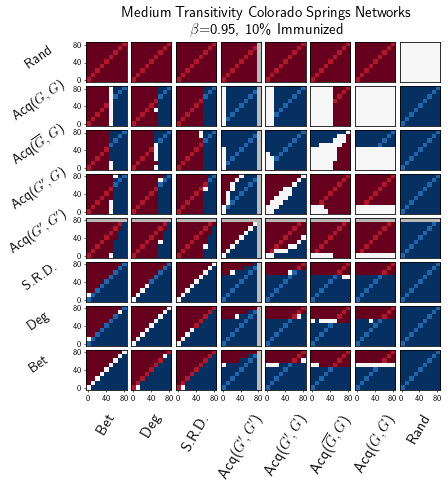

In [121]:
title="Medium Transitivity Colorado Springs Networks\n" + r'$\beta$='+str(beta)+", "+str(int(100*pctImmunized)) +"\% Immunized"


figFileName="sigs"+folder[:12]+"beta"+pointify(beta)+"gamma"+pointify(gamma)+"pctImmunized"+pointify(pctImmunized)
signifArrs=params2signifArrs[(folder,  pctImmunized, beta, gamma)]
makeSignifPlot(figFileName, signifArrs, title)


### Supp. Fig. 6.iii

In [122]:
beta= 0.95
gamma=1.0
pctImmunized = .15
folder = 'allMedResults5and15'
params2signifArrs[(folder,  pctImmunized, beta, gamma)] = getSignifArrs(folder, pctImmunized, beta, gamma)




RandSamp Bet
RandSamp 0.8 ,  Bet 0.8 :  4.869543593776883e-260
RandSamp 0.8 ,  Bet 0.7 :  0.0
RandSamp 0.8 ,  Bet 0.6 :  0.0
RandSamp 0.8 ,  Bet 0.5 :  0.0
RandSamp 0.8 ,  Bet 0.4 :  0.0
RandSamp 0.8 ,  Bet 0.3 :  0.0
RandSamp 0.8 ,  Bet 0.2 :  0.0
RandSamp 0.8 ,  Bet 0.1 :  0.0
RandSamp 0.8 ,  Bet 0.0 :  0.0
RandSamp 0.7 ,  Bet 0.8 :  1.1577792066752578e-260
RandSamp 0.7 ,  Bet 0.7 :  0.0
RandSamp 0.7 ,  Bet 0.6 :  0.0
RandSamp 0.7 ,  Bet 0.5 :  0.0
RandSamp 0.7 ,  Bet 0.4 :  0.0
RandSamp 0.7 ,  Bet 0.3 :  0.0
RandSamp 0.7 ,  Bet 0.2 :  0.0
RandSamp 0.7 ,  Bet 0.1 :  0.0
RandSamp 0.7 ,  Bet 0.0 :  0.0
RandSamp 0.6 ,  Bet 0.8 :  4.6955252955228995e-257
RandSamp 0.6 ,  Bet 0.7 :  0.0
RandSamp 0.6 ,  Bet 0.6 :  0.0
RandSamp 0.6 ,  Bet 0.5 :  0.0
RandSamp 0.6 ,  Bet 0.4 :  0.0
RandSamp 0.6 ,  Bet 0.3 :  0.0
RandSamp 0.6 ,  Bet 0.2 :  0.0
RandSamp 0.6 ,  Bet 0.1 :  0.0
RandSamp 0.6 ,  Bet 0.0 :  0.0
RandSamp 0.5 ,  Bet 0.8 :  8.793655727430401e-272
RandSamp 0.5 ,  Bet 0.7 :  0.0
RandSamp 0

RandSamp 0.7 ,  acqKK2 0.5 :  0.0
RandSamp 0.7 ,  acqKK2 0.4 :  0.0
RandSamp 0.7 ,  acqKK2 0.3 :  0.0
RandSamp 0.7 ,  acqKK2 0.2 :  0.0
RandSamp 0.7 ,  acqKK2 0.1 :  0.0
RandSamp 0.7 ,  acqKK2 0.0 :  0.0
RandSamp 0.6 ,  acqKK2 0.8 :  nan
RandSamp 0.6 ,  acqKK2 0.7 :  nan
RandSamp 0.6 ,  acqKK2 0.6 :  0.0
RandSamp 0.6 ,  acqKK2 0.5 :  0.0
RandSamp 0.6 ,  acqKK2 0.4 :  0.0
RandSamp 0.6 ,  acqKK2 0.3 :  0.0
RandSamp 0.6 ,  acqKK2 0.2 :  0.0
RandSamp 0.6 ,  acqKK2 0.1 :  0.0
RandSamp 0.6 ,  acqKK2 0.0 :  0.0
RandSamp 0.5 ,  acqKK2 0.8 :  nan
RandSamp 0.5 ,  acqKK2 0.7 :  nan
RandSamp 0.5 ,  acqKK2 0.6 :  0.0
RandSamp 0.5 ,  acqKK2 0.5 :  0.0
RandSamp 0.5 ,  acqKK2 0.4 :  0.0
RandSamp 0.5 ,  acqKK2 0.3 :  0.0
RandSamp 0.5 ,  acqKK2 0.2 :  0.0
RandSamp 0.5 ,  acqKK2 0.1 :  0.0
RandSamp 0.5 ,  acqKK2 0.0 :  0.0
RandSamp 0.4 ,  acqKK2 0.8 :  nan
RandSamp 0.4 ,  acqKK2 0.7 :  nan
RandSamp 0.4 ,  acqKK2 0.6 :  0.0
RandSamp 0.4 ,  acqKK2 0.5 :  0.0
RandSamp 0.4 ,  acqKK2 0.4 :  0.0
RandSamp 0.4 ,

RandSamp 0.8 ,  acqGG2 0.0 :  0.0
RandSamp 0.7 ,  acqGG2 0.8 :  0.0
RandSamp 0.7 ,  acqGG2 0.7 :  0.0
RandSamp 0.7 ,  acqGG2 0.6 :  0.0
RandSamp 0.7 ,  acqGG2 0.5 :  0.0
RandSamp 0.7 ,  acqGG2 0.4 :  0.0
RandSamp 0.7 ,  acqGG2 0.3 :  0.0
RandSamp 0.7 ,  acqGG2 0.2 :  0.0
RandSamp 0.7 ,  acqGG2 0.1 :  0.0
RandSamp 0.7 ,  acqGG2 0.0 :  0.0
RandSamp 0.6 ,  acqGG2 0.8 :  0.0
RandSamp 0.6 ,  acqGG2 0.7 :  0.0
RandSamp 0.6 ,  acqGG2 0.6 :  0.0
RandSamp 0.6 ,  acqGG2 0.5 :  0.0
RandSamp 0.6 ,  acqGG2 0.4 :  0.0
RandSamp 0.6 ,  acqGG2 0.3 :  0.0
RandSamp 0.6 ,  acqGG2 0.2 :  0.0
RandSamp 0.6 ,  acqGG2 0.1 :  0.0
RandSamp 0.6 ,  acqGG2 0.0 :  0.0
RandSamp 0.5 ,  acqGG2 0.8 :  0.0
RandSamp 0.5 ,  acqGG2 0.7 :  0.0
RandSamp 0.5 ,  acqGG2 0.6 :  0.0
RandSamp 0.5 ,  acqGG2 0.5 :  0.0
RandSamp 0.5 ,  acqGG2 0.4 :  0.0
RandSamp 0.5 ,  acqGG2 0.3 :  0.0
RandSamp 0.5 ,  acqGG2 0.2 :  0.0
RandSamp 0.5 ,  acqGG2 0.1 :  0.0
RandSamp 0.5 ,  acqGG2 0.0 :  0.0
RandSamp 0.4 ,  acqGG2 0.8 :  0.0
RandSamp 0.4 ,

acqGG2 0.2 ,  Bet 0.3 :  0.0
acqGG2 0.2 ,  Bet 0.2 :  0.0
acqGG2 0.2 ,  Bet 0.1 :  0.0
acqGG2 0.2 ,  Bet 0.0 :  0.0
acqGG2 0.1 ,  Bet 0.8 :  0.0
acqGG2 0.1 ,  Bet 0.7 :  0.0
acqGG2 0.1 ,  Bet 0.6 :  0.0
acqGG2 0.1 ,  Bet 0.5 :  0.0
acqGG2 0.1 ,  Bet 0.4 :  0.0008394965302469737
acqGG2 0.1 ,  Bet 0.3 :  0.0
acqGG2 0.1 ,  Bet 0.2 :  0.0
acqGG2 0.1 ,  Bet 0.1 :  0.0
acqGG2 0.1 ,  Bet 0.0 :  0.0
acqGG2 0.0 ,  Bet 0.8 :  0.0
acqGG2 0.0 ,  Bet 0.7 :  0.0
acqGG2 0.0 ,  Bet 0.6 :  0.0
acqGG2 0.0 ,  Bet 0.5 :  0.0
acqGG2 0.0 ,  Bet 0.4 :  0.0062966934260674035
acqGG2 0.0 ,  Bet 0.3 :  0.0
acqGG2 0.0 ,  Bet 0.2 :  0.0
acqGG2 0.0 ,  Bet 0.1 :  0.0
acqGG2 0.0 ,  Bet 0.0 :  0.0
acqGG2 DegKK
acqGG2 0.8 ,  DegKK 0.8 :  0.0
acqGG2 0.8 ,  DegKK 0.7 :  0.0
acqGG2 0.8 ,  DegKK 0.6 :  0.0
acqGG2 0.8 ,  DegKK 0.5 :  1.769041584943517e-309
acqGG2 0.8 ,  DegKK 0.4 :  1.5507777078071284e-119
acqGG2 0.8 ,  DegKK 0.3 :  0.0
acqGG2 0.8 ,  DegKK 0.2 :  0.0
acqGG2 0.8 ,  DegKK 0.1 :  0.0
acqGG2 0.8 ,  DegKK 0.0 : 

acqGG2 0.1 ,  acqKK2 0.3 :  0.0
acqGG2 0.1 ,  acqKK2 0.2 :  0.0
acqGG2 0.1 ,  acqKK2 0.1 :  2.0755775452889838e-91
acqGG2 0.1 ,  acqKK2 0.0 :  0.30535762038119213
acqGG2 0.0 ,  acqKK2 0.8 :  nan
acqGG2 0.0 ,  acqKK2 0.7 :  nan
acqGG2 0.0 ,  acqKK2 0.6 :  0.0
acqGG2 0.0 ,  acqKK2 0.5 :  0.0
acqGG2 0.0 ,  acqKK2 0.4 :  0.0
acqGG2 0.0 ,  acqKK2 0.3 :  0.0
acqGG2 0.0 ,  acqKK2 0.2 :  0.0
acqGG2 0.0 ,  acqKK2 0.1 :  7.939066820309943e-96
acqGG2 0.0 ,  acqKK2 0.0 :  0.11085591127494467
acqGG2 acqKG2
acqGG2 0.8 ,  acqKG2 0.8 :  0.0
acqGG2 0.8 ,  acqKG2 0.7 :  0.0
acqGG2 0.8 ,  acqKG2 0.6 :  1.1911821060346206e-258
acqGG2 0.8 ,  acqKG2 0.5 :  1.2213237237742668e-150
acqGG2 0.8 ,  acqKG2 0.4 :  2.227648893391803e-89
acqGG2 0.8 ,  acqKG2 0.3 :  3.0515731713961898e-43
acqGG2 0.8 ,  acqKG2 0.2 :  3.6397446432712396e-14
acqGG2 0.8 ,  acqKG2 0.1 :  0.0018050301437026277
acqGG2 0.8 ,  acqKG2 0.0 :  0.8623607464915843
acqGG2 0.7 ,  acqKG2 0.8 :  0.0
acqGG2 0.7 ,  acqKG2 0.7 :  0.0
acqGG2 0.7 ,  acqKG2

acqGG2 0.8 ,  acqGG2 0.7 :  0.43685058942907984
acqGG2 0.8 ,  acqGG2 0.6 :  0.5350322232260036
acqGG2 0.8 ,  acqGG2 0.5 :  0.7259662609012989
acqGG2 0.8 ,  acqGG2 0.4 :  0.9701946026068634
acqGG2 0.8 ,  acqGG2 0.3 :  0.8663934566507376
acqGG2 0.8 ,  acqGG2 0.2 :  0.8035616869501117
acqGG2 0.8 ,  acqGG2 0.1 :  0.7066506458662214
acqGG2 0.8 ,  acqGG2 0.0 :  0.34496431953526974
acqGG2 0.7 ,  acqGG2 0.8 :  0.43685058942907984
acqGG2 0.7 ,  acqGG2 0.7 :  1.0
acqGG2 0.7 ,  acqGG2 0.6 :  0.16065656634616005
acqGG2 0.7 ,  acqGG2 0.5 :  0.2583186386856183
acqGG2 0.7 ,  acqGG2 0.4 :  0.45474149802143715
acqGG2 0.7 ,  acqGG2 0.3 :  0.5416427953608375
acqGG2 0.7 ,  acqGG2 0.2 :  0.5962068996227252
acqGG2 0.7 ,  acqGG2 0.1 :  0.6878308549071175
acqGG2 0.7 ,  acqGG2 0.0 :  0.863775332166336
acqGG2 0.6 ,  acqGG2 0.8 :  0.5350322232260036
acqGG2 0.6 ,  acqGG2 0.7 :  0.16065656634616005
acqGG2 0.6 ,  acqGG2 0.6 :  1.0
acqGG2 0.6 ,  acqGG2 0.5 :  0.7875601610188343
acqGG2 0.6 ,  acqGG2 0.4 :  0.50681482

acqKG2_up 0.2 ,  Bet 0.8 :  0.0
acqKG2_up 0.2 ,  Bet 0.7 :  0.0
acqKG2_up 0.2 ,  Bet 0.6 :  0.0
acqKG2_up 0.2 ,  Bet 0.5 :  0.0
acqKG2_up 0.2 ,  Bet 0.4 :  0.6281373965452388
acqKG2_up 0.2 ,  Bet 0.3 :  0.0
acqKG2_up 0.2 ,  Bet 0.2 :  0.0
acqKG2_up 0.2 ,  Bet 0.1 :  0.0
acqKG2_up 0.2 ,  Bet 0.0 :  0.0
acqKG2_up 0.1 ,  Bet 0.8 :  0.0
acqKG2_up 0.1 ,  Bet 0.7 :  0.0
acqKG2_up 0.1 ,  Bet 0.6 :  0.0
acqKG2_up 0.1 ,  Bet 0.5 :  0.0
acqKG2_up 0.1 ,  Bet 0.4 :  0.17672798875131848
acqKG2_up 0.1 ,  Bet 0.3 :  0.0
acqKG2_up 0.1 ,  Bet 0.2 :  0.0
acqKG2_up 0.1 ,  Bet 0.1 :  0.0
acqKG2_up 0.1 ,  Bet 0.0 :  0.0
acqKG2_up 0.0 ,  Bet 0.8 :  0.0
acqKG2_up 0.0 ,  Bet 0.7 :  0.0
acqKG2_up 0.0 ,  Bet 0.6 :  0.0
acqKG2_up 0.0 ,  Bet 0.5 :  0.0
acqKG2_up 0.0 ,  Bet 0.4 :  0.00047538414919168464
acqKG2_up 0.0 ,  Bet 0.3 :  0.0
acqKG2_up 0.0 ,  Bet 0.2 :  0.0
acqKG2_up 0.0 ,  Bet 0.1 :  0.0
acqKG2_up 0.0 ,  Bet 0.0 :  0.0
acqKG2_up DegKK
acqKG2_up 0.8 ,  DegKK 0.8 :  0.0
acqKG2_up 0.8 ,  DegKK 0.7 :  0.0
ac

acqKG2_up 0.4 ,  acqKK2 0.0 :  4.19342332571887e-28
acqKG2_up 0.3 ,  acqKK2 0.8 :  nan
acqKG2_up 0.3 ,  acqKK2 0.7 :  nan
acqKG2_up 0.3 ,  acqKK2 0.6 :  0.0
acqKG2_up 0.3 ,  acqKK2 0.5 :  0.0
acqKG2_up 0.3 ,  acqKK2 0.4 :  0.0
acqKG2_up 0.3 ,  acqKK2 0.3 :  0.0
acqKG2_up 0.3 ,  acqKK2 0.2 :  0.0
acqKG2_up 0.3 ,  acqKK2 0.1 :  4.012755906682626e-160
acqKG2_up 0.3 ,  acqKK2 0.0 :  9.24802776197298e-17
acqKG2_up 0.2 ,  acqKK2 0.8 :  nan
acqKG2_up 0.2 ,  acqKK2 0.7 :  nan
acqKG2_up 0.2 ,  acqKK2 0.6 :  0.0
acqKG2_up 0.2 ,  acqKK2 0.5 :  0.0
acqKG2_up 0.2 ,  acqKK2 0.4 :  0.0
acqKG2_up 0.2 ,  acqKK2 0.3 :  0.0
acqKG2_up 0.2 ,  acqKK2 0.2 :  0.0
acqKG2_up 0.2 ,  acqKK2 0.1 :  1.0098516780886408e-123
acqKG2_up 0.2 ,  acqKK2 0.0 :  3.151840950098341e-06
acqKG2_up 0.1 ,  acqKK2 0.8 :  nan
acqKG2_up 0.1 ,  acqKK2 0.7 :  nan
acqKG2_up 0.1 ,  acqKK2 0.6 :  0.0
acqKG2_up 0.1 ,  acqKK2 0.5 :  0.0
acqKG2_up 0.1 ,  acqKK2 0.4 :  0.0
acqKG2_up 0.1 ,  acqKK2 0.3 :  0.0
acqKG2_up 0.1 ,  acqKK2 0.2 :  0.0

acqKG2_up 0.2 ,  acqKG2_up 0.0 :  0.00015558158703148328
acqKG2_up 0.1 ,  acqKG2_up 0.8 :  6.562141354442556e-226
acqKG2_up 0.1 ,  acqKG2_up 0.7 :  2.7604174134633497e-124
acqKG2_up 0.1 ,  acqKG2_up 0.6 :  1.5322198099909342e-72
acqKG2_up 0.1 ,  acqKG2_up 0.5 :  1.6839852401704609e-35
acqKG2_up 0.1 ,  acqKG2_up 0.4 :  7.341029353213727e-16
acqKG2_up 0.1 ,  acqKG2_up 0.3 :  6.205413069491361e-08
acqKG2_up 0.1 ,  acqKG2_up 0.2 :  0.08092500117652865
acqKG2_up 0.1 ,  acqKG2_up 0.1 :  1.0
acqKG2_up 0.1 ,  acqKG2_up 0.0 :  0.04167646257283829
acqKG2_up 0.0 ,  acqKG2_up 0.8 :  3.252298424594496e-253
acqKG2_up 0.0 ,  acqKG2_up 0.7 :  3.262315993621711e-145
acqKG2_up 0.0 ,  acqKG2_up 0.6 :  5.2109144441457165e-89
acqKG2_up 0.0 ,  acqKG2_up 0.5 :  2.5902099216624855e-47
acqKG2_up 0.0 ,  acqKG2_up 0.4 :  5.271005111729255e-24
acqKG2_up 0.0 ,  acqKG2_up 0.3 :  1.0305426796737592e-13
acqKG2_up 0.0 ,  acqKG2_up 0.2 :  0.00015558158703148328
acqKG2_up 0.0 ,  acqKG2_up 0.1 :  0.04167646257283829
acqK

acqKG2 0.8 ,  Bet 0.7 :  0.0
acqKG2 0.8 ,  Bet 0.6 :  0.0
acqKG2 0.8 ,  Bet 0.5 :  0.079659340858766
acqKG2 0.8 ,  Bet 0.4 :  0.0
acqKG2 0.8 ,  Bet 0.3 :  0.0
acqKG2 0.8 ,  Bet 0.2 :  0.0
acqKG2 0.8 ,  Bet 0.1 :  0.0
acqKG2 0.8 ,  Bet 0.0 :  0.0
acqKG2 0.7 ,  Bet 0.8 :  0.0
acqKG2 0.7 ,  Bet 0.7 :  0.0
acqKG2 0.7 ,  Bet 0.6 :  0.0
acqKG2 0.7 ,  Bet 0.5 :  5.734465722330925e-37
acqKG2 0.7 ,  Bet 0.4 :  0.0
acqKG2 0.7 ,  Bet 0.3 :  0.0
acqKG2 0.7 ,  Bet 0.2 :  0.0
acqKG2 0.7 ,  Bet 0.1 :  0.0
acqKG2 0.7 ,  Bet 0.0 :  0.0
acqKG2 0.6 ,  Bet 0.8 :  0.0
acqKG2 0.6 ,  Bet 0.7 :  0.0
acqKG2 0.6 ,  Bet 0.6 :  0.0
acqKG2 0.6 ,  Bet 0.5 :  1.6649433834208379e-121
acqKG2 0.6 ,  Bet 0.4 :  0.0
acqKG2 0.6 ,  Bet 0.3 :  0.0
acqKG2 0.6 ,  Bet 0.2 :  0.0
acqKG2 0.6 ,  Bet 0.1 :  0.0
acqKG2 0.6 ,  Bet 0.0 :  0.0
acqKG2 0.5 ,  Bet 0.8 :  0.0
acqKG2 0.5 ,  Bet 0.7 :  0.0
acqKG2 0.5 ,  Bet 0.6 :  0.0
acqKG2 0.5 ,  Bet 0.5 :  2.360380798753926e-220
acqKG2 0.5 ,  Bet 0.4 :  1.9462868930152363e-209
acqKG2 0.5

acqKG2 0.7 ,  acqKK2 0.5 :  0.0
acqKG2 0.7 ,  acqKK2 0.4 :  0.0
acqKG2 0.7 ,  acqKK2 0.3 :  3.193575472530445e-88
acqKG2 0.7 ,  acqKK2 0.2 :  3.709669584931346e-05
acqKG2 0.7 ,  acqKK2 0.1 :  1.5046244911845263e-140
acqKG2 0.7 ,  acqKK2 0.0 :  0.0
acqKG2 0.6 ,  acqKK2 0.8 :  nan
acqKG2 0.6 ,  acqKK2 0.7 :  nan
acqKG2 0.6 ,  acqKK2 0.6 :  0.0
acqKG2 0.6 ,  acqKK2 0.5 :  0.0
acqKG2 0.6 ,  acqKK2 0.4 :  0.0
acqKG2 0.6 ,  acqKK2 0.3 :  1.9159292075391793e-199
acqKG2 0.6 ,  acqKK2 0.2 :  2.9283180848146417e-10
acqKG2 0.6 ,  acqKK2 0.1 :  1.6839486130067037e-53
acqKG2 0.6 ,  acqKK2 0.0 :  9.161819834368725e-253
acqKG2 0.5 ,  acqKK2 0.8 :  nan
acqKG2 0.5 ,  acqKK2 0.7 :  nan
acqKG2 0.5 ,  acqKK2 0.6 :  0.0
acqKG2 0.5 ,  acqKK2 0.5 :  0.0
acqKG2 0.5 ,  acqKK2 0.4 :  0.0
acqKG2 0.5 ,  acqKK2 0.3 :  0.0
acqKG2 0.5 ,  acqKK2 0.2 :  1.2258034268511428e-49
acqKG2 0.5 ,  acqKK2 0.1 :  1.2518644356541286e-11
acqKG2 0.5 ,  acqKK2 0.0 :  1.918634844917852e-145
acqKG2 0.4 ,  acqKK2 0.8 :  nan
acqKG2 0.4

acqKG2 0.3 ,  acqKG2_up 0.7 :  0.0
acqKG2 0.3 ,  acqKG2_up 0.6 :  2.3300887398294752e-237
acqKG2 0.3 ,  acqKG2_up 0.5 :  5.266388757805122e-169
acqKG2 0.3 ,  acqKG2_up 0.4 :  2.026067485403252e-124
acqKG2 0.3 ,  acqKG2_up 0.3 :  1.5403287763550084e-98
acqKG2 0.3 ,  acqKG2_up 0.2 :  8.792139954811354e-70
acqKG2 0.3 ,  acqKG2_up 0.1 :  1.4335044445077484e-57
acqKG2 0.3 ,  acqKG2_up 0.0 :  7.678898636337667e-45
acqKG2 0.2 ,  acqKG2_up 0.8 :  0.0
acqKG2 0.2 ,  acqKG2_up 0.7 :  7.194813282595378e-233
acqKG2 0.2 ,  acqKG2_up 0.6 :  9.897282299527953e-163
acqKG2 0.2 ,  acqKG2_up 0.5 :  1.1011098438417295e-105
acqKG2 0.2 ,  acqKG2_up 0.4 :  5.079838557531447e-70
acqKG2 0.2 ,  acqKG2_up 0.3 :  4.8436755474479057e-51
acqKG2 0.2 ,  acqKG2_up 0.2 :  1.2108733965450131e-30
acqKG2 0.2 ,  acqKG2_up 0.1 :  1.0627976267780011e-22
acqKG2 0.2 ,  acqKG2_up 0.0 :  5.2614121989896136e-15
acqKG2 0.1 ,  acqKG2_up 0.8 :  1.8716502220220722e-299
acqKG2 0.1 ,  acqKG2_up 0.7 :  5.9233600472320083e-182
acqKG2 0.1 

acqKG2 0.0 ,  RandSamp 0.1 :  0.0
acqKG2 0.0 ,  RandSamp 0.0 :  0.0
acqKK2 Bet
acqKK2 0.8 ,  Bet 0.8 :  nan
acqKK2 0.8 ,  Bet 0.7 :  nan
acqKK2 0.8 ,  Bet 0.6 :  nan
acqKK2 0.8 ,  Bet 0.5 :  nan
acqKK2 0.8 ,  Bet 0.4 :  nan
acqKK2 0.8 ,  Bet 0.3 :  nan
acqKK2 0.8 ,  Bet 0.2 :  nan
acqKK2 0.8 ,  Bet 0.1 :  nan
acqKK2 0.8 ,  Bet 0.0 :  nan
acqKK2 0.7 ,  Bet 0.8 :  nan
acqKK2 0.7 ,  Bet 0.7 :  nan
acqKK2 0.7 ,  Bet 0.6 :  nan
acqKK2 0.7 ,  Bet 0.5 :  nan
acqKK2 0.7 ,  Bet 0.4 :  nan
acqKK2 0.7 ,  Bet 0.3 :  nan
acqKK2 0.7 ,  Bet 0.2 :  nan
acqKK2 0.7 ,  Bet 0.1 :  nan
acqKK2 0.7 ,  Bet 0.0 :  nan
acqKK2 0.6 ,  Bet 0.8 :  0.0
acqKK2 0.6 ,  Bet 0.7 :  1.0331041149036132e-92
acqKK2 0.6 ,  Bet 0.6 :  0.0
acqKK2 0.6 ,  Bet 0.5 :  0.0
acqKK2 0.6 ,  Bet 0.4 :  0.0
acqKK2 0.6 ,  Bet 0.3 :  0.0
acqKK2 0.6 ,  Bet 0.2 :  0.0
acqKK2 0.6 ,  Bet 0.1 :  0.0
acqKK2 0.6 ,  Bet 0.0 :  0.0
acqKK2 0.5 ,  Bet 0.8 :  0.0
acqKK2 0.5 ,  Bet 0.7 :  0.0
acqKK2 0.5 ,  Bet 0.6 :  8.391099341233468e-68
acqKK2 0.5 ,  

acqKK2 0.7 ,  acqKK2 0.2 :  nan
acqKK2 0.7 ,  acqKK2 0.1 :  nan
acqKK2 0.7 ,  acqKK2 0.0 :  nan
acqKK2 0.6 ,  acqKK2 0.8 :  nan
acqKK2 0.6 ,  acqKK2 0.7 :  nan
acqKK2 0.6 ,  acqKK2 0.6 :  1.0
acqKK2 0.6 ,  acqKK2 0.5 :  0.0
acqKK2 0.6 ,  acqKK2 0.4 :  0.0
acqKK2 0.6 ,  acqKK2 0.3 :  0.0
acqKK2 0.6 ,  acqKK2 0.2 :  0.0
acqKK2 0.6 ,  acqKK2 0.1 :  0.0
acqKK2 0.6 ,  acqKK2 0.0 :  0.0
acqKK2 0.5 ,  acqKK2 0.8 :  nan
acqKK2 0.5 ,  acqKK2 0.7 :  nan
acqKK2 0.5 ,  acqKK2 0.6 :  0.0
acqKK2 0.5 ,  acqKK2 0.5 :  1.0
acqKK2 0.5 ,  acqKK2 0.4 :  1.665985123453704e-250
acqKK2 0.5 ,  acqKK2 0.3 :  0.0
acqKK2 0.5 ,  acqKK2 0.2 :  0.0
acqKK2 0.5 ,  acqKK2 0.1 :  0.0
acqKK2 0.5 ,  acqKK2 0.0 :  0.0
acqKK2 0.4 ,  acqKK2 0.8 :  nan
acqKK2 0.4 ,  acqKK2 0.7 :  nan
acqKK2 0.4 ,  acqKK2 0.6 :  0.0
acqKK2 0.4 ,  acqKK2 0.5 :  1.665985123453704e-250
acqKK2 0.4 ,  acqKK2 0.4 :  1.0
acqKK2 0.4 ,  acqKK2 0.3 :  2.7362219061438813e-177
acqKK2 0.4 ,  acqKK2 0.2 :  0.0
acqKK2 0.4 ,  acqKK2 0.1 :  0.0
acqKK2 0.4 ,  

acqKK2 0.0 ,  acqKG2_up 0.1 :  0.003573837916739023
acqKK2 0.0 ,  acqKG2_up 0.0 :  0.38185911278729867
acqKK2 acqGG2
acqKK2 0.8 ,  acqGG2 0.8 :  nan
acqKK2 0.8 ,  acqGG2 0.7 :  nan
acqKK2 0.8 ,  acqGG2 0.6 :  nan
acqKK2 0.8 ,  acqGG2 0.5 :  nan
acqKK2 0.8 ,  acqGG2 0.4 :  nan
acqKK2 0.8 ,  acqGG2 0.3 :  nan
acqKK2 0.8 ,  acqGG2 0.2 :  nan
acqKK2 0.8 ,  acqGG2 0.1 :  nan
acqKK2 0.8 ,  acqGG2 0.0 :  nan
acqKK2 0.7 ,  acqGG2 0.8 :  nan
acqKK2 0.7 ,  acqGG2 0.7 :  nan
acqKK2 0.7 ,  acqGG2 0.6 :  nan
acqKK2 0.7 ,  acqGG2 0.5 :  nan
acqKK2 0.7 ,  acqGG2 0.4 :  nan
acqKK2 0.7 ,  acqGG2 0.3 :  nan
acqKK2 0.7 ,  acqGG2 0.2 :  nan
acqKK2 0.7 ,  acqGG2 0.1 :  nan
acqKK2 0.7 ,  acqGG2 0.0 :  nan
acqKK2 0.6 ,  acqGG2 0.8 :  0.0
acqKK2 0.6 ,  acqGG2 0.7 :  0.0
acqKK2 0.6 ,  acqGG2 0.6 :  0.0
acqKK2 0.6 ,  acqGG2 0.5 :  0.0
acqKK2 0.6 ,  acqGG2 0.4 :  0.0
acqKK2 0.6 ,  acqGG2 0.3 :  0.0
acqKK2 0.6 ,  acqGG2 0.2 :  0.0
acqKK2 0.6 ,  acqGG2 0.1 :  0.0
acqKK2 0.6 ,  acqGG2 0.0 :  0.0
acqKK2 0.5 ,  acqGG

Srd 0.7 ,  DegKK 0.8 :  0.0
Srd 0.7 ,  DegKK 0.7 :  0.0
Srd 0.7 ,  DegKK 0.6 :  8.800971434965491e-138
Srd 0.7 ,  DegKK 0.5 :  0.0
Srd 0.7 ,  DegKK 0.4 :  0.0
Srd 0.7 ,  DegKK 0.3 :  0.0
Srd 0.7 ,  DegKK 0.2 :  0.0
Srd 0.7 ,  DegKK 0.1 :  0.0
Srd 0.7 ,  DegKK 0.0 :  0.0
Srd 0.6 ,  DegKK 0.8 :  0.0
Srd 0.6 ,  DegKK 0.7 :  0.0
Srd 0.6 ,  DegKK 0.6 :  8.332246654994545e-308
Srd 0.6 ,  DegKK 0.5 :  7.350970643280667e-177
Srd 0.6 ,  DegKK 0.4 :  0.0
Srd 0.6 ,  DegKK 0.3 :  0.0
Srd 0.6 ,  DegKK 0.2 :  0.0
Srd 0.6 ,  DegKK 0.1 :  0.0
Srd 0.6 ,  DegKK 0.0 :  0.0
Srd 0.5 ,  DegKK 0.8 :  0.0
Srd 0.5 ,  DegKK 0.7 :  0.0
Srd 0.5 ,  DegKK 0.6 :  0.0
Srd 0.5 ,  DegKK 0.5 :  4.407502682738243e-180
Srd 0.5 ,  DegKK 0.4 :  1.2065859293687083e-237
Srd 0.5 ,  DegKK 0.3 :  0.0
Srd 0.5 ,  DegKK 0.2 :  0.0
Srd 0.5 ,  DegKK 0.1 :  0.0
Srd 0.5 ,  DegKK 0.0 :  0.0
Srd 0.4 ,  DegKK 0.8 :  0.0
Srd 0.4 ,  DegKK 0.7 :  0.0
Srd 0.4 ,  DegKK 0.6 :  0.0
Srd 0.4 ,  DegKK 0.5 :  0.0
Srd 0.4 ,  DegKK 0.4 :  1.9684998421

Srd 0.4 ,  acqKG2 0.1 :  0.0
Srd 0.4 ,  acqKG2 0.0 :  0.0
Srd 0.3 ,  acqKG2 0.8 :  0.0
Srd 0.3 ,  acqKG2 0.7 :  0.0
Srd 0.3 ,  acqKG2 0.6 :  0.0
Srd 0.3 ,  acqKG2 0.5 :  0.0
Srd 0.3 ,  acqKG2 0.4 :  0.0
Srd 0.3 ,  acqKG2 0.3 :  0.0
Srd 0.3 ,  acqKG2 0.2 :  0.0
Srd 0.3 ,  acqKG2 0.1 :  0.0
Srd 0.3 ,  acqKG2 0.0 :  0.0
Srd 0.2 ,  acqKG2 0.8 :  0.0
Srd 0.2 ,  acqKG2 0.7 :  0.0
Srd 0.2 ,  acqKG2 0.6 :  0.0
Srd 0.2 ,  acqKG2 0.5 :  0.0
Srd 0.2 ,  acqKG2 0.4 :  0.0
Srd 0.2 ,  acqKG2 0.3 :  0.0
Srd 0.2 ,  acqKG2 0.2 :  0.0
Srd 0.2 ,  acqKG2 0.1 :  0.0
Srd 0.2 ,  acqKG2 0.0 :  0.0
Srd 0.1 ,  acqKG2 0.8 :  0.0
Srd 0.1 ,  acqKG2 0.7 :  0.0
Srd 0.1 ,  acqKG2 0.6 :  0.0
Srd 0.1 ,  acqKG2 0.5 :  0.0
Srd 0.1 ,  acqKG2 0.4 :  0.0
Srd 0.1 ,  acqKG2 0.3 :  0.0
Srd 0.1 ,  acqKG2 0.2 :  0.0
Srd 0.1 ,  acqKG2 0.1 :  0.0
Srd 0.1 ,  acqKG2 0.0 :  0.0
Srd 0.0 ,  acqKG2 0.8 :  0.0
Srd 0.0 ,  acqKG2 0.7 :  0.0
Srd 0.0 ,  acqKG2 0.6 :  0.0
Srd 0.0 ,  acqKG2 0.5 :  0.0
Srd 0.0 ,  acqKG2 0.4 :  0.0
Srd 0.0 ,  acq

Srd 0.2 ,  RandSamp 0.5 :  0.0
Srd 0.2 ,  RandSamp 0.4 :  0.0
Srd 0.2 ,  RandSamp 0.3 :  0.0
Srd 0.2 ,  RandSamp 0.2 :  0.0
Srd 0.2 ,  RandSamp 0.1 :  0.0
Srd 0.2 ,  RandSamp 0.0 :  0.0
Srd 0.1 ,  RandSamp 0.8 :  0.0
Srd 0.1 ,  RandSamp 0.7 :  0.0
Srd 0.1 ,  RandSamp 0.6 :  0.0
Srd 0.1 ,  RandSamp 0.5 :  0.0
Srd 0.1 ,  RandSamp 0.4 :  0.0
Srd 0.1 ,  RandSamp 0.3 :  0.0
Srd 0.1 ,  RandSamp 0.2 :  0.0
Srd 0.1 ,  RandSamp 0.1 :  0.0
Srd 0.1 ,  RandSamp 0.0 :  0.0
Srd 0.0 ,  RandSamp 0.8 :  0.0
Srd 0.0 ,  RandSamp 0.7 :  0.0
Srd 0.0 ,  RandSamp 0.6 :  0.0
Srd 0.0 ,  RandSamp 0.5 :  0.0
Srd 0.0 ,  RandSamp 0.4 :  0.0
Srd 0.0 ,  RandSamp 0.3 :  0.0
Srd 0.0 ,  RandSamp 0.2 :  0.0
Srd 0.0 ,  RandSamp 0.1 :  0.0
Srd 0.0 ,  RandSamp 0.0 :  0.0
DegKK Bet
DegKK 0.8 ,  Bet 0.8 :  9.175455571506166e-63
DegKK 0.8 ,  Bet 0.7 :  0.0
DegKK 0.8 ,  Bet 0.6 :  0.0
DegKK 0.8 ,  Bet 0.5 :  0.0
DegKK 0.8 ,  Bet 0.4 :  0.0
DegKK 0.8 ,  Bet 0.3 :  0.0
DegKK 0.8 ,  Bet 0.2 :  0.0
DegKK 0.8 ,  Bet 0.1 :  0.0
DegK

DegKK 0.8 ,  acqKK2 0.4 :  0.0
DegKK 0.8 ,  acqKK2 0.3 :  0.0
DegKK 0.8 ,  acqKK2 0.2 :  0.0
DegKK 0.8 ,  acqKK2 0.1 :  0.0
DegKK 0.8 ,  acqKK2 0.0 :  0.0
DegKK 0.7 ,  acqKK2 0.8 :  nan
DegKK 0.7 ,  acqKK2 0.7 :  nan
DegKK 0.7 ,  acqKK2 0.6 :  6.243994340930153e-26
DegKK 0.7 ,  acqKK2 0.5 :  0.0
DegKK 0.7 ,  acqKK2 0.4 :  0.0
DegKK 0.7 ,  acqKK2 0.3 :  0.0
DegKK 0.7 ,  acqKK2 0.2 :  0.0
DegKK 0.7 ,  acqKK2 0.1 :  0.0
DegKK 0.7 ,  acqKK2 0.0 :  0.0
DegKK 0.6 ,  acqKK2 0.8 :  nan
DegKK 0.6 ,  acqKK2 0.7 :  nan
DegKK 0.6 ,  acqKK2 0.6 :  0.0
DegKK 0.6 ,  acqKK2 0.5 :  2.294426781622315e-139
DegKK 0.6 ,  acqKK2 0.4 :  2.9634479101635056e-21
DegKK 0.6 ,  acqKK2 0.3 :  2.882706661499621e-302
DegKK 0.6 ,  acqKK2 0.2 :  0.0
DegKK 0.6 ,  acqKK2 0.1 :  0.0
DegKK 0.6 ,  acqKK2 0.0 :  0.0
DegKK 0.5 ,  acqKK2 0.8 :  nan
DegKK 0.5 ,  acqKK2 0.7 :  nan
DegKK 0.5 ,  acqKK2 0.6 :  0.0
DegKK 0.5 ,  acqKK2 0.5 :  0.0
DegKK 0.5 ,  acqKK2 0.4 :  0.0
DegKK 0.5 ,  acqKK2 0.3 :  7.879679817243006e-166
DegKK 0

DegKK 0.8 ,  acqGG2 0.8 :  0.0
DegKK 0.8 ,  acqGG2 0.7 :  0.0
DegKK 0.8 ,  acqGG2 0.6 :  0.0
DegKK 0.8 ,  acqGG2 0.5 :  0.0
DegKK 0.8 ,  acqGG2 0.4 :  0.0
DegKK 0.8 ,  acqGG2 0.3 :  0.0
DegKK 0.8 ,  acqGG2 0.2 :  0.0
DegKK 0.8 ,  acqGG2 0.1 :  0.0
DegKK 0.8 ,  acqGG2 0.0 :  0.0
DegKK 0.7 ,  acqGG2 0.8 :  0.0
DegKK 0.7 ,  acqGG2 0.7 :  0.0
DegKK 0.7 ,  acqGG2 0.6 :  0.0
DegKK 0.7 ,  acqGG2 0.5 :  0.0
DegKK 0.7 ,  acqGG2 0.4 :  0.0
DegKK 0.7 ,  acqGG2 0.3 :  0.0
DegKK 0.7 ,  acqGG2 0.2 :  0.0
DegKK 0.7 ,  acqGG2 0.1 :  0.0
DegKK 0.7 ,  acqGG2 0.0 :  0.0
DegKK 0.6 ,  acqGG2 0.8 :  0.0
DegKK 0.6 ,  acqGG2 0.7 :  0.0
DegKK 0.6 ,  acqGG2 0.6 :  0.0
DegKK 0.6 ,  acqGG2 0.5 :  0.0
DegKK 0.6 ,  acqGG2 0.4 :  0.0
DegKK 0.6 ,  acqGG2 0.3 :  0.0
DegKK 0.6 ,  acqGG2 0.2 :  0.0
DegKK 0.6 ,  acqGG2 0.1 :  0.0
DegKK 0.6 ,  acqGG2 0.0 :  0.0
DegKK 0.5 ,  acqGG2 0.8 :  1.769041584943517e-309
DegKK 0.5 ,  acqGG2 0.7 :  0.0
DegKK 0.5 ,  acqGG2 0.6 :  1.2340053586683101e-301
DegKK 0.5 ,  acqGG2 0.5 :  1.13

Bet 0.6 ,  DegKK 0.0 :  0.0
Bet 0.5 ,  DegKK 0.8 :  0.0
Bet 0.5 ,  DegKK 0.7 :  0.0
Bet 0.5 ,  DegKK 0.6 :  0.0
Bet 0.5 ,  DegKK 0.5 :  1.799233629314966e-93
Bet 0.5 ,  DegKK 0.4 :  0.0
Bet 0.5 ,  DegKK 0.3 :  0.0
Bet 0.5 ,  DegKK 0.2 :  0.0
Bet 0.5 ,  DegKK 0.1 :  0.0
Bet 0.5 ,  DegKK 0.0 :  0.0
Bet 0.4 ,  DegKK 0.8 :  0.0
Bet 0.4 ,  DegKK 0.7 :  0.0
Bet 0.4 ,  DegKK 0.6 :  0.0
Bet 0.4 ,  DegKK 0.5 :  0.0
Bet 0.4 ,  DegKK 0.4 :  1.4325729333753987e-95
Bet 0.4 ,  DegKK 0.3 :  0.0
Bet 0.4 ,  DegKK 0.2 :  0.0
Bet 0.4 ,  DegKK 0.1 :  0.0
Bet 0.4 ,  DegKK 0.0 :  0.0
Bet 0.3 ,  DegKK 0.8 :  0.0
Bet 0.3 ,  DegKK 0.7 :  0.0
Bet 0.3 ,  DegKK 0.6 :  0.0
Bet 0.3 ,  DegKK 0.5 :  0.0
Bet 0.3 ,  DegKK 0.4 :  1.9475481946240492e-203
Bet 0.3 ,  DegKK 0.3 :  1.0895176136564195e-239
Bet 0.3 ,  DegKK 0.2 :  0.0
Bet 0.3 ,  DegKK 0.1 :  0.0
Bet 0.3 ,  DegKK 0.0 :  0.0
Bet 0.2 ,  DegKK 0.8 :  0.0
Bet 0.2 ,  DegKK 0.7 :  0.0
Bet 0.2 ,  DegKK 0.6 :  0.0
Bet 0.2 ,  DegKK 0.5 :  0.0
Bet 0.2 ,  DegKK 0.4 :  0.0

Bet 0.2 ,  acqKG2 0.7 :  0.0
Bet 0.2 ,  acqKG2 0.6 :  0.0
Bet 0.2 ,  acqKG2 0.5 :  0.0
Bet 0.2 ,  acqKG2 0.4 :  0.0
Bet 0.2 ,  acqKG2 0.3 :  0.0
Bet 0.2 ,  acqKG2 0.2 :  0.0
Bet 0.2 ,  acqKG2 0.1 :  0.0
Bet 0.2 ,  acqKG2 0.0 :  0.0
Bet 0.1 ,  acqKG2 0.8 :  0.0
Bet 0.1 ,  acqKG2 0.7 :  0.0
Bet 0.1 ,  acqKG2 0.6 :  0.0
Bet 0.1 ,  acqKG2 0.5 :  0.0
Bet 0.1 ,  acqKG2 0.4 :  0.0
Bet 0.1 ,  acqKG2 0.3 :  0.0
Bet 0.1 ,  acqKG2 0.2 :  0.0
Bet 0.1 ,  acqKG2 0.1 :  0.0
Bet 0.1 ,  acqKG2 0.0 :  0.0
Bet 0.0 ,  acqKG2 0.8 :  0.0
Bet 0.0 ,  acqKG2 0.7 :  0.0
Bet 0.0 ,  acqKG2 0.6 :  0.0
Bet 0.0 ,  acqKG2 0.5 :  0.0
Bet 0.0 ,  acqKG2 0.4 :  0.0
Bet 0.0 ,  acqKG2 0.3 :  0.0
Bet 0.0 ,  acqKG2 0.2 :  0.0
Bet 0.0 ,  acqKG2 0.1 :  0.0
Bet 0.0 ,  acqKG2 0.0 :  0.0
Bet acqKG2_up
Bet 0.8 ,  acqKG2_up 0.8 :  0.0
Bet 0.8 ,  acqKG2_up 0.7 :  0.0
Bet 0.8 ,  acqKG2_up 0.6 :  0.0
Bet 0.8 ,  acqKG2_up 0.5 :  0.0
Bet 0.8 ,  acqKG2_up 0.4 :  0.0
Bet 0.8 ,  acqKG2_up 0.3 :  0.0
Bet 0.8 ,  acqKG2_up 0.2 :  0.0
Bet 0.8 

Bet 0.1 ,  RandSamp 0.3 :  0.0
Bet 0.1 ,  RandSamp 0.2 :  0.0
Bet 0.1 ,  RandSamp 0.1 :  0.0
Bet 0.1 ,  RandSamp 0.0 :  0.0
Bet 0.0 ,  RandSamp 0.8 :  0.0
Bet 0.0 ,  RandSamp 0.7 :  0.0
Bet 0.0 ,  RandSamp 0.6 :  0.0
Bet 0.0 ,  RandSamp 0.5 :  0.0
Bet 0.0 ,  RandSamp 0.4 :  0.0
Bet 0.0 ,  RandSamp 0.3 :  0.0
Bet 0.0 ,  RandSamp 0.2 :  0.0
Bet 0.0 ,  RandSamp 0.1 :  0.0
Bet 0.0 ,  RandSamp 0.0 :  0.0


1
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.1 0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.1 0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.1 0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.1 0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.1 0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.  0.1 0. ]
 [0.  0.  0.  0.  0.  0.  0.  0.  0.1]]
2
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.1 0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.1 0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.1 0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.1 0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.1 0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.  0.1 0. ]
 [0.  0.  0.  0.  0.  0.  0.  0.  0.1]]
3
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.1 0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.1 0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.1 0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.1 0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.1 0.  0. ]
 [0.  0.  0.  0. 

26
[[0.9 1.  1.  0.  0.  0.  0.  0.  0. ]
 [1.  0.9 1.  0.  0.  0.  0.  0.  0. ]
 [1.  1.  0.9 0.5 0.  0.  0.  0.  0. ]
 [1.  1.  1.  0.9 0.  0.  0.  0.  0. ]
 [1.  1.  1.  1.  0.1 0.  0.  0.  0. ]
 [1.  1.  1.  1.  0.  0.1 0.  0.  0. ]
 [1.  1.  1.  1.  0.  0.  0.1 0.  0. ]
 [1.  1.  1.  1.  0.  0.  0.  0.1 0. ]
 [1.  1.  1.  1.  0.  0.  0.  0.  0.1]]
27
[[0.9 1.  1.  0.  0.  0.  0.  0.  0. ]
 [1.  0.9 1.  0.  0.  0.  0.  0.  0. ]
 [1.  1.  0.9 0.  0.  0.  0.  0.  0. ]
 [1.  1.  1.  0.1 0.  0.  0.  0.  0. ]
 [1.  1.  1.  0.  0.1 0.  0.  0.  0. ]
 [1.  1.  1.  0.5 0.  0.1 0.  0.  0. ]
 [1.  1.  1.  0.5 0.  0.  0.1 0.  0. ]
 [1.  1.  1.  1.  0.  0.  0.  0.1 0. ]
 [1.  1.  1.  1.  0.  0.  0.  0.  0.1]]
28
[[0.43359375 0.43359375 1.         1.         1.         1.
  0.         0.         0.        ]
 [0.43359375 0.43359375 1.         1.         1.         1.
  0.5        0.         0.        ]
 [0.43359375 0.43359375 0.9        1.         1.         1.
  1.         0.         0.        ]

45
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.1 0.  0.  0.  0.  0.  0. ]
 [1.  1.  1.  0.9 1.  0.5 0.5 0.  0. ]
 [1.  1.  1.  1.  0.9 1.  1.  1.  1. ]
 [1.  1.  1.  1.  1.  0.9 1.  1.  1. ]
 [1.  1.  1.  1.  1.  1.  0.9 1.  1. ]
 [1.  1.  1.  1.  1.  1.  1.  0.9 1. ]
 [1.  1.  1.  1.  1.  1.  1.  1.  0.9]]
46
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.1 0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.1 0.  0.  0.  0.  0. ]
 [1.  1.  1.  1.  0.9 1.  1.  1.  1. ]
 [1.  1.  1.  1.  1.  0.9 1.  1.  1. ]
 [1.  1.  1.  1.  1.  1.  0.9 1.  1. ]
 [1.  1.  1.  1.  1.  1.  1.  0.9 1. ]
 [1.  1.  1.  1.  1.  1.  1.  1.  0.9]]
47
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.1 0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.1 0.  0.  0.  0.  0. ]
 [1.  1.  1.  1.  0.9 1.  1.  1.  1. ]
 [1.  1.  1.  1.  1.  0.9 1.  1.  1. ]
 [1.  1.  1.  1.  1.  1.  0.9 1.  1. ]
 [1.  1.  1.  

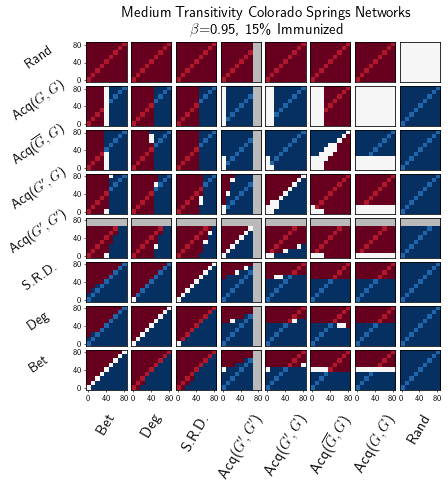

In [123]:
beta= 0.95
gamma=1.0
pctImmunized = .15
folder = 'allMedResults5and15'



title="Medium Transitivity Colorado Springs Networks\n" + r'$\beta$='+str(beta)+", "+str(int(100*pctImmunized)) +"\% Immunized"


figFileName="sigs"+folder[:12]+"beta"+pointify(beta)+"gamma"+pointify(gamma)+"pctImmunized"+pointify(pctImmunized)
signifArrs=params2signifArrs[(folder,  pctImmunized, beta, gamma)]
makeSignifPlot(figFileName, signifArrs, title)


### Supp. Fig. 7

In [124]:
beta= 0.2
gamma=1.0
pctImmunized = .10    #didnt i change the  name of this folder?
folder = 'SchoolResults10_gamma1_newCode_beta02to220'
params2signifArrs[(folder,  pctImmunized, beta, gamma)] = getSignifArrs(folder, pctImmunized, beta, gamma)


RandSamp Bet
RandSamp 0.8 ,  Bet 0.8 :  0.0
RandSamp 0.8 ,  Bet 0.7 :  0.0
RandSamp 0.8 ,  Bet 0.6 :  0.0
RandSamp 0.8 ,  Bet 0.5 :  0.0
RandSamp 0.8 ,  Bet 0.4 :  0.0
RandSamp 0.8 ,  Bet 0.3 :  0.0
RandSamp 0.8 ,  Bet 0.2 :  0.0
RandSamp 0.8 ,  Bet 0.1 :  0.0
RandSamp 0.8 ,  Bet 0.0 :  0.0
RandSamp 0.7 ,  Bet 0.8 :  0.0
RandSamp 0.7 ,  Bet 0.7 :  0.0
RandSamp 0.7 ,  Bet 0.6 :  0.0
RandSamp 0.7 ,  Bet 0.5 :  0.0
RandSamp 0.7 ,  Bet 0.4 :  0.0
RandSamp 0.7 ,  Bet 0.3 :  0.0
RandSamp 0.7 ,  Bet 0.2 :  0.0
RandSamp 0.7 ,  Bet 0.1 :  0.0
RandSamp 0.7 ,  Bet 0.0 :  0.0
RandSamp 0.6 ,  Bet 0.8 :  0.0
RandSamp 0.6 ,  Bet 0.7 :  0.0
RandSamp 0.6 ,  Bet 0.6 :  0.0
RandSamp 0.6 ,  Bet 0.5 :  0.0
RandSamp 0.6 ,  Bet 0.4 :  0.0
RandSamp 0.6 ,  Bet 0.3 :  0.0
RandSamp 0.6 ,  Bet 0.2 :  0.0
RandSamp 0.6 ,  Bet 0.1 :  0.0
RandSamp 0.6 ,  Bet 0.0 :  0.0
RandSamp 0.5 ,  Bet 0.8 :  0.0
RandSamp 0.5 ,  Bet 0.7 :  0.0
RandSamp 0.5 ,  Bet 0.6 :  0.0
RandSamp 0.5 ,  Bet 0.5 :  0.0
RandSamp 0.5 ,  Bet 0.4 : 

RandSamp 0.7 ,  acqKK2 0.3 :  0.0
RandSamp 0.7 ,  acqKK2 0.2 :  0.0
RandSamp 0.7 ,  acqKK2 0.1 :  0.0
RandSamp 0.7 ,  acqKK2 0.0 :  0.0
RandSamp 0.6 ,  acqKK2 0.8 :  nan
RandSamp 0.6 ,  acqKK2 0.7 :  0.0
RandSamp 0.6 ,  acqKK2 0.6 :  0.0
RandSamp 0.6 ,  acqKK2 0.5 :  0.0
RandSamp 0.6 ,  acqKK2 0.4 :  0.0
RandSamp 0.6 ,  acqKK2 0.3 :  0.0
RandSamp 0.6 ,  acqKK2 0.2 :  0.0
RandSamp 0.6 ,  acqKK2 0.1 :  0.0
RandSamp 0.6 ,  acqKK2 0.0 :  0.0
RandSamp 0.5 ,  acqKK2 0.8 :  nan
RandSamp 0.5 ,  acqKK2 0.7 :  0.0
RandSamp 0.5 ,  acqKK2 0.6 :  0.0
RandSamp 0.5 ,  acqKK2 0.5 :  0.0
RandSamp 0.5 ,  acqKK2 0.4 :  0.0
RandSamp 0.5 ,  acqKK2 0.3 :  0.0
RandSamp 0.5 ,  acqKK2 0.2 :  0.0
RandSamp 0.5 ,  acqKK2 0.1 :  0.0
RandSamp 0.5 ,  acqKK2 0.0 :  0.0
RandSamp 0.4 ,  acqKK2 0.8 :  nan
RandSamp 0.4 ,  acqKK2 0.7 :  0.0
RandSamp 0.4 ,  acqKK2 0.6 :  0.0
RandSamp 0.4 ,  acqKK2 0.5 :  0.0
RandSamp 0.4 ,  acqKK2 0.4 :  0.0
RandSamp 0.4 ,  acqKK2 0.3 :  0.0
RandSamp 0.4 ,  acqKK2 0.2 :  0.0
RandSamp 0.4 ,

RandSamp 0.8 ,  acqGG2 0.0 :  0.0
RandSamp 0.7 ,  acqGG2 0.8 :  0.0
RandSamp 0.7 ,  acqGG2 0.7 :  0.0
RandSamp 0.7 ,  acqGG2 0.6 :  0.0
RandSamp 0.7 ,  acqGG2 0.5 :  0.0
RandSamp 0.7 ,  acqGG2 0.4 :  0.0
RandSamp 0.7 ,  acqGG2 0.3 :  0.0
RandSamp 0.7 ,  acqGG2 0.2 :  0.0
RandSamp 0.7 ,  acqGG2 0.1 :  0.0
RandSamp 0.7 ,  acqGG2 0.0 :  0.0
RandSamp 0.6 ,  acqGG2 0.8 :  0.0
RandSamp 0.6 ,  acqGG2 0.7 :  0.0
RandSamp 0.6 ,  acqGG2 0.6 :  0.0
RandSamp 0.6 ,  acqGG2 0.5 :  0.0
RandSamp 0.6 ,  acqGG2 0.4 :  0.0
RandSamp 0.6 ,  acqGG2 0.3 :  0.0
RandSamp 0.6 ,  acqGG2 0.2 :  0.0
RandSamp 0.6 ,  acqGG2 0.1 :  0.0
RandSamp 0.6 ,  acqGG2 0.0 :  0.0
RandSamp 0.5 ,  acqGG2 0.8 :  0.0
RandSamp 0.5 ,  acqGG2 0.7 :  0.0
RandSamp 0.5 ,  acqGG2 0.6 :  0.0
RandSamp 0.5 ,  acqGG2 0.5 :  0.0
RandSamp 0.5 ,  acqGG2 0.4 :  0.0
RandSamp 0.5 ,  acqGG2 0.3 :  0.0
RandSamp 0.5 ,  acqGG2 0.2 :  0.0
RandSamp 0.5 ,  acqGG2 0.1 :  0.0
RandSamp 0.5 ,  acqGG2 0.0 :  0.0
RandSamp 0.4 ,  acqGG2 0.8 :  0.0
RandSamp 0.4 ,

acqGG2 0.2 ,  Bet 0.8 :  0.0
acqGG2 0.2 ,  Bet 0.7 :  1.1987473903108129e-124
acqGG2 0.2 ,  Bet 0.6 :  3.0123391836219327e-93
acqGG2 0.2 ,  Bet 0.5 :  0.0
acqGG2 0.2 ,  Bet 0.4 :  0.0
acqGG2 0.2 ,  Bet 0.3 :  0.0
acqGG2 0.2 ,  Bet 0.2 :  0.0
acqGG2 0.2 ,  Bet 0.1 :  0.0
acqGG2 0.2 ,  Bet 0.0 :  0.0
acqGG2 0.1 ,  Bet 0.8 :  0.0
acqGG2 0.1 ,  Bet 0.7 :  7.068304167227503e-130
acqGG2 0.1 ,  Bet 0.6 :  1.142573570938531e-87
acqGG2 0.1 ,  Bet 0.5 :  0.0
acqGG2 0.1 ,  Bet 0.4 :  0.0
acqGG2 0.1 ,  Bet 0.3 :  0.0
acqGG2 0.1 ,  Bet 0.2 :  0.0
acqGG2 0.1 ,  Bet 0.1 :  0.0
acqGG2 0.1 ,  Bet 0.0 :  0.0
acqGG2 0.0 ,  Bet 0.8 :  0.0
acqGG2 0.0 ,  Bet 0.7 :  1.262117370562957e-127
acqGG2 0.0 ,  Bet 0.6 :  9.959284770733603e-92
acqGG2 0.0 ,  Bet 0.5 :  0.0
acqGG2 0.0 ,  Bet 0.4 :  0.0
acqGG2 0.0 ,  Bet 0.3 :  0.0
acqGG2 0.0 ,  Bet 0.2 :  0.0
acqGG2 0.0 ,  Bet 0.1 :  0.0
acqGG2 0.0 ,  Bet 0.0 :  0.0
acqGG2 DegKK
acqGG2 0.8 ,  DegKK 0.8 :  0.0
acqGG2 0.8 ,  DegKK 0.7 :  1.4216935735003842e-52
acqGG2 0.8

acqGG2 0.4 ,  acqKK2 0.2 :  2.6143798518659227e-12
acqGG2 0.4 ,  acqKK2 0.1 :  0.00048071872563411637
acqGG2 0.4 ,  acqKK2 0.0 :  0.950197603365548
acqGG2 0.3 ,  acqKK2 0.8 :  nan
acqGG2 0.3 ,  acqKK2 0.7 :  0.0
acqGG2 0.3 ,  acqKK2 0.6 :  1.3522031579371668e-211
acqGG2 0.3 ,  acqKK2 0.5 :  2.1866668760116534e-111
acqGG2 0.3 ,  acqKK2 0.4 :  2.174148116012552e-52
acqGG2 0.3 ,  acqKK2 0.3 :  1.3603771047512622e-28
acqGG2 0.3 ,  acqKK2 0.2 :  1.3466554815389823e-11
acqGG2 0.3 ,  acqKK2 0.1 :  0.0011862198740140747
acqGG2 0.3 ,  acqKK2 0.0 :  0.7417793845111172
acqGG2 0.2 ,  acqKK2 0.8 :  nan
acqGG2 0.2 ,  acqKK2 0.7 :  0.0
acqGG2 0.2 ,  acqKK2 0.6 :  1.4411780490446562e-210
acqGG2 0.2 ,  acqKK2 0.5 :  6.837289534433135e-111
acqGG2 0.2 ,  acqKK2 0.4 :  3.2732516458912047e-52
acqGG2 0.2 ,  acqKK2 0.3 :  1.5541961634668056e-28
acqGG2 0.2 ,  acqKK2 0.2 :  1.3072351935937704e-11
acqGG2 0.2 ,  acqKK2 0.1 :  0.0011127919969558995
acqGG2 0.2 ,  acqKK2 0.0 :  0.7667467808248343
acqGG2 0.1 ,  acqK

acqGG2 0.3 ,  acqKG2_up 0.4 :  0.00743243291221994
acqGG2 0.3 ,  acqKG2_up 0.3 :  0.08621550367065484
acqGG2 0.3 ,  acqKG2_up 0.2 :  0.08658660343601335
acqGG2 0.3 ,  acqKG2_up 0.1 :  0.6292773999541419
acqGG2 0.3 ,  acqKG2_up 0.0 :  0.7964100508942555
acqGG2 0.2 ,  acqKG2_up 0.8 :  2.0347638306201457e-13
acqGG2 0.2 ,  acqKG2_up 0.7 :  9.267100669353842e-09
acqGG2 0.2 ,  acqKG2_up 0.6 :  3.6502588659916276e-06
acqGG2 0.2 ,  acqKG2_up 0.5 :  0.0003405646796638673
acqGG2 0.2 ,  acqKG2_up 0.4 :  0.008433445629367072
acqGG2 0.2 ,  acqKG2_up 0.3 :  0.09352005099355279
acqGG2 0.2 ,  acqKG2_up 0.2 :  0.09390555571068364
acqGG2 0.2 ,  acqKG2_up 0.1 :  0.6532377413820414
acqGG2 0.2 ,  acqKG2_up 0.0 :  0.8216821021636673
acqGG2 0.1 ,  acqKG2_up 0.8 :  1.5231875415124938e-11
acqGG2 0.1 ,  acqKG2_up 0.7 :  2.617610854737251e-07
acqGG2 0.1 ,  acqKG2_up 0.6 :  5.348189322114185e-05
acqGG2 0.1 ,  acqKG2_up 0.5 :  0.002782067855313283
acqGG2 0.1 ,  acqKG2_up 0.4 :  0.0405525917720241
acqGG2 0.1 ,  acq

acqKG2_up 0.8 ,  Bet 0.2 :  0.0
acqKG2_up 0.8 ,  Bet 0.1 :  0.0
acqKG2_up 0.8 ,  Bet 0.0 :  0.0
acqKG2_up 0.7 ,  Bet 0.8 :  0.0
acqKG2_up 0.7 ,  Bet 0.7 :  8.183844639847449e-188
acqKG2_up 0.7 ,  Bet 0.6 :  2.4137438482914353e-49
acqKG2_up 0.7 ,  Bet 0.5 :  0.0
acqKG2_up 0.7 ,  Bet 0.4 :  0.0
acqKG2_up 0.7 ,  Bet 0.3 :  0.0
acqKG2_up 0.7 ,  Bet 0.2 :  0.0
acqKG2_up 0.7 ,  Bet 0.1 :  0.0
acqKG2_up 0.7 ,  Bet 0.0 :  0.0
acqKG2_up 0.6 ,  Bet 0.8 :  0.0
acqKG2_up 0.6 ,  Bet 0.7 :  4.305105669690534e-174
acqKG2_up 0.6 ,  Bet 0.6 :  1.8852811399674968e-56
acqKG2_up 0.6 ,  Bet 0.5 :  0.0
acqKG2_up 0.6 ,  Bet 0.4 :  0.0
acqKG2_up 0.6 ,  Bet 0.3 :  0.0
acqKG2_up 0.6 ,  Bet 0.2 :  0.0
acqKG2_up 0.6 ,  Bet 0.1 :  0.0
acqKG2_up 0.6 ,  Bet 0.0 :  0.0
acqKG2_up 0.5 ,  Bet 0.8 :  0.0
acqKG2_up 0.5 ,  Bet 0.7 :  1.3772865264575197e-163
acqKG2_up 0.5 ,  Bet 0.6 :  5.9833924529124745e-65
acqKG2_up 0.5 ,  Bet 0.5 :  0.0
acqKG2_up 0.5 ,  Bet 0.4 :  0.0
acqKG2_up 0.5 ,  Bet 0.3 :  0.0
acqKG2_up 0.5 ,  Bet 

acqKG2_up 0.1 ,  Srd 0.1 :  0.0
acqKG2_up 0.1 ,  Srd 0.0 :  0.0
acqKG2_up 0.0 ,  Srd 0.8 :  3.1845526064532344e-09
acqKG2_up 0.0 ,  Srd 0.7 :  0.0
acqKG2_up 0.0 ,  Srd 0.6 :  0.0
acqKG2_up 0.0 ,  Srd 0.5 :  0.0
acqKG2_up 0.0 ,  Srd 0.4 :  0.0
acqKG2_up 0.0 ,  Srd 0.3 :  0.0
acqKG2_up 0.0 ,  Srd 0.2 :  0.0
acqKG2_up 0.0 ,  Srd 0.1 :  0.0
acqKG2_up 0.0 ,  Srd 0.0 :  0.0
acqKG2_up acqKK2
acqKG2_up 0.8 ,  acqKK2 0.8 :  nan
acqKG2_up 0.8 ,  acqKK2 0.7 :  0.0
acqKG2_up 0.8 ,  acqKK2 0.6 :  0.0
acqKG2_up 0.8 ,  acqKK2 0.5 :  8.234360541342998e-190
acqKG2_up 0.8 ,  acqKK2 0.4 :  8.522366529984003e-111
acqKG2_up 0.8 ,  acqKK2 0.3 :  7.731768793358121e-75
acqKG2_up 0.8 ,  acqKK2 0.2 :  6.622296815146208e-45
acqKG2_up 0.8 ,  acqKK2 0.1 :  4.500255971958868e-26
acqKG2_up 0.8 ,  acqKK2 0.0 :  1.6701756395428525e-12
acqKG2_up 0.7 ,  acqKK2 0.8 :  nan
acqKG2_up 0.7 ,  acqKK2 0.7 :  0.0
acqKG2_up 0.7 ,  acqKK2 0.6 :  6.904807143289081e-287
acqKG2_up 0.7 ,  acqKK2 0.5 :  3.2110818602274735e-170
acqKG2_

acqKG2_up 0.0 ,  acqKG2 0.3 :  2.8896058627998004e-07
acqKG2_up 0.0 ,  acqKG2 0.2 :  0.014489777311577953
acqKG2_up 0.0 ,  acqKG2 0.1 :  0.10315098418511544
acqKG2_up 0.0 ,  acqKG2 0.0 :  0.683392762782392
acqKG2_up acqKG2_up
acqKG2_up 0.8 ,  acqKG2_up 0.8 :  1.0
acqKG2_up 0.8 ,  acqKG2_up 0.7 :  0.11320247767287073
acqKG2_up 0.8 ,  acqKG2_up 0.6 :  0.007209893900505964
acqKG2_up 0.8 ,  acqKG2_up 0.5 :  0.00015319642505803158
acqKG2_up 0.8 ,  acqKG2_up 0.4 :  2.6012558211691357e-06
acqKG2_up 0.8 ,  acqKG2_up 0.3 :  1.4814830768810835e-08
acqKG2_up 0.8 ,  acqKG2_up 0.2 :  1.531593378367185e-08
acqKG2_up 0.8 ,  acqKG2_up 0.1 :  5.176870436558332e-12
acqKG2_up 0.8 ,  acqKG2_up 0.0 :  9.229652788947948e-13
acqKG2_up 0.7 ,  acqKG2_up 0.8 :  0.11320247767287073
acqKG2_up 0.7 ,  acqKG2_up 0.7 :  1.0
acqKG2_up 0.7 ,  acqKG2_up 0.6 :  0.2702655886093455
acqKG2_up 0.7 ,  acqKG2_up 0.5 :  0.028739527019769815
acqKG2_up 0.7 ,  acqKG2_up 0.4 :  0.0018928377240309657
acqKG2_up 0.7 ,  acqKG2_up 0.3 :

acqKG2_up 0.0 ,  acqGG2 0.4 :  0.9927492165534586
acqKG2_up 0.0 ,  acqGG2 0.3 :  0.7964100508942555
acqKG2_up 0.0 ,  acqGG2 0.2 :  0.8216821021636673
acqKG2_up 0.0 ,  acqGG2 0.1 :  0.72145953022933
acqKG2_up 0.0 ,  acqGG2 0.0 :  0.9901337115097947
acqKG2_up RandSamp
acqKG2_up 0.8 ,  RandSamp 0.8 :  0.0
acqKG2_up 0.8 ,  RandSamp 0.7 :  0.0
acqKG2_up 0.8 ,  RandSamp 0.6 :  0.0
acqKG2_up 0.8 ,  RandSamp 0.5 :  0.0
acqKG2_up 0.8 ,  RandSamp 0.4 :  0.0
acqKG2_up 0.8 ,  RandSamp 0.3 :  0.0
acqKG2_up 0.8 ,  RandSamp 0.2 :  0.0
acqKG2_up 0.8 ,  RandSamp 0.1 :  0.0
acqKG2_up 0.8 ,  RandSamp 0.0 :  0.0
acqKG2_up 0.7 ,  RandSamp 0.8 :  0.0
acqKG2_up 0.7 ,  RandSamp 0.7 :  0.0
acqKG2_up 0.7 ,  RandSamp 0.6 :  0.0
acqKG2_up 0.7 ,  RandSamp 0.5 :  0.0
acqKG2_up 0.7 ,  RandSamp 0.4 :  0.0
acqKG2_up 0.7 ,  RandSamp 0.3 :  0.0
acqKG2_up 0.7 ,  RandSamp 0.2 :  0.0
acqKG2_up 0.7 ,  RandSamp 0.1 :  0.0
acqKG2_up 0.7 ,  RandSamp 0.0 :  0.0
acqKG2_up 0.6 ,  RandSamp 0.8 :  0.0
acqKG2_up 0.6 ,  RandSamp 0.7 

acqKG2 0.0 ,  DegKK 0.8 :  0.0
acqKG2 0.0 ,  DegKK 0.7 :  1.8928378575691435e-53
acqKG2 0.0 ,  DegKK 0.6 :  2.3454738220114705e-218
acqKG2 0.0 ,  DegKK 0.5 :  0.0
acqKG2 0.0 ,  DegKK 0.4 :  0.0
acqKG2 0.0 ,  DegKK 0.3 :  0.0
acqKG2 0.0 ,  DegKK 0.2 :  0.0
acqKG2 0.0 ,  DegKK 0.1 :  0.0
acqKG2 0.0 ,  DegKK 0.0 :  0.0
acqKG2 Srd
acqKG2 0.8 ,  Srd 0.8 :  1.8455683706968765e-219
acqKG2 0.8 ,  Srd 0.7 :  0.0
acqKG2 0.8 ,  Srd 0.6 :  0.0
acqKG2 0.8 ,  Srd 0.5 :  0.0
acqKG2 0.8 ,  Srd 0.4 :  0.0
acqKG2 0.8 ,  Srd 0.3 :  0.0
acqKG2 0.8 ,  Srd 0.2 :  0.0
acqKG2 0.8 ,  Srd 0.1 :  0.0
acqKG2 0.8 ,  Srd 0.0 :  0.0
acqKG2 0.7 ,  Srd 0.8 :  1.2488360865261654e-123
acqKG2 0.7 ,  Srd 0.7 :  0.0
acqKG2 0.7 ,  Srd 0.6 :  0.0
acqKG2 0.7 ,  Srd 0.5 :  0.0
acqKG2 0.7 ,  Srd 0.4 :  0.0
acqKG2 0.7 ,  Srd 0.3 :  0.0
acqKG2 0.7 ,  Srd 0.2 :  0.0
acqKG2 0.7 ,  Srd 0.1 :  0.0
acqKG2 0.7 ,  Srd 0.0 :  0.0
acqKG2 0.6 ,  Srd 0.8 :  1.9290419753497445e-82
acqKG2 0.6 ,  Srd 0.7 :  0.0
acqKG2 0.6 ,  Srd 0.6 :  0.0
acq

acqKG2 0.4 ,  acqKG2 0.7 :  6.336719421114864e-32
acqKG2 0.4 ,  acqKG2 0.6 :  7.659337297929795e-13
acqKG2 0.4 ,  acqKG2 0.5 :  0.003411734229840837
acqKG2 0.4 ,  acqKG2 0.4 :  1.0
acqKG2 0.4 ,  acqKG2 0.3 :  0.25302956850317543
acqKG2 0.4 ,  acqKG2 0.2 :  0.00014324557236604422
acqKG2 0.4 ,  acqKG2 0.1 :  4.0129091590663574e-06
acqKG2 0.4 ,  acqKG2 0.0 :  6.51868792963684e-09
acqKG2 0.3 ,  acqKG2 0.8 :  3.0876819899291047e-100
acqKG2 0.3 ,  acqKG2 0.7 :  2.6746930339625233e-38
acqKG2 0.3 ,  acqKG2 0.6 :  7.261452222381454e-17
acqKG2 0.3 ,  acqKG2 0.5 :  4.3342924816938734e-05
acqKG2 0.3 ,  acqKG2 0.4 :  0.25302956850317543
acqKG2 0.3 ,  acqKG2 0.3 :  1.0
acqKG2 0.3 ,  acqKG2 0.2 :  0.007428253132467049
acqKG2 0.3 ,  acqKG2 0.1 :  0.00048226063646456956
acqKG2 0.3 ,  acqKG2 0.0 :  2.6840250821569804e-06
acqKG2 0.2 ,  acqKG2 0.8 :  1.1759707094919538e-124
acqKG2 0.2 ,  acqKG2 0.7 :  2.419079674149235e-54
acqKG2 0.2 ,  acqKG2 0.6 :  5.098942727245199e-28
acqKG2 0.2 ,  acqKG2 0.5 :  1.513

acqKG2 0.4 ,  acqGG2 0.8 :  1.6233391979414717e-08
acqKG2 0.4 ,  acqGG2 0.7 :  2.3782108651190804e-10
acqKG2 0.4 ,  acqGG2 0.6 :  1.1380458510783957e-09
acqKG2 0.4 ,  acqGG2 0.5 :  2.905169322719959e-10
acqKG2 0.4 ,  acqGG2 0.4 :  4.5667230063191237e-10
acqKG2 0.4 ,  acqGG2 0.3 :  2.018979588972432e-09
acqKG2 0.4 ,  acqGG2 0.2 :  1.9304695021778794e-09
acqKG2 0.4 ,  acqGG2 0.1 :  5.243690673402365e-11
acqKG2 0.4 ,  acqGG2 0.0 :  3.957785024576139e-10
acqKG2 0.3 ,  acqGG2 0.8 :  5.7576983666624875e-06
acqKG2 0.3 ,  acqGG2 0.7 :  1.7742641268774573e-07
acqKG2 0.3 ,  acqGG2 0.6 :  6.396076194948342e-07
acqKG2 0.3 ,  acqGG2 0.5 :  2.100733199271906e-07
acqKG2 0.3 ,  acqGG2 0.4 :  2.992189968464848e-07
acqKG2 0.3 ,  acqGG2 0.3 :  1.0576367371349963e-06
acqKG2 0.3 ,  acqGG2 0.2 :  9.970680809513152e-07
acqKG2 0.3 ,  acqGG2 0.1 :  4.788172696900824e-08
acqKG2 0.3 ,  acqGG2 0.0 :  2.701135576679014e-07
acqKG2 0.2 ,  acqGG2 0.8 :  0.06307140808927046
acqKG2 0.2 ,  acqGG2 0.7 :  0.01131686826375

acqKK2 0.6 ,  DegKK 0.6 :  0.0
acqKK2 0.6 ,  DegKK 0.5 :  0.0
acqKK2 0.6 ,  DegKK 0.4 :  0.0
acqKK2 0.6 ,  DegKK 0.3 :  0.0
acqKK2 0.6 ,  DegKK 0.2 :  0.0
acqKK2 0.6 ,  DegKK 0.1 :  0.0
acqKK2 0.6 ,  DegKK 0.0 :  0.0
acqKK2 0.5 ,  DegKK 0.8 :  0.0
acqKK2 0.5 ,  DegKK 0.7 :  1.3323007590664366e-12
acqKK2 0.5 ,  DegKK 0.6 :  0.0
acqKK2 0.5 ,  DegKK 0.5 :  0.0
acqKK2 0.5 ,  DegKK 0.4 :  0.0
acqKK2 0.5 ,  DegKK 0.3 :  0.0
acqKK2 0.5 ,  DegKK 0.2 :  0.0
acqKK2 0.5 ,  DegKK 0.1 :  0.0
acqKK2 0.5 ,  DegKK 0.0 :  0.0
acqKK2 0.4 ,  DegKK 0.8 :  0.0
acqKK2 0.4 ,  DegKK 0.7 :  0.7749770899119853
acqKK2 0.4 ,  DegKK 0.6 :  0.0
acqKK2 0.4 ,  DegKK 0.5 :  0.0
acqKK2 0.4 ,  DegKK 0.4 :  0.0
acqKK2 0.4 ,  DegKK 0.3 :  0.0
acqKK2 0.4 ,  DegKK 0.2 :  0.0
acqKK2 0.4 ,  DegKK 0.1 :  0.0
acqKK2 0.4 ,  DegKK 0.0 :  0.0
acqKK2 0.3 ,  DegKK 0.8 :  0.0
acqKK2 0.3 ,  DegKK 0.7 :  7.684907226781219e-06
acqKK2 0.3 ,  DegKK 0.6 :  0.0
acqKK2 0.3 ,  DegKK 0.5 :  0.0
acqKK2 0.3 ,  DegKK 0.4 :  0.0
acqKK2 0.3 ,  DegK

acqKK2 0.8 ,  acqKG2 0.0 :  nan
acqKK2 0.7 ,  acqKG2 0.8 :  5.9030101558155495e-89
acqKK2 0.7 ,  acqKG2 0.7 :  1.2364902966860395e-174
acqKK2 0.7 ,  acqKG2 0.6 :  1.978690051487377e-233
acqKK2 0.7 ,  acqKG2 0.5 :  1.4799860251405542e-291
acqKK2 0.7 ,  acqKG2 0.4 :  0.0
acqKK2 0.7 ,  acqKG2 0.3 :  0.0
acqKK2 0.7 ,  acqKG2 0.2 :  0.0
acqKK2 0.7 ,  acqKG2 0.1 :  0.0
acqKK2 0.7 ,  acqKG2 0.0 :  0.0
acqKK2 0.6 ,  acqKG2 0.8 :  1.734298204191134e-07
acqKK2 0.6 ,  acqKG2 0.7 :  5.227113729833003e-43
acqKK2 0.6 ,  acqKG2 0.6 :  9.88953750114239e-76
acqKK2 0.6 ,  acqKG2 0.5 :  1.1972451127693468e-112
acqKK2 0.6 ,  acqKG2 0.4 :  5.881139450049741e-141
acqKK2 0.6 ,  acqKG2 0.3 :  2.0931407745358714e-154
acqKK2 0.6 ,  acqKG2 0.2 :  5.67751695905081e-184
acqKK2 0.6 ,  acqKG2 0.1 :  1.6026457760163422e-193
acqKK2 0.6 ,  acqKG2 0.0 :  3.4249788616028184e-207
acqKK2 0.5 ,  acqKG2 0.8 :  0.0001749080070167007
acqKK2 0.5 ,  acqKG2 0.7 :  1.6990415260710028e-06
acqKK2 0.5 ,  acqKG2 0.6 :  2.5377024461809

acqKK2 0.6 ,  acqGG2 0.3 :  1.3522031579371668e-211
acqKK2 0.6 ,  acqGG2 0.2 :  1.4411780490446562e-210
acqKK2 0.6 ,  acqGG2 0.1 :  7.204395241425872e-217
acqKK2 0.6 ,  acqGG2 0.0 :  1.8247155909433857e-214
acqKK2 0.5 ,  acqGG2 0.8 :  1.715970567621015e-107
acqKK2 0.5 ,  acqGG2 0.7 :  1.53321280670932e-114
acqKK2 0.5 ,  acqGG2 0.6 :  1.4285216013121858e-111
acqKK2 0.5 ,  acqGG2 0.5 :  2.816311331020011e-114
acqKK2 0.5 ,  acqGG2 0.4 :  5.438966779955207e-113
acqKK2 0.5 ,  acqGG2 0.3 :  2.1866668760116534e-111
acqKK2 0.5 ,  acqGG2 0.2 :  6.837289534433135e-111
acqKK2 0.5 ,  acqGG2 0.1 :  8.139126097693922e-116
acqKK2 0.5 ,  acqGG2 0.0 :  1.2298928540313142e-113
acqKK2 0.4 ,  acqGG2 0.8 :  6.939450702452018e-50
acqKK2 0.4 ,  acqGG2 0.7 :  1.3316247286739285e-54
acqKK2 0.4 ,  acqGG2 0.6 :  1.0152653091251635e-52
acqKK2 0.4 ,  acqGG2 0.5 :  2.0802128999518408e-54
acqKK2 0.4 ,  acqGG2 0.4 :  1.079791118711818e-53
acqKK2 0.4 ,  acqGG2 0.3 :  2.174148116012552e-52
acqKK2 0.4 ,  acqGG2 0.2 :  3

Srd 0.8 ,  DegKK 0.2 :  0.0
Srd 0.8 ,  DegKK 0.1 :  0.0
Srd 0.8 ,  DegKK 0.0 :  0.0
Srd 0.7 ,  DegKK 0.8 :  0.0
Srd 0.7 ,  DegKK 0.7 :  0.0
Srd 0.7 ,  DegKK 0.6 :  0.0
Srd 0.7 ,  DegKK 0.5 :  0.5191265252007069
Srd 0.7 ,  DegKK 0.4 :  0.0
Srd 0.7 ,  DegKK 0.3 :  0.0
Srd 0.7 ,  DegKK 0.2 :  0.0
Srd 0.7 ,  DegKK 0.1 :  0.0
Srd 0.7 ,  DegKK 0.0 :  0.0
Srd 0.6 ,  DegKK 0.8 :  0.0
Srd 0.6 ,  DegKK 0.7 :  0.0
Srd 0.6 ,  DegKK 0.6 :  0.0
Srd 0.6 ,  DegKK 0.5 :  0.0
Srd 0.6 ,  DegKK 0.4 :  4.78198454761772e-15
Srd 0.6 ,  DegKK 0.3 :  1.0844123703397568e-264
Srd 0.6 ,  DegKK 0.2 :  0.0
Srd 0.6 ,  DegKK 0.1 :  0.0
Srd 0.6 ,  DegKK 0.0 :  0.0
Srd 0.5 ,  DegKK 0.8 :  0.0
Srd 0.5 ,  DegKK 0.7 :  0.0
Srd 0.5 ,  DegKK 0.6 :  0.0
Srd 0.5 ,  DegKK 0.5 :  0.0
Srd 0.5 ,  DegKK 0.4 :  0.0
Srd 0.5 ,  DegKK 0.3 :  8.847095880100813e-07
Srd 0.5 ,  DegKK 0.2 :  5.540217606659239e-299
Srd 0.5 ,  DegKK 0.1 :  0.0
Srd 0.5 ,  DegKK 0.0 :  0.0
Srd 0.4 ,  DegKK 0.8 :  0.0
Srd 0.4 ,  DegKK 0.7 :  0.0
Srd 0.4 ,  DegK

Srd 0.5 ,  acqKG2 0.1 :  0.0
Srd 0.5 ,  acqKG2 0.0 :  0.0
Srd 0.4 ,  acqKG2 0.8 :  0.0
Srd 0.4 ,  acqKG2 0.7 :  0.0
Srd 0.4 ,  acqKG2 0.6 :  0.0
Srd 0.4 ,  acqKG2 0.5 :  0.0
Srd 0.4 ,  acqKG2 0.4 :  0.0
Srd 0.4 ,  acqKG2 0.3 :  0.0
Srd 0.4 ,  acqKG2 0.2 :  0.0
Srd 0.4 ,  acqKG2 0.1 :  0.0
Srd 0.4 ,  acqKG2 0.0 :  0.0
Srd 0.3 ,  acqKG2 0.8 :  0.0
Srd 0.3 ,  acqKG2 0.7 :  0.0
Srd 0.3 ,  acqKG2 0.6 :  0.0
Srd 0.3 ,  acqKG2 0.5 :  0.0
Srd 0.3 ,  acqKG2 0.4 :  0.0
Srd 0.3 ,  acqKG2 0.3 :  0.0
Srd 0.3 ,  acqKG2 0.2 :  0.0
Srd 0.3 ,  acqKG2 0.1 :  0.0
Srd 0.3 ,  acqKG2 0.0 :  0.0
Srd 0.2 ,  acqKG2 0.8 :  0.0
Srd 0.2 ,  acqKG2 0.7 :  0.0
Srd 0.2 ,  acqKG2 0.6 :  0.0
Srd 0.2 ,  acqKG2 0.5 :  0.0
Srd 0.2 ,  acqKG2 0.4 :  0.0
Srd 0.2 ,  acqKG2 0.3 :  0.0
Srd 0.2 ,  acqKG2 0.2 :  0.0
Srd 0.2 ,  acqKG2 0.1 :  0.0
Srd 0.2 ,  acqKG2 0.0 :  0.0
Srd 0.1 ,  acqKG2 0.8 :  0.0
Srd 0.1 ,  acqKG2 0.7 :  0.0
Srd 0.1 ,  acqKG2 0.6 :  0.0
Srd 0.1 ,  acqKG2 0.5 :  0.0
Srd 0.1 ,  acqKG2 0.4 :  0.0
Srd 0.1 ,  acq

Srd 0.3 ,  RandSamp 0.3 :  0.0
Srd 0.3 ,  RandSamp 0.2 :  0.0
Srd 0.3 ,  RandSamp 0.1 :  0.0
Srd 0.3 ,  RandSamp 0.0 :  0.0
Srd 0.2 ,  RandSamp 0.8 :  0.0
Srd 0.2 ,  RandSamp 0.7 :  0.0
Srd 0.2 ,  RandSamp 0.6 :  0.0
Srd 0.2 ,  RandSamp 0.5 :  0.0
Srd 0.2 ,  RandSamp 0.4 :  0.0
Srd 0.2 ,  RandSamp 0.3 :  0.0
Srd 0.2 ,  RandSamp 0.2 :  0.0
Srd 0.2 ,  RandSamp 0.1 :  0.0
Srd 0.2 ,  RandSamp 0.0 :  0.0
Srd 0.1 ,  RandSamp 0.8 :  0.0
Srd 0.1 ,  RandSamp 0.7 :  0.0
Srd 0.1 ,  RandSamp 0.6 :  0.0
Srd 0.1 ,  RandSamp 0.5 :  0.0
Srd 0.1 ,  RandSamp 0.4 :  0.0
Srd 0.1 ,  RandSamp 0.3 :  0.0
Srd 0.1 ,  RandSamp 0.2 :  0.0
Srd 0.1 ,  RandSamp 0.1 :  0.0
Srd 0.1 ,  RandSamp 0.0 :  0.0
Srd 0.0 ,  RandSamp 0.8 :  0.0
Srd 0.0 ,  RandSamp 0.7 :  0.0
Srd 0.0 ,  RandSamp 0.6 :  0.0
Srd 0.0 ,  RandSamp 0.5 :  0.0
Srd 0.0 ,  RandSamp 0.4 :  0.0
Srd 0.0 ,  RandSamp 0.3 :  0.0
Srd 0.0 ,  RandSamp 0.2 :  0.0
Srd 0.0 ,  RandSamp 0.1 :  0.0
Srd 0.0 ,  RandSamp 0.0 :  0.0
DegKK Bet
DegKK 0.8 ,  Bet 0.8 :  0.000

DegKK 0.0 ,  Srd 0.6 :  0.0
DegKK 0.0 ,  Srd 0.5 :  0.0
DegKK 0.0 ,  Srd 0.4 :  0.0
DegKK 0.0 ,  Srd 0.3 :  0.0
DegKK 0.0 ,  Srd 0.2 :  0.0
DegKK 0.0 ,  Srd 0.1 :  2.70212682905536e-81
DegKK 0.0 ,  Srd 0.0 :  0.8764914355728204
DegKK acqKK2
DegKK 0.8 ,  acqKK2 0.8 :  nan
DegKK 0.8 ,  acqKK2 0.7 :  4.2229578450645714e-85
DegKK 0.8 ,  acqKK2 0.6 :  1.0180148309202161e-252
DegKK 0.8 ,  acqKK2 0.5 :  0.0
DegKK 0.8 ,  acqKK2 0.4 :  0.0
DegKK 0.8 ,  acqKK2 0.3 :  0.0
DegKK 0.8 ,  acqKK2 0.2 :  0.0
DegKK 0.8 ,  acqKK2 0.1 :  0.0
DegKK 0.8 ,  acqKK2 0.0 :  0.0
DegKK 0.7 ,  acqKK2 0.8 :  nan
DegKK 0.7 ,  acqKK2 0.7 :  3.20972947087511e-204
DegKK 0.7 ,  acqKK2 0.6 :  2.6417758706173376e-58
DegKK 0.7 ,  acqKK2 0.5 :  1.3323007590664366e-12
DegKK 0.7 ,  acqKK2 0.4 :  0.7749770899119853
DegKK 0.7 ,  acqKK2 0.3 :  7.684907226781219e-06
DegKK 0.7 ,  acqKK2 0.2 :  8.224649123589225e-19
DegKK 0.7 ,  acqKK2 0.1 :  6.679214380863438e-35
DegKK 0.7 ,  acqKK2 0.0 :  4.068304037801097e-57
DegKK 0.6 ,  acqKK2

DegKK 0.1 ,  acqKG2_up 0.7 :  0.0
DegKK 0.1 ,  acqKG2_up 0.6 :  0.0
DegKK 0.1 ,  acqKG2_up 0.5 :  0.0
DegKK 0.1 ,  acqKG2_up 0.4 :  0.0
DegKK 0.1 ,  acqKG2_up 0.3 :  0.0
DegKK 0.1 ,  acqKG2_up 0.2 :  0.0
DegKK 0.1 ,  acqKG2_up 0.1 :  0.0
DegKK 0.1 ,  acqKG2_up 0.0 :  0.0
DegKK 0.0 ,  acqKG2_up 0.8 :  0.0
DegKK 0.0 ,  acqKG2_up 0.7 :  0.0
DegKK 0.0 ,  acqKG2_up 0.6 :  0.0
DegKK 0.0 ,  acqKG2_up 0.5 :  0.0
DegKK 0.0 ,  acqKG2_up 0.4 :  0.0
DegKK 0.0 ,  acqKG2_up 0.3 :  0.0
DegKK 0.0 ,  acqKG2_up 0.2 :  0.0
DegKK 0.0 ,  acqKG2_up 0.1 :  0.0
DegKK 0.0 ,  acqKG2_up 0.0 :  0.0
DegKK acqGG2
DegKK 0.8 ,  acqGG2 0.8 :  0.0
DegKK 0.8 ,  acqGG2 0.7 :  0.0
DegKK 0.8 ,  acqGG2 0.6 :  0.0
DegKK 0.8 ,  acqGG2 0.5 :  0.0
DegKK 0.8 ,  acqGG2 0.4 :  0.0
DegKK 0.8 ,  acqGG2 0.3 :  0.0
DegKK 0.8 ,  acqGG2 0.2 :  0.0
DegKK 0.8 ,  acqGG2 0.1 :  0.0
DegKK 0.8 ,  acqGG2 0.0 :  0.0
DegKK 0.7 ,  acqGG2 0.8 :  1.4216935735003842e-52
DegKK 0.7 ,  acqGG2 0.7 :  1.7922620465110062e-57
DegKK 0.7 ,  acqGG2 0.6 :  1.6

Bet 0.0 ,  Bet 0.0 :  1.0
Bet DegKK
Bet 0.8 ,  DegKK 0.8 :  0.0004267208686795545
Bet 0.8 ,  DegKK 0.7 :  0.0
Bet 0.8 ,  DegKK 0.6 :  0.0
Bet 0.8 ,  DegKK 0.5 :  0.0
Bet 0.8 ,  DegKK 0.4 :  0.0
Bet 0.8 ,  DegKK 0.3 :  0.0
Bet 0.8 ,  DegKK 0.2 :  0.0
Bet 0.8 ,  DegKK 0.1 :  0.0
Bet 0.8 ,  DegKK 0.0 :  0.0
Bet 0.7 ,  DegKK 0.8 :  0.0
Bet 0.7 ,  DegKK 0.7 :  9.430704497317789e-17
Bet 0.7 ,  DegKK 0.6 :  0.0
Bet 0.7 ,  DegKK 0.5 :  0.0
Bet 0.7 ,  DegKK 0.4 :  0.0
Bet 0.7 ,  DegKK 0.3 :  0.0
Bet 0.7 ,  DegKK 0.2 :  0.0
Bet 0.7 ,  DegKK 0.1 :  0.0
Bet 0.7 ,  DegKK 0.0 :  0.0
Bet 0.6 ,  DegKK 0.8 :  0.0
Bet 0.6 ,  DegKK 0.7 :  7.128198593522594e-277
Bet 0.6 ,  DegKK 0.6 :  1.7700183415643703e-33
Bet 0.6 ,  DegKK 0.5 :  0.0
Bet 0.6 ,  DegKK 0.4 :  0.0
Bet 0.6 ,  DegKK 0.3 :  0.0
Bet 0.6 ,  DegKK 0.2 :  0.0
Bet 0.6 ,  DegKK 0.1 :  0.0
Bet 0.6 ,  DegKK 0.0 :  0.0
Bet 0.5 ,  DegKK 0.8 :  0.0
Bet 0.5 ,  DegKK 0.7 :  0.0
Bet 0.5 ,  DegKK 0.6 :  1.4818223763711409e-229
Bet 0.5 ,  DegKK 0.5 :  1.4678

Bet 0.6 ,  acqKG2 0.8 :  0.0
Bet 0.6 ,  acqKG2 0.7 :  2.4857561885204298e-303
Bet 0.6 ,  acqKG2 0.6 :  7.399410685931977e-241
Bet 0.6 ,  acqKG2 0.5 :  3.149524216341921e-187
Bet 0.6 ,  acqKG2 0.4 :  3.9024883909510736e-152
Bet 0.6 ,  acqKG2 0.3 :  1.7573435341563477e-141
Bet 0.6 ,  acqKG2 0.2 :  9.830562872051526e-114
Bet 0.6 ,  acqKG2 0.1 :  5.80669605414479e-106
Bet 0.6 ,  acqKG2 0.0 :  3.5269778085256184e-94
Bet 0.5 ,  acqKG2 0.8 :  0.0
Bet 0.5 ,  acqKG2 0.7 :  0.0
Bet 0.5 ,  acqKG2 0.6 :  0.0
Bet 0.5 ,  acqKG2 0.5 :  0.0
Bet 0.5 ,  acqKG2 0.4 :  0.0
Bet 0.5 ,  acqKG2 0.3 :  0.0
Bet 0.5 ,  acqKG2 0.2 :  0.0
Bet 0.5 ,  acqKG2 0.1 :  0.0
Bet 0.5 ,  acqKG2 0.0 :  0.0
Bet 0.4 ,  acqKG2 0.8 :  0.0
Bet 0.4 ,  acqKG2 0.7 :  0.0
Bet 0.4 ,  acqKG2 0.6 :  0.0
Bet 0.4 ,  acqKG2 0.5 :  0.0
Bet 0.4 ,  acqKG2 0.4 :  0.0
Bet 0.4 ,  acqKG2 0.3 :  0.0
Bet 0.4 ,  acqKG2 0.2 :  0.0
Bet 0.4 ,  acqKG2 0.1 :  0.0
Bet 0.4 ,  acqKG2 0.0 :  0.0
Bet 0.3 ,  acqKG2 0.8 :  0.0
Bet 0.3 ,  acqKG2 0.7 :  0.0
Bet 0

Bet 0.6 ,  RandSamp 0.2 :  0.0
Bet 0.6 ,  RandSamp 0.1 :  0.0
Bet 0.6 ,  RandSamp 0.0 :  0.0
Bet 0.5 ,  RandSamp 0.8 :  0.0
Bet 0.5 ,  RandSamp 0.7 :  0.0
Bet 0.5 ,  RandSamp 0.6 :  0.0
Bet 0.5 ,  RandSamp 0.5 :  0.0
Bet 0.5 ,  RandSamp 0.4 :  0.0
Bet 0.5 ,  RandSamp 0.3 :  0.0
Bet 0.5 ,  RandSamp 0.2 :  0.0
Bet 0.5 ,  RandSamp 0.1 :  0.0
Bet 0.5 ,  RandSamp 0.0 :  0.0
Bet 0.4 ,  RandSamp 0.8 :  0.0
Bet 0.4 ,  RandSamp 0.7 :  0.0
Bet 0.4 ,  RandSamp 0.6 :  0.0
Bet 0.4 ,  RandSamp 0.5 :  0.0
Bet 0.4 ,  RandSamp 0.4 :  0.0
Bet 0.4 ,  RandSamp 0.3 :  0.0
Bet 0.4 ,  RandSamp 0.2 :  0.0
Bet 0.4 ,  RandSamp 0.1 :  0.0
Bet 0.4 ,  RandSamp 0.0 :  0.0
Bet 0.3 ,  RandSamp 0.8 :  0.0
Bet 0.3 ,  RandSamp 0.7 :  0.0
Bet 0.3 ,  RandSamp 0.6 :  0.0
Bet 0.3 ,  RandSamp 0.5 :  0.0
Bet 0.3 ,  RandSamp 0.4 :  0.0
Bet 0.3 ,  RandSamp 0.3 :  0.0
Bet 0.3 ,  RandSamp 0.2 :  0.0
Bet 0.3 ,  RandSamp 0.1 :  0.0
Bet 0.3 ,  RandSamp 0.0 :  0.0
Bet 0.2 ,  RandSamp 0.8 :  0.0
Bet 0.2 ,  RandSamp 0.7 :  0.0
Bet 0.2 

1
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.1 0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.1 0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.1 0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.1 0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.1 0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.  0.1 0. ]
 [0.  0.  0.  0.  0.  0.  0.  0.  0.1]]
2
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.1 0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.1 0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.1 0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.1 0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.1 0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.  0.1 0. ]
 [0.  0.  0.  0.  0.  0.  0.  0.  0.1]]
3
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.1 0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.1 0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.1 0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.1 0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.1 0.  0. ]
 [0.  0.  0.  0. 

22
[[0.5 0.5 0.5 0.5 0.5 1.  1.  1.  1. ]
 [0.5 0.5 0.5 0.5 0.5 0.5 0.5 1.  1. ]
 [0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [0.  0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [0.  0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [0.  0.  0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [0.  0.  0.5 0.5 0.5 0.5 0.5 0.5 0.5]]
23
[[0.9 1.  1.  1.  1.  1.  1.  1.  1. ]
 [1.  0.9 1.  1.  1.  1.  1.  1.  1. ]
 [0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]]
24
[[0.9 1.  1.  1.  1.  1.  1.  1.  1. ]
 [1.  0.9 1.  1.  1.  1.  1.  1.  1. ]
 [1.  1.  0.9 1.  1.  1.  1.  1.  1. ]
 [1.  1.  1.  0.9 1.  1.  1.  1.  1. ]
 [1.  1.  1.  1.  0.9 1.  1.  1.  1. ]
 [1.  1.  1.  1.  1.  0.9 1.  1.  1. ]
 [1.  1.  1.  1.  1.  1.  0.9 1.  1. ]
 [1.  1.  1.  

43
[[0.5 0.  0.  0.  0.  0.  0.  0.  0. ]
 [1.  0.5 0.  0.  0.  0.  0.  0.  0. ]
 [1.  1.  0.5 0.  0.  0.  0.  0.  0. ]
 [1.  1.  1.  0.5 0.  0.  0.  0.  0. ]
 [1.  1.  1.  1.  0.5 0.  0.  0.  0. ]
 [1.  1.  1.  1.  1.  0.5 0.  0.  0. ]
 [1.  1.  1.  1.  1.  1.  0.5 0.  0. ]
 [1.  1.  1.  1.  1.  1.  1.  0.5 0. ]
 [1.  1.  1.  1.  1.  1.  1.  1.  0.5]]
44
[[0.43359375 1.         1.         1.         1.         1.
  1.         1.         1.        ]
 [0.43359375 0.9        1.         1.         1.         1.
  1.         1.         1.        ]
 [0.43359375 1.         0.9        1.         1.         1.
  1.         1.         1.        ]
 [0.43359375 1.         1.         0.9        1.         1.
  1.         1.         1.        ]
 [0.43359375 1.         1.         1.         0.9        1.
  1.         1.         1.        ]
 [0.43359375 1.         1.         1.         1.         0.9
  1.         1.         1.        ]
 [0.43359375 1.         1.         1.         1.         1.
  0.9

 [1.  1.  1.  1.  1.  1.  1.  1.  0.9]]
62
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [1.  1.  0.9 1.  1.  1.  1.  1.  1. ]
 [1.  1.  1.  0.9 1.  1.  1.  1.  1. ]
 [1.  1.  1.  1.  0.9 1.  1.  1.  1. ]
 [1.  1.  1.  1.  1.  0.9 1.  1.  1. ]
 [1.  1.  1.  1.  1.  1.  0.9 1.  1. ]
 [1.  1.  1.  1.  1.  1.  1.  0.9 1. ]
 [1.  1.  1.  1.  1.  1.  1.  1.  0.9]]
63
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [1.  1.  0.9 1.  1.  1.  1.  1.  1. ]
 [1.  1.  1.  0.9 1.  1.  1.  1.  1. ]
 [1.  1.  1.  1.  0.9 1.  1.  1.  1. ]
 [1.  1.  1.  1.  1.  0.9 1.  1.  1. ]
 [1.  1.  1.  1.  1.  1.  0.9 1.  1. ]
 [1.  1.  1.  1.  1.  1.  1.  0.9 1. ]
 [1.  1.  1.  1.  1.  1.  1.  1.  0.9]]
64
[[0.9 1.  1.  1.  1.  1.  1.  1.  1. ]
 [1.  0.9 1.  1.  1.  1.  1.  1.  1. ]
 [1.  1.  0.9 1.  1.  1.  1.  1.  1. ]
 [1.  1.  1.  0.9 1.  1.  1.  1.  1. ]
 [1.  1.  1.  1.  0.9 1.  1.  1.  1. ]
 [1.  1.  1.  1.  1.  0.9 1.  1.  1. ]
 [1.  1.  1. 

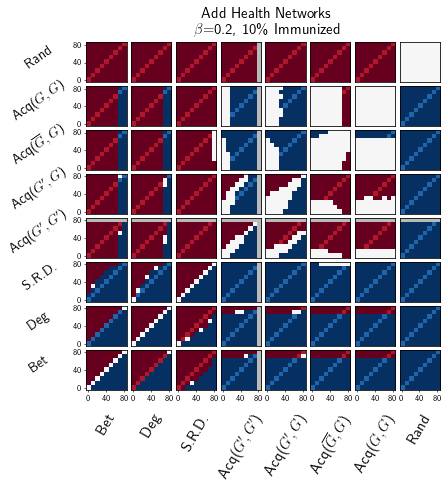

In [125]:
beta= 0.2
gamma=1.0
pctImmunized = .10
folder = 'SchoolResults10_gamma1_newCode_beta02to220'


title="Add Health Networks\n" + r'$\beta$='+str(beta)+", "+str(int(100*pctImmunized)) +"\% Immunized"


figFileName="sigs"+folder[:12]+"beta"+pointify(beta)+"gamma"+pointify(gamma)+"pctImmunized"+pointify(pctImmunized)
signifArrs=params2signifArrs[(folder,  pctImmunized, beta, gamma)]
makeSignifPlot(figFileName, signifArrs, title)


### Supp. Fig. 7.ii

In [126]:
beta= 0.95
gamma=1.0
pctImmunized = .10    #didnt i change the  name of this folder?
folder = 'SchoolResults10_gamma1_newCode_beta02to220'
params2signifArrs[(folder,  pctImmunized, beta, gamma)] = getSignifArrs(folder, pctImmunized, beta, gamma)


RandSamp Bet
RandSamp 0.8 ,  Bet 0.8 :  0.0
RandSamp 0.8 ,  Bet 0.7 :  0.0
RandSamp 0.8 ,  Bet 0.6 :  0.0
RandSamp 0.8 ,  Bet 0.5 :  0.0
RandSamp 0.8 ,  Bet 0.4 :  0.0
RandSamp 0.8 ,  Bet 0.3 :  0.0
RandSamp 0.8 ,  Bet 0.2 :  0.0
RandSamp 0.8 ,  Bet 0.1 :  0.0
RandSamp 0.8 ,  Bet 0.0 :  0.0
RandSamp 0.7 ,  Bet 0.8 :  0.0
RandSamp 0.7 ,  Bet 0.7 :  0.0
RandSamp 0.7 ,  Bet 0.6 :  0.0
RandSamp 0.7 ,  Bet 0.5 :  0.0
RandSamp 0.7 ,  Bet 0.4 :  0.0
RandSamp 0.7 ,  Bet 0.3 :  0.0
RandSamp 0.7 ,  Bet 0.2 :  0.0
RandSamp 0.7 ,  Bet 0.1 :  0.0
RandSamp 0.7 ,  Bet 0.0 :  0.0
RandSamp 0.6 ,  Bet 0.8 :  0.0
RandSamp 0.6 ,  Bet 0.7 :  0.0
RandSamp 0.6 ,  Bet 0.6 :  0.0
RandSamp 0.6 ,  Bet 0.5 :  0.0
RandSamp 0.6 ,  Bet 0.4 :  0.0
RandSamp 0.6 ,  Bet 0.3 :  0.0
RandSamp 0.6 ,  Bet 0.2 :  0.0
RandSamp 0.6 ,  Bet 0.1 :  0.0
RandSamp 0.6 ,  Bet 0.0 :  0.0
RandSamp 0.5 ,  Bet 0.8 :  0.0
RandSamp 0.5 ,  Bet 0.7 :  0.0
RandSamp 0.5 ,  Bet 0.6 :  0.0
RandSamp 0.5 ,  Bet 0.5 :  0.0
RandSamp 0.5 ,  Bet 0.4 : 

RandSamp 0.6 ,  acqKK2 0.7 :  0.0
RandSamp 0.6 ,  acqKK2 0.6 :  0.0
RandSamp 0.6 ,  acqKK2 0.5 :  0.0
RandSamp 0.6 ,  acqKK2 0.4 :  0.0
RandSamp 0.6 ,  acqKK2 0.3 :  0.0
RandSamp 0.6 ,  acqKK2 0.2 :  0.0
RandSamp 0.6 ,  acqKK2 0.1 :  0.0
RandSamp 0.6 ,  acqKK2 0.0 :  0.0
RandSamp 0.5 ,  acqKK2 0.8 :  nan
RandSamp 0.5 ,  acqKK2 0.7 :  0.0
RandSamp 0.5 ,  acqKK2 0.6 :  0.0
RandSamp 0.5 ,  acqKK2 0.5 :  0.0
RandSamp 0.5 ,  acqKK2 0.4 :  0.0
RandSamp 0.5 ,  acqKK2 0.3 :  0.0
RandSamp 0.5 ,  acqKK2 0.2 :  0.0
RandSamp 0.5 ,  acqKK2 0.1 :  0.0
RandSamp 0.5 ,  acqKK2 0.0 :  0.0
RandSamp 0.4 ,  acqKK2 0.8 :  nan
RandSamp 0.4 ,  acqKK2 0.7 :  0.0
RandSamp 0.4 ,  acqKK2 0.6 :  0.0
RandSamp 0.4 ,  acqKK2 0.5 :  0.0
RandSamp 0.4 ,  acqKK2 0.4 :  0.0
RandSamp 0.4 ,  acqKK2 0.3 :  0.0
RandSamp 0.4 ,  acqKK2 0.2 :  0.0
RandSamp 0.4 ,  acqKK2 0.1 :  0.0
RandSamp 0.4 ,  acqKK2 0.0 :  0.0
RandSamp 0.3 ,  acqKK2 0.8 :  nan
RandSamp 0.3 ,  acqKK2 0.7 :  0.0
RandSamp 0.3 ,  acqKK2 0.6 :  0.0
RandSamp 0.3 ,

RandSamp 0.7 ,  acqGG2 0.2 :  0.0
RandSamp 0.7 ,  acqGG2 0.1 :  0.0
RandSamp 0.7 ,  acqGG2 0.0 :  0.0
RandSamp 0.6 ,  acqGG2 0.8 :  0.0
RandSamp 0.6 ,  acqGG2 0.7 :  0.0
RandSamp 0.6 ,  acqGG2 0.6 :  0.0
RandSamp 0.6 ,  acqGG2 0.5 :  0.0
RandSamp 0.6 ,  acqGG2 0.4 :  0.0
RandSamp 0.6 ,  acqGG2 0.3 :  0.0
RandSamp 0.6 ,  acqGG2 0.2 :  0.0
RandSamp 0.6 ,  acqGG2 0.1 :  0.0
RandSamp 0.6 ,  acqGG2 0.0 :  0.0
RandSamp 0.5 ,  acqGG2 0.8 :  0.0
RandSamp 0.5 ,  acqGG2 0.7 :  0.0
RandSamp 0.5 ,  acqGG2 0.6 :  0.0
RandSamp 0.5 ,  acqGG2 0.5 :  0.0
RandSamp 0.5 ,  acqGG2 0.4 :  0.0
RandSamp 0.5 ,  acqGG2 0.3 :  0.0
RandSamp 0.5 ,  acqGG2 0.2 :  0.0
RandSamp 0.5 ,  acqGG2 0.1 :  0.0
RandSamp 0.5 ,  acqGG2 0.0 :  0.0
RandSamp 0.4 ,  acqGG2 0.8 :  0.0
RandSamp 0.4 ,  acqGG2 0.7 :  0.0
RandSamp 0.4 ,  acqGG2 0.6 :  0.0
RandSamp 0.4 ,  acqGG2 0.5 :  0.0
RandSamp 0.4 ,  acqGG2 0.4 :  0.0
RandSamp 0.4 ,  acqGG2 0.3 :  0.0
RandSamp 0.4 ,  acqGG2 0.2 :  0.0
RandSamp 0.4 ,  acqGG2 0.1 :  0.0
RandSamp 0.4 ,

acqGG2 0.1 ,  Bet 0.8 :  0.0
acqGG2 0.1 ,  Bet 0.7 :  0.0
acqGG2 0.1 ,  Bet 0.6 :  8.385708932175544e-44
acqGG2 0.1 ,  Bet 0.5 :  1.7341080803729977e-46
acqGG2 0.1 ,  Bet 0.4 :  5.68298986589985e-310
acqGG2 0.1 ,  Bet 0.3 :  0.0
acqGG2 0.1 ,  Bet 0.2 :  0.0
acqGG2 0.1 ,  Bet 0.1 :  0.0
acqGG2 0.1 ,  Bet 0.0 :  0.0
acqGG2 0.0 ,  Bet 0.8 :  0.0
acqGG2 0.0 ,  Bet 0.7 :  0.0
acqGG2 0.0 ,  Bet 0.6 :  2.6830977997603567e-45
acqGG2 0.0 ,  Bet 0.5 :  1.696641710025434e-43
acqGG2 0.0 ,  Bet 0.4 :  8.558661567168783e-300
acqGG2 0.0 ,  Bet 0.3 :  0.0
acqGG2 0.0 ,  Bet 0.2 :  0.0
acqGG2 0.0 ,  Bet 0.1 :  0.0
acqGG2 0.0 ,  Bet 0.0 :  0.0
acqGG2 DegKK
acqGG2 0.8 ,  DegKK 0.8 :  0.0
acqGG2 0.8 ,  DegKK 0.7 :  1.3757015345337142e-247
acqGG2 0.8 ,  DegKK 0.6 :  0.29820388686527205
acqGG2 0.8 ,  DegKK 0.5 :  3.7308810817437784e-154
acqGG2 0.8 ,  DegKK 0.4 :  0.0
acqGG2 0.8 ,  DegKK 0.3 :  0.0
acqGG2 0.8 ,  DegKK 0.2 :  0.0
acqGG2 0.8 ,  DegKK 0.1 :  0.0
acqGG2 0.8 ,  DegKK 0.0 :  0.0
acqGG2 0.7 ,  DegKK

acqGG2 0.4 ,  acqKK2 0.1 :  0.0002167339499661737
acqGG2 0.4 ,  acqKK2 0.0 :  0.9571690158526246
acqGG2 0.3 ,  acqKK2 0.8 :  nan
acqGG2 0.3 ,  acqKK2 0.7 :  0.0
acqGG2 0.3 ,  acqKK2 0.6 :  0.0
acqGG2 0.3 ,  acqKK2 0.5 :  1.2719731595840018e-190
acqGG2 0.3 ,  acqKK2 0.4 :  4.1294313019263825e-92
acqGG2 0.3 ,  acqKK2 0.3 :  2.1184927499326492e-42
acqGG2 0.3 ,  acqKK2 0.2 :  1.1671079347607435e-20
acqGG2 0.3 ,  acqKK2 0.1 :  0.0002725304641721444
acqGG2 0.3 ,  acqKK2 0.0 :  0.9120829605205789
acqGG2 0.2 ,  acqKK2 0.8 :  nan
acqGG2 0.2 ,  acqKK2 0.7 :  0.0
acqGG2 0.2 ,  acqKK2 0.6 :  0.0
acqGG2 0.2 ,  acqKK2 0.5 :  6.6203548939221396e-198
acqGG2 0.2 ,  acqKK2 0.4 :  1.79311521514377e-97
acqGG2 0.2 ,  acqKK2 0.3 :  3.9171451595635616e-46
acqGG2 0.2 ,  acqKK2 0.2 :  2.8413360370580595e-23
acqGG2 0.2 ,  acqKK2 0.1 :  1.985286836232376e-05
acqGG2 0.2 ,  acqKK2 0.0 :  0.601127171686886
acqGG2 0.1 ,  acqKK2 0.8 :  nan
acqGG2 0.1 ,  acqKK2 0.7 :  0.0
acqGG2 0.1 ,  acqKK2 0.6 :  0.0
acqGG2 0.1 ,  

acqGG2 0.2 ,  acqKG2_up 0.8 :  3.5592346007348253e-19
acqGG2 0.2 ,  acqKG2_up 0.7 :  1.233346371459777e-17
acqGG2 0.2 ,  acqKG2_up 0.6 :  3.850460872383076e-12
acqGG2 0.2 ,  acqKG2_up 0.5 :  5.7636228402259646e-08
acqGG2 0.2 ,  acqKG2_up 0.4 :  0.0001241904800993831
acqGG2 0.2 ,  acqKG2_up 0.3 :  0.0025740679580469115
acqGG2 0.2 ,  acqKG2_up 0.2 :  0.01147588523982254
acqGG2 0.2 ,  acqKG2_up 0.1 :  0.04526131569597528
acqGG2 0.2 ,  acqKG2_up 0.0 :  0.38422251230581606
acqGG2 0.1 ,  acqKG2_up 0.8 :  2.925974733729517e-16
acqGG2 0.1 ,  acqKG2_up 0.7 :  7.699428021238149e-15
acqGG2 0.1 ,  acqKG2_up 0.6 :  8.103201810987711e-10
acqGG2 0.1 ,  acqKG2_up 0.5 :  3.900021590469686e-06
acqGG2 0.1 ,  acqKG2_up 0.4 :  0.002626496321056367
acqGG2 0.1 ,  acqKG2_up 0.3 :  0.029625377958987578
acqGG2 0.1 ,  acqKG2_up 0.2 :  0.09268175330535264
acqGG2 0.1 ,  acqKG2_up 0.1 :  0.24914329275773306
acqGG2 0.1 ,  acqKG2_up 0.0 :  0.9892523735241249
acqGG2 0.0 ,  acqKG2_up 0.8 :  2.4283685920489613e-17
acqGG

acqKG2_up 0.7 ,  Bet 0.8 :  0.0
acqKG2_up 0.7 ,  Bet 0.7 :  0.0
acqKG2_up 0.7 ,  Bet 0.6 :  2.5346249641212515e-09
acqKG2_up 0.7 ,  Bet 0.5 :  6.136042517885635e-105
acqKG2_up 0.7 ,  Bet 0.4 :  0.0
acqKG2_up 0.7 ,  Bet 0.3 :  0.0
acqKG2_up 0.7 ,  Bet 0.2 :  0.0
acqKG2_up 0.7 ,  Bet 0.1 :  0.0
acqKG2_up 0.7 ,  Bet 0.0 :  0.0
acqKG2_up 0.6 ,  Bet 0.8 :  0.0
acqKG2_up 0.6 ,  Bet 0.7 :  0.0
acqKG2_up 0.6 ,  Bet 0.6 :  1.4086489467439221e-14
acqKG2_up 0.6 ,  Bet 0.5 :  2.4293408729709793e-91
acqKG2_up 0.6 ,  Bet 0.4 :  0.0
acqKG2_up 0.6 ,  Bet 0.3 :  0.0
acqKG2_up 0.6 ,  Bet 0.2 :  0.0
acqKG2_up 0.6 ,  Bet 0.1 :  0.0
acqKG2_up 0.6 ,  Bet 0.0 :  0.0
acqKG2_up 0.5 ,  Bet 0.8 :  0.0
acqKG2_up 0.5 ,  Bet 0.7 :  0.0
acqKG2_up 0.5 ,  Bet 0.6 :  8.634918938535696e-20
acqKG2_up 0.5 ,  Bet 0.5 :  9.56047318107863e-78
acqKG2_up 0.5 ,  Bet 0.4 :  0.0
acqKG2_up 0.5 ,  Bet 0.3 :  0.0
acqKG2_up 0.5 ,  Bet 0.2 :  0.0
acqKG2_up 0.5 ,  Bet 0.1 :  0.0
acqKG2_up 0.5 ,  Bet 0.0 :  0.0
acqKG2_up 0.4 ,  Bet 0.8 

acqKG2_up 0.1 ,  Srd 0.5 :  0.0
acqKG2_up 0.1 ,  Srd 0.4 :  0.0
acqKG2_up 0.1 ,  Srd 0.3 :  0.0
acqKG2_up 0.1 ,  Srd 0.2 :  0.0
acqKG2_up 0.1 ,  Srd 0.1 :  0.0
acqKG2_up 0.1 ,  Srd 0.0 :  0.0
acqKG2_up 0.0 ,  Srd 0.8 :  4.863835625038178e-39
acqKG2_up 0.0 ,  Srd 0.7 :  5.378482590045969e-108
acqKG2_up 0.0 ,  Srd 0.6 :  0.0
acqKG2_up 0.0 ,  Srd 0.5 :  0.0
acqKG2_up 0.0 ,  Srd 0.4 :  0.0
acqKG2_up 0.0 ,  Srd 0.3 :  0.0
acqKG2_up 0.0 ,  Srd 0.2 :  0.0
acqKG2_up 0.0 ,  Srd 0.1 :  0.0
acqKG2_up 0.0 ,  Srd 0.0 :  0.0
acqKG2_up acqKK2
acqKG2_up 0.8 ,  acqKK2 0.8 :  nan
acqKG2_up 0.8 ,  acqKK2 0.7 :  0.0
acqKG2_up 0.8 ,  acqKK2 0.6 :  1.4588854484563604e-220
acqKG2_up 0.8 ,  acqKK2 0.5 :  1.8910089284424695e-102
acqKG2_up 0.8 ,  acqKK2 0.4 :  1.1671830323285584e-33
acqKG2_up 0.8 ,  acqKK2 0.3 :  1.3240957032460368e-07
acqKG2_up 0.8 ,  acqKK2 0.2 :  0.3412637670721683
acqKG2_up 0.8 ,  acqKK2 0.1 :  2.1882303093418013e-06
acqKG2_up 0.8 ,  acqKK2 0.0 :  1.7329403096337105e-17
acqKG2_up 0.7 ,  acq

acqKG2_up 0.0 ,  acqKG2 0.4 :  8.948372420996368e-05
acqKG2_up 0.0 ,  acqKG2 0.3 :  0.02516940322802381
acqKG2_up 0.0 ,  acqKG2 0.2 :  0.23982520177318156
acqKG2_up 0.0 ,  acqKG2 0.1 :  0.8928364729323093
acqKG2_up 0.0 ,  acqKG2 0.0 :  0.8696225900726219
acqKG2_up acqKG2_up
acqKG2_up 0.8 ,  acqKG2_up 0.8 :  1.0
acqKG2_up 0.8 ,  acqKG2_up 0.7 :  0.6925321964110573
acqKG2_up 0.8 ,  acqKG2_up 0.6 :  0.03836865197465098
acqKG2_up 0.8 ,  acqKG2_up 0.5 :  0.0004408689845328149
acqKG2_up 0.8 ,  acqKG2_up 0.4 :  2.70451362250102e-07
acqKG2_up 0.8 ,  acqKG2_up 0.3 :  2.188711156632223e-09
acqKG2_up 0.8 ,  acqKG2_up 0.2 :  8.540738754899577e-11
acqKG2_up 0.8 ,  acqKG2_up 0.1 :  2.6844093843971328e-12
acqKG2_up 0.8 ,  acqKG2_up 0.0 :  6.772610069356025e-16
acqKG2_up 0.7 ,  acqKG2_up 0.8 :  0.6925321964110573
acqKG2_up 0.7 ,  acqKG2_up 0.7 :  1.0
acqKG2_up 0.7 ,  acqKG2_up 0.6 :  0.09461627525400021
acqKG2_up 0.7 ,  acqKG2_up 0.5 :  0.0018239546812241821
acqKG2_up 0.7 ,  acqKG2_up 0.4 :  2.1010701

acqKG2_up 0.0 ,  acqGG2 0.8 :  0.48441208665785906
acqKG2_up 0.0 ,  acqGG2 0.7 :  0.5386357129403962
acqKG2_up 0.0 ,  acqGG2 0.6 :  0.7653349210630371
acqKG2_up 0.0 ,  acqGG2 0.5 :  0.2843170484627051
acqKG2_up 0.0 ,  acqGG2 0.4 :  0.7642515931660459
acqKG2_up 0.0 ,  acqGG2 0.3 :  0.8075712298917601
acqKG2_up 0.0 ,  acqGG2 0.2 :  0.38422251230581606
acqKG2_up 0.0 ,  acqGG2 0.1 :  0.9892523735241249
acqKG2_up 0.0 ,  acqGG2 0.0 :  0.7040294753441109
acqKG2_up RandSamp
acqKG2_up 0.8 ,  RandSamp 0.8 :  0.0
acqKG2_up 0.8 ,  RandSamp 0.7 :  0.0
acqKG2_up 0.8 ,  RandSamp 0.6 :  0.0
acqKG2_up 0.8 ,  RandSamp 0.5 :  0.0
acqKG2_up 0.8 ,  RandSamp 0.4 :  0.0
acqKG2_up 0.8 ,  RandSamp 0.3 :  0.0
acqKG2_up 0.8 ,  RandSamp 0.2 :  0.0
acqKG2_up 0.8 ,  RandSamp 0.1 :  0.0
acqKG2_up 0.8 ,  RandSamp 0.0 :  0.0
acqKG2_up 0.7 ,  RandSamp 0.8 :  0.0
acqKG2_up 0.7 ,  RandSamp 0.7 :  0.0
acqKG2_up 0.7 ,  RandSamp 0.6 :  0.0
acqKG2_up 0.7 ,  RandSamp 0.5 :  0.0
acqKG2_up 0.7 ,  RandSamp 0.4 :  0.0
acqKG2_up 0

acqKG2 0.2 ,  DegKK 0.3 :  0.0
acqKG2 0.2 ,  DegKK 0.2 :  0.0
acqKG2 0.2 ,  DegKK 0.1 :  0.0
acqKG2 0.2 ,  DegKK 0.0 :  0.0
acqKG2 0.1 ,  DegKK 0.8 :  0.0
acqKG2 0.1 ,  DegKK 0.7 :  3.707410476137407e-234
acqKG2 0.1 ,  DegKK 0.6 :  0.8451120879625215
acqKG2 0.1 ,  DegKK 0.5 :  6.261610092431136e-162
acqKG2 0.1 ,  DegKK 0.4 :  0.0
acqKG2 0.1 ,  DegKK 0.3 :  0.0
acqKG2 0.1 ,  DegKK 0.2 :  0.0
acqKG2 0.1 ,  DegKK 0.1 :  0.0
acqKG2 0.1 ,  DegKK 0.0 :  0.0
acqKG2 0.0 ,  DegKK 0.8 :  0.0
acqKG2 0.0 ,  DegKK 0.7 :  8.244167912914839e-242
acqKG2 0.0 ,  DegKK 0.6 :  0.6169014014688138
acqKG2 0.0 ,  DegKK 0.5 :  5.7581722282536456e-161
acqKG2 0.0 ,  DegKK 0.4 :  0.0
acqKG2 0.0 ,  DegKK 0.3 :  0.0
acqKG2 0.0 ,  DegKK 0.2 :  0.0
acqKG2 0.0 ,  DegKK 0.1 :  0.0
acqKG2 0.0 ,  DegKK 0.0 :  0.0
acqKG2 Srd
acqKG2 0.8 ,  Srd 0.8 :  0.0002488478812510852
acqKG2 0.8 ,  Srd 0.7 :  0.0
acqKG2 0.8 ,  Srd 0.6 :  0.0
acqKG2 0.8 ,  Srd 0.5 :  0.0
acqKG2 0.8 ,  Srd 0.4 :  0.0
acqKG2 0.8 ,  Srd 0.3 :  0.0
acqKG2 0

acqKG2 0.5 ,  acqKG2 0.8 :  1.5591058830269252e-29
acqKG2 0.5 ,  acqKG2 0.7 :  1.2940224464051492e-10
acqKG2 0.5 ,  acqKG2 0.6 :  0.017717047774019577
acqKG2 0.5 ,  acqKG2 0.5 :  1.0
acqKG2 0.5 ,  acqKG2 0.4 :  0.1075694986777659
acqKG2 0.5 ,  acqKG2 0.3 :  0.000978120019127187
acqKG2 0.5 ,  acqKG2 0.2 :  1.4192558022852206e-05
acqKG2 0.5 ,  acqKG2 0.1 :  8.592977561368e-08
acqKG2 0.5 ,  acqKG2 0.0 :  1.217000271011693e-08
acqKG2 0.4 ,  acqKG2 0.8 :  3.0680708144067706e-38
acqKG2 0.4 ,  acqKG2 0.7 :  7.660625598351692e-16
acqKG2 0.4 ,  acqKG2 0.6 :  6.4815674797079e-05
acqKG2 0.4 ,  acqKG2 0.5 :  0.1075694986777659
acqKG2 0.4 ,  acqKG2 0.4 :  1.0
acqKG2 0.4 ,  acqKG2 0.3 :  0.09035992977945995
acqKG2 0.4 ,  acqKG2 0.2 :  0.005987093308715224
acqKG2 0.4 ,  acqKG2 0.1 :  0.00016013672726983993
acqKG2 0.4 ,  acqKG2 0.0 :  4.010531456076423e-05
acqKG2 0.3 ,  acqKG2 0.8 :  2.3644781899668068e-48
acqKG2 0.3 ,  acqKG2 0.7 :  1.9089580893853988e-22
acqKG2 0.3 ,  acqKG2 0.6 :  1.287210427302812

acqKG2 0.4 ,  acqGG2 0.8 :  3.6037680189543253e-06
acqKG2 0.4 ,  acqGG2 0.7 :  5.563102931839852e-06
acqKG2 0.4 ,  acqGG2 0.6 :  2.2282086890192718e-05
acqKG2 0.4 ,  acqGG2 0.5 :  5.598580831055761e-07
acqKG2 0.4 ,  acqGG2 0.4 :  2.3461415773585924e-05
acqKG2 0.4 ,  acqGG2 0.3 :  3.0441810395746943e-05
acqKG2 0.4 ,  acqGG2 0.2 :  1.6094687246544738e-06
acqKG2 0.4 ,  acqGG2 0.1 :  7.055413230942655e-05
acqKG2 0.4 ,  acqGG2 0.0 :  1.6425070736654276e-05
acqKG2 0.3 ,  acqGG2 0.8 :  0.0031781594452449887
acqKG2 0.3 ,  acqGG2 0.7 :  0.004214037645137132
acqKG2 0.3 ,  acqGG2 0.6 :  0.01069403650732406
acqKG2 0.3 ,  acqGG2 0.5 :  0.0008910158015741981
acqKG2 0.3 ,  acqGG2 0.4 :  0.010880127588305616
acqKG2 0.3 ,  acqGG2 0.3 :  0.01282954862030738
acqKG2 0.3 ,  acqGG2 0.2 :  0.001823165773564148
acqKG2 0.3 ,  acqGG2 0.1 :  0.02277714553164557
acqKG2 0.3 ,  acqGG2 0.0 :  0.008625409770862553
acqKG2 0.2 ,  acqGG2 0.8 :  0.06002112089265046
acqKG2 0.2 ,  acqGG2 0.7 :  0.07276971825158092
acqKG2 0

acqKK2 0.6 ,  DegKK 0.8 :  0.0
acqKK2 0.6 ,  DegKK 0.7 :  2.8642590967848225e-12
acqKK2 0.6 ,  DegKK 0.6 :  0.0
acqKK2 0.6 ,  DegKK 0.5 :  0.0
acqKK2 0.6 ,  DegKK 0.4 :  0.0
acqKK2 0.6 ,  DegKK 0.3 :  0.0
acqKK2 0.6 ,  DegKK 0.2 :  0.0
acqKK2 0.6 ,  DegKK 0.1 :  0.0
acqKK2 0.6 ,  DegKK 0.0 :  0.0
acqKK2 0.5 ,  DegKK 0.8 :  0.0
acqKK2 0.5 ,  DegKK 0.7 :  0.00021516100525028565
acqKK2 0.5 ,  DegKK 0.6 :  3.987232949630244e-187
acqKK2 0.5 ,  DegKK 0.5 :  0.0
acqKK2 0.5 ,  DegKK 0.4 :  0.0
acqKK2 0.5 ,  DegKK 0.3 :  0.0
acqKK2 0.5 ,  DegKK 0.2 :  0.0
acqKK2 0.5 ,  DegKK 0.1 :  0.0
acqKK2 0.5 ,  DegKK 0.0 :  0.0
acqKK2 0.4 ,  DegKK 0.8 :  0.0
acqKK2 0.4 ,  DegKK 0.7 :  5.01820664960498e-42
acqKK2 0.4 ,  DegKK 0.6 :  8.060925023287522e-89
acqKK2 0.4 ,  DegKK 0.5 :  0.0
acqKK2 0.4 ,  DegKK 0.4 :  0.0
acqKK2 0.4 ,  DegKK 0.3 :  0.0
acqKK2 0.4 ,  DegKK 0.2 :  0.0
acqKK2 0.4 ,  DegKK 0.1 :  0.0
acqKK2 0.4 ,  DegKK 0.0 :  0.0
acqKK2 0.3 ,  DegKK 0.8 :  0.0
acqKK2 0.3 ,  DegKK 0.7 :  3.64946434604

acqKK2 0.8 ,  acqKG2 0.8 :  nan
acqKK2 0.8 ,  acqKG2 0.7 :  nan
acqKK2 0.8 ,  acqKG2 0.6 :  nan
acqKK2 0.8 ,  acqKG2 0.5 :  nan
acqKK2 0.8 ,  acqKG2 0.4 :  nan
acqKK2 0.8 ,  acqKG2 0.3 :  nan
acqKK2 0.8 ,  acqKG2 0.2 :  nan
acqKK2 0.8 ,  acqKG2 0.1 :  nan
acqKK2 0.8 ,  acqKG2 0.0 :  nan
acqKK2 0.7 ,  acqKG2 0.8 :  0.0
acqKK2 0.7 ,  acqKG2 0.7 :  0.0
acqKK2 0.7 ,  acqKG2 0.6 :  0.0
acqKK2 0.7 ,  acqKG2 0.5 :  0.0
acqKK2 0.7 ,  acqKG2 0.4 :  0.0
acqKK2 0.7 ,  acqKG2 0.3 :  0.0
acqKK2 0.7 ,  acqKG2 0.2 :  0.0
acqKK2 0.7 ,  acqKG2 0.1 :  0.0
acqKK2 0.7 ,  acqKG2 0.0 :  0.0
acqKK2 0.6 ,  acqKG2 0.8 :  9.001579357465775e-126
acqKK2 0.6 ,  acqKG2 0.7 :  7.576886215502264e-177
acqKK2 0.6 ,  acqKG2 0.6 :  5.5833849274092185e-227
acqKK2 0.6 ,  acqKG2 0.5 :  1.5684502357292637e-256
acqKK2 0.6 ,  acqKG2 0.4 :  1.1566924820875035e-280
acqKK2 0.6 ,  acqKG2 0.3 :  3.604675806110954e-305
acqKK2 0.6 ,  acqKG2 0.2 :  0.0
acqKK2 0.6 ,  acqKG2 0.1 :  0.0
acqKK2 0.6 ,  acqKG2 0.0 :  0.0
acqKK2 0.5 ,  acqKG

acqKK2 0.6 ,  acqGG2 0.3 :  0.0
acqKK2 0.6 ,  acqGG2 0.2 :  0.0
acqKK2 0.6 ,  acqGG2 0.1 :  0.0
acqKK2 0.6 ,  acqGG2 0.0 :  0.0
acqKK2 0.5 ,  acqGG2 0.8 :  1.5133181448805754e-196
acqKK2 0.5 ,  acqGG2 0.7 :  5.567394612748167e-195
acqKK2 0.5 ,  acqGG2 0.6 :  1.080563378022283e-192
acqKK2 0.5 ,  acqGG2 0.5 :  6.689024338224718e-201
acqKK2 0.5 ,  acqGG2 0.4 :  1.6458375526091375e-191
acqKK2 0.5 ,  acqGG2 0.3 :  1.2719731595840018e-190
acqKK2 0.5 ,  acqGG2 0.2 :  6.6203548939221396e-198
acqKK2 0.5 ,  acqGG2 0.1 :  3.778120767167968e-191
acqKK2 0.5 ,  acqGG2 0.0 :  2.1793917071247198e-192
acqKK2 0.4 ,  acqGG2 0.8 :  2.5853631681856195e-96
acqKK2 0.4 ,  acqGG2 0.7 :  2.6747591092209206e-95
acqKK2 0.4 ,  acqGG2 0.6 :  2.765972736382015e-93
acqKK2 0.4 ,  acqGG2 0.5 :  1.5385207750654613e-99
acqKK2 0.4 ,  acqGG2 0.4 :  1.0521382086190025e-92
acqKK2 0.4 ,  acqGG2 0.3 :  4.1294313019263825e-92
acqKK2 0.4 ,  acqGG2 0.2 :  1.79311521514377e-97
acqKK2 0.4 ,  acqGG2 0.1 :  9.76971717975894e-92
acqKK

Srd 0.8 ,  DegKK 0.8 :  0.0
Srd 0.8 ,  DegKK 0.7 :  5.238340175579003e-94
Srd 0.8 ,  DegKK 0.6 :  5.215115154345712e-38
Srd 0.8 ,  DegKK 0.5 :  0.0
Srd 0.8 ,  DegKK 0.4 :  0.0
Srd 0.8 ,  DegKK 0.3 :  0.0
Srd 0.8 ,  DegKK 0.2 :  0.0
Srd 0.8 ,  DegKK 0.1 :  0.0
Srd 0.8 ,  DegKK 0.0 :  0.0
Srd 0.7 ,  DegKK 0.8 :  0.0
Srd 0.7 ,  DegKK 0.7 :  0.0
Srd 0.7 ,  DegKK 0.6 :  2.1284474684883393e-113
Srd 0.7 ,  DegKK 0.5 :  3.156019035637913e-07
Srd 0.7 ,  DegKK 0.4 :  7.741188362961528e-141
Srd 0.7 ,  DegKK 0.3 :  0.0
Srd 0.7 ,  DegKK 0.2 :  0.0
Srd 0.7 ,  DegKK 0.1 :  0.0
Srd 0.7 ,  DegKK 0.0 :  0.0
Srd 0.6 ,  DegKK 0.8 :  0.0
Srd 0.6 ,  DegKK 0.7 :  0.0
Srd 0.6 ,  DegKK 0.6 :  0.0
Srd 0.6 ,  DegKK 0.5 :  6.060565455738792e-54
Srd 0.6 ,  DegKK 0.4 :  3.5705468857670106e-07
Srd 0.6 ,  DegKK 0.3 :  1.4503801694699413e-120
Srd 0.6 ,  DegKK 0.2 :  3.389533832852438e-308
Srd 0.6 ,  DegKK 0.1 :  0.0
Srd 0.6 ,  DegKK 0.0 :  0.0
Srd 0.5 ,  DegKK 0.8 :  0.0
Srd 0.5 ,  DegKK 0.7 :  0.0
Srd 0.5 ,  DegKK 0.

Srd 0.8 ,  acqKG2 0.4 :  2.1299298645648045e-20
Srd 0.8 ,  acqKG2 0.3 :  7.444894203592703e-28
Srd 0.8 ,  acqKG2 0.2 :  6.736095172491734e-33
Srd 0.8 ,  acqKG2 0.1 :  3.824169408341615e-38
Srd 0.8 ,  acqKG2 0.0 :  1.905657038531489e-40
Srd 0.7 ,  acqKG2 0.8 :  0.0
Srd 0.7 ,  acqKG2 0.7 :  1.13823007712874e-245
Srd 0.7 ,  acqKG2 0.6 :  3.029372314745257e-194
Srd 0.7 ,  acqKG2 0.5 :  2.357685248170742e-165
Srd 0.7 ,  acqKG2 0.4 :  9.258020408601283e-149
Srd 0.7 ,  acqKG2 0.3 :  2.597547923175024e-131
Srd 0.7 ,  acqKG2 0.2 :  7.070064544962746e-120
Srd 0.7 ,  acqKG2 0.1 :  7.009924755717849e-109
Srd 0.7 ,  acqKG2 0.0 :  1.0333455917127173e-107
Srd 0.6 ,  acqKG2 0.8 :  0.0
Srd 0.6 ,  acqKG2 0.7 :  0.0
Srd 0.6 ,  acqKG2 0.6 :  0.0
Srd 0.6 ,  acqKG2 0.5 :  0.0
Srd 0.6 ,  acqKG2 0.4 :  0.0
Srd 0.6 ,  acqKG2 0.3 :  0.0
Srd 0.6 ,  acqKG2 0.2 :  0.0
Srd 0.6 ,  acqKG2 0.1 :  0.0
Srd 0.6 ,  acqKG2 0.0 :  0.0
Srd 0.5 ,  acqKG2 0.8 :  0.0
Srd 0.5 ,  acqKG2 0.7 :  0.0
Srd 0.5 ,  acqKG2 0.6 :  0.0
Srd

Srd 0.7 ,  RandSamp 0.8 :  0.0
Srd 0.7 ,  RandSamp 0.7 :  0.0
Srd 0.7 ,  RandSamp 0.6 :  0.0
Srd 0.7 ,  RandSamp 0.5 :  0.0
Srd 0.7 ,  RandSamp 0.4 :  0.0
Srd 0.7 ,  RandSamp 0.3 :  0.0
Srd 0.7 ,  RandSamp 0.2 :  0.0
Srd 0.7 ,  RandSamp 0.1 :  0.0
Srd 0.7 ,  RandSamp 0.0 :  0.0
Srd 0.6 ,  RandSamp 0.8 :  0.0
Srd 0.6 ,  RandSamp 0.7 :  0.0
Srd 0.6 ,  RandSamp 0.6 :  0.0
Srd 0.6 ,  RandSamp 0.5 :  0.0
Srd 0.6 ,  RandSamp 0.4 :  0.0
Srd 0.6 ,  RandSamp 0.3 :  0.0
Srd 0.6 ,  RandSamp 0.2 :  0.0
Srd 0.6 ,  RandSamp 0.1 :  0.0
Srd 0.6 ,  RandSamp 0.0 :  0.0
Srd 0.5 ,  RandSamp 0.8 :  0.0
Srd 0.5 ,  RandSamp 0.7 :  0.0
Srd 0.5 ,  RandSamp 0.6 :  0.0
Srd 0.5 ,  RandSamp 0.5 :  0.0
Srd 0.5 ,  RandSamp 0.4 :  0.0
Srd 0.5 ,  RandSamp 0.3 :  0.0
Srd 0.5 ,  RandSamp 0.2 :  0.0
Srd 0.5 ,  RandSamp 0.1 :  0.0
Srd 0.5 ,  RandSamp 0.0 :  0.0
Srd 0.4 ,  RandSamp 0.8 :  0.0
Srd 0.4 ,  RandSamp 0.7 :  0.0
Srd 0.4 ,  RandSamp 0.6 :  0.0
Srd 0.4 ,  RandSamp 0.5 :  0.0
Srd 0.4 ,  RandSamp 0.4 :  0.0
Srd 0.4 

DegKK 0.6 ,  Srd 0.8 :  5.215115154345712e-38
DegKK 0.6 ,  Srd 0.7 :  2.1284474684883393e-113
DegKK 0.6 ,  Srd 0.6 :  0.0
DegKK 0.6 ,  Srd 0.5 :  0.0
DegKK 0.6 ,  Srd 0.4 :  0.0
DegKK 0.6 ,  Srd 0.3 :  0.0
DegKK 0.6 ,  Srd 0.2 :  0.0
DegKK 0.6 ,  Srd 0.1 :  0.0
DegKK 0.6 ,  Srd 0.0 :  0.0
DegKK 0.5 ,  Srd 0.8 :  0.0
DegKK 0.5 ,  Srd 0.7 :  3.156019035637913e-07
DegKK 0.5 ,  Srd 0.6 :  6.060565455738792e-54
DegKK 0.5 ,  Srd 0.5 :  2.2829594293068476e-213
DegKK 0.5 ,  Srd 0.4 :  0.0
DegKK 0.5 ,  Srd 0.3 :  0.0
DegKK 0.5 ,  Srd 0.2 :  0.0
DegKK 0.5 ,  Srd 0.1 :  0.0
DegKK 0.5 ,  Srd 0.0 :  0.0
DegKK 0.4 ,  Srd 0.8 :  0.0
DegKK 0.4 ,  Srd 0.7 :  7.741188362961528e-141
DegKK 0.4 ,  Srd 0.6 :  3.5705468857670106e-07
DegKK 0.4 ,  Srd 0.5 :  1.1415036071122127e-28
DegKK 0.4 ,  Srd 0.4 :  5.823160982952757e-118
DegKK 0.4 ,  Srd 0.3 :  9.399689983917827e-237
DegKK 0.4 ,  Srd 0.2 :  0.0
DegKK 0.4 ,  Srd 0.1 :  0.0
DegKK 0.4 ,  Srd 0.0 :  0.0
DegKK 0.3 ,  Srd 0.8 :  0.0
DegKK 0.3 ,  Srd 0.7 :  0.0

DegKK 0.8 ,  acqKG2_up 0.8 :  0.0
DegKK 0.8 ,  acqKG2_up 0.7 :  0.0
DegKK 0.8 ,  acqKG2_up 0.6 :  0.0
DegKK 0.8 ,  acqKG2_up 0.5 :  0.0
DegKK 0.8 ,  acqKG2_up 0.4 :  0.0
DegKK 0.8 ,  acqKG2_up 0.3 :  0.0
DegKK 0.8 ,  acqKG2_up 0.2 :  0.0
DegKK 0.8 ,  acqKG2_up 0.1 :  0.0
DegKK 0.8 ,  acqKG2_up 0.0 :  0.0
DegKK 0.7 ,  acqKG2_up 0.8 :  1.6515123465437725e-140
DegKK 0.7 ,  acqKG2_up 0.7 :  1.734619153683037e-144
DegKK 0.7 ,  acqKG2_up 0.6 :  6.0137571257447135e-165
DegKK 0.7 ,  acqKG2_up 0.5 :  5.249491235467437e-179
DegKK 0.7 ,  acqKG2_up 0.4 :  4.100161487624553e-200
DegKK 0.7 ,  acqKG2_up 0.3 :  2.5464359395928833e-211
DegKK 0.7 ,  acqKG2_up 0.2 :  1.1921801944820211e-218
DegKK 0.7 ,  acqKG2_up 0.1 :  2.484022162273165e-224
DegKK 0.7 ,  acqKG2_up 0.0 :  8.975267807356233e-237
DegKK 0.6 ,  acqKG2_up 0.8 :  4.709767764937455e-15
DegKK 0.6 ,  acqKG2_up 0.7 :  1.0818506119062671e-13
DegKK 0.6 ,  acqKG2_up 0.6 :  6.72966825190106e-09
DegKK 0.6 ,  acqKG2_up 0.5 :  1.9253752787182474e-05
DegK

DegKK 0.1 ,  RandSamp 0.8 :  0.0
DegKK 0.1 ,  RandSamp 0.7 :  0.0
DegKK 0.1 ,  RandSamp 0.6 :  0.0
DegKK 0.1 ,  RandSamp 0.5 :  0.0
DegKK 0.1 ,  RandSamp 0.4 :  0.0
DegKK 0.1 ,  RandSamp 0.3 :  0.0
DegKK 0.1 ,  RandSamp 0.2 :  0.0
DegKK 0.1 ,  RandSamp 0.1 :  0.0
DegKK 0.1 ,  RandSamp 0.0 :  0.0
DegKK 0.0 ,  RandSamp 0.8 :  0.0
DegKK 0.0 ,  RandSamp 0.7 :  0.0
DegKK 0.0 ,  RandSamp 0.6 :  0.0
DegKK 0.0 ,  RandSamp 0.5 :  0.0
DegKK 0.0 ,  RandSamp 0.4 :  0.0
DegKK 0.0 ,  RandSamp 0.3 :  0.0
DegKK 0.0 ,  RandSamp 0.2 :  0.0
DegKK 0.0 ,  RandSamp 0.1 :  0.0
DegKK 0.0 ,  RandSamp 0.0 :  0.0
Bet Bet
Bet 0.8 ,  Bet 0.8 :  1.0
Bet 0.8 ,  Bet 0.7 :  2.01594780467957e-306
Bet 0.8 ,  Bet 0.6 :  0.0
Bet 0.8 ,  Bet 0.5 :  0.0
Bet 0.8 ,  Bet 0.4 :  0.0
Bet 0.8 ,  Bet 0.3 :  0.0
Bet 0.8 ,  Bet 0.2 :  0.0
Bet 0.8 ,  Bet 0.1 :  0.0
Bet 0.8 ,  Bet 0.0 :  0.0
Bet 0.7 ,  Bet 0.8 :  2.01594780467957e-306
Bet 0.7 ,  Bet 0.7 :  1.0
Bet 0.7 ,  Bet 0.6 :  2.754242686295097e-235
Bet 0.7 ,  Bet 0.5 :  0.0
Bet 0

Bet 0.0 ,  Srd 0.8 :  0.0
Bet 0.0 ,  Srd 0.7 :  0.0
Bet 0.0 ,  Srd 0.6 :  0.0
Bet 0.0 ,  Srd 0.5 :  0.0
Bet 0.0 ,  Srd 0.4 :  5.725481128190175e-300
Bet 0.0 ,  Srd 0.3 :  2.6136934964390946e-166
Bet 0.0 ,  Srd 0.2 :  2.7998656998825403e-74
Bet 0.0 ,  Srd 0.1 :  5.2719911632970214e-24
Bet 0.0 ,  Srd 0.0 :  0.0005770505965107645
Bet acqKK2
Bet 0.8 ,  acqKK2 0.8 :  nan
Bet 0.8 ,  acqKK2 0.7 :  5.791462107609907e-168
Bet 0.8 ,  acqKK2 0.6 :  0.0
Bet 0.8 ,  acqKK2 0.5 :  0.0
Bet 0.8 ,  acqKK2 0.4 :  0.0
Bet 0.8 ,  acqKK2 0.3 :  0.0
Bet 0.8 ,  acqKK2 0.2 :  0.0
Bet 0.8 ,  acqKK2 0.1 :  0.0
Bet 0.8 ,  acqKK2 0.0 :  0.0
Bet 0.7 ,  acqKK2 0.8 :  nan
Bet 0.7 ,  acqKK2 0.7 :  1.840829057732432e-23
Bet 0.7 ,  acqKK2 0.6 :  1.037554961246148e-08
Bet 0.7 ,  acqKK2 0.5 :  4.2376787345139955e-60
Bet 0.7 ,  acqKK2 0.4 :  2.2037526978319184e-151
Bet 0.7 ,  acqKK2 0.3 :  1.1030563812159606e-235
Bet 0.7 ,  acqKK2 0.2 :  7.926175285890206e-294
Bet 0.7 ,  acqKK2 0.1 :  0.0
Bet 0.7 ,  acqKK2 0.0 :  0.0
Bet 0

Bet 0.1 ,  acqKG2_up 0.8 :  0.0
Bet 0.1 ,  acqKG2_up 0.7 :  0.0
Bet 0.1 ,  acqKG2_up 0.6 :  0.0
Bet 0.1 ,  acqKG2_up 0.5 :  0.0
Bet 0.1 ,  acqKG2_up 0.4 :  0.0
Bet 0.1 ,  acqKG2_up 0.3 :  0.0
Bet 0.1 ,  acqKG2_up 0.2 :  0.0
Bet 0.1 ,  acqKG2_up 0.1 :  0.0
Bet 0.1 ,  acqKG2_up 0.0 :  0.0
Bet 0.0 ,  acqKG2_up 0.8 :  0.0
Bet 0.0 ,  acqKG2_up 0.7 :  0.0
Bet 0.0 ,  acqKG2_up 0.6 :  0.0
Bet 0.0 ,  acqKG2_up 0.5 :  0.0
Bet 0.0 ,  acqKG2_up 0.4 :  0.0
Bet 0.0 ,  acqKG2_up 0.3 :  0.0
Bet 0.0 ,  acqKG2_up 0.2 :  0.0
Bet 0.0 ,  acqKG2_up 0.1 :  0.0
Bet 0.0 ,  acqKG2_up 0.0 :  0.0
Bet acqGG2
Bet 0.8 ,  acqGG2 0.8 :  0.0
Bet 0.8 ,  acqGG2 0.7 :  0.0
Bet 0.8 ,  acqGG2 0.6 :  0.0
Bet 0.8 ,  acqGG2 0.5 :  0.0
Bet 0.8 ,  acqGG2 0.4 :  0.0
Bet 0.8 ,  acqGG2 0.3 :  0.0
Bet 0.8 ,  acqGG2 0.2 :  0.0
Bet 0.8 ,  acqGG2 0.1 :  0.0
Bet 0.8 ,  acqGG2 0.0 :  0.0
Bet 0.7 ,  acqGG2 0.8 :  0.0
Bet 0.7 ,  acqGG2 0.7 :  0.0
Bet 0.7 ,  acqGG2 0.6 :  0.0
Bet 0.7 ,  acqGG2 0.5 :  0.0
Bet 0.7 ,  acqGG2 0.4 :  0.0
Bet 0.7

1
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.1 0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.1 0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.1 0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.1 0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.1 0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.  0.1 0. ]
 [0.  0.  0.  0.  0.  0.  0.  0.  0.1]]
2
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.1 0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.1 0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.1 0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.1 0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.1 0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.  0.1 0. ]
 [0.  0.  0.  0.  0.  0.  0.  0.  0.1]]
3
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.1 0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.1 0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.1 0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.1 0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.1 0.  0. ]
 [0.  0.  0.  0. 

30
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.5 0.5 0.  0.  0.  0.  0.  0.  0. ]
 [0.5 0.5 0.5 0.5 0.5 0.  0.  0.  0. ]
 [0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0. ]
 [0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [1.  1.  0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [1.  1.  0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [1.  1.  1.  0.5 0.5 0.5 0.5 0.5 0.5]
 [1.  1.  1.  0.5 0.5 0.5 0.5 0.5 0.5]]
31
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.1 0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.1 0.  0.  0.  0.  0. ]
 [0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]
 [0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]]
32
[[0.9 1.  1.  1.  1.  1.  1.  1.  1. ]
 [1.  0.9 1.  1.  1.  1.  1.  1.  1. ]
 [1.  1.  0.9 1.  1.  1.  1.  1.  1. ]
 [1.  1.  1.  0.9 1.  1.  1.  1.  1. ]
 [1.  1.  1.  1.  0.9 1.  1.  1.  1. ]
 [1.  1.  1.  1.  1.  0.9 1.  1.  1. ]
 [1.  1.  1.  1.  1.  1.  0.9 1.  1. ]
 [1.  1.  1.  

52
[[0.43359375 0.         0.         0.         0.         0.
  0.         0.         0.        ]
 [0.43359375 0.9        1.         0.5        0.         0.
  0.         0.         0.        ]
 [0.43359375 1.         0.9        1.         1.         1.
  1.         0.5        0.5       ]
 [0.43359375 1.         1.         0.9        1.         1.
  1.         1.         1.        ]
 [0.43359375 1.         1.         1.         0.9        1.
  1.         1.         1.        ]
 [0.43359375 1.         1.         1.         1.         0.9
  1.         1.         1.        ]
 [0.43359375 1.         1.         1.         1.         1.
  0.9        1.         1.        ]
 [0.43359375 1.         1.         1.         1.         1.
  1.         0.9        1.        ]
 [0.43359375 1.         1.         1.         1.         1.
  1.         1.         0.9       ]]
53
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [1.  1.  0.9 1.  0.5 0.5 0.5 0.5 0.5]
 [1.  1.  1

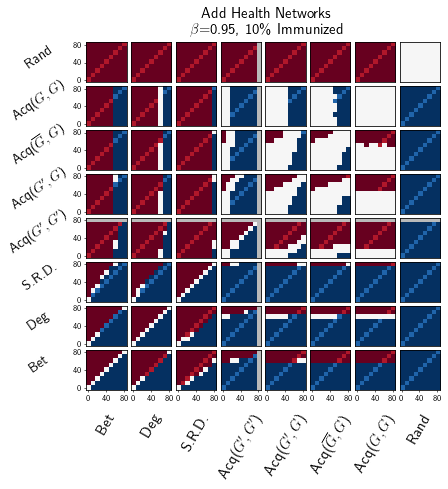

In [127]:
beta= 0.95
gamma=1.0
pctImmunized = .10
folder = 'SchoolResults10_gamma1_newCode_beta02to220'


title="Add Health Networks\n" + r'$\beta$='+str(beta)+", "+str(int(100*pctImmunized)) +"\% Immunized"


figFileName="sigs"+folder[:12]+"beta"+pointify(beta)+"gamma"+pointify(gamma)+"pctImmunized"+pointify(pctImmunized)
signifArrs=params2signifArrs[(folder,  pctImmunized, beta, gamma)]
makeSignifPlot(figFileName, signifArrs, title)


### Supp. Fig. 7.iii

In [128]:
beta= 1.7
gamma=1.0
pctImmunized = .10    #didnt i change the  name of this folder?
folder = 'SchoolResults10_gamma1_newCode_beta02to220'
params2signifArrs[(folder,  pctImmunized, beta, gamma)] = getSignifArrs(folder, pctImmunized, beta, gamma)


RandSamp Bet
RandSamp 0.8 ,  Bet 0.8 :  4.629907002181917e-285
RandSamp 0.8 ,  Bet 0.7 :  0.0
RandSamp 0.8 ,  Bet 0.6 :  0.0
RandSamp 0.8 ,  Bet 0.5 :  0.0
RandSamp 0.8 ,  Bet 0.4 :  0.0
RandSamp 0.8 ,  Bet 0.3 :  0.0
RandSamp 0.8 ,  Bet 0.2 :  0.0
RandSamp 0.8 ,  Bet 0.1 :  0.0
RandSamp 0.8 ,  Bet 0.0 :  0.0
RandSamp 0.7 ,  Bet 0.8 :  1.5247960345800802e-299
RandSamp 0.7 ,  Bet 0.7 :  0.0
RandSamp 0.7 ,  Bet 0.6 :  0.0
RandSamp 0.7 ,  Bet 0.5 :  0.0
RandSamp 0.7 ,  Bet 0.4 :  0.0
RandSamp 0.7 ,  Bet 0.3 :  0.0
RandSamp 0.7 ,  Bet 0.2 :  0.0
RandSamp 0.7 ,  Bet 0.1 :  0.0
RandSamp 0.7 ,  Bet 0.0 :  0.0
RandSamp 0.6 ,  Bet 0.8 :  2.284389777772094e-297
RandSamp 0.6 ,  Bet 0.7 :  0.0
RandSamp 0.6 ,  Bet 0.6 :  0.0
RandSamp 0.6 ,  Bet 0.5 :  0.0
RandSamp 0.6 ,  Bet 0.4 :  0.0
RandSamp 0.6 ,  Bet 0.3 :  0.0
RandSamp 0.6 ,  Bet 0.2 :  0.0
RandSamp 0.6 ,  Bet 0.1 :  0.0
RandSamp 0.6 ,  Bet 0.0 :  0.0
RandSamp 0.5 ,  Bet 0.8 :  2.2420810334974605e-300
RandSamp 0.5 ,  Bet 0.7 :  0.0
RandSamp 0

RandSamp 0.7 ,  acqKK2 0.8 :  nan
RandSamp 0.7 ,  acqKK2 0.7 :  0.0
RandSamp 0.7 ,  acqKK2 0.6 :  0.0
RandSamp 0.7 ,  acqKK2 0.5 :  0.0
RandSamp 0.7 ,  acqKK2 0.4 :  0.0
RandSamp 0.7 ,  acqKK2 0.3 :  0.0
RandSamp 0.7 ,  acqKK2 0.2 :  0.0
RandSamp 0.7 ,  acqKK2 0.1 :  0.0
RandSamp 0.7 ,  acqKK2 0.0 :  0.0
RandSamp 0.6 ,  acqKK2 0.8 :  nan
RandSamp 0.6 ,  acqKK2 0.7 :  0.0
RandSamp 0.6 ,  acqKK2 0.6 :  0.0
RandSamp 0.6 ,  acqKK2 0.5 :  0.0
RandSamp 0.6 ,  acqKK2 0.4 :  0.0
RandSamp 0.6 ,  acqKK2 0.3 :  0.0
RandSamp 0.6 ,  acqKK2 0.2 :  0.0
RandSamp 0.6 ,  acqKK2 0.1 :  0.0
RandSamp 0.6 ,  acqKK2 0.0 :  0.0
RandSamp 0.5 ,  acqKK2 0.8 :  nan
RandSamp 0.5 ,  acqKK2 0.7 :  0.0
RandSamp 0.5 ,  acqKK2 0.6 :  0.0
RandSamp 0.5 ,  acqKK2 0.5 :  0.0
RandSamp 0.5 ,  acqKK2 0.4 :  0.0
RandSamp 0.5 ,  acqKK2 0.3 :  0.0
RandSamp 0.5 ,  acqKK2 0.2 :  0.0
RandSamp 0.5 ,  acqKK2 0.1 :  0.0
RandSamp 0.5 ,  acqKK2 0.0 :  0.0
RandSamp 0.4 ,  acqKK2 0.8 :  nan
RandSamp 0.4 ,  acqKK2 0.7 :  0.0
RandSamp 0.4 ,

RandSamp 0.8 ,  acqGG2 0.8 :  0.0
RandSamp 0.8 ,  acqGG2 0.7 :  0.0
RandSamp 0.8 ,  acqGG2 0.6 :  0.0
RandSamp 0.8 ,  acqGG2 0.5 :  0.0
RandSamp 0.8 ,  acqGG2 0.4 :  0.0
RandSamp 0.8 ,  acqGG2 0.3 :  0.0
RandSamp 0.8 ,  acqGG2 0.2 :  0.0
RandSamp 0.8 ,  acqGG2 0.1 :  0.0
RandSamp 0.8 ,  acqGG2 0.0 :  0.0
RandSamp 0.7 ,  acqGG2 0.8 :  0.0
RandSamp 0.7 ,  acqGG2 0.7 :  0.0
RandSamp 0.7 ,  acqGG2 0.6 :  0.0
RandSamp 0.7 ,  acqGG2 0.5 :  0.0
RandSamp 0.7 ,  acqGG2 0.4 :  0.0
RandSamp 0.7 ,  acqGG2 0.3 :  0.0
RandSamp 0.7 ,  acqGG2 0.2 :  0.0
RandSamp 0.7 ,  acqGG2 0.1 :  0.0
RandSamp 0.7 ,  acqGG2 0.0 :  0.0
RandSamp 0.6 ,  acqGG2 0.8 :  0.0
RandSamp 0.6 ,  acqGG2 0.7 :  0.0
RandSamp 0.6 ,  acqGG2 0.6 :  0.0
RandSamp 0.6 ,  acqGG2 0.5 :  0.0
RandSamp 0.6 ,  acqGG2 0.4 :  0.0
RandSamp 0.6 ,  acqGG2 0.3 :  0.0
RandSamp 0.6 ,  acqGG2 0.2 :  0.0
RandSamp 0.6 ,  acqGG2 0.1 :  0.0
RandSamp 0.6 ,  acqGG2 0.0 :  0.0
RandSamp 0.5 ,  acqGG2 0.8 :  0.0
RandSamp 0.5 ,  acqGG2 0.7 :  0.0
RandSamp 0.5 ,

acqGG2 0.3 ,  Bet 0.8 :  0.0
acqGG2 0.3 ,  Bet 0.7 :  0.0
acqGG2 0.3 ,  Bet 0.6 :  1.8835681653815435e-207
acqGG2 0.3 ,  Bet 0.5 :  4.665760711167675e-21
acqGG2 0.3 ,  Bet 0.4 :  2.661251585617114e-23
acqGG2 0.3 ,  Bet 0.3 :  1.8783389793654697e-153
acqGG2 0.3 ,  Bet 0.2 :  0.0
acqGG2 0.3 ,  Bet 0.1 :  0.0
acqGG2 0.3 ,  Bet 0.0 :  0.0
acqGG2 0.2 ,  Bet 0.8 :  0.0
acqGG2 0.2 ,  Bet 0.7 :  0.0
acqGG2 0.2 ,  Bet 0.6 :  2.9704325332232323e-207
acqGG2 0.2 ,  Bet 0.5 :  1.93715399439414e-21
acqGG2 0.2 ,  Bet 0.4 :  1.6307584081206263e-22
acqGG2 0.2 ,  Bet 0.3 :  1.2528427087705737e-150
acqGG2 0.2 ,  Bet 0.2 :  0.0
acqGG2 0.2 ,  Bet 0.1 :  0.0
acqGG2 0.2 ,  Bet 0.0 :  0.0
acqGG2 0.1 ,  Bet 0.8 :  0.0
acqGG2 0.1 ,  Bet 0.7 :  0.0
acqGG2 0.1 ,  Bet 0.6 :  1.901175760750664e-209
acqGG2 0.1 ,  Bet 0.5 :  3.9606678685493907e-22
acqGG2 0.1 ,  Bet 0.4 :  7.263862721246034e-22
acqGG2 0.1 ,  Bet 0.3 :  4.609351167607877e-149
acqGG2 0.1 ,  Bet 0.2 :  0.0
acqGG2 0.1 ,  Bet 0.1 :  0.0
acqGG2 0.1 ,  Bet 0

acqGG2 0.6 ,  acqKK2 0.8 :  nan
acqGG2 0.6 ,  acqKK2 0.7 :  0.0
acqGG2 0.6 ,  acqKK2 0.6 :  0.0
acqGG2 0.6 ,  acqKK2 0.5 :  2.335464886516421e-260
acqGG2 0.6 ,  acqKK2 0.4 :  6.966316436758768e-145
acqGG2 0.6 ,  acqKK2 0.3 :  5.76581299968138e-77
acqGG2 0.6 ,  acqKK2 0.2 :  1.134415000378765e-25
acqGG2 0.6 ,  acqKK2 0.1 :  3.3406185908515342e-06
acqGG2 0.6 ,  acqKK2 0.0 :  0.5666329103281762
acqGG2 0.5 ,  acqKK2 0.8 :  nan
acqGG2 0.5 ,  acqKK2 0.7 :  0.0
acqGG2 0.5 ,  acqKK2 0.6 :  0.0
acqGG2 0.5 ,  acqKK2 0.5 :  3.33708825873518e-261
acqGG2 0.5 ,  acqKK2 0.4 :  3.500485380365369e-146
acqGG2 0.5 ,  acqKK2 0.3 :  2.676381959629345e-78
acqGG2 0.5 ,  acqKK2 0.2 :  1.111417739386674e-26
acqGG2 0.5 ,  acqKK2 0.1 :  9.480554936716606e-07
acqGG2 0.5 ,  acqKK2 0.0 :  0.39459354833995164
acqGG2 0.4 ,  acqKK2 0.8 :  nan
acqGG2 0.4 ,  acqKK2 0.7 :  0.0
acqGG2 0.4 ,  acqKK2 0.6 :  0.0
acqGG2 0.4 ,  acqKK2 0.5 :  6.251858394917317e-271
acqGG2 0.4 ,  acqKK2 0.4 :  1.1269389179289612e-152
acqGG2 0.4 

acqGG2 0.4 ,  acqKG2_up 0.8 :  4.361731471910536e-67
acqGG2 0.4 ,  acqKG2_up 0.7 :  1.117082336928483e-47
acqGG2 0.4 ,  acqKG2_up 0.6 :  2.6347931041639027e-33
acqGG2 0.4 ,  acqKG2_up 0.5 :  1.162179466320899e-20
acqGG2 0.4 ,  acqKG2_up 0.4 :  3.839506067290942e-15
acqGG2 0.4 ,  acqKG2_up 0.3 :  1.7071849162220166e-09
acqGG2 0.4 ,  acqKG2_up 0.2 :  0.00014576580293861277
acqGG2 0.4 ,  acqKG2_up 0.1 :  0.024816041528806516
acqGG2 0.4 ,  acqKG2_up 0.0 :  0.8043777023862044
acqGG2 0.3 ,  acqKG2_up 0.8 :  1.2957270895926157e-63
acqGG2 0.3 ,  acqKG2_up 0.7 :  1.0251922143266427e-44
acqGG2 0.3 ,  acqKG2_up 0.6 :  7.665879005347021e-31
acqGG2 0.3 ,  acqKG2_up 0.5 :  9.664057120489062e-19
acqGG2 0.3 ,  acqKG2_up 0.4 :  1.6038644177979563e-13
acqGG2 0.3 ,  acqKG2_up 0.3 :  3.0330244243953475e-08
acqGG2 0.3 ,  acqKG2_up 0.2 :  0.000920494717858013
acqGG2 0.3 ,  acqKG2_up 0.1 :  0.0781667501055948
acqGG2 0.3 ,  acqKG2_up 0.0 :  0.811723700698303
acqGG2 0.2 ,  acqKG2_up 0.8 :  5.1060127830904685e-

acqGG2 0.1 ,  RandSamp 0.8 :  0.0
acqGG2 0.1 ,  RandSamp 0.7 :  0.0
acqGG2 0.1 ,  RandSamp 0.6 :  0.0
acqGG2 0.1 ,  RandSamp 0.5 :  0.0
acqGG2 0.1 ,  RandSamp 0.4 :  0.0
acqGG2 0.1 ,  RandSamp 0.3 :  0.0
acqGG2 0.1 ,  RandSamp 0.2 :  0.0
acqGG2 0.1 ,  RandSamp 0.1 :  0.0
acqGG2 0.1 ,  RandSamp 0.0 :  0.0
acqGG2 0.0 ,  RandSamp 0.8 :  0.0
acqGG2 0.0 ,  RandSamp 0.7 :  0.0
acqGG2 0.0 ,  RandSamp 0.6 :  0.0
acqGG2 0.0 ,  RandSamp 0.5 :  0.0
acqGG2 0.0 ,  RandSamp 0.4 :  0.0
acqGG2 0.0 ,  RandSamp 0.3 :  0.0
acqGG2 0.0 ,  RandSamp 0.2 :  0.0
acqGG2 0.0 ,  RandSamp 0.1 :  0.0
acqGG2 0.0 ,  RandSamp 0.0 :  0.0
acqKG2_up Bet
acqKG2_up 0.8 ,  Bet 0.8 :  0.0
acqKG2_up 0.8 ,  Bet 0.7 :  0.0
acqKG2_up 0.8 ,  Bet 0.6 :  5.2687766369394607e-45
acqKG2_up 0.8 ,  Bet 0.5 :  8.713874096546693e-15
acqKG2_up 0.8 ,  Bet 0.4 :  1.2300200199831525e-153
acqKG2_up 0.8 ,  Bet 0.3 :  0.0
acqKG2_up 0.8 ,  Bet 0.2 :  0.0
acqKG2_up 0.8 ,  Bet 0.1 :  0.0
acqKG2_up 0.8 ,  Bet 0.0 :  0.0
acqKG2_up 0.7 ,  Bet 0.8 :  0

acqKG2_up 0.5 ,  Srd 0.8 :  2.330760981289938e-125
acqKG2_up 0.5 ,  Srd 0.7 :  0.016941900643235856
acqKG2_up 0.5 ,  Srd 0.6 :  3.093263435154786e-80
acqKG2_up 0.5 ,  Srd 0.5 :  1.795677714096105e-195
acqKG2_up 0.5 ,  Srd 0.4 :  0.0
acqKG2_up 0.5 ,  Srd 0.3 :  0.0
acqKG2_up 0.5 ,  Srd 0.2 :  0.0
acqKG2_up 0.5 ,  Srd 0.1 :  0.0
acqKG2_up 0.5 ,  Srd 0.0 :  0.0
acqKG2_up 0.4 ,  Srd 0.8 :  9.00859196507913e-140
acqKG2_up 0.4 ,  Srd 0.7 :  0.35330274185358745
acqKG2_up 0.4 ,  Srd 0.6 :  9.332358743462692e-69
acqKG2_up 0.4 ,  Srd 0.5 :  1.05226088049768e-177
acqKG2_up 0.4 ,  Srd 0.4 :  1.2512448279470976e-302
acqKG2_up 0.4 ,  Srd 0.3 :  0.0
acqKG2_up 0.4 ,  Srd 0.2 :  0.0
acqKG2_up 0.4 ,  Srd 0.1 :  0.0
acqKG2_up 0.4 ,  Srd 0.0 :  0.0
acqKG2_up 0.3 ,  Srd 0.8 :  4.0037310844840247e-160
acqKG2_up 0.3 ,  Srd 0.7 :  0.3535832970264329
acqKG2_up 0.3 ,  Srd 0.6 :  8.819800163970422e-56
acqKG2_up 0.3 ,  Srd 0.5 :  3.326853731800661e-157
acqKG2_up 0.3 ,  Srd 0.4 :  4.758899238337905e-277
acqKG2_up 

acqKG2_up 0.3 ,  acqKG2 0.7 :  0.0003140775894251154
acqKG2_up 0.3 ,  acqKG2 0.6 :  0.20438064900771324
acqKG2_up 0.3 ,  acqKG2 0.5 :  0.11734800848248968
acqKG2_up 0.3 ,  acqKG2 0.4 :  0.01492485023885319
acqKG2_up 0.3 ,  acqKG2 0.3 :  6.739654247713868e-06
acqKG2_up 0.3 ,  acqKG2 0.2 :  4.280896101661069e-06
acqKG2_up 0.3 ,  acqKG2 0.1 :  2.800104123655707e-08
acqKG2_up 0.3 ,  acqKG2 0.0 :  2.2238791996805913e-08
acqKG2_up 0.2 ,  acqKG2 0.8 :  8.840095795435342e-23
acqKG2_up 0.2 ,  acqKG2 0.7 :  6.439707386001026e-09
acqKG2_up 0.2 ,  acqKG2 0.6 :  0.0004809580910442469
acqKG2_up 0.2 ,  acqKG2 0.5 :  0.5163573968122299
acqKG2_up 0.2 ,  acqKG2 0.4 :  0.8176400551675252
acqKG2_up 0.2 ,  acqKG2 0.3 :  0.02277266599558385
acqKG2_up 0.2 ,  acqKG2 0.2 :  0.017095375768384383
acqKG2_up 0.2 ,  acqKG2 0.1 :  0.0008576549319461208
acqKG2_up 0.2 ,  acqKG2 0.0 :  0.0007240955002925703
acqKG2_up 0.1 ,  acqKG2 0.8 :  1.3497725704900934e-29
acqKG2_up 0.1 ,  acqKG2 0.7 :  2.7795065831948464e-13
acqKG

acqKG2_up 0.3 ,  acqGG2 0.8 :  4.377452356115208e-09
acqKG2_up 0.3 ,  acqGG2 0.7 :  5.402837340041231e-09
acqKG2_up 0.3 ,  acqGG2 0.6 :  7.177990493425546e-08
acqKG2_up 0.3 ,  acqGG2 0.5 :  1.7352595792085354e-08
acqKG2_up 0.3 ,  acqGG2 0.4 :  1.7071849162220166e-09
acqKG2_up 0.3 ,  acqGG2 0.3 :  3.0330244243953475e-08
acqKG2_up 0.3 ,  acqGG2 0.2 :  1.606508216976811e-08
acqKG2_up 0.3 ,  acqGG2 0.1 :  6.224940057936521e-09
acqKG2_up 0.3 ,  acqGG2 0.0 :  7.361749961943043e-08
acqKG2_up 0.2 ,  acqGG2 0.8 :  0.0002600276286292865
acqKG2_up 0.2 ,  acqGG2 0.7 :  0.0003005429805411378
acqKG2_up 0.2 ,  acqGG2 0.6 :  0.001520742851643806
acqKG2_up 0.2 ,  acqGG2 0.5 :  0.0005950438394479322
acqKG2_up 0.2 ,  acqGG2 0.4 :  0.00014576580293861277
acqKG2_up 0.2 ,  acqGG2 0.3 :  0.000920494717858013
acqKG2_up 0.2 ,  acqGG2 0.2 :  0.0005937098680562101
acqKG2_up 0.2 ,  acqGG2 0.1 :  0.0003255921763081221
acqKG2_up 0.2 ,  acqGG2 0.0 :  0.0015287388726503487
acqKG2_up 0.1 ,  acqGG2 0.8 :  0.03533387611

acqKG2 0.7 ,  DegKK 0.5 :  3.8890703299497095e-30
acqKG2 0.7 ,  DegKK 0.4 :  6.0332659518341e-147
acqKG2 0.7 ,  DegKK 0.3 :  0.0
acqKG2 0.7 ,  DegKK 0.2 :  0.0
acqKG2 0.7 ,  DegKK 0.1 :  0.0
acqKG2 0.7 ,  DegKK 0.0 :  0.0
acqKG2 0.6 ,  DegKK 0.8 :  0.0
acqKG2 0.6 ,  DegKK 0.7 :  0.0
acqKG2 0.6 ,  DegKK 0.6 :  9.41058198673822e-32
acqKG2 0.6 ,  DegKK 0.5 :  6.524098562592073e-20
acqKG2 0.6 ,  DegKK 0.4 :  2.058045009881515e-124
acqKG2 0.6 ,  DegKK 0.3 :  3.2591932523713214e-295
acqKG2 0.6 ,  DegKK 0.2 :  0.0
acqKG2 0.6 ,  DegKK 0.1 :  0.0
acqKG2 0.6 ,  DegKK 0.0 :  0.0
acqKG2 0.5 ,  DegKK 0.8 :  0.0
acqKG2 0.5 ,  DegKK 0.7 :  0.0
acqKG2 0.5 ,  DegKK 0.6 :  2.2384939602060966e-47
acqKG2 0.5 ,  DegKK 0.5 :  3.734612198429281e-10
acqKG2 0.5 ,  DegKK 0.4 :  8.043237282465853e-97
acqKG2 0.5 ,  DegKK 0.3 :  1.6741904033120748e-252
acqKG2 0.5 ,  DegKK 0.2 :  0.0
acqKG2 0.5 ,  DegKK 0.1 :  0.0
acqKG2 0.5 ,  DegKK 0.0 :  0.0
acqKG2 0.4 ,  DegKK 0.8 :  0.0
acqKG2 0.4 ,  DegKK 0.7 :  0.0
acqKG2 0.

acqKG2 0.2 ,  acqKK2 0.8 :  nan
acqKG2 0.2 ,  acqKK2 0.7 :  0.0
acqKG2 0.2 ,  acqKK2 0.6 :  0.0
acqKG2 0.2 ,  acqKK2 0.5 :  4.3708449674687833e-249
acqKG2 0.2 ,  acqKK2 0.4 :  2.5692170237149766e-136
acqKG2 0.2 ,  acqKK2 0.3 :  1.0540995882384878e-70
acqKG2 0.2 ,  acqKK2 0.2 :  3.6022077055737074e-22
acqKG2 0.2 ,  acqKK2 0.1 :  0.00011178311150124866
acqKG2 0.2 ,  acqKK2 0.0 :  0.8349839665264882
acqKG2 0.1 ,  acqKK2 0.8 :  nan
acqKG2 0.1 ,  acqKK2 0.7 :  0.0
acqKG2 0.1 ,  acqKK2 0.6 :  0.0
acqKG2 0.1 ,  acqKK2 0.5 :  2.0299959373627222e-263
acqKG2 0.1 ,  acqKK2 0.4 :  4.541991294915965e-147
acqKG2 0.1 ,  acqKK2 0.3 :  1.733625671963241e-78
acqKG2 0.1 ,  acqKK2 0.2 :  1.7541293228205253e-26
acqKG2 0.1 ,  acqKK2 0.1 :  1.4831636423467366e-06
acqKG2 0.1 ,  acqKK2 0.0 :  0.4648127186316172
acqKG2 0.0 ,  acqKK2 0.8 :  nan
acqKG2 0.0 ,  acqKK2 0.7 :  0.0
acqKG2 0.0 ,  acqKK2 0.6 :  0.0
acqKG2 0.0 ,  acqKK2 0.5 :  1.1236923753810676e-262
acqKG2 0.0 ,  acqKK2 0.4 :  8.173273469448703e-147
acq

acqKG2 0.1 ,  acqKG2_up 0.8 :  1.668754681586655e-63
acqKG2 0.1 ,  acqKG2_up 0.7 :  1.1516697753453143e-44
acqKG2 0.1 ,  acqKG2_up 0.6 :  7.816677571191582e-31
acqKG2 0.1 ,  acqKG2_up 0.5 :  9.209518979147314e-19
acqKG2 0.1 ,  acqKG2_up 0.4 :  1.496660919782575e-13
acqKG2 0.1 ,  acqKG2_up 0.3 :  2.800104123655707e-08
acqKG2 0.1 ,  acqKG2_up 0.2 :  0.0008576549319461208
acqKG2 0.1 ,  acqKG2_up 0.1 :  0.07425536785576826
acqKG2 0.1 ,  acqKG2_up 0.0 :  0.8341391840288681
acqKG2 0.0 ,  acqKG2_up 0.8 :  1.5158484488264365e-63
acqKG2 0.0 ,  acqKG2_up 0.7 :  9.461864208074955e-45
acqKG2 0.0 ,  acqKG2_up 0.6 :  6.073699256126455e-31
acqKG2 0.0 ,  acqKG2_up 0.5 :  7.035905705240669e-19
acqKG2 0.0 ,  acqKG2_up 0.4 :  1.1542008540936535e-13
acqKG2 0.0 ,  acqKG2_up 0.3 :  2.2238791996805913e-08
acqKG2 0.0 ,  acqKG2_up 0.2 :  0.0007240955002925703
acqKG2 0.0 ,  acqKG2_up 0.1 :  0.0663161862792502
acqKG2 0.0 ,  acqKG2_up 0.0 :  0.8792039014733461
acqKG2 acqGG2
acqKG2 0.8 ,  acqGG2 0.8 :  3.666018757

acqKK2 0.7 ,  Bet 0.1 :  0.0
acqKK2 0.7 ,  Bet 0.0 :  0.0
acqKK2 0.6 ,  Bet 0.8 :  0.0
acqKK2 0.6 ,  Bet 0.7 :  3.3810183202550433e-31
acqKK2 0.6 ,  Bet 0.6 :  2.613875791752521e-60
acqKK2 0.6 ,  Bet 0.5 :  1.2018140177606256e-307
acqKK2 0.6 ,  Bet 0.4 :  0.0
acqKK2 0.6 ,  Bet 0.3 :  0.0
acqKK2 0.6 ,  Bet 0.2 :  0.0
acqKK2 0.6 ,  Bet 0.1 :  0.0
acqKK2 0.6 ,  Bet 0.0 :  0.0
acqKK2 0.5 ,  Bet 0.8 :  0.0
acqKK2 0.5 ,  Bet 0.7 :  1.0276531883678061e-121
acqKK2 0.5 ,  Bet 0.6 :  8.675534307375376e-06
acqKK2 0.5 ,  Bet 0.5 :  7.142860715568214e-152
acqKK2 0.5 ,  Bet 0.4 :  0.0
acqKK2 0.5 ,  Bet 0.3 :  0.0
acqKK2 0.5 ,  Bet 0.2 :  0.0
acqKK2 0.5 ,  Bet 0.1 :  0.0
acqKK2 0.5 ,  Bet 0.0 :  0.0
acqKK2 0.4 ,  Bet 0.8 :  0.0
acqKK2 0.4 ,  Bet 0.7 :  4.216170055724381e-233
acqKK2 0.4 ,  Bet 0.6 :  3.089352814123692e-07
acqKK2 0.4 ,  Bet 0.5 :  1.1714615614630402e-64
acqKK2 0.4 ,  Bet 0.4 :  7.742237570834964e-272
acqKK2 0.4 ,  Bet 0.3 :  0.0
acqKK2 0.4 ,  Bet 0.2 :  0.0
acqKK2 0.4 ,  Bet 0.1 :  0.0

acqKK2 0.8 ,  acqKK2 0.3 :  nan
acqKK2 0.8 ,  acqKK2 0.2 :  nan
acqKK2 0.8 ,  acqKK2 0.1 :  nan
acqKK2 0.8 ,  acqKK2 0.0 :  nan
acqKK2 0.7 ,  acqKK2 0.8 :  nan
acqKK2 0.7 ,  acqKK2 0.7 :  1.0
acqKK2 0.7 ,  acqKK2 0.6 :  2.9181334385849233e-61
acqKK2 0.7 ,  acqKK2 0.5 :  4.3966096631062764e-173
acqKK2 0.7 ,  acqKK2 0.4 :  4.076861910443496e-298
acqKK2 0.7 ,  acqKK2 0.3 :  0.0
acqKK2 0.7 ,  acqKK2 0.2 :  0.0
acqKK2 0.7 ,  acqKK2 0.1 :  0.0
acqKK2 0.7 ,  acqKK2 0.0 :  0.0
acqKK2 0.6 ,  acqKK2 0.8 :  nan
acqKK2 0.6 ,  acqKK2 0.7 :  2.9181334385849233e-61
acqKK2 0.6 ,  acqKK2 0.6 :  1.0
acqKK2 0.6 ,  acqKK2 0.5 :  6.298981553899429e-33
acqKK2 0.6 ,  acqKK2 0.4 :  7.7153510253067e-101
acqKK2 0.6 ,  acqKK2 0.3 :  4.3283410415565633e-178
acqKK2 0.6 ,  acqKK2 0.2 :  1.1973474001145053e-283
acqKK2 0.6 ,  acqKK2 0.1 :  0.0
acqKK2 0.6 ,  acqKK2 0.0 :  0.0
acqKK2 0.5 ,  acqKK2 0.8 :  nan
acqKK2 0.5 ,  acqKK2 0.7 :  4.3966096631062764e-173
acqKK2 0.5 ,  acqKK2 0.6 :  6.298981553899429e-33
acqKK2 0.5

acqKK2 0.4 ,  acqKG2_up 0.8 :  1.4795110619584562e-19
acqKK2 0.4 ,  acqKG2_up 0.7 :  4.642477180320787e-34
acqKK2 0.4 ,  acqKG2_up 0.6 :  3.07380770611499e-48
acqKK2 0.4 ,  acqKG2_up 0.5 :  5.525454722274618e-67
acqKK2 0.4 ,  acqKG2_up 0.4 :  6.591492059671428e-78
acqKK2 0.4 ,  acqKG2_up 0.3 :  1.6166266367301009e-93
acqKK2 0.4 ,  acqKG2_up 0.2 :  3.158909185713608e-113
acqKK2 0.4 ,  acqKG2_up 0.1 :  4.652487299257676e-127
acqKK2 0.4 ,  acqKG2_up 0.0 :  3.880146586670858e-149
acqKK2 0.3 ,  acqKG2_up 0.8 :  0.08153965365842147
acqKK2 0.3 ,  acqKG2_up 0.7 :  1.4964932556880993e-06
acqKK2 0.3 ,  acqKG2_up 0.6 :  3.190635226764255e-13
acqKK2 0.3 ,  acqKG2_up 0.5 :  1.2356216761682113e-23
acqKK2 0.3 ,  acqKG2_up 0.4 :  2.3112083355594056e-30
acqKK2 0.3 ,  acqKG2_up 0.3 :  2.1215241996145113e-40
acqKK2 0.3 ,  acqKG2_up 0.2 :  5.690244493037579e-54
acqKK2 0.3 ,  acqKG2_up 0.1 :  4.345737436695311e-64
acqKK2 0.3 ,  acqKG2_up 0.0 :  4.508181531206608e-80
acqKK2 0.2 ,  acqKG2_up 0.8 :  1.6579357

acqKK2 0.0 ,  RandSamp 0.8 :  0.0
acqKK2 0.0 ,  RandSamp 0.7 :  0.0
acqKK2 0.0 ,  RandSamp 0.6 :  0.0
acqKK2 0.0 ,  RandSamp 0.5 :  0.0
acqKK2 0.0 ,  RandSamp 0.4 :  0.0
acqKK2 0.0 ,  RandSamp 0.3 :  0.0
acqKK2 0.0 ,  RandSamp 0.2 :  0.0
acqKK2 0.0 ,  RandSamp 0.1 :  0.0
acqKK2 0.0 ,  RandSamp 0.0 :  0.0
Srd Bet
Srd 0.8 ,  Bet 0.8 :  0.0
Srd 0.8 ,  Bet 0.7 :  2.7409317830703365e-150
Srd 0.8 ,  Bet 0.6 :  0.09264113056028742
Srd 0.8 ,  Bet 0.5 :  6.68848256525558e-123
Srd 0.8 ,  Bet 0.4 :  0.0
Srd 0.8 ,  Bet 0.3 :  0.0
Srd 0.8 ,  Bet 0.2 :  0.0
Srd 0.8 ,  Bet 0.1 :  0.0
Srd 0.8 ,  Bet 0.0 :  0.0
Srd 0.7 ,  Bet 0.8 :  0.0
Srd 0.7 ,  Bet 0.7 :  0.0
Srd 0.7 ,  Bet 0.6 :  4.877919948935289e-134
Srd 0.7 ,  Bet 0.5 :  0.003658015268842735
Srd 0.7 ,  Bet 0.4 :  2.954230673217093e-60
Srd 0.7 ,  Bet 0.3 :  6.3105202039503114e-232
Srd 0.7 ,  Bet 0.2 :  0.0
Srd 0.7 ,  Bet 0.1 :  0.0
Srd 0.7 ,  Bet 0.0 :  0.0
Srd 0.6 ,  Bet 0.8 :  0.0
Srd 0.6 ,  Bet 0.7 :  0.0
Srd 0.6 ,  Bet 0.6 :  0.0
Srd 0.6 ,  B

Srd 0.2 ,  Srd 0.5 :  5.106137398921755e-132
Srd 0.2 ,  Srd 0.4 :  4.845310259578089e-51
Srd 0.2 ,  Srd 0.3 :  1.846748195991878e-11
Srd 0.2 ,  Srd 0.2 :  1.0
Srd 0.2 ,  Srd 0.1 :  1.2256137564436644e-11
Srd 0.2 ,  Srd 0.0 :  8.174987870163668e-27
Srd 0.1 ,  Srd 0.8 :  0.0
Srd 0.1 ,  Srd 0.7 :  0.0
Srd 0.1 ,  Srd 0.6 :  0.0
Srd 0.1 ,  Srd 0.5 :  7.528919782825956e-212
Srd 0.1 ,  Srd 0.4 :  5.098684064279435e-105
Srd 0.1 ,  Srd 0.3 :  1.6917204338631934e-41
Srd 0.1 ,  Srd 0.2 :  1.2256137564436644e-11
Srd 0.1 ,  Srd 0.1 :  1.0
Srd 0.1 ,  Srd 0.0 :  5.5914730871737914e-05
Srd 0.0 ,  Srd 0.8 :  0.0
Srd 0.0 ,  Srd 0.7 :  0.0
Srd 0.0 ,  Srd 0.6 :  0.0
Srd 0.0 ,  Srd 0.5 :  1.8362016762170482e-262
Srd 0.0 ,  Srd 0.4 :  2.3143736677147754e-143
Srd 0.0 ,  Srd 0.3 :  1.9157201964627808e-67
Srd 0.0 ,  Srd 0.2 :  8.174987870163668e-27
Srd 0.0 ,  Srd 0.1 :  5.5914730871737914e-05
Srd 0.0 ,  Srd 0.0 :  1.0
Srd acqKK2
Srd 0.8 ,  acqKK2 0.8 :  nan
Srd 0.8 ,  acqKK2 0.7 :  7.780828342422666e-206
Srd 0

Srd 0.5 ,  acqKG2_up 0.5 :  1.795677714096105e-195
Srd 0.5 ,  acqKG2_up 0.4 :  1.05226088049768e-177
Srd 0.5 ,  acqKG2_up 0.3 :  3.326853731800661e-157
Srd 0.5 ,  acqKG2_up 0.2 :  3.7435687272379265e-133
Srd 0.5 ,  acqKG2_up 0.1 :  8.835340421871636e-117
Srd 0.5 ,  acqKG2_up 0.0 :  3.0362816394236795e-99
Srd 0.4 ,  acqKG2_up 0.8 :  0.0
Srd 0.4 ,  acqKG2_up 0.7 :  0.0
Srd 0.4 ,  acqKG2_up 0.6 :  0.0
Srd 0.4 ,  acqKG2_up 0.5 :  0.0
Srd 0.4 ,  acqKG2_up 0.4 :  1.2512448279470976e-302
Srd 0.4 ,  acqKG2_up 0.3 :  4.758899238337905e-277
Srd 0.4 ,  acqKG2_up 0.2 :  6.715290421494957e-246
Srd 0.4 ,  acqKG2_up 0.1 :  8.638072968710464e-224
Srd 0.4 ,  acqKG2_up 0.0 :  1.1932927487184318e-200
Srd 0.3 ,  acqKG2_up 0.8 :  0.0
Srd 0.3 ,  acqKG2_up 0.7 :  0.0
Srd 0.3 ,  acqKG2_up 0.6 :  0.0
Srd 0.3 ,  acqKG2_up 0.5 :  0.0
Srd 0.3 ,  acqKG2_up 0.4 :  0.0
Srd 0.3 ,  acqKG2_up 0.3 :  0.0
Srd 0.3 ,  acqKG2_up 0.2 :  0.0
Srd 0.3 ,  acqKG2_up 0.1 :  0.0
Srd 0.3 ,  acqKG2_up 0.0 :  0.0
Srd 0.2 ,  acqKG2_up 

DegKK 0.6 ,  Bet 0.8 :  0.0
DegKK 0.6 ,  Bet 0.7 :  0.0
DegKK 0.6 ,  Bet 0.6 :  2.2086963588926942e-38
DegKK 0.6 ,  Bet 0.5 :  2.5347820949411013e-20
DegKK 0.6 ,  Bet 0.4 :  2.2406349319551024e-173
DegKK 0.6 ,  Bet 0.3 :  0.0
DegKK 0.6 ,  Bet 0.2 :  0.0
DegKK 0.6 ,  Bet 0.1 :  0.0
DegKK 0.6 ,  Bet 0.0 :  0.0
DegKK 0.5 ,  Bet 0.8 :  0.0
DegKK 0.5 ,  Bet 0.7 :  0.0
DegKK 0.5 ,  Bet 0.6 :  1.0847531624566758e-236
DegKK 0.5 ,  Bet 0.5 :  9.99103980501741e-32
DegKK 0.5 ,  Bet 0.4 :  2.4252212694073853e-14
DegKK 0.5 ,  Bet 0.3 :  8.536916536454226e-129
DegKK 0.5 ,  Bet 0.2 :  0.0
DegKK 0.5 ,  Bet 0.1 :  0.0
DegKK 0.5 ,  Bet 0.0 :  0.0
DegKK 0.4 ,  Bet 0.8 :  0.0
DegKK 0.4 ,  Bet 0.7 :  0.0
DegKK 0.4 ,  Bet 0.6 :  0.0
DegKK 0.4 ,  Bet 0.5 :  4.9157133725396526e-152
DegKK 0.4 ,  Bet 0.4 :  1.738501976908253e-13
DegKK 0.4 ,  Bet 0.3 :  9.961210455577571e-21
DegKK 0.4 ,  Bet 0.2 :  3.248111303966083e-132
DegKK 0.4 ,  Bet 0.1 :  0.0
DegKK 0.4 ,  Bet 0.0 :  0.0
DegKK 0.3 ,  Bet 0.8 :  0.0
DegKK 0.

DegKK 0.8 ,  acqKK2 0.8 :  nan
DegKK 0.8 ,  acqKK2 0.7 :  8.80564354515026e-112
DegKK 0.8 ,  acqKK2 0.6 :  0.0
DegKK 0.8 ,  acqKK2 0.5 :  0.0
DegKK 0.8 ,  acqKK2 0.4 :  0.0
DegKK 0.8 ,  acqKK2 0.3 :  0.0
DegKK 0.8 ,  acqKK2 0.2 :  0.0
DegKK 0.8 ,  acqKK2 0.1 :  0.0
DegKK 0.8 ,  acqKK2 0.0 :  0.0
DegKK 0.7 ,  acqKK2 0.8 :  nan
DegKK 0.7 ,  acqKK2 0.7 :  1.7695435831308927e-79
DegKK 0.7 ,  acqKK2 0.6 :  0.025537924602853392
DegKK 0.7 ,  acqKK2 0.5 :  5.658260629685961e-23
DegKK 0.7 ,  acqKK2 0.4 :  1.236081444376253e-83
DegKK 0.7 ,  acqKK2 0.3 :  3.0094514704829295e-156
DegKK 0.7 ,  acqKK2 0.2 :  5.6026946557984765e-258
DegKK 0.7 ,  acqKK2 0.1 :  0.0
DegKK 0.7 ,  acqKK2 0.0 :  0.0
DegKK 0.6 ,  acqKK2 0.8 :  nan
DegKK 0.6 ,  acqKK2 0.7 :  0.0
DegKK 0.6 ,  acqKK2 0.6 :  1.6843717898831817e-183
DegKK 0.6 ,  acqKK2 0.5 :  5.245197779183669e-67
DegKK 0.6 ,  acqKK2 0.4 :  4.611074362803069e-15
DegKK 0.6 ,  acqKK2 0.3 :  0.6822356293365615
DegKK 0.6 ,  acqKK2 0.2 :  4.569553150961654e-15
DegKK 

DegKK 0.3 ,  acqKG2_up 0.8 :  0.0
DegKK 0.3 ,  acqKG2_up 0.7 :  0.0
DegKK 0.3 ,  acqKG2_up 0.6 :  0.0
DegKK 0.3 ,  acqKG2_up 0.5 :  0.0
DegKK 0.3 ,  acqKG2_up 0.4 :  1.43301406359879e-300
DegKK 0.3 ,  acqKG2_up 0.3 :  7.135092076644751e-275
DegKK 0.3 ,  acqKG2_up 0.2 :  1.3528505522350377e-243
DegKK 0.3 ,  acqKG2_up 0.1 :  2.0759199752359307e-221
DegKK 0.3 ,  acqKG2_up 0.0 :  3.2665809792741044e-198
DegKK 0.2 ,  acqKG2_up 0.8 :  0.0
DegKK 0.2 ,  acqKG2_up 0.7 :  0.0
DegKK 0.2 ,  acqKG2_up 0.6 :  0.0
DegKK 0.2 ,  acqKG2_up 0.5 :  0.0
DegKK 0.2 ,  acqKG2_up 0.4 :  0.0
DegKK 0.2 ,  acqKG2_up 0.3 :  0.0
DegKK 0.2 ,  acqKG2_up 0.2 :  0.0
DegKK 0.2 ,  acqKG2_up 0.1 :  0.0
DegKK 0.2 ,  acqKG2_up 0.0 :  0.0
DegKK 0.1 ,  acqKG2_up 0.8 :  0.0
DegKK 0.1 ,  acqKG2_up 0.7 :  0.0
DegKK 0.1 ,  acqKG2_up 0.6 :  0.0
DegKK 0.1 ,  acqKG2_up 0.5 :  0.0
DegKK 0.1 ,  acqKG2_up 0.4 :  0.0
DegKK 0.1 ,  acqKG2_up 0.3 :  0.0
DegKK 0.1 ,  acqKG2_up 0.2 :  0.0
DegKK 0.1 ,  acqKG2_up 0.1 :  0.0
DegKK 0.1 ,  acqKG2

Bet 0.5 ,  Bet 0.1 :  0.0
Bet 0.5 ,  Bet 0.0 :  0.0
Bet 0.4 ,  Bet 0.8 :  0.0
Bet 0.4 ,  Bet 0.7 :  0.0
Bet 0.4 ,  Bet 0.6 :  0.0
Bet 0.4 ,  Bet 0.5 :  2.5675361479407866e-83
Bet 0.4 ,  Bet 0.4 :  1.0
Bet 0.4 ,  Bet 0.3 :  2.3970977152658793e-63
Bet 0.4 ,  Bet 0.2 :  1.044312701055052e-219
Bet 0.4 ,  Bet 0.1 :  0.0
Bet 0.4 ,  Bet 0.0 :  0.0
Bet 0.3 ,  Bet 0.8 :  0.0
Bet 0.3 ,  Bet 0.7 :  0.0
Bet 0.3 ,  Bet 0.6 :  0.0
Bet 0.3 ,  Bet 0.5 :  9.006287979933994e-275
Bet 0.3 ,  Bet 0.4 :  2.3970977152658793e-63
Bet 0.3 ,  Bet 0.3 :  1.0
Bet 0.3 ,  Bet 0.2 :  1.9051141855819937e-55
Bet 0.3 ,  Bet 0.1 :  2.584873900976893e-192
Bet 0.3 ,  Bet 0.0 :  0.0
Bet 0.2 ,  Bet 0.8 :  0.0
Bet 0.2 ,  Bet 0.7 :  0.0
Bet 0.2 ,  Bet 0.6 :  0.0
Bet 0.2 ,  Bet 0.5 :  0.0
Bet 0.2 ,  Bet 0.4 :  1.044312701055052e-219
Bet 0.2 ,  Bet 0.3 :  1.9051141855819937e-55
Bet 0.2 ,  Bet 0.2 :  1.0
Bet 0.2 ,  Bet 0.1 :  6.319228334224269e-45
Bet 0.2 ,  Bet 0.0 :  9.72634176183795e-171
Bet 0.1 ,  Bet 0.8 :  0.0
Bet 0.1 ,  Be

Bet 0.5 ,  acqKK2 0.8 :  nan
Bet 0.5 ,  acqKK2 0.7 :  0.0
Bet 0.5 ,  acqKK2 0.6 :  1.2018140177606256e-307
Bet 0.5 ,  acqKK2 0.5 :  7.142860715568214e-152
Bet 0.5 ,  acqKK2 0.4 :  1.1714615614630402e-64
Bet 0.5 ,  acqKK2 0.3 :  6.026286137368594e-22
Bet 0.5 ,  acqKK2 0.2 :  0.18266244589970546
Bet 0.5 ,  acqKK2 0.1 :  5.684447828471126e-06
Bet 0.5 ,  acqKK2 0.0 :  4.852101498846772e-18
Bet 0.4 ,  acqKK2 0.8 :  nan
Bet 0.4 ,  acqKK2 0.7 :  0.0
Bet 0.4 ,  acqKK2 0.6 :  0.0
Bet 0.4 ,  acqKK2 0.5 :  0.0
Bet 0.4 ,  acqKK2 0.4 :  7.742237570834964e-272
Bet 0.4 ,  acqKK2 0.3 :  1.574838429905418e-177
Bet 0.4 ,  acqKK2 0.2 :  4.340669369376565e-93
Bet 0.4 ,  acqKK2 0.1 :  1.3969069054080657e-48
Bet 0.4 ,  acqKK2 0.0 :  3.274085247532727e-26
Bet 0.3 ,  acqKK2 0.8 :  nan
Bet 0.3 ,  acqKK2 0.7 :  0.0
Bet 0.3 ,  acqKK2 0.6 :  0.0
Bet 0.3 ,  acqKK2 0.5 :  0.0
Bet 0.3 ,  acqKK2 0.4 :  0.0
Bet 0.3 ,  acqKK2 0.3 :  0.0
Bet 0.3 ,  acqKK2 0.2 :  2.671199953885773e-289
Bet 0.3 ,  acqKK2 0.1 :  4.95703934

Bet 0.7 ,  acqGG2 0.8 :  0.0
Bet 0.7 ,  acqGG2 0.7 :  0.0
Bet 0.7 ,  acqGG2 0.6 :  0.0
Bet 0.7 ,  acqGG2 0.5 :  0.0
Bet 0.7 ,  acqGG2 0.4 :  0.0
Bet 0.7 ,  acqGG2 0.3 :  0.0
Bet 0.7 ,  acqGG2 0.2 :  0.0
Bet 0.7 ,  acqGG2 0.1 :  0.0
Bet 0.7 ,  acqGG2 0.0 :  0.0
Bet 0.6 ,  acqGG2 0.8 :  2.924145195064876e-210
Bet 0.6 ,  acqGG2 0.7 :  3.544359608439728e-210
Bet 0.6 ,  acqGG2 0.6 :  4.316485649993531e-204
Bet 0.6 ,  acqGG2 0.5 :  3.415209886422617e-205
Bet 0.6 ,  acqGG2 0.4 :  1.9171247009421434e-213
Bet 0.6 ,  acqGG2 0.3 :  1.8835681653815435e-207
Bet 0.6 ,  acqGG2 0.2 :  2.9704325332232323e-207
Bet 0.6 ,  acqGG2 0.1 :  1.901175760750664e-209
Bet 0.6 ,  acqGG2 0.0 :  1.3866986535958247e-203
Bet 0.5 ,  acqGG2 0.8 :  2.2025416803802967e-22
Bet 0.5 ,  acqGG2 0.7 :  2.9833078703521423e-22
Bet 0.5 ,  acqGG2 0.6 :  2.3469663903603854e-20
Bet 0.5 ,  acqGG2 0.5 :  2.7405814957898235e-21
Bet 0.5 ,  acqGG2 0.4 :  4.0925705189324556e-23
Bet 0.5 ,  acqGG2 0.3 :  4.665760711167675e-21
Bet 0.5 ,  acqGG

1
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.1 0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.1 0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.1 0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.1 0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.1 0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.  0.1 0. ]
 [0.  0.  0.  0.  0.  0.  0.  0.  0.1]]
2
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.1 0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.1 0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.1 0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.1 0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.1 0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.  0.1 0. ]
 [0.  0.  0.  0.  0.  0.  0.  0.  0.1]]
3
[[0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.1 0.  0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.1 0.  0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.1 0.  0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.1 0.  0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.1 0.  0.  0. ]
 [0.  0.  0.  0.  0.  0.  0.1 0.  0. ]
 [0.  0.  0.  0. 

26
[[0.9 1.  1.  0.  0.  0.  0.  0.  0. ]
 [1.  0.9 1.  0.  0.  0.  0.  0.  0. ]
 [1.  1.  0.9 0.  0.  0.  0.  0.  0. ]
 [1.  1.  1.  0.1 0.  0.  0.  0.  0. ]
 [1.  1.  1.  0.  0.1 0.  0.  0.  0. ]
 [1.  1.  1.  0.5 0.  0.1 0.  0.  0. ]
 [1.  1.  1.  0.5 0.  0.  0.1 0.  0. ]
 [1.  1.  1.  0.5 0.  0.  0.  0.1 0. ]
 [1.  1.  1.  0.5 0.  0.  0.  0.  0.1]]
27
[[0.9 0.  0.  0.  0.  0.  0.  0.  0. ]
 [1.  0.5 0.  0.  0.  0.  0.  0.  0. ]
 [1.  0.5 0.1 0.  0.  0.  0.  0.  0. ]
 [1.  0.5 0.  0.1 0.  0.  0.  0.  0. ]
 [1.  0.5 0.  0.  0.1 0.  0.  0.  0. ]
 [1.  1.  0.  0.  0.  0.1 0.  0.  0. ]
 [1.  1.  0.  0.  0.  0.  0.1 0.  0. ]
 [1.  1.  0.  0.  0.  0.  0.  0.1 0. ]
 [1.  1.  0.  0.  0.  0.  0.  0.  0.1]]
28
[[0.43359375 1.         1.         1.         1.         1.
  0.5        0.         0.        ]
 [0.43359375 0.9        1.         1.         1.         1.
  0.5        0.5        0.        ]
 [0.43359375 1.         0.9        1.         1.         1.
  0.5        0.5        0.        ]

41
[[0.9 1.  0.5 0.  0.  0.  0.  0.  0. ]
 [1.  0.9 1.  0.5 0.  0.  0.  0.  0. ]
 [1.  1.  0.9 1.  0.5 0.  0.  0.  0. ]
 [1.  1.  1.  0.9 1.  0.5 0.  0.  0. ]
 [1.  1.  1.  1.  0.9 0.5 0.  0.  0. ]
 [1.  1.  1.  1.  1.  0.9 0.5 0.  0. ]
 [1.  1.  1.  1.  1.  1.  0.5 0.  0. ]
 [1.  1.  1.  1.  1.  1.  1.  0.5 0. ]
 [1.  1.  1.  1.  1.  1.  1.  0.5 0.1]]
42
[[0.9 1.  0.  0.  0.  0.  0.  0.  0. ]
 [1.  0.9 1.  0.  0.  0.  0.  0.  0. ]
 [1.  1.  0.9 1.  0.  0.  0.  0.  0. ]
 [1.  1.  1.  0.9 0.5 0.  0.  0.  0. ]
 [1.  1.  1.  1.  0.9 0.5 0.  0.  0. ]
 [1.  1.  1.  1.  1.  0.9 0.5 0.  0. ]
 [1.  1.  1.  1.  1.  1.  0.9 0.5 0. ]
 [1.  1.  1.  1.  1.  1.  1.  0.5 0.5]
 [1.  1.  1.  1.  1.  1.  1.  1.  0.5]]
43
[[0.5 0.  0.  0.  0.  0.  0.  0.  0. ]
 [1.  0.5 0.  0.  0.  0.  0.  0.  0. ]
 [1.  1.  0.5 0.  0.  0.  0.  0.  0. ]
 [1.  1.  1.  0.5 0.  0.  0.  0.  0. ]
 [1.  1.  1.  1.  0.5 0.  0.  0.  0. ]
 [1.  1.  1.  1.  1.  0.5 0.  0.  0. ]
 [1.  1.  1.  1.  1.  1.  0.5 0.  0. ]
 [1.  1.  1.  

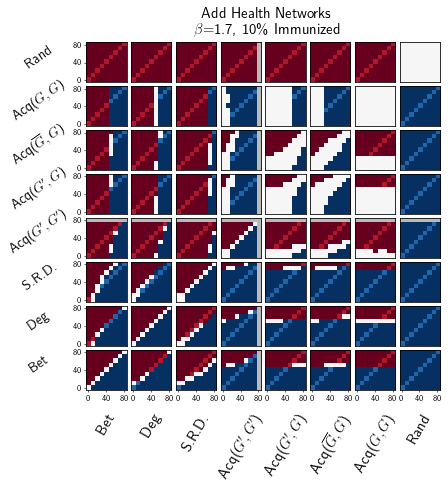

In [130]:
beta= 1.7
gamma=1.0
pctImmunized = .10
folder = 'SchoolResults10_gamma1_newCode_beta02to220'


title="Add Health Networks\n" + r'$\beta$='+str(beta)+", "+str(int(100*pctImmunized)) +"\% Immunized"


figFileName="sigs"+folder[:12]+"beta"+pointify(beta)+"gamma"+pointify(gamma)+"pctImmunized"+pointify(pctImmunized)
signifArrs=params2signifArrs[(folder,  pctImmunized, beta, gamma)]
makeSignifPlot(figFileName, signifArrs, title)


# Section 2.2 Analysis of variability of outbreak sizes

- This is where we look at the pooled distributions of the indiividual simulations carried  out over all 5000 networks.

- 5000 network versions multiplied by 2000 SIR simultions per trial is 10,000,000 total obseervations making up the histograms in each of the folloing subplots

In [145]:
import matplotlib.ticker as ticker

# We got a little crazy back there so lets set everything to defaults
import matplotlib as mpl
mpl.rcParams.update(mpl.rcParamsDefault)

In [141]:
# Takes a dictionary created from a collections.Counter object and converts it into the sequence that was originally counted
def convertCounterToSequence(countDict):
    sequence = []
    for val in countDict:
        for i in range(countDict[val]):
            sequence.append(val)
            
    return(sequence)



I tried making this into a function but the tweaking required led to a function with so many arguments that there-wasnt really much point in it being a function in the first place

### Supp. Fig. 8

strat:  RandSamp  fraction missing:  0.8
3.02317476272583
10000000
strat:  Bet  fraction missing:  0.8
3.0088419914245605
10000000
strat:  DegKK  fraction missing:  0.8
2.986790895462036
10000000
strat:  Srd  fraction missing:  0.8
3.0126988887786865
10000000
strat:  acqKG2_up  fraction missing:  0.8
3.027514934539795
10000000
strat:  acqGG2  fraction missing:  0.8
3.003993272781372
10000000
strat:  acqKG2  fraction missing:  0.8
2.961120843887329
10000000
strat:  acqKK2  fraction missing:  0.8
2.972867250442505
10000000
strat:  RandSamp  fraction missing:  0.4
2.9825589656829834
10000000
strat:  Bet  fraction missing:  0.4
2.9722671508789062
10000000
strat:  DegKK  fraction missing:  0.4
2.9672019481658936
10000000
strat:  Srd  fraction missing:  0.4
2.9525442123413086
10000000
strat:  acqKG2_up  fraction missing:  0.4
2.9671571254730225
10000000
strat:  acqGG2  fraction missing:  0.4
2.9180619716644287
10000000
strat:  acqKG2  fraction missing:  0.4
2.926173210144043
10000000
strat: 

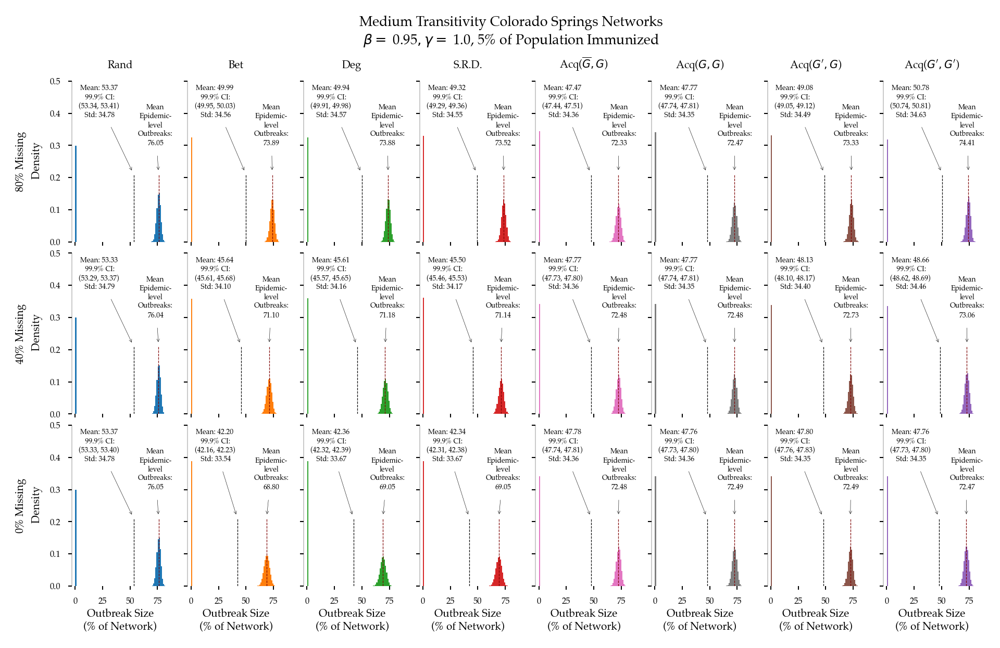

In [146]:
# Fixed Parameters
beta= 0.95
gamma=1.0
pctImmunized = .05
folderName = 'allMedResults5and15'
network_size = 1000
figFileName = 'distPlots_med_beta095_imnzd05'

thresh = 1.0 # 1% outbreak size


# Figure Tweaking
xlimits = (-3, 85)
ylimits = (0, 0.5)
figSize = (7.5, 4.2)

dfaultBins = 69
plt.rcParams["axes.grid"] = False

scale = 0.11

plt.rcParams['pdf.fonttype'] = 42
plt.rcParams["figure.dpi"] = 300.0

tickSize = 35*scale
tickMarkLength = 15*scale
tickMarkWidth = 4.2*scale
arrowWidth = 0.142
arrow_head_length=1
arrow_head_width=0.42
annotateFontSize = 30*scale
labelSize = 45*scale
meanLinesWidth = 2.69*scale
stratFontSize = 45*scale
font = {'family' : 'Palatino',
        'weight' : 'normal',
        'size'   : 36*scale}

plt.rc('font', **font)



all_filenames = [i for i in glob.glob(INDIR+"/"+folderName+'/*Beta={}Gamma={}*pctsImmunized{}.csv'.format(str(beta), str(gamma), str(pctImmunized)))]

strategies = [ "RandSamp", "Bet", "DegKK",  "Srd","acqKG2_up", "acqGG2", "acqKG2", "acqKK2"]

fracsMissing = [0.8, 0.4, 0.0]





obsDF = pd.concat([pd.read_csv(f) for f in all_filenames ], sort=False)


fig, axs = plt.subplots(len(fracsMissing), len(strategies), figsize=figSize, sharex=True, sharey=True)



timesCountsToDists = []

    
for i, fracMissing in enumerate(fracsMissing):
    for j, strat in enumerate(strategies):
        
        print("strat: ", strat, " fraction missing: ", fracMissing)
        if strat == "acqKK2" and fracMissing == 0.8 and pctImmunized >= .1:
            axs[i, j].axis('off')
            if i==0:
                axs[i, j].set(title=stratNameMap[strat])

            continue
        
        
        
        obs = obsDF[(obsDF['strategy']==strat) & (obsDF['fracMissing']==fracMissing)&(obsDF['pctImmunized']==pctImmunized)&(obsDF['beta']==beta)&(obsDF['gamma']==gamma)]


        pooledOutbreaks = []
        secondMode = []
        allFinalSizeDistDicts = [ast.literal_eval(finalSizeDist) for finalSizeDist in obs['finalSizeDist']]
        
        start = time.time()
        
        #This could maybe be faster if I preallocated memory and then inserted instead of merging two lists every time
        #That would also speed up the conversion to percent because it would be vectorized
        

        for countDict in allFinalSizeDistDicts:
            finalSizesForThisTrial = convertCounterToSequence(countDict)
            for finalSize in finalSizesForThisTrial:
                outbreakSize = 100*(finalSize/network_size)
                pooledOutbreaks.append(outbreakSize)

                if outbreakSize > thresh:
                    secondMode.append(outbreakSize)


        end = time.time()
        
        timesCountsToDists.append(end-start)
        print(end-start)
        
        
        
        
        
        print(len(pooledOutbreaks))
        mean = np.mean(pooledOutbreaks)  
        std = np.std(pooledOutbreaks)
        SEM = std /np.sqrt(len(pooledOutbreaks)) #We have such a large sample that it doesnt matter that its not normal
        conf = 3.291 * SEM # 99.9% confidence  IS THIS RIGHT? I GOT SLIGHTLY DIFFRENT CRITICAL VALUES FROM DIFFRENT WEBSITES

        
        pctAboveThresh = 100*len(secondMode)/len(pooledOutbreaks)
        
        meanEpidemic = np.mean(secondMode)  

        
        axs[i, j].hist(pooledOutbreaks, bins=np.arange(min(pooledOutbreaks), max(pooledOutbreaks) + 1, 1), color=stratColorMap[strat], density=True)
        
        axs[i, j].axvline(mean, color='k', ls='--', linewidth=meanLinesWidth, ymax=0.42)
        axs[i, j].axvline(meanEpidemic, color='#800000', ls='--', linewidth=meanLinesWidth, ymax=0.42)

        axs[i, j].set_xlim(xlimits)
        axs[i, j].set_ylim(ylimits)
        
        axs[i, j].spines['top'].set_visible(False)
        axs[i, j].spines['right'].set_visible(False)
        axs[i, j].spines['bottom'].set_visible(False)

        axs[i, j].spines['left'].set_linewidth(0.1)
        axs[i, j].spines['left'].set_capstyle('butt')
        
        
        info = 'Mean: '+format(mean, '.2f')+"\n 99.9% CI:\n("+format(mean-conf, '.2f')+", "+format(mean+conf, '.2f')+")\n Std: "+format(std, '.2f')
        
        axs[i, j].annotate(info,fontsize=annotateFontSize,multialignment='center',
                           xy=(mean, .42*ylimits[1]),  xycoords='data',
                           xytext=(40, .49), textcoords='data',
                           arrowprops=dict(lw=arrowWidth, arrowstyle="->",connectionstyle="arc3"),
                           horizontalalignment='right', verticalalignment='top', annotation_clip=False
                          )

        secondInfo = 'Mean\nEpidemic-\nlevel\nOutbreaks:\n'+format(meanEpidemic, '.2f')
        

        axs[i, j].annotate(secondInfo,fontsize=annotateFontSize,multialignment='center',
                   xy=(meanEpidemic, .42*ylimits[1]),  xycoords='data',
                   xytext=(89, 0.43), textcoords='data',
                   arrowprops=dict(lw=arrowWidth, arrowstyle="->",connectionstyle="arc3"),
                   horizontalalignment='right', verticalalignment='top', annotation_clip=False
                  )

        axs[i, j].tick_params(axis='both', which='major', length= tickMarkLength,  width=0.3*tickMarkLength)
        
        axs[i, j].xaxis.set_major_locator(ticker.MultipleLocator(25))
        if i==0:
            axs[i, j].set_title(stratNameMap[strat], fontsize = stratFontSize)

        
        if i==len(fracsMissing)-1:
            axs[i, j].set_xlabel("Outbreak Size\n(% of Network)",   labelpad=10*scale, fontdict={'fontsize':labelSize})
            

                  
        if j==0:
            axs[i, j].set_ylabel(str(int(fracMissing*100))+"% Missing\n Density", linespacing=1.6, labelpad=30*scale, fontdict={'fontsize':labelSize})



plt.suptitle('Medium Transitivity Colorado Springs Networks\n$\\beta=$ ' +str(beta)+ '$, \gamma=$ '+str(gamma)+ ", " + str(int(100*pctImmunized))+'% of Population Immunized', size=labelSize*1.3)
#plt.subplots_adjust(top=0.89, bottom=0.23, left=0.17, right=0.88, hspace=0.069, wspace=0.069)
plt.subplots_adjust(hspace=0.07)

#plt.savefig(figFileName+'.pdf', bbox_inches = 'tight', pad_inches = 0)
plt.savefig(OUTDIR+figFileName+'.pdf')
#plt.savefig(figFileName+'.tiff')

        
print("average time spent converting to distributions: ", np.mean(timesCountsToDists))        
plt.show()

### Supp. Fig. 9

strat:  RandSamp  fraction missing:  0.8
2.9462437629699707
10000000
strat:  Bet  fraction missing:  0.8
3.1806468963623047
10000000
strat:  DegKK  fraction missing:  0.8
3.1726930141448975
10000000
strat:  Srd  fraction missing:  0.8
2.901521921157837
10000000
strat:  acqKG2_up  fraction missing:  0.8
2.8852360248565674
10000000
strat:  acqGG2  fraction missing:  0.8
2.9023399353027344
10000000
strat:  acqKG2  fraction missing:  0.8
2.906428813934326
10000000
strat:  acqKK2  fraction missing:  0.8
strat:  RandSamp  fraction missing:  0.4
2.9306459426879883
10000000
strat:  Bet  fraction missing:  0.4
2.9196038246154785
10000000
strat:  DegKK  fraction missing:  0.4
2.8991260528564453
10000000
strat:  Srd  fraction missing:  0.4
2.906857967376709
10000000
strat:  acqKG2_up  fraction missing:  0.4
2.889680862426758
10000000
strat:  acqGG2  fraction missing:  0.4
3.0512399673461914
10000000
strat:  acqKG2  fraction missing:  0.4
3.037466049194336
10000000
strat:  acqKK2  fraction missing

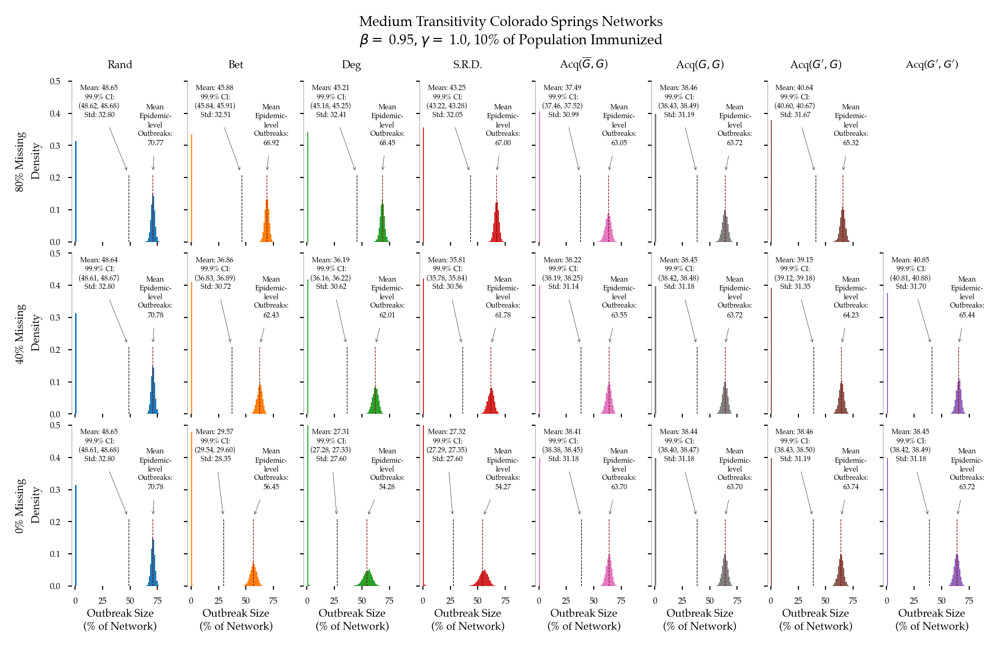

In [148]:
# Fixed Parameters
beta= 0.95
gamma=1.0
pctImmunized = .10
folderName = 'newMedResults_gamma1_beta20to220'
network_size = 1000
figFileName = 'distPlots_med_beta095_imnzd10'

thresh = 1.0 # 1% outbreak size


# Figure Tweaking
xlimits = (-3, 85)
ylimits = (0, 0.5)
figSize = (7.5, 4.2)

dfaultBins = 69
plt.rcParams["axes.grid"] = False

scale = 0.11

plt.rcParams['pdf.fonttype'] = 42
plt.rcParams["figure.dpi"] = 300.0

tickSize = 35*scale
tickMarkLength = 15*scale
tickMarkWidth = 4.2*scale
arrowWidth = 0.142
arrow_head_length=1
arrow_head_width=0.42
annotateFontSize = 30*scale
labelSize = 45*scale
meanLinesWidth = 2.69*scale
stratFontSize = 45*scale
font = {'family' : 'Palatino',
        'weight' : 'normal',
        'size'   : 36*scale}

plt.rc('font', **font)



all_filenames = [i for i in glob.glob(INDIR+"/"+folderName+'/*Beta={}Gamma={}*pctsImmunized{}.csv'.format(str(beta), str(gamma), str(pctImmunized)))]

strategies = [ "RandSamp", "Bet", "DegKK",  "Srd","acqKG2_up", "acqGG2", "acqKG2", "acqKK2"]

fracsMissing = [0.8, 0.4, 0.0]





obsDF = pd.concat([pd.read_csv(f) for f in all_filenames ], sort=False)


fig, axs = plt.subplots(len(fracsMissing), len(strategies), figsize=figSize, sharex=True, sharey=True)



timesCountsToDists = []

    
for i, fracMissing in enumerate(fracsMissing):
    for j, strat in enumerate(strategies):
        
        print("strat: ", strat, " fraction missing: ", fracMissing)
        if strat == "acqKK2" and fracMissing == 0.8 and pctImmunized >= .1:
            axs[i, j].axis('off')
            if i==0:
                axs[i, j].set(title=stratNameMap[strat])

            continue
        
        
        
        obs = obsDF[(obsDF['strategy']==strat) & (obsDF['fracMissing']==fracMissing)&(obsDF['pctImmunized']==pctImmunized)&(obsDF['beta']==beta)&(obsDF['gamma']==gamma)]


        pooledOutbreaks = []
        secondMode = []
        allFinalSizeDistDicts = [ast.literal_eval(finalSizeDist) for finalSizeDist in obs['finalSizeDist']]
        
        start = time.time()
        
        #This could maybe be faster if I preallocated memory and then inserted instead of merging two lists every time
        #That would also speed up the conversion to percent because it would be vectorized
        

        for countDict in allFinalSizeDistDicts:
            finalSizesForThisTrial = convertCounterToSequence(countDict)
            for finalSize in finalSizesForThisTrial:
                outbreakSize = 100*(finalSize/network_size)
                pooledOutbreaks.append(outbreakSize)

                if outbreakSize > thresh:
                    secondMode.append(outbreakSize)


        end = time.time()
        
        timesCountsToDists.append(end-start)
        print(end-start)
        
        
        
        
        
        print(len(pooledOutbreaks))
        mean = np.mean(pooledOutbreaks)  
        std = np.std(pooledOutbreaks)
        SEM = std /np.sqrt(len(pooledOutbreaks)) #We have such a large sample that it doesnt matter that its not normal
        conf = 3.291 * SEM # 99.9% confidence  IS THIS RIGHT? I GOT SLIGHTLY DIFFRENT CRITICAL VALUES FROM DIFFRENT WEBSITES

        
        pctAboveThresh = 100*len(secondMode)/len(pooledOutbreaks)
        
        meanEpidemic = np.mean(secondMode)  

        
        axs[i, j].hist(pooledOutbreaks, bins=np.arange(min(pooledOutbreaks), max(pooledOutbreaks) + 1, 1), color=stratColorMap[strat], density=True)
        
        axs[i, j].axvline(mean, color='k', ls='--', linewidth=meanLinesWidth, ymax=0.42)
        axs[i, j].axvline(meanEpidemic, color='#800000', ls='--', linewidth=meanLinesWidth, ymax=0.42)

        axs[i, j].set_xlim(xlimits)
        axs[i, j].set_ylim(ylimits)
        
        axs[i, j].spines['top'].set_visible(False)
        axs[i, j].spines['right'].set_visible(False)
        axs[i, j].spines['bottom'].set_visible(False)

        axs[i, j].spines['left'].set_linewidth(0.1)
        axs[i, j].spines['left'].set_capstyle('butt')
        
        
        info = 'Mean: '+format(mean, '.2f')+"\n 99.9% CI:\n("+format(mean-conf, '.2f')+", "+format(mean+conf, '.2f')+")\n Std: "+format(std, '.2f')
        
        axs[i, j].annotate(info,fontsize=annotateFontSize,multialignment='center',
                           xy=(mean, .42*ylimits[1]),  xycoords='data',
                           xytext=(40, .49), textcoords='data',
                           arrowprops=dict(lw=arrowWidth, arrowstyle="->",connectionstyle="arc3"),
                           horizontalalignment='right', verticalalignment='top', annotation_clip=False
                          )

        secondInfo = 'Mean\nEpidemic-\nlevel\nOutbreaks:\n'+format(meanEpidemic, '.2f')
        

        axs[i, j].annotate(secondInfo,fontsize=annotateFontSize,multialignment='center',
                   xy=(meanEpidemic, .42*ylimits[1]),  xycoords='data',
                   xytext=(89, 0.43), textcoords='data',
                   arrowprops=dict(lw=arrowWidth, arrowstyle="->",connectionstyle="arc3"),
                   horizontalalignment='right', verticalalignment='top', annotation_clip=False
                  )

        axs[i, j].tick_params(axis='both', which='major', length= tickMarkLength,  width=0.3*tickMarkLength)
        
        axs[i, j].xaxis.set_major_locator(ticker.MultipleLocator(25))
        if i==0:
            axs[i, j].set_title(stratNameMap[strat], fontsize = stratFontSize)

        
        if i==len(fracsMissing)-1:
            axs[i, j].set_xlabel("Outbreak Size\n(% of Network)",   labelpad=10*scale, fontdict={'fontsize':labelSize})
            

                  
        if j==0:
            axs[i, j].set_ylabel(str(int(fracMissing*100))+"% Missing\n Density", linespacing=1.6, labelpad=30*scale, fontdict={'fontsize':labelSize})



plt.suptitle('Medium Transitivity Colorado Springs Networks\n$\\beta=$ ' +str(beta)+ '$, \gamma=$ '+str(gamma)+ ", " + str(int(100*pctImmunized))+'% of Population Immunized', size=labelSize*1.3)
#plt.subplots_adjust(top=0.89, bottom=0.23, left=0.17, right=0.88, hspace=0.069, wspace=0.069)
plt.subplots_adjust(hspace=0.07)

#plt.savefig(figFileName+'.pdf', bbox_inches = 'tight', pad_inches = 0)
plt.savefig(OUTDIR+figFileName+'.pdf')
#plt.savefig(figFileName+'.tiff')

        
print("average time spent converting to distributions: ", np.mean(timesCountsToDists))        
plt.show()

### Supp. Fig. 10

strat:  RandSamp  fraction missing:  0.8
3.0626587867736816
10000000
strat:  Bet  fraction missing:  0.8
2.9993319511413574
10000000
strat:  DegKK  fraction missing:  0.8
2.9967117309570312
10000000
strat:  Srd  fraction missing:  0.8
2.94504976272583
10000000
strat:  acqKG2_up  fraction missing:  0.8
2.9093239307403564
10000000
strat:  acqGG2  fraction missing:  0.8
2.864804983139038
10000000
strat:  acqKG2  fraction missing:  0.8
3.012436866760254
10000000
strat:  acqKK2  fraction missing:  0.8
strat:  RandSamp  fraction missing:  0.4
3.2978298664093018
10000000
strat:  Bet  fraction missing:  0.4
2.99306321144104
10000000
strat:  DegKK  fraction missing:  0.4
2.916559934616089
10000000
strat:  Srd  fraction missing:  0.4
2.9031569957733154
10000000
strat:  acqKG2_up  fraction missing:  0.4
2.8978219032287598
10000000
strat:  acqGG2  fraction missing:  0.4
2.8879361152648926
10000000
strat:  acqKG2  fraction missing:  0.4
2.9075398445129395
10000000
strat:  acqKK2  fraction missing: 

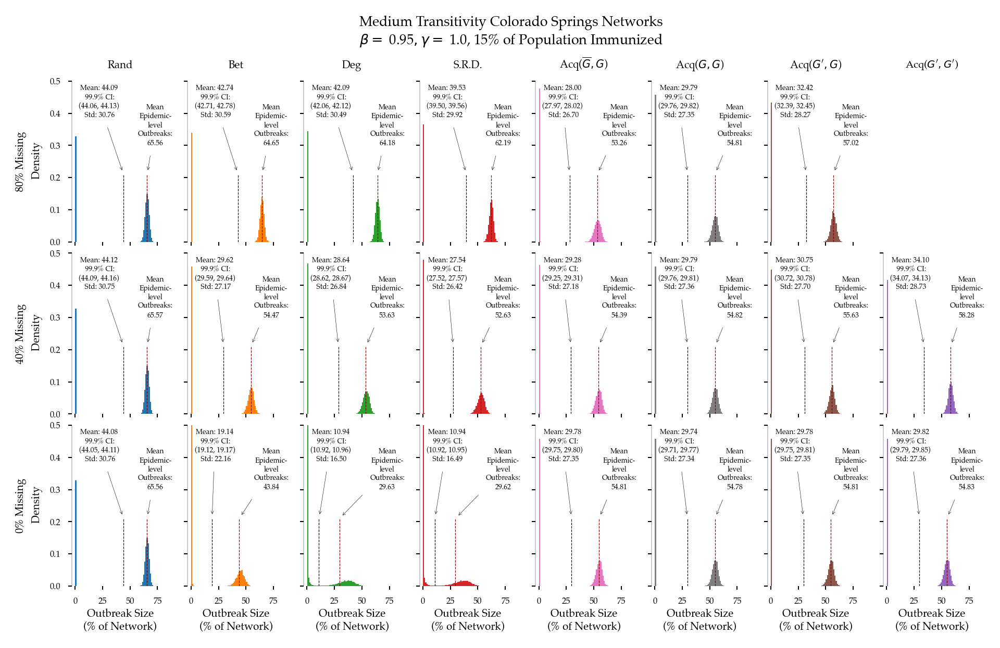

In [149]:
# Fixed Parameters
beta= 0.95
gamma=1.0
pctImmunized = .15
folderName = 'allMedResults5and15'
network_size = 1000
figFileName = 'distPlots_med_beta095_imnzd15'

thresh = 1.0 # 1% outbreak size


# Figure Tweaking
xlimits = (-3, 85)
ylimits = (0, 0.5)
figSize = (7.5, 4.2)

dfaultBins = 69
plt.rcParams["axes.grid"] = False

scale = 0.11

plt.rcParams['pdf.fonttype'] = 42
plt.rcParams["figure.dpi"] = 300.0

tickSize = 35*scale
tickMarkLength = 15*scale
tickMarkWidth = 4.2*scale
arrowWidth = 0.142
arrow_head_length=1
arrow_head_width=0.42
annotateFontSize = 30*scale
labelSize = 45*scale
meanLinesWidth = 2.69*scale
stratFontSize = 45*scale
font = {'family' : 'Palatino',
        'weight' : 'normal',
        'size'   : 36*scale}

plt.rc('font', **font)



all_filenames = [i for i in glob.glob(INDIR+"/"+folderName+'/*Beta={}Gamma={}*pctsImmunized{}.csv'.format(str(beta), str(gamma), str(pctImmunized)))]

strategies = [ "RandSamp", "Bet", "DegKK",  "Srd","acqKG2_up", "acqGG2", "acqKG2", "acqKK2"]

fracsMissing = [0.8, 0.4, 0.0]





obsDF = pd.concat([pd.read_csv(f) for f in all_filenames ], sort=False)


fig, axs = plt.subplots(len(fracsMissing), len(strategies), figsize=figSize, sharex=True, sharey=True)



timesCountsToDists = []

    
for i, fracMissing in enumerate(fracsMissing):
    for j, strat in enumerate(strategies):
        
        print("strat: ", strat, " fraction missing: ", fracMissing)
        if strat == "acqKK2" and fracMissing == 0.8 and pctImmunized >= .1:
            axs[i, j].axis('off')
            if i==0:
                axs[i, j].set(title=stratNameMap[strat])

            continue
        
        
        
        obs = obsDF[(obsDF['strategy']==strat) & (obsDF['fracMissing']==fracMissing)&(obsDF['pctImmunized']==pctImmunized)&(obsDF['beta']==beta)&(obsDF['gamma']==gamma)]


        pooledOutbreaks = []
        secondMode = []
        allFinalSizeDistDicts = [ast.literal_eval(finalSizeDist) for finalSizeDist in obs['finalSizeDist']]
        
        start = time.time()
        
        #This could maybe be faster if I preallocated memory and then inserted instead of merging two lists every time
        #That would also speed up the conversion to percent because it would be vectorized
        

        for countDict in allFinalSizeDistDicts:
            finalSizesForThisTrial = convertCounterToSequence(countDict)
            for finalSize in finalSizesForThisTrial:
                outbreakSize = 100*(finalSize/network_size)
                pooledOutbreaks.append(outbreakSize)

                if outbreakSize > thresh:
                    secondMode.append(outbreakSize)


        end = time.time()
        
        timesCountsToDists.append(end-start)
        print(end-start)
        
        
        
        
        
        print(len(pooledOutbreaks))
        mean = np.mean(pooledOutbreaks)  
        std = np.std(pooledOutbreaks)
        SEM = std /np.sqrt(len(pooledOutbreaks)) #We have such a large sample that it doesnt matter that its not normal
        conf = 3.291 * SEM # 99.9% confidence  IS THIS RIGHT? I GOT SLIGHTLY DIFFRENT CRITICAL VALUES FROM DIFFRENT WEBSITES

        
        pctAboveThresh = 100*len(secondMode)/len(pooledOutbreaks)
        
        meanEpidemic = np.mean(secondMode)  

        
        axs[i, j].hist(pooledOutbreaks, bins=np.arange(min(pooledOutbreaks), max(pooledOutbreaks) + 1, 1), color=stratColorMap[strat], density=True)
        
        axs[i, j].axvline(mean, color='k', ls='--', linewidth=meanLinesWidth, ymax=0.42)
        axs[i, j].axvline(meanEpidemic, color='#800000', ls='--', linewidth=meanLinesWidth, ymax=0.42)

        axs[i, j].set_xlim(xlimits)
        axs[i, j].set_ylim(ylimits)
        
        axs[i, j].spines['top'].set_visible(False)
        axs[i, j].spines['right'].set_visible(False)
        axs[i, j].spines['bottom'].set_visible(False)

        axs[i, j].spines['left'].set_linewidth(0.1)
        axs[i, j].spines['left'].set_capstyle('butt')
        
        
        info = 'Mean: '+format(mean, '.2f')+"\n 99.9% CI:\n("+format(mean-conf, '.2f')+", "+format(mean+conf, '.2f')+")\n Std: "+format(std, '.2f')
        
        axs[i, j].annotate(info,fontsize=annotateFontSize,multialignment='center',
                           xy=(mean, .42*ylimits[1]),  xycoords='data',
                           xytext=(40, .49), textcoords='data',
                           arrowprops=dict(lw=arrowWidth, arrowstyle="->",connectionstyle="arc3"),
                           horizontalalignment='right', verticalalignment='top', annotation_clip=False
                          )

        secondInfo = 'Mean\nEpidemic-\nlevel\nOutbreaks:\n'+format(meanEpidemic, '.2f')
        

        axs[i, j].annotate(secondInfo,fontsize=annotateFontSize,multialignment='center',
                   xy=(meanEpidemic, .42*ylimits[1]),  xycoords='data',
                   xytext=(89, 0.43), textcoords='data',
                   arrowprops=dict(lw=arrowWidth, arrowstyle="->",connectionstyle="arc3"),
                   horizontalalignment='right', verticalalignment='top', annotation_clip=False
                  )

        axs[i, j].tick_params(axis='both', which='major', length= tickMarkLength,  width=0.3*tickMarkLength)
        
        axs[i, j].xaxis.set_major_locator(ticker.MultipleLocator(25))
        if i==0:
            axs[i, j].set_title(stratNameMap[strat], fontsize = stratFontSize)

        
        if i==len(fracsMissing)-1:
            axs[i, j].set_xlabel("Outbreak Size\n(% of Network)",   labelpad=10*scale, fontdict={'fontsize':labelSize})
            

                  
        if j==0:
            axs[i, j].set_ylabel(str(int(fracMissing*100))+"% Missing\n Density", linespacing=1.6, labelpad=30*scale, fontdict={'fontsize':labelSize})



plt.suptitle('Medium Transitivity Colorado Springs Networks\n$\\beta=$ ' +str(beta)+ '$, \gamma=$ '+str(gamma)+ ", " + str(int(100*pctImmunized))+'% of Population Immunized', size=labelSize*1.3)
#plt.subplots_adjust(top=0.89, bottom=0.23, left=0.17, right=0.88, hspace=0.069, wspace=0.069)
plt.subplots_adjust(hspace=0.07)

#plt.savefig(figFileName+'.pdf', bbox_inches = 'tight', pad_inches = 0)
plt.savefig(OUTDIR+figFileName+'.pdf')
#plt.savefig(figFileName+'.tiff')

        
print("average time spent converting to distributions: ", np.mean(timesCountsToDists))        
plt.show()

### Supp. Fig 11

strat:  RandSamp  fraction missing:  0.8
3.522824764251709
10000000
strat:  Bet  fraction missing:  0.8
3.5280098915100098
10000000
strat:  DegKK  fraction missing:  0.8
3.3148279190063477
10000000
strat:  Srd  fraction missing:  0.8
3.1720118522644043
10000000
strat:  acqKG2_up  fraction missing:  0.8
3.5051190853118896
10000000
strat:  acqGG2  fraction missing:  0.8
3.3293209075927734
10000000
strat:  acqKG2  fraction missing:  0.8
3.2699992656707764
10000000
strat:  acqKK2  fraction missing:  0.8
strat:  RandSamp  fraction missing:  0.4
3.3138740062713623
10000000
strat:  Bet  fraction missing:  0.4
3.7523961067199707
10000000
strat:  DegKK  fraction missing:  0.4
3.5473546981811523
10000000
strat:  Srd  fraction missing:  0.4
3.2140440940856934
10000000
strat:  acqKG2_up  fraction missing:  0.4
3.329313039779663
10000000
strat:  acqGG2  fraction missing:  0.4
3.3043150901794434
10000000
strat:  acqKG2  fraction missing:  0.4
3.353614091873169
10000000
strat:  acqKK2  fraction missi

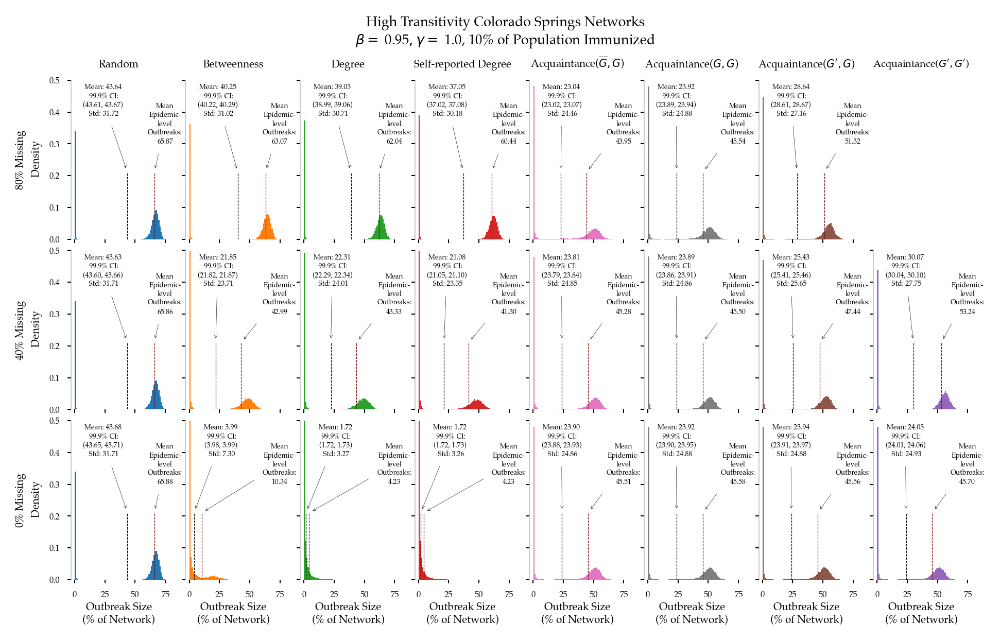

In [151]:


# Fixed Parameters
beta= 0.95
gamma=1.0
pctImmunized = .1
folderName = INDIR+"/"+'newHighResults_gamma1_beta20to220'
network_size = 1000
figFileName = 'distPlots_high_beta095_imnzd10'

thresh = 1.0 # 1% outbreak size


# Figure Tweaking
xlimits = (-3, 76)
ylimits = (0, 0.5)
#figSize = (69, 30)
figSize = (7.5, 4.2)
dfaultBins = 69
plt.rcParams["axes.grid"] = False

scale = 0.11

plt.rcParams['pdf.fonttype'] = 42
plt.rcParams["figure.dpi"] = 300.0

tickSize = 35*scale
tickMarkLength = 15*scale
tickMarkWidth = 4.2*scale
arrowWidth = 0.142
arrow_head_length=1
arrow_head_width=0.42
annotateFontSize = 30*scale
labelSize = 45*scale
meanLinesWidth = 2.69*scale
stratFontSize = 45*scale
font = {'family' : 'Palatino',
        'weight' : 'normal',
        'size'   : 36*scale}

plt.rc('font', **font)







all_filenames = [i for i in glob.glob(folderName+'/*Beta={}Gamma={}*pctsImmunized{}.csv'.format(str(beta), str(gamma), str(pctImmunized)))]

strategies = [ "RandSamp", "Bet", "DegKK",  "Srd","acqKG2_up", "acqGG2", "acqKG2", "acqKK2"]


stratNameMap = {'Rand':'Rand', 'RandSamp':'Random','Bet':'Betweenness', 'DegKK':"Degree","Srd":"Self-reported Degree", "acqKK2":"Acquaintance($G^\prime, G^\prime$)", "acqGG2":"Acquaintance($G, G$)", "acqKG2":"Acquaintance($G^\prime,G$)", "acqKG2_up":"Acquaintance($\overline{G},G$)", "No_imm":"No Immunization"}
fracsMissing = [0.8, 0.4, 0.0]






obsDF = pd.concat([pd.read_csv(f) for f in all_filenames ], sort=False)


fig, axs = plt.subplots(len(fracsMissing), len(strategies), figsize=figSize, sharex=True, sharey=True)



timesCountsToDists = []

    
for i, fracMissing in enumerate(fracsMissing):
    for j, strat in enumerate(strategies):
        
        print("strat: ", strat, " fraction missing: ", fracMissing)
        if strat == "acqKK2" and fracMissing == 0.8:
            axs[i, j].axis('off')
            if i==0:
                axs[i, j].set(title=stratNameMap[strat])

            continue
        
        
        
        obs = obsDF.loc[(obsDF['strategy']==strat) & (obsDF['fracMissing']==fracMissing)&(obsDF['pctImmunized']==pctImmunized)&(obsDF['beta']==beta)&(obsDF['gamma']==gamma)]


        pooledOutbreaks = []
        secondMode = []
        allFinalSizeDistDicts = [ast.literal_eval(finalSizeDist) for finalSizeDist in obs['finalSizeDist']]
        
        start = time.time()
        





        #This could maybe be faster if I preallocated memory and then inserted instead of merging two lists every time
        #That would also speed up the conversion to percent because it would be vectorized
        #for net, countDict in enumerate(allFinalSizeDistDicts):        
        
        

        for countDict in allFinalSizeDistDicts:
            finalSizesForThisTrial = convertCounterToSequence(countDict)
            #pooledOutbreaks += finalSizesForThisTrial
            for finalSize in finalSizesForThisTrial:
                outbreakSize = 100*(finalSize/network_size)
                pooledOutbreaks.append(outbreakSize)

                if outbreakSize > thresh:
                    secondMode.append(outbreakSize)
                    

        end = time.time()
        
        timesCountsToDists.append(end-start)
        print(end-start)
        
        
        
        print(len(pooledOutbreaks))
        mean = np.mean(pooledOutbreaks)  
        std = np.std(pooledOutbreaks)
        SEM = std /np.sqrt(len(pooledOutbreaks)) #We have such a large sample that it doesnt matter that its not normal
        conf = 3.291 * SEM # 99.9% confidence  IS THIS RIGHT? I GOT SLIGHTLY DIFFRENT CRITICAL VALUES FROM DIFFRENT WEBSITES

        
        pctAboveThresh = 100*len(secondMode)/len(pooledOutbreaks)
        
        meanEpidemic = np.mean(secondMode)  

        
        axs[i, j].hist(pooledOutbreaks, bins=np.arange(min(pooledOutbreaks), max(pooledOutbreaks) + 1, 1), color=stratColorMap[strat], density=True)        
        axs[i, j].axvline(mean, color='k', ls='--', linewidth=meanLinesWidth, ymax=0.42)
        axs[i, j].axvline(meanEpidemic, color='#800000', ls='--', linewidth=meanLinesWidth, ymax=0.42)
        axs[i, j].set_xlim(xlimits)
        axs[i, j].set_ylim(ylimits)
        axs[i, j].spines['top'].set_visible(False)
        axs[i, j].spines['right'].set_visible(False)
        axs[i, j].spines['bottom'].set_visible(False)
        axs[i, j].spines['left'].set_linewidth(0.1)
        axs[i, j].spines['left'].set_capstyle('butt')
        
        
        
        
        info = 'Mean: '+format(mean, '.2f')+"\n 99.9% CI:\n("+format(mean-conf, '.2f')+", "+format(mean+conf, '.2f')+")\n Std: "+format(std, '.2f')
        axs[i, j].annotate(info,fontsize=annotateFontSize,multialignment='center',
                           xy=(mean, .42*ylimits[1]),  xycoords='data',
                           xytext=(40, .49), textcoords='data',
                           arrowprops=dict(lw=arrowWidth, arrowstyle="->",connectionstyle="arc3"),
                           horizontalalignment='right', verticalalignment='top', annotation_clip=False
                          )

        secondInfo = 'Mean\nEpidemic-\nlevel\nOutbreaks:\n'+format(meanEpidemic, '.2f')
        

        axs[i, j].annotate(secondInfo,fontsize=annotateFontSize,multialignment='center',
                   xy=(meanEpidemic, .42*ylimits[1]),  xycoords='data',
                   xytext=(89, 0.43), textcoords='data',
                   arrowprops=dict(lw=arrowWidth, arrowstyle="->",connectionstyle="arc3"),
                   horizontalalignment='right', verticalalignment='top', annotation_clip=False
                  )

        axs[i, j].tick_params(axis='both', which='major', length= tickMarkLength,  width=0.3*tickMarkLength)
        
        axs[i, j].xaxis.set_major_locator(ticker.MultipleLocator(25))

        if i==0:
            axs[i, j].set_title(stratNameMap[strat], fontsize = stratFontSize)

        
        if i==len(fracsMissing)-1:
            axs[i, j].set_xlabel("Outbreak Size\n(% of Network)",   labelpad=10*scale, fontdict={'fontsize':labelSize})

                  
        if j==0:
            axs[i, j].set_ylabel(str(int(fracMissing*100))+"% Missing\n Density", linespacing=1.6, labelpad=30*scale, fontdict={'fontsize':labelSize})
            



plt.suptitle('High Transitivity Colorado Springs Networks\n$\\beta=$ ' +str(beta)+ '$, \gamma=$ '+str(gamma)+ ", " + str(int(100*pctImmunized))+'% of Population Immunized', size=labelSize*1.3)
plt.subplots_adjust(hspace=0.07)

plt.savefig(OUTDIR+"/"+figFileName+'.pdf')
        
print("average time spent converting to distributions: ", np.mean(timesCountsToDists))        
plt.show()

### Supp. Fig. 12

strat:  RandSamp  fraction missing:  0.8
3.7396299839019775
10000000
strat:  Bet  fraction missing:  0.8
3.2737538814544678
10000000
strat:  DegKK  fraction missing:  0.8
3.370518922805786
10000000
strat:  Srd  fraction missing:  0.8
3.4568686485290527
10000000
strat:  acqKG2_up  fraction missing:  0.8
3.2745349407196045
10000000
strat:  acqGG2  fraction missing:  0.8
3.530971050262451
10000000
strat:  acqKG2  fraction missing:  0.8
3.266486883163452
10000000
strat:  acqKK2  fraction missing:  0.8
strat:  RandSamp  fraction missing:  0.4
3.600726842880249
10000000
strat:  Bet  fraction missing:  0.4
3.557260036468506
10000000
strat:  DegKK  fraction missing:  0.4
3.4277260303497314
10000000
strat:  Srd  fraction missing:  0.4
3.313431978225708
10000000
strat:  acqKG2_up  fraction missing:  0.4
3.057324171066284
10000000
strat:  acqGG2  fraction missing:  0.4
3.2096590995788574
10000000
strat:  acqKG2  fraction missing:  0.4
3.270019054412842
10000000
strat:  acqKK2  fraction missing:  

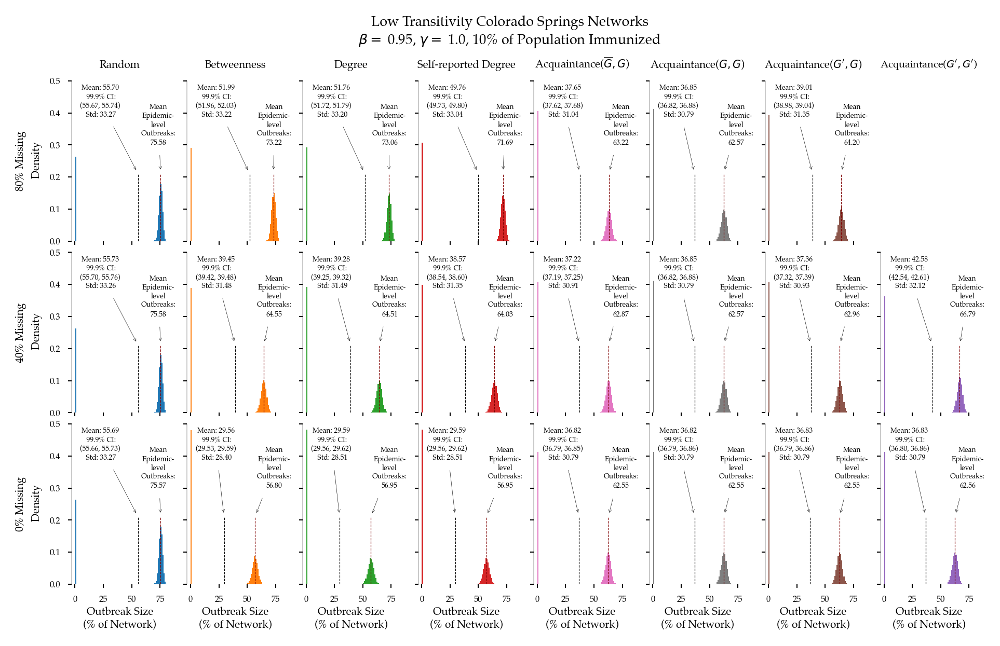

In [150]:


# Fixed Parameters
beta= 0.95
gamma=1.0
pctImmunized = .1
folderName = INDIR+"/"+'newLowResults_gamma1_beta20to220'
network_size = 1000
figFileName = 'distPlots_low_beta095_imnzd10'

thresh = 1.0 # 1% outbreak size


# Figure Tweaking
xlimits = (-3, 82)
ylimits = (0, 0.5)
figSize = (7.5, 4.2)

dfaultBins = xlimits[1]-xlimits[0]
plt.rcParams["axes.grid"] = False

scale = 0.11

plt.rcParams['pdf.fonttype'] = 42
plt.rcParams["figure.dpi"] = 300.0

tickSize = 35*scale
tickMarkLength = 15*scale
tickMarkWidth = 4.2*scale
arrowWidth = 0.142
arrow_head_length=1
arrow_head_width=0.42
annotateFontSize = 30*scale
labelSize = 45*scale
meanLinesWidth = 2.69*scale
stratFontSize = 45*scale
font = {'family' : 'Palatino',
        'weight' : 'normal',
        'size'   : 36*scale}

plt.rc('font', **font)






all_filenames = [i for i in glob.glob(folderName+'/*Beta={}Gamma={}*pctsImmunized{}.csv'.format(str(beta), str(gamma), str(pctImmunized)))]

strategies = [ "RandSamp", "Bet", "DegKK",  "Srd","acqKG2_up", "acqGG2", "acqKG2", "acqKK2"]


stratNameMap = {'Rand':'Rand', 'RandSamp':'Random','Bet':'Betweenness', 'DegKK':"Degree","Srd":"Self-reported Degree", "acqKK2":"Acquaintance($G^\prime, G^\prime$)", "acqGG2":"Acquaintance($G, G$)", "acqKG2":"Acquaintance($G^\prime,G$)", "acqKG2_up":"Acquaintance($\overline{G},G$)", "No_imm":"No Immunization"}
fracsMissing = [0.8, 0.4, 0.0]






obsDF = pd.concat([pd.read_csv(f) for f in all_filenames ], sort=False)


fig, axs = plt.subplots(len(fracsMissing), len(strategies), figsize=figSize, sharex=True, sharey=True)



timesCountsToDists = []

    
for i, fracMissing in enumerate(fracsMissing):
    for j, strat in enumerate(strategies):
        
        print("strat: ", strat, " fraction missing: ", fracMissing)
        if strat == "acqKK2" and fracMissing == 0.8:
            axs[i, j].axis('off')
            if i==0:
                axs[i, j].set(title=stratNameMap[strat])

            continue
        
        
        
        #obs = obsDF[(obsDF['strategy']==strat) & (obsDF['fracMissing']==fracMissing)&(obsDF['pctImmunized']==pctImmunized)&(obsDF['beta']==beta)&(obsDF['gamma']==gamma)]
        obs = obsDF.loc[(obsDF['strategy']==strat) & (obsDF['fracMissing']==fracMissing)&(obsDF['pctImmunized']==pctImmunized)&(obsDF['beta']==beta)&(obsDF['gamma']==gamma)]


        pooledOutbreaks = []
        #firstMode = []
        secondMode = []
        allFinalSizeDistDicts = [ast.literal_eval(finalSizeDist) for finalSizeDist in obs['finalSizeDist']]
        
        start = time.time()
        

        #This could maybe be faster if I preallocated memory and then inserted instead of merging two lists every time
        #That would also speed up the conversion to percent because it would be vectorized
        #for net, countDict in enumerate(allFinalSizeDistDicts):        
        
        

        for countDict in allFinalSizeDistDicts:
            finalSizesForThisTrial = convertCounterToSequence(countDict)
            for finalSize in finalSizesForThisTrial:
                outbreakSize = 100*(finalSize/network_size)
                pooledOutbreaks.append(outbreakSize)

                if outbreakSize > thresh:
                    secondMode.append(outbreakSize)
                    
        end = time.time()
        
        timesCountsToDists.append(end-start)
        print(end-start)
        
        print(len(pooledOutbreaks))
        mean = np.mean(pooledOutbreaks)  
        std = np.std(pooledOutbreaks)
        SEM = std /np.sqrt(len(pooledOutbreaks)) #We have such a large sample that it doesnt matter that its not normal
        conf = 3.291 * SEM # 99.9% confidence  IS THIS RIGHT? I GOT SLIGHTLY DIFFRENT CRITICAL VALUES FROM DIFFRENT WEBSITES

        
        pctAboveThresh = 100*len(secondMode)/len(pooledOutbreaks)
        
        meanEpidemic = np.mean(secondMode)  

        
        axs[i, j].hist(pooledOutbreaks, bins=np.arange(min(pooledOutbreaks), max(pooledOutbreaks) + 1, 1), color=stratColorMap[strat], density=True)
        
        axs[i, j].axvline(mean, color='k', ls='--', linewidth=meanLinesWidth, ymax=0.42)
        axs[i, j].axvline(meanEpidemic, color='#800000', ls='--', linewidth=meanLinesWidth, ymax=0.42)
        axs[i, j].set_xlim(xlimits)
        axs[i, j].set_ylim(ylimits)
        axs[i, j].spines['top'].set_visible(False)
        axs[i, j].spines['right'].set_visible(False)
        axs[i, j].spines['bottom'].set_visible(False)
        axs[i, j].spines['left'].set_linewidth(0.1)
        axs[i, j].spines['left'].set_capstyle('butt')
        
        info = 'Mean: '+format(mean, '.2f')+"\n 99.9% CI:\n("+format(mean-conf, '.2f')+", "+format(mean+conf, '.2f')+")\n Std: "+format(std, '.2f')
        
        axs[i, j].annotate(info,fontsize=annotateFontSize,multialignment='center',
                           xy=(mean, .42*ylimits[1]),  xycoords='data',
                           xytext=(40, .49), textcoords='data',
                           arrowprops=dict(lw=arrowWidth, arrowstyle="->",connectionstyle="arc3"),
                           horizontalalignment='right', verticalalignment='top', annotation_clip=False
                          )

        secondInfo = 'Mean\nEpidemic-\nlevel\nOutbreaks:\n'+format(meanEpidemic, '.2f')
        

        axs[i, j].annotate(secondInfo,fontsize=annotateFontSize,multialignment='center',
                   xy=(meanEpidemic, .42*ylimits[1]),  xycoords='data',
                   xytext=(89, 0.43), textcoords='data',
                   arrowprops=dict(lw=arrowWidth, arrowstyle="->",connectionstyle="arc3"),
                   horizontalalignment='right', verticalalignment='top', annotation_clip=False
                  )

        axs[i, j].tick_params(axis='both', which='major', length= tickMarkLength,  width=0.3*tickMarkLength)
        
        axs[i, j].xaxis.set_major_locator(ticker.MultipleLocator(25))

        if i==0:
            axs[i, j].set_title(stratNameMap[strat], fontsize = stratFontSize)

        
        if i==len(fracsMissing)-1:
            axs[i, j].set_xlabel("Outbreak Size\n(% of Network)",   labelpad=10*scale, fontdict={'fontsize':labelSize})
            

                  
        if j==0:
            axs[i, j].set_ylabel(str(int(fracMissing*100))+"% Missing\n Density", linespacing=1.6, labelpad=30*scale, fontdict={'fontsize':labelSize})
            



plt.suptitle('Low Transitivity Colorado Springs Networks\n$\\beta=$ ' +str(beta)+ '$, \gamma=$ '+str(gamma)+ ", " + str(int(100*pctImmunized))+'% of Population Immunized', size=labelSize*1.3)
plt.subplots_adjust(hspace=0.07)

plt.savefig(OUTDIR+"/"+figFileName+'.pdf')
        
print("average time spent converting to distributions: ", np.mean(timesCountsToDists))        
plt.show()

### Supp. Fig 13

strat:  RandSamp  fraction missing:  0.8
3.420593023300171
10000000
52
strat:  Bet  fraction missing:  0.8
3.350851058959961
10000000
50
strat:  DegKK  fraction missing:  0.8
3.3484530448913574
10000000
49
strat:  Srd  fraction missing:  0.8
3.4060680866241455
10000000
45
strat:  acqKG2_up  fraction missing:  0.8
3.615468978881836
10000000
44
strat:  acqGG2  fraction missing:  0.8
2.9486641883850098
10000000
45
strat:  acqKG2  fraction missing:  0.8
3.0510599613189697
10000000
48
strat:  acqKK2  fraction missing:  0.8
strat:  RandSamp  fraction missing:  0.4
3.683619260787964
10000000
51
strat:  Bet  fraction missing:  0.4
3.3275599479675293
10000000
39
strat:  DegKK  fraction missing:  0.4
3.161120891571045
10000000
39
strat:  Srd  fraction missing:  0.4
3.167943000793457
10000000
35
strat:  acqKG2_up  fraction missing:  0.4
3.6888320446014404
10000000
46
strat:  acqGG2  fraction missing:  0.4
3.3460657596588135
10000000
48
strat:  acqKG2  fraction missing:  0.4
3.2563912868499756
100

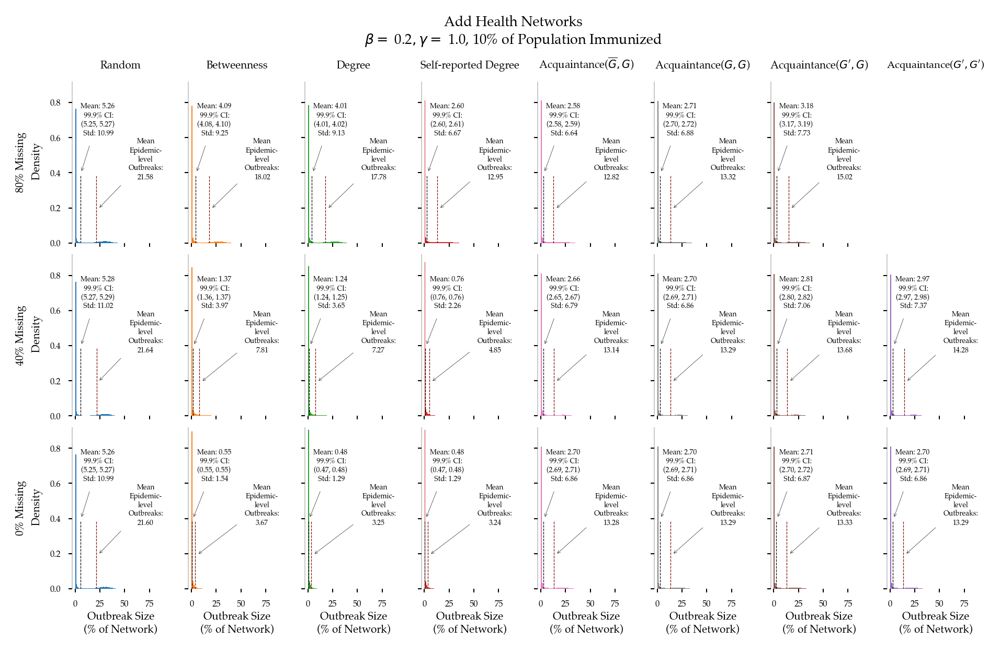

In [153]:


# Fixed Parameters
beta= 0.2
gamma=1.0
pctImmunized = .1
folderName = INDIR+"/"+'SchoolResults10_gamma1_newCode_beta02to220'
network_size = 1538
figFileName = 'distPlots_school_beta02_imnzd10'

thresh = 1.0 # 1% outbreak size


# Figure Tweaking
xlimits = (-3, 95)
ylimits = (0, 0.92)
figSize = (7.5, 4.2)

plt.rcParams["axes.grid"] = False

scale = 0.11

plt.rcParams['pdf.fonttype'] = 42
plt.rcParams["figure.dpi"] = 300.0

tickSize = 35*scale
tickMarkLength = 15*scale
tickMarkWidth = 4.2*scale
arrowWidth = 0.142
arrow_head_length=1
arrow_head_width=0.42
annotateFontSize = 30*scale
labelSize = 45*scale
meanLinesWidth = 2.69*scale
stratFontSize = 45*scale
font = {'family' : 'Palatino',
        'weight' : 'normal',
        'size'   : 36*scale}

plt.rc('font', **font)



all_filenames = [i for i in glob.glob(folderName+'/*Beta={}Gamma={}*pctsImmunized{}.csv'.format(str(beta), str(gamma), str(pctImmunized)))]

strategies = [ "RandSamp", "Bet", "DegKK",  "Srd","acqKG2_up", "acqGG2", "acqKG2", "acqKK2"]

stratNameMap = {'Rand':'Rand', 'RandSamp':'Random','Bet':'Betweenness', 'DegKK':"Degree","Srd":"Self-reported Degree", "acqKK2":"Acquaintance($G^\prime, G^\prime$)", "acqGG2":"Acquaintance($G, G$)", "acqKG2":"Acquaintance($G^\prime,G$)", "acqKG2_up":"Acquaintance($\overline{G},G$)", "No_imm":"No Immunization"}
fracsMissing = [0.8, 0.4, 0.0]

obsDF = pd.concat([pd.read_csv(f) for f in all_filenames ], sort=False)


fig, axs = plt.subplots(len(fracsMissing), len(strategies), figsize=figSize, sharex=True, sharey=True)



timesCountsToDists = []

    
for i, fracMissing in enumerate(fracsMissing):
    for j, strat in enumerate(strategies):
        
        print("strat: ", strat, " fraction missing: ", fracMissing)
        if strat == "acqKK2" and fracMissing == 0.8:
            axs[i, j].axis('off')
            if i==0:
                axs[i, j].set(title=stratNameMap[strat])

            continue
        
        
        
        obs = obsDF[(obsDF['strategy']==strat) & (obsDF['fracMissing']==fracMissing)&(obsDF['pctImmunized']==pctImmunized)&(obsDF['beta']==beta)&(obsDF['gamma']==gamma)]


        pooledOutbreaks = []
        secondMode = []
        allFinalSizeDistDicts = [ast.literal_eval(finalSizeDist) for finalSizeDist in obs['finalSizeDist']]
        
        start = time.time()
        




        #This could maybe be faster if I preallocated memory and then inserted instead of merging two lists every time
        #That would also speed up the conversion to percent because it would be vectorized
        #for net, countDict in enumerate(allFinalSizeDistDicts):        
        
        

        for countDict in allFinalSizeDistDicts:
            finalSizesForThisTrial = convertCounterToSequence(countDict)
            #pooledOutbreaks += finalSizesForThisTrial
            for finalSize in finalSizesForThisTrial:
                outbreakSize = 100*(finalSize/network_size)
                pooledOutbreaks.append(outbreakSize)

                if outbreakSize > thresh:
                    secondMode.append(outbreakSize)






        end = time.time()
        
        timesCountsToDists.append(end-start)
        print(end-start)
        
        
        
        
        
        
        print(len(pooledOutbreaks))
        mean = np.mean(pooledOutbreaks)  
        std = np.std(pooledOutbreaks)
        SEM = std /np.sqrt(len(pooledOutbreaks)) #We have such a large sample that it doesnt matter that its not normal
        conf = 3.291 * SEM # 99.9% confidence  IS THIS RIGHT? I GOT SLIGHTLY DIFFRENT CRITICAL VALUES FROM DIFFRENT WEBSITES

        
        pctAboveThresh = 100*len(secondMode)/len(pooledOutbreaks)
        
        meanEpidemic = np.mean(secondMode)  

         
        numBins = int(max(pooledOutbreaks)-min(pooledOutbreaks))
        print(numBins)
        axs[i, j].hist(pooledOutbreaks, bins=np.arange(min(pooledOutbreaks), max(pooledOutbreaks) + 1, 1), color=stratColorMap[strat], density=True)
        
        axs[i, j].axvline(mean, color='k', ls='--', linewidth=meanLinesWidth, ymax=0.42)
        axs[i, j].axvline(meanEpidemic, color='#800000', ls='--', linewidth=meanLinesWidth, ymax=0.42)

        axs[i, j].set_xlim(xlimits)
        axs[i, j].set_ylim(ylimits)
        
        axs[i, j].spines['top'].set_visible(False)
        axs[i, j].spines['right'].set_visible(False)
        axs[i, j].spines['bottom'].set_visible(False)

        axs[i, j].spines['left'].set_linewidth(0.1)
        axs[i, j].spines['left'].set_capstyle('butt')
                
        info = 'Mean: '+format(mean, '.2f')+"\n 99.9% CI:\n("+format(mean-conf, '.2f')+", "+format(mean+conf, '.2f')+")\n Std: "+format(std, '.2f')
        
        axs[i, j].annotate(info,fontsize=annotateFontSize,multialignment='center',
                           xy=(mean, .42*ylimits[1]),  xycoords='data',
                           xytext=(40, .8), textcoords='data',
                           arrowprops=dict(lw=arrowWidth, arrowstyle="->",connectionstyle="arc3"),
                           horizontalalignment='right', verticalalignment='top', annotation_clip=False
                          )

        secondInfo = 'Mean\nEpidemic-\nlevel\nOutbreaks:\n'+format(meanEpidemic, '.2f')
        

        axs[i, j].annotate(secondInfo,fontsize=annotateFontSize,multialignment='center',
                   xy=(meanEpidemic, .20*ylimits[1]),  xycoords='data',
                   xytext=(89, 0.6), textcoords='data',
                   arrowprops=dict(lw=arrowWidth, arrowstyle="->",connectionstyle="arc3"),
                   horizontalalignment='right', verticalalignment='top', annotation_clip=False
                  )

        axs[i, j].tick_params(axis='both', which='major', length= tickMarkLength,  width=0.3*tickMarkLength)
        
        axs[i, j].xaxis.set_major_locator(ticker.MultipleLocator(25))

        if i==0:
            axs[i, j].set_title(stratNameMap[strat], fontsize = stratFontSize)

        
        if i==len(fracsMissing)-1:
            axs[i, j].set_xlabel("Outbreak Size\n(% of Network)",   labelpad=10*scale, fontdict={'fontsize':labelSize})
                  
        if j==0:
            axs[i, j].set_ylabel(str(int(fracMissing*100))+"% Missing\n Density", linespacing=1.6, labelpad=30*scale, fontdict={'fontsize':labelSize})



plt.suptitle('Add Health Networks\n$\\beta=$ ' +str(beta)+ '$, \gamma=$ '+str(gamma)+ ", " + str(int(100*pctImmunized))+'% of Population Immunized', size=labelSize*1.3)
plt.subplots_adjust(hspace=0.07)
plt.savefig(OUTDIR+"/"+figFileName+'.pdf')
        
print("average time spent converting to distributions: ", np.mean(timesCountsToDists))        
plt.show()

### Supp. Fig. 14

strat:  RandSamp  fraction missing:  0.8
3.1712541580200195
10000000
strat:  Bet  fraction missing:  0.8
3.5280299186706543
10000000
strat:  DegKK  fraction missing:  0.8
3.2655231952667236
10000000
strat:  Srd  fraction missing:  0.8
3.499466896057129
10000000
strat:  acqKG2_up  fraction missing:  0.8
3.8043761253356934
10000000
strat:  acqGG2  fraction missing:  0.8
3.724539279937744
10000000
strat:  acqKG2  fraction missing:  0.8
3.2322909832000732
10000000
strat:  acqKK2  fraction missing:  0.8
strat:  RandSamp  fraction missing:  0.4
3.680572271347046
10000000
strat:  Bet  fraction missing:  0.4
3.6156771183013916
10000000
strat:  DegKK  fraction missing:  0.4
3.564563035964966
10000000
strat:  Srd  fraction missing:  0.4
3.7133419513702393
10000000
strat:  acqKG2_up  fraction missing:  0.4
3.671466112136841
10000000
strat:  acqGG2  fraction missing:  0.4
3.3672780990600586
10000000
strat:  acqKG2  fraction missing:  0.4
3.6003451347351074
10000000
strat:  acqKK2  fraction missing

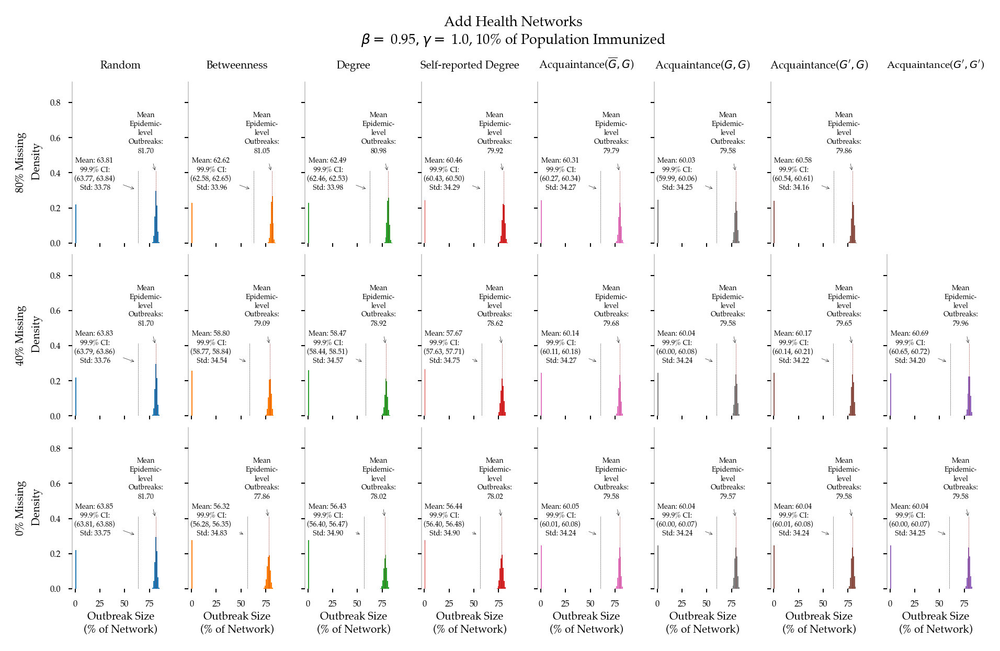

In [152]:
# Fixed Parameters
beta= 0.95
gamma=1.0
pctImmunized = .1
folderName = INDIR+"/"+'SchoolResults10_gamma1_newCode_beta02to220'
network_size = 1538
figFileName = 'distPlots_school_beta095_imnzd10'

thresh = 1.0 # 1% outbreak size


# Figure Tweaking
# Figure Tweaking
xlimits = (-3, 95)
ylimits = (0, 0.92)
figSize = (7.5, 4.2)
dfaultBins = 69
plt.rcParams["axes.grid"] = False

scale = 0.11

plt.rcParams['pdf.fonttype'] = 42
plt.rcParams["figure.dpi"] = 300.0

tickSize = 35*scale
tickMarkLength = 15*scale
tickMarkWidth = 4.2*scale
arrowWidth = 0.142
arrow_head_length=1
arrow_head_width=0.42
annotateFontSize = 30*scale
labelSize = 45*scale
meanLinesWidth = 1.1*scale
stratFontSize = 45*scale
font = {'family' : 'Palatino',
        'weight' : 'normal',
        'size'   : 36*scale}

plt.rc('font', **font)


all_filenames = [i for i in glob.glob(folderName+'/*Beta={}Gamma={}*pctsImmunized{}.csv'.format(str(beta), str(gamma), str(pctImmunized)))]

strategies = [ "RandSamp", "Bet", "DegKK",  "Srd","acqKG2_up", "acqGG2", "acqKG2", "acqKK2"]



stratNameMap = {'Rand':'Rand', 'RandSamp':'Random','Bet':'Betweenness', 'DegKK':"Degree","Srd":"Self-reported Degree", "acqKK2":"Acquaintance($G^\prime, G^\prime$)", "acqGG2":"Acquaintance($G, G$)", "acqKG2":"Acquaintance($G^\prime,G$)", "acqKG2_up":"Acquaintance($\overline{G},G$)", "No_imm":"No Immunization"}

fracsMissing = [0.8, 0.4, 0.0]





obsDF = pd.concat([pd.read_csv(f) for f in all_filenames ], sort=False)


fig, axs = plt.subplots(len(fracsMissing), len(strategies), figsize=figSize, sharex=True, sharey=True)



timesCountsToDists = []

    
for i, fracMissing in enumerate(fracsMissing):
    for j, strat in enumerate(strategies):
        
        print("strat: ", strat, " fraction missing: ", fracMissing)
        if strat == "acqKK2" and fracMissing == 0.8:
            axs[i, j].axis('off')
            if i==0:
                axs[i, j].set(title=stratNameMap[strat])

            continue
        
        
        
        obs = obsDF[(obsDF['strategy']==strat) & (obsDF['fracMissing']==fracMissing)&(obsDF['pctImmunized']==pctImmunized)&(obsDF['beta']==beta)&(obsDF['gamma']==gamma)]


        pooledOutbreaks = []
        #firstMode = []
        secondMode = []
        allFinalSizeDistDicts = [ast.literal_eval(finalSizeDist) for finalSizeDist in obs['finalSizeDist']]
        
        start = time.time()
        
        #This could maybe be faster if I preallocated memory and then inserted instead of merging two lists every time
        #That would also speed up the conversion to percent because it would be vectorized
        #for net, countDict in enumerate(allFinalSizeDistDicts):        
        
        

        for countDict in allFinalSizeDistDicts:
            finalSizesForThisTrial = convertCounterToSequence(countDict)
            for finalSize in finalSizesForThisTrial:
                outbreakSize = 100*(finalSize/network_size)
                pooledOutbreaks.append(outbreakSize)

                if outbreakSize > thresh:
                    secondMode.append(outbreakSize)


        end = time.time()
        
        timesCountsToDists.append(end-start)
        print(end-start)
                        
                
        
        print(len(pooledOutbreaks))
        mean = np.mean(pooledOutbreaks)  
        std = np.std(pooledOutbreaks)
        SEM = std /np.sqrt(len(pooledOutbreaks)) #We have such a large sample that it doesnt matter that its not normal
        conf = 3.291 * SEM # 99.9% confidence  IS THIS RIGHT? I GOT SLIGHTLY DIFFRENT CRITICAL VALUES FROM DIFFRENT WEBSITES

        
        pctAboveThresh = 100*len(secondMode)/len(pooledOutbreaks)
        
        meanEpidemic = np.mean(secondMode)  

        axs[i, j].hist(pooledOutbreaks, bins=np.arange(min(pooledOutbreaks), max(pooledOutbreaks) + 1, 1), color=stratColorMap[strat], density=True)
        
        axs[i, j].axvline(mean, color='k', ls='--', linewidth=meanLinesWidth, ymax=0.45)
        axs[i, j].axvline(meanEpidemic, color='#800000', ls='--', linewidth=meanLinesWidth, ymax=0.45)
        
        axs[i, j].set_xlim(xlimits)
        axs[i, j].set_ylim(ylimits)
        
        axs[i, j].spines['top'].set_visible(False)
        axs[i, j].spines['right'].set_visible(False)
        axs[i, j].spines['bottom'].set_visible(False)

        axs[i, j].spines['left'].set_linewidth(0.1)
        axs[i, j].spines['left'].set_capstyle('butt')
                
        info = 'Mean: '+format(mean, '.2f')+"\n 99.9% CI:\n("+format(mean-conf, '.2f')+", "+format(mean+conf, '.2f')+")\n Std: "+format(std, '.2f')
        axs[i, j].annotate(info,fontsize=annotateFontSize,multialignment='center',
                           xy=(mean, .3),  xycoords='data',
                           xytext=(40, .49), textcoords='data',
                           arrowprops=dict(lw=arrowWidth, arrowstyle="->",connectionstyle="arc3"),
                           horizontalalignment='right', verticalalignment='top', annotation_clip=False
                          )

        secondInfo = 'Mean\nEpidemic-\nlevel\nOutbreaks:\n'+format(meanEpidemic, '.2f')
        

        axs[i, j].annotate(secondInfo,fontsize=annotateFontSize,multialignment='center',
                   xy=(meanEpidemic, .39),  xycoords='data',
                   xytext=(89, 0.75), textcoords='data',
                   arrowprops=dict(lw=arrowWidth, arrowstyle="->",connectionstyle="arc3"),
                   horizontalalignment='right', verticalalignment='top', annotation_clip=False
                  )

        axs[i, j].tick_params(axis='both', which='major', length= tickMarkLength,  width=0.3*tickMarkLength)
        
        axs[i, j].xaxis.set_major_locator(ticker.MultipleLocator(25))

        if i==0:
            axs[i, j].set_title(stratNameMap[strat], fontsize = stratFontSize)

        
        if i==len(fracsMissing)-1:
            axs[i, j].set_xlabel("Outbreak Size\n(% of Network)",   labelpad=10*scale, fontdict={'fontsize':labelSize})

                  
        if j==0:
            axs[i, j].set_ylabel(str(int(fracMissing*100))+"% Missing\n Density", linespacing=1.6, labelpad=30*scale, fontdict={'fontsize':labelSize})

plt.suptitle('Add Health Networks\n$\\beta=$ ' +str(beta)+ '$, \gamma=$ '+str(gamma)+ ", " + str(int(100*pctImmunized))+'% of Population Immunized', size=labelSize*1.3)
plt.subplots_adjust(hspace=0.07)

plt.savefig(OUTDIR+"/"+figFileName+'.pdf')
print("average time spent converting to distributions: ", np.mean(timesCountsToDists))        
plt.show()

### Supp. Fig.15

strat:  RandSamp  fraction missing:  0.8
3.6259329319000244
10000000
strat:  Bet  fraction missing:  0.8
3.680058002471924
10000000
strat:  DegKK  fraction missing:  0.8
3.7258408069610596
10000000
strat:  Srd  fraction missing:  0.8
3.4417340755462646
10000000
strat:  acqKG2_up  fraction missing:  0.8
3.62109112739563
10000000
strat:  acqGG2  fraction missing:  0.8
3.6597046852111816
10000000
strat:  acqKG2  fraction missing:  0.8
3.623940944671631
10000000
strat:  acqKK2  fraction missing:  0.8
strat:  RandSamp  fraction missing:  0.4
3.5402841567993164
10000000
strat:  Bet  fraction missing:  0.4
3.7209248542785645
10000000
strat:  DegKK  fraction missing:  0.4
3.748202085494995
10000000
strat:  Srd  fraction missing:  0.4
3.706353187561035
10000000
strat:  acqKG2_up  fraction missing:  0.4
3.243825912475586
10000000
strat:  acqGG2  fraction missing:  0.4
3.9283010959625244
10000000
strat:  acqKG2  fraction missing:  0.4
3.1416149139404297
10000000
strat:  acqKK2  fraction missing: 

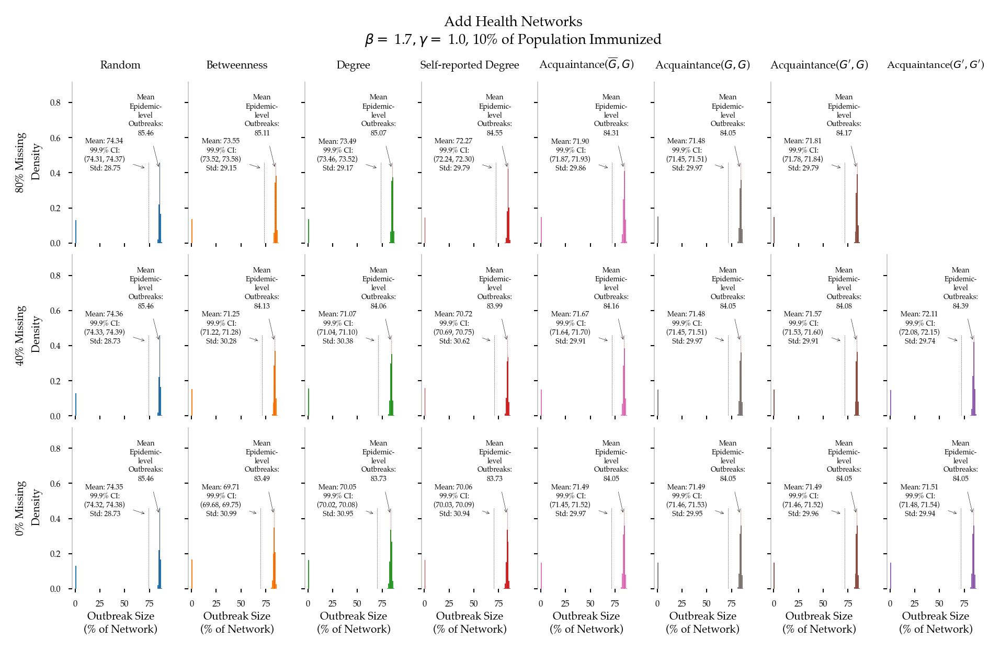

In [154]:


# Fixed Parameters
beta= 1.7
gamma=1.0
pctImmunized = .1
folderName = INDIR+"/"+'SchoolResults10_gamma1_newCode_beta02to220'
network_size = 1538
figFileName = 'distPlots_school_beta170_imnzd10'

thresh = 1.0 # 1% outbreak size


# Figure Tweaking
xlimits = (-3, 95)
ylimits = (0, 0.92)
#figSize = (69, 30)
figSize = (7.5, 4.2)

#dfaultBins = 800
#dfaultBins = int(network_size*((xlimits[1]-xlimits[0])/100)) #we want one bin for every possible outbreak size
dfaultBins = 69
plt.rcParams["axes.grid"] = False

scale = 0.11

plt.rcParams['pdf.fonttype'] = 42
plt.rcParams["figure.dpi"] = 300.0

tickSize = 35*scale
tickMarkLength = 15*scale
tickMarkWidth = 4.2*scale
arrowWidth = 0.142
arrow_head_length=1
arrow_head_width=0.42
annotateFontSize = 30*scale
labelSize = 45*scale
meanLinesWidth = 1.1*scale
stratFontSize = 45*scale
font = {'family' : 'Palatino',
        'weight' : 'normal',
        'size'   : 36*scale}

plt.rc('font', **font)

all_filenames = [i for i in glob.glob(folderName+'/*Beta={}Gamma={}*pctsImmunized{}.csv'.format(str(beta), str(gamma), str(pctImmunized)))]

strategies = [ "RandSamp", "Bet", "DegKK",  "Srd","acqKG2_up", "acqGG2", "acqKG2", "acqKK2"]



stratNameMap = {'Rand':'Rand', 'RandSamp':'Random','Bet':'Betweenness', 'DegKK':"Degree","Srd":"Self-reported Degree", "acqKK2":"Acquaintance($G^\prime, G^\prime$)", "acqGG2":"Acquaintance($G, G$)", "acqKG2":"Acquaintance($G^\prime,G$)", "acqKG2_up":"Acquaintance($\overline{G},G$)", "No_imm":"No Immunization"}
fracsMissing = [0.8, 0.4, 0.0]


obsDF = pd.concat([pd.read_csv(f) for f in all_filenames ], sort=False)


fig, axs = plt.subplots(len(fracsMissing), len(strategies), figsize=figSize, sharex=True, sharey=True)



timesCountsToDists = []

    
for i, fracMissing in enumerate(fracsMissing):
    for j, strat in enumerate(strategies):
        
        print("strat: ", strat, " fraction missing: ", fracMissing)
        if strat == "acqKK2" and fracMissing == 0.8:
            axs[i, j].axis('off')
            if i==0:
                axs[i, j].set(title=stratNameMap[strat])

            continue
        
        
        
        obs = obsDF[(obsDF['strategy']==strat) & (obsDF['fracMissing']==fracMissing)&(obsDF['pctImmunized']==pctImmunized)&(obsDF['beta']==beta)&(obsDF['gamma']==gamma)]


        pooledOutbreaks = []
        secondMode = []
        allFinalSizeDistDicts = [ast.literal_eval(finalSizeDist) for finalSizeDist in obs['finalSizeDist']]
        
        start = time.time()
        



        #This could maybe be faster if I preallocated memory and then inserted instead of merging two lists every time
        #That would also speed up the conversion to percent because it would be vectorized
        #for net, countDict in enumerate(allFinalSizeDistDicts):        
        
        

        for countDict in allFinalSizeDistDicts:
            finalSizesForThisTrial = convertCounterToSequence(countDict)
            for finalSize in finalSizesForThisTrial:
                outbreakSize = 100*(finalSize/network_size)
                pooledOutbreaks.append(outbreakSize)

                if outbreakSize > thresh:
                    secondMode.append(outbreakSize)
                    












        end = time.time()
        
        timesCountsToDists.append(end-start)
        print(end-start)
        
        
        
        
        

        
        
        print(len(pooledOutbreaks))
        mean = np.mean(pooledOutbreaks)  
        std = np.std(pooledOutbreaks)
        SEM = std /np.sqrt(len(pooledOutbreaks)) #We have such a large sample that it doesnt matter that its not normal
        conf = 3.291 * SEM # 99.9% confidence  IS THIS RIGHT? I GOT SLIGHTLY DIFFRENT CRITICAL VALUES FROM DIFFRENT WEBSITES

        
        pctAboveThresh = 100*len(secondMode)/len(pooledOutbreaks)
        
        meanEpidemic = np.mean(secondMode)  

                
        axs[i, j].hist(pooledOutbreaks, bins=np.arange(min(pooledOutbreaks), max(pooledOutbreaks) + 1, 1), color=stratColorMap[strat], density=True)
        
        axs[i, j].axvline(mean, color='k', ls='--', linewidth=meanLinesWidth, ymax=0.5, alpha=0.9,)
        axs[i, j].axvline(meanEpidemic, color='#800000', ls='--', linewidth=meanLinesWidth, ymax=0.5, alpha=0.9)

        axs[i, j].set_xlim(xlimits)
        axs[i, j].set_ylim(ylimits)
        
        axs[i, j].spines['top'].set_visible(False)
        axs[i, j].spines['right'].set_visible(False)
        axs[i, j].spines['bottom'].set_visible(False)

        axs[i, j].spines['left'].set_linewidth(0.1)
        axs[i, j].spines['left'].set_capstyle('butt')
        
        
        
        
        info = 'Mean: '+format(mean, '.2f')+"\n 99.9% CI:\n("+format(mean-conf, '.2f')+", "+format(mean+conf, '.2f')+")\n Std: "+format(std, '.2f')
        
        axs[i, j].annotate(info,fontsize=annotateFontSize,multialignment='center',
                           xy=(mean, .42),  xycoords='data',
                           xytext=(50, .6), textcoords='data',
                           arrowprops=dict(lw=arrowWidth, arrowstyle="->",connectionstyle="arc3"),
                           horizontalalignment='right', verticalalignment='top', annotation_clip=False
                          )

        secondInfo = 'Mean\nEpidemic-\nlevel\nOutbreaks:\n'+format(meanEpidemic, '.2f')
        

        axs[i, j].annotate(secondInfo,fontsize=annotateFontSize,multialignment='center',
                   xy=(meanEpidemic, .41),  xycoords='data',
                   xytext=(89, 0.85), textcoords='data',
                   arrowprops=dict(lw=arrowWidth, arrowstyle="->",connectionstyle="arc3"),
                   horizontalalignment='right', verticalalignment='top', annotation_clip=False
                  )

        axs[i, j].tick_params(axis='both', which='major', length= tickMarkLength,  width=0.3*tickMarkLength)
        
        axs[i, j].xaxis.set_major_locator(ticker.MultipleLocator(25))

        if i==0:
            axs[i, j].set_title(stratNameMap[strat], fontsize = stratFontSize)

        
        if i==len(fracsMissing)-1:
            axs[i, j].set_xlabel("Outbreak Size\n(% of Network)",   labelpad=10*scale, fontdict={'fontsize':labelSize})
            

                  
        if j==0:
            axs[i, j].set_ylabel(str(int(fracMissing*100))+"% Missing\n Density", linespacing=1.6, labelpad=30*scale, fontdict={'fontsize':labelSize})



plt.suptitle('Add Health Networks\n$\\beta=$ ' +str(beta)+ '$, \gamma=$ '+str(gamma)+ ", " + str(int(100*pctImmunized))+'% of Population Immunized', size=labelSize*1.3)
plt.subplots_adjust(hspace=0.07)

plt.savefig(OUTDIR+"/"+figFileName+'.pdf')
        
print("average time spent converting to distributions: ", np.mean(timesCountsToDists))        
plt.show()

## Section 2.3: Full Parameeter Space for Networks in the Main Tex

In [174]:
#preamble
plt.rcParams['text.usetex'] = True
plt.rcParams.update({'font.size': 8})

# This one got changed during the distribution plots
stratNameMap = { 'RandSamp':'Rand','Bet':'Bet', 'DegKK':"Deg","Srd":"S.R.D.", "acqKK2":"Acq($G^\prime, G^\prime$)", "acqGG2":"Acq($G, G$)", "acqKG2":"Acq($G^\prime,G$)", "acqKG2_up":"Acq($\overline{G},G$)"}



In [175]:
# For the parameter sweeeps we need smaller, tighter versions of the kind of main figures we have been showing
# to use as subplots

from matplotlib.transforms import Transform
from matplotlib.ticker import (
    AutoLocator, AutoMinorLocator)

def makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation_subplot(figFileName ,  folderName , title,  legendLoc, yLims, beta , gamma, pctImmunized, text_y='auto',text_x='auto', extension='.pdf' ):

    
    
    all_filenames = [i for i in glob.glob(INDIR+"/"+folderName+'/*Beta={}Gamma={}*pctsImmunized{}.csv'.format(str(beta), str(gamma), str(pctImmunized)))]
    
    obsDF = pd.concat([pd.read_csv(f, usecols = ['strategy', 'fracMissing', 'pctImmunized', 'beta',  'gamma', 'pctTotalPopInf', 'R0_empirical']) for f in all_filenames ], sort=False)
     
    obsDFmean = obsDF.groupby(['strategy', 'fracMissing', 'pctImmunized', 'beta', 'gamma'], as_index=False).mean()

    randObs =  obsDFmean.loc[(obsDFmean['strategy']=="RandSamp")&(obsDFmean['pctImmunized']==pctImmunized)&(obsDFmean['beta']==beta)&(obsDFmean['gamma']==gamma)]
    randDist = randObs['pctTotalPopInf'].values
    randMean = 100*np.mean(randDist)
    
    noImmObs =  obsDFmean.loc[(obsDFmean['strategy']=="No_imm")&(obsDFmean['pctImmunized']==pctImmunized)&(obsDFmean['beta']==beta)&(obsDFmean['gamma']==gamma)]
    noImmDist = noImmObs['pctTotalPopInf'].values
    noImmMean = 100*np.mean(noImmDist) #Pool these to get a more accurate value for no_immunization
    
    
    R0_emp = float(np.mean(obsDF['R0_empirical'].values))


    
    print("Mean Pct Infected with No Immunization: ", format(noImmMean, '0.2f'))
    print("Mean Pct Infected with Random Immunization: ", format(randMean, '0.2f'))
    print("Mean R0: ",format(R0_emp, '0.2f'))


    strategies = [ "Bet",   "DegKK",      "Srd" ,      "acqKK2", "acqKG2", "acqKG2_up", "acqGG2"]

    
    for strat in strategies:
            totalTrials = len(obsDF.loc[(obsDF['strategy']==strat)&(obsDF['fracMissing']==0.0)&(obsDF['pctImmunized']==pctImmunized)&(obsDF['beta']==beta)&(obsDF['gamma']==gamma)])
    
    myAx=plt.gca()


    
    minLineAboveText = 9999 #start with a big number
    for i, strat in enumerate(strategies):

        relevantObs = obsDFmean.loc[(obsDFmean['strategy']==strat)&(obsDFmean['pctImmunized']==pctImmunized)&(obsDFmean['beta']==beta)&(obsDFmean['gamma']==gamma)]
        print(len(relevantObs))
        x = list(100*relevantObs['fracMissing'].values)
        pctInf  = list(relevantObs['pctTotalPopInf'].values) #make this a list to make it easy to slice for the next thing

        if strat == "acqKK2" and pctImmunized==0.1:
            x = x[0:8]
            pctInf = pctInf[0:8]
            
        y = [randMean - 100*pctInf[j] for j in range(len(pctInf))]
        
        if y[1] < minLineAboveText:
            minLineAboveText = y[1]

        
        

        lines = myAx.plot(x,y,'-o', markersize=3.6, marker=stratMarkerMap[strat], label=stratNameMap[strat], alpha=0.5, linewidth=1, color=stratColorMap[strat])

        
    if text_y == 'auto':
        text_y = 0.75*minLineAboveText  #Put the text between 0 and the first line above it
    
    
    if text_x == 'auto':
        
        text_x = 0.29*x[-1]  #Put the text between 0 and the first line above it

    
    
    myAx.axhline(0, color=stratColorMap["RandSamp"], ls='--', linewidth=1, alpha=0.69)
    

    
    
        
        
        
    plt.title(title, fontsize=8)
#    plt.title(title + "\n Outbreak Size with Random Immunization: "+str(format(100*randMean, '.2f'))+"\n Outbreak Size with No Immunization: "+str(format(100*noImmMean, '.2f'))) #In all these alternate nets they are getting 5% immunization so no need to put it in the title, better in the caption
#     plt.xlim(-0.9, 85)
    
    

    #plt.xlim(-0.02*x[-1], x[-1]*1.02)
    plt.xlim(-1.5, 81.5)
    
    
    if yLims != None:
        plt.ylim(*yLims)
    
    
    if pctImmunized==0.15:
        plt.xlabel(r"Percent of Nodes Missing From Sample",  fontsize=8)
    if beta == 0.2:
        plt.ylabel('$\Delta$ in Outbreak Size vs Random Immunization',  fontsize=8)


    
    plt.legend(fancybox=True, ncol=2, loc=legendLoc, columnspacing=-1.42, prop={'size': 6})
    
    
    
    
    
    
    
    def pctReduction2raw(pctReduction):
        return randMean - pctReduction


    def raw2pctReduction(raw):
        return  randMean - raw

    secax = myAx.secondary_yaxis('right', functions=(pctReduction2raw, raw2pctReduction))
    
    if beta==1.7:
        secax.set_ylabel('Mean Outbreak Size (\% of Population)', rotation=270, labelpad=17, fontsize=8)


## 2.3.1  Low Transitivity Colorado Springs Networks Param Sweeps

### Supp. Fig. 16

Mean Pct Infected with No Immunization:  20.63
Mean Pct Infected with Random Immunization:  17.93
Mean R0:  3.48
9
9
9
9
9
9
9
Mean Pct Infected with No Immunization:  65.88
Mean Pct Infected with Random Immunization:  60.77
Mean R0:  6.98
9
9
9
9
9
9
9
Mean Pct Infected with No Immunization:  77.70
Mean Pct Infected with Random Immunization:  72.10
Mean R0:  7.79
9
9
9
9
9
9
9
Mean Pct Infected with No Immunization:  20.62
Mean Pct Infected with Random Immunization:  15.41
Mean R0:  3.49
9
9
9
8
9
9
9
Mean Pct Infected with No Immunization:  65.88
Mean Pct Infected with Random Immunization:  55.70
Mean R0:  6.98
9
9
9
8
9
9
9
Mean Pct Infected with No Immunization:  77.71
Mean Pct Infected with Random Immunization:  66.53
Mean R0:  7.79
9
9
9
8
9
9
9
Mean Pct Infected with No Immunization:  20.63
Mean Pct Infected with Random Immunization:  13.04
Mean R0:  3.48
9
9
9
7
9
9
9
Mean Pct Infected with No Immunization:  65.89
Mean Pct Infected with Random Immunization:  50.72
Mean R0:  6.9

<function matplotlib.pyplot.show(*args, **kw)>

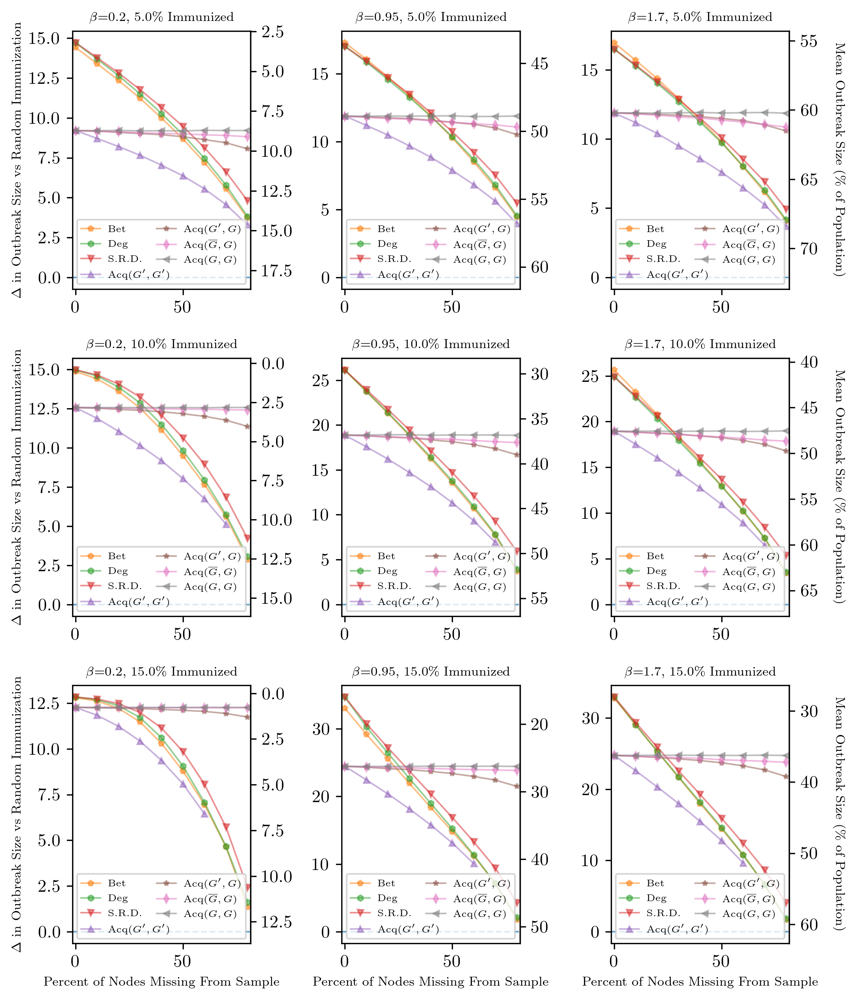

In [198]:


pctsImmunized = [0.05, 0.1, 0.15]
betas = [0.2, 0.95, 1.7]
gamma = 1
folders=['allLowResults5and15', 'newLowResults_gamma1_beta20to220']


fig, axes = plt.subplots(nrows=len(betas), ncols=len(pctsImmunized), figsize=(7.5, 8.75))

axs = []


plotNum = 1
for p, pctImmunized in enumerate(pctsImmunized):
    for b, beta in enumerate(betas):
        if pctImmunized in {0.05, 0.15}:
            folder = folders[0]
        else:
            folder = folders[1]
        
        subplotNum = plotNum
        plt.subplot(len(pctsImmunized), len(betas), subplotNum)
        makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation_subplot(figFileName = None,
                         beta=beta,
                         gamma=gamma,
                         folderName= folder,
                         title=r'$\beta$='+str(beta)+", "+str(100*pctImmunized)+"\% Immunized",
                         legendLoc="lower left",
                         yLims = None,
                         pctImmunized = pctImmunized)
        
        plotNum +=1

fig.tight_layout()

plt.savefig(OUTDIR+"/"+'lowParamSweep.pdf')
plt.show



### Supp. Fig. 17

Mean Pct Infected with No Immunization:  20.62
Mean Pct Infected with Random Immunization:  15.41
Mean R0:  3.49
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


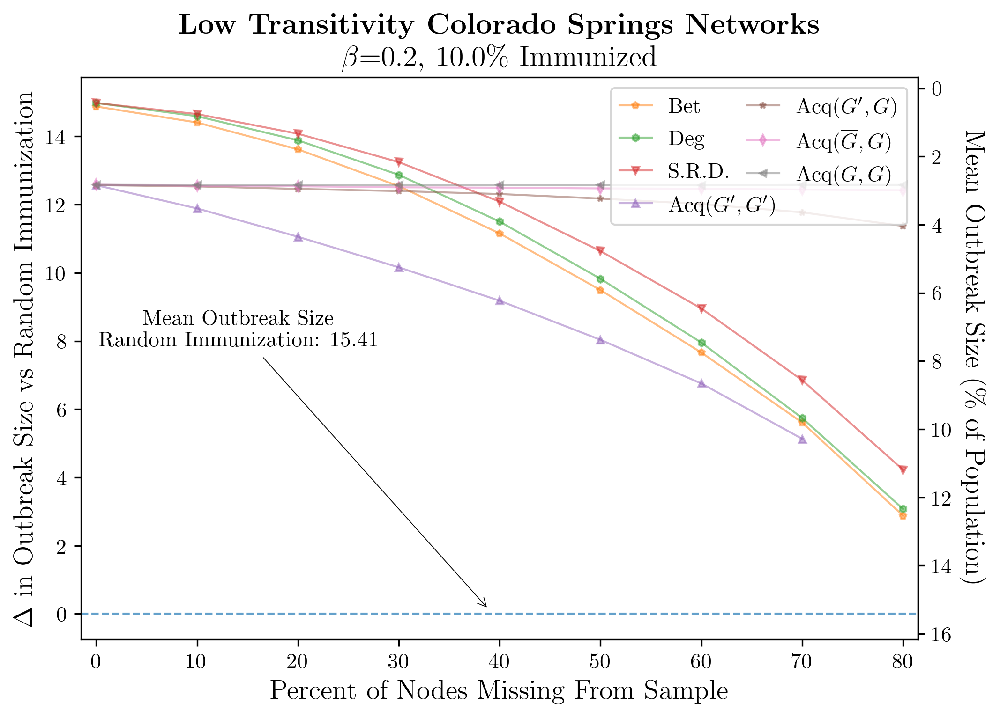

Mean Pct Infected with No Immunization:  45.67
Mean Pct Infected with Random Immunization:  37.37
Mean R0:  5.48
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


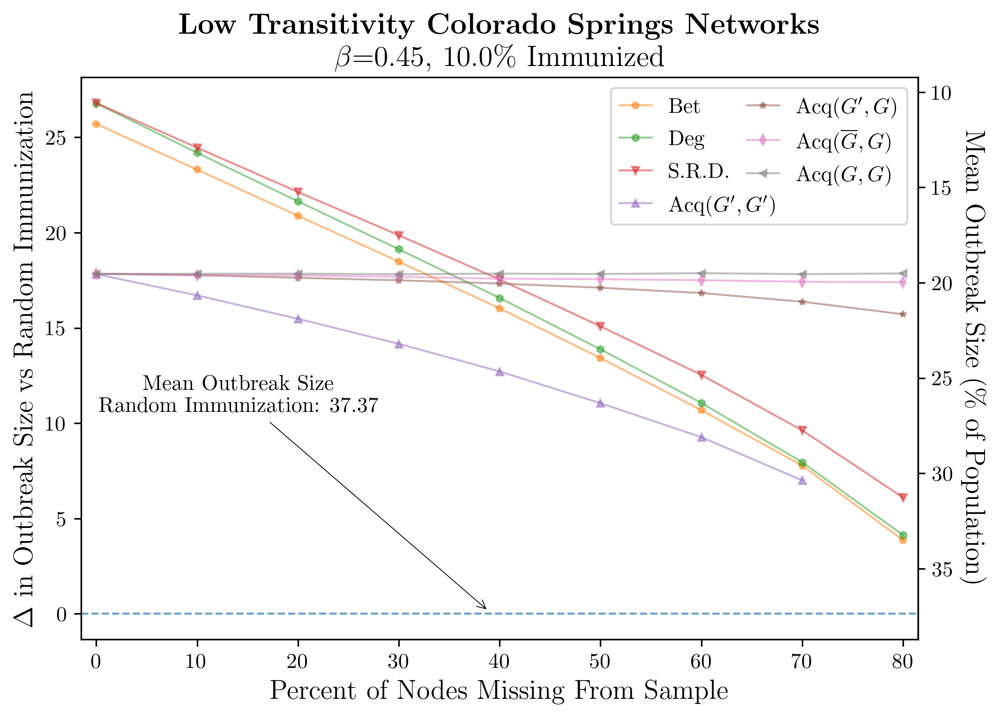

Mean Pct Infected with No Immunization:  58.25
Mean Pct Infected with Random Immunization:  48.74
Mean R0:  6.43
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


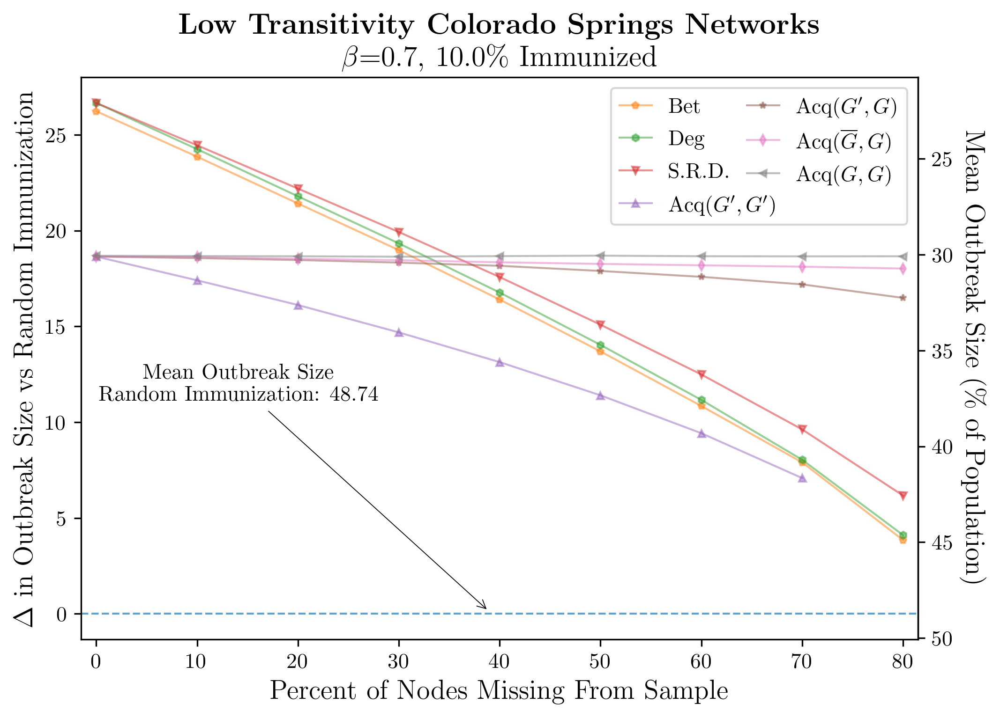

Mean Pct Infected with No Immunization:  65.88
Mean Pct Infected with Random Immunization:  55.70
Mean R0:  6.98
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


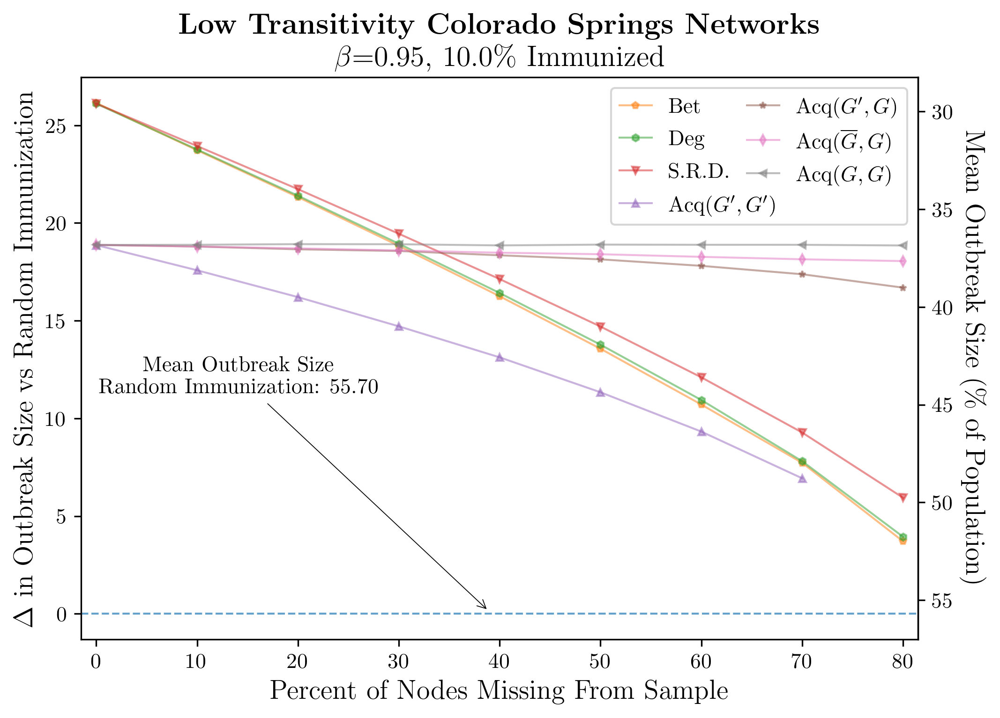

Mean Pct Infected with No Immunization:  71.06
Mean Pct Infected with Random Immunization:  60.44
Mean R0:  7.34
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


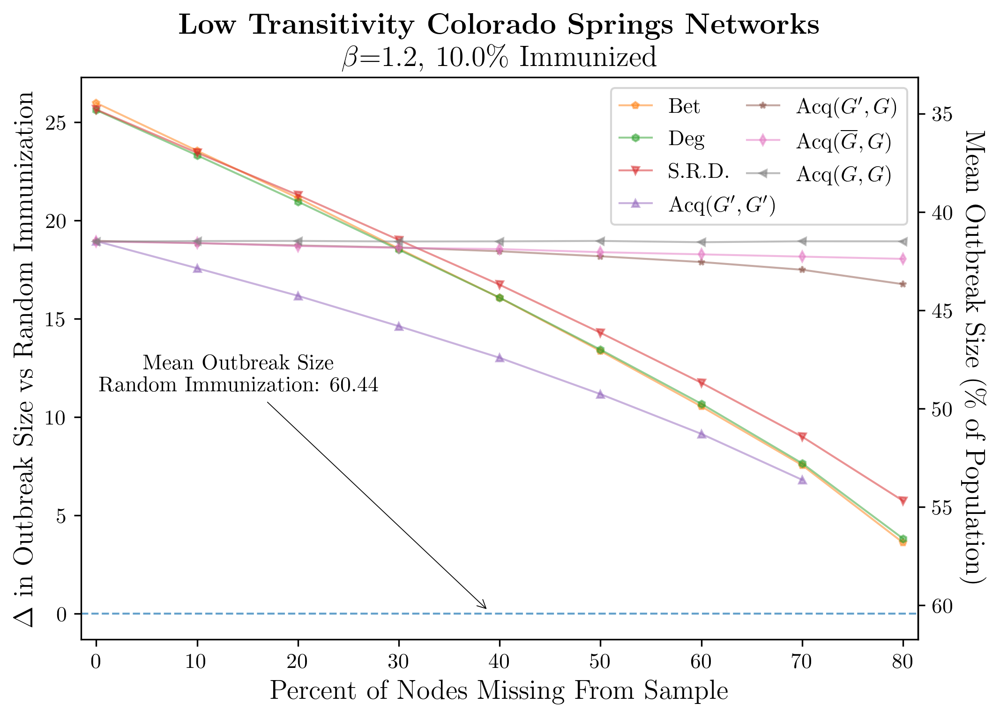

Mean Pct Infected with No Immunization:  74.83
Mean Pct Infected with Random Immunization:  63.89
Mean R0:  7.61
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


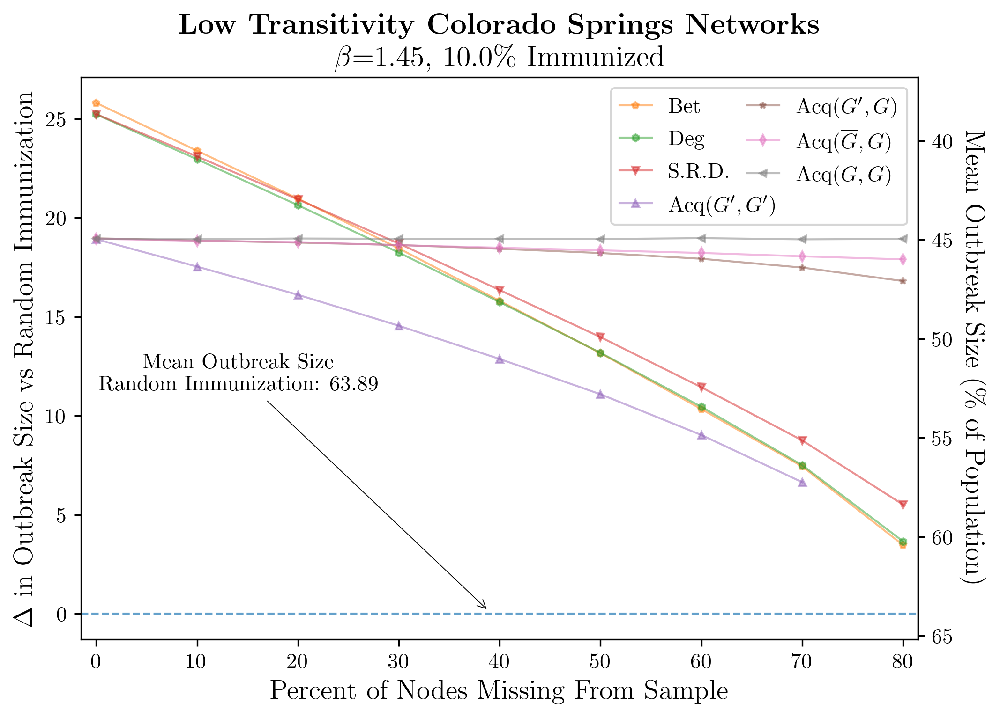

Mean Pct Infected with No Immunization:  77.71
Mean Pct Infected with Random Immunization:  66.53
Mean R0:  7.79
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


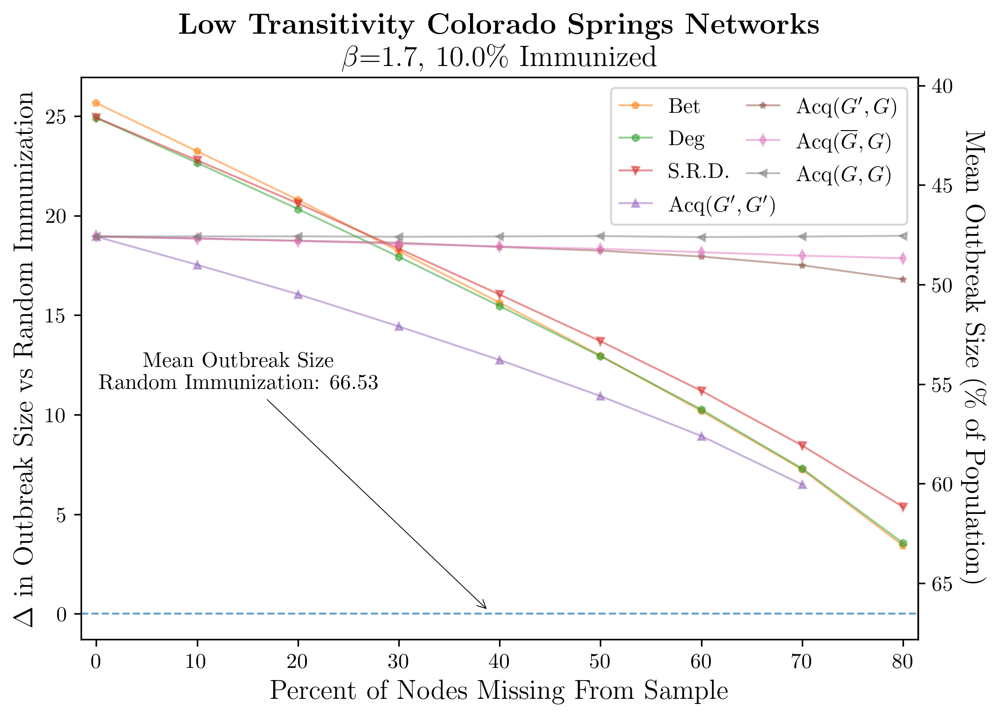

In [178]:

betas = [0.2, 0.45, 0.7, 0.95, 1.2, 1.45, 1.7]
arrowWidth = 0.42
gamma = 1.0
pctImmunized = 0.1
ylims =  None


suptitle = "Low Transitivity Colorado Springs Networks"
folder = 'newLowResults_gamma1_beta20to220'
netType = 'low'

for beta in betas:
    
    figFileName = "sweep"+netType+"_Gamma"+pointify(gamma)+"_Beta"+pointify(beta)+"_pctImmunized"+pointify(100*pctImmunized)
    

    makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation(figFileName = figFileName,
                             beta=beta,
                             gamma=gamma,
                             folderName= folder,
                             title='\\textbf{'+suptitle+'}\n $\\beta$='+str(beta)+', '+str(100*pctImmunized)+'\% Immunized',
                             legendLoc="upper right",
                             yLims = ylims, 
                             pctImmunized = pctImmunized)


### Section 2.3.2 Medium Transitivity Colorado Springs Networks

### Supp. Fig 18

Mean Pct Infected with No Immunization:  17.41
Mean Pct Infected with Random Immunization:  15.10
Mean R0:  2.91
9
9
9
9
9
9
9
Mean Pct Infected with No Immunization:  58.12
Mean Pct Infected with Random Immunization:  53.36
Mean R0:  4.84
9
9
9
9
9
9
9
Mean Pct Infected with No Immunization:  70.02
Mean Pct Infected with Random Immunization:  64.68
Mean R0:  5.15
9
9
9
9
9
9
9
Mean Pct Infected with No Immunization:  17.42
Mean Pct Infected with Random Immunization:  12.97
Mean R0:  2.91
9
9
9
8
9
9
9
Mean Pct Infected with No Immunization:  58.12
Mean Pct Infected with Random Immunization:  48.66
Mean R0:  4.85
9
9
9
8
9
9
9
Mean Pct Infected with No Immunization:  70.02
Mean Pct Infected with Random Immunization:  59.37
Mean R0:  5.15
9
9
9
8
9
9
9
Mean Pct Infected with No Immunization:  17.41
Mean Pct Infected with Random Immunization:  10.96
Mean R0:  2.91
9
9
9
7
9
9
9
Mean Pct Infected with No Immunization:  58.13
Mean Pct Infected with Random Immunization:  44.09
Mean R0:  4.8

<function matplotlib.pyplot.show(*args, **kw)>

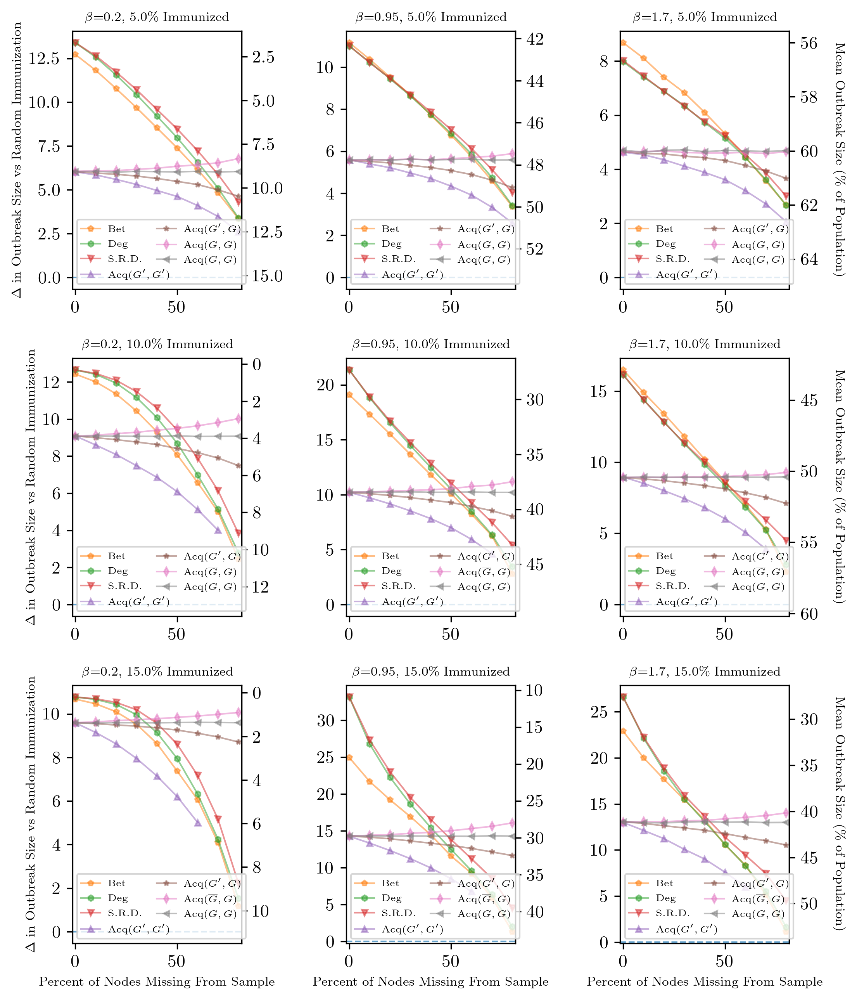

In [181]:
pctsImmunized = [0.05, 0.1, 0.15]
betas = [0.2, 0.95, 1.7]
gamma = 1
folders=['allMedResults5and15', 'newMedResults_gamma1_beta20to220']

#title = 'Medium Clustering Parameter Sweep'


fig, axes = plt.subplots(nrows=len(betas), ncols=len(pctsImmunized), figsize=(7.5, 8.75))

axs = []


plotNum = 1
for p, pctImmunized in enumerate(pctsImmunized):
    for b, beta in enumerate(betas):
        if pctImmunized in {0.05, 0.15}:
            folder = folders[0]
        else:
            folder = folders[1]
        
        subplotNum = plotNum
        plt.subplot(len(pctsImmunized), len(betas), subplotNum)
        makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation_subplot(figFileName = None,
                         beta=beta,
                         gamma=gamma,
                         folderName= folder,
                         title=r'$\beta$='+str(beta)+", "+str(100*pctImmunized)+"\% Immunized",
                         legendLoc="lower left",
                         yLims = None,
                         pctImmunized = pctImmunized)
        
        plotNum +=1

fig.tight_layout()



plt.savefig(OUTDIR+'/medParamSweep.pdf')
plt.show


### Supp. Fig. 19

Mean Pct Infected with No Immunization:  17.42
Mean Pct Infected with Random Immunization:  12.97
Mean R0:  2.91
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


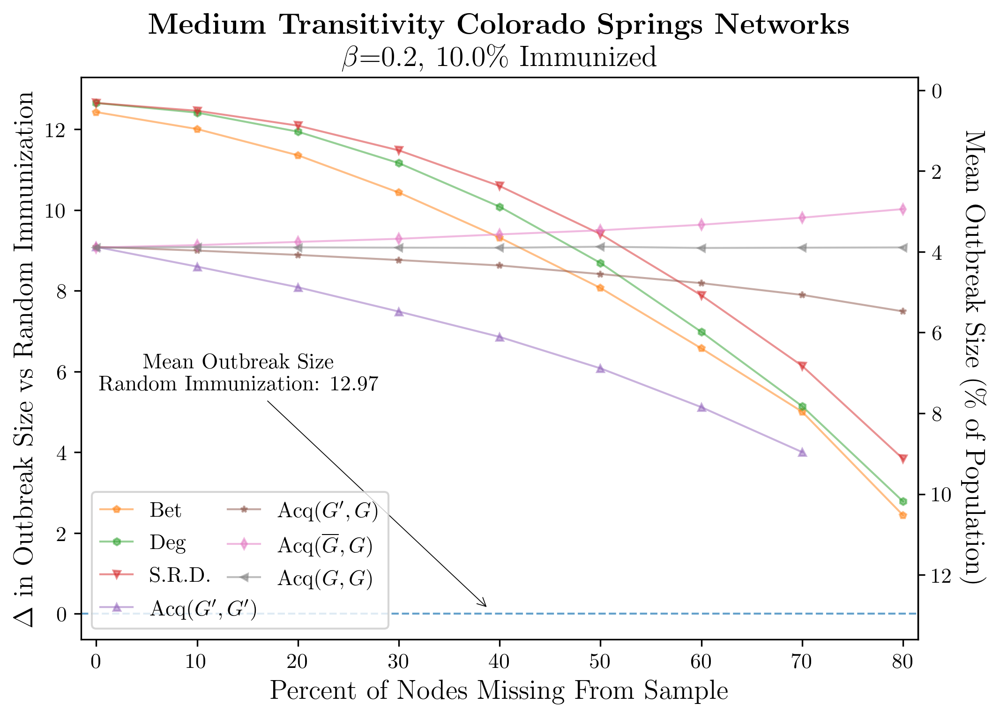

Mean Pct Infected with No Immunization:  39.08
Mean Pct Infected with Random Immunization:  31.71
Mean R0:  4.13
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


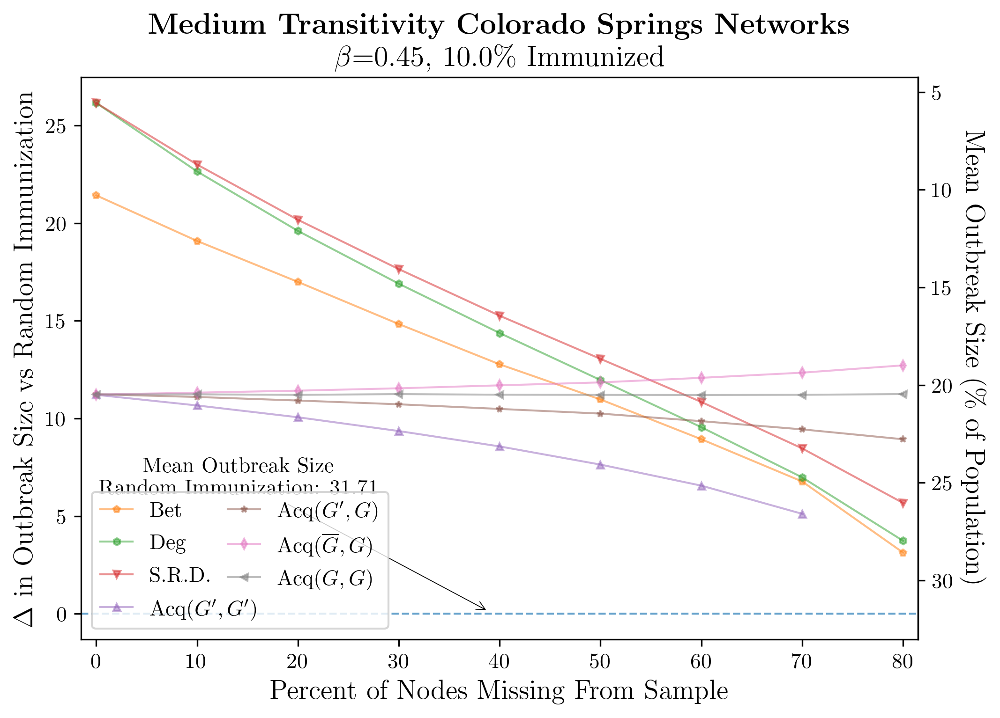

Mean Pct Infected with No Immunization:  50.74
Mean Pct Infected with Random Immunization:  42.07
Mean R0:  4.60
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


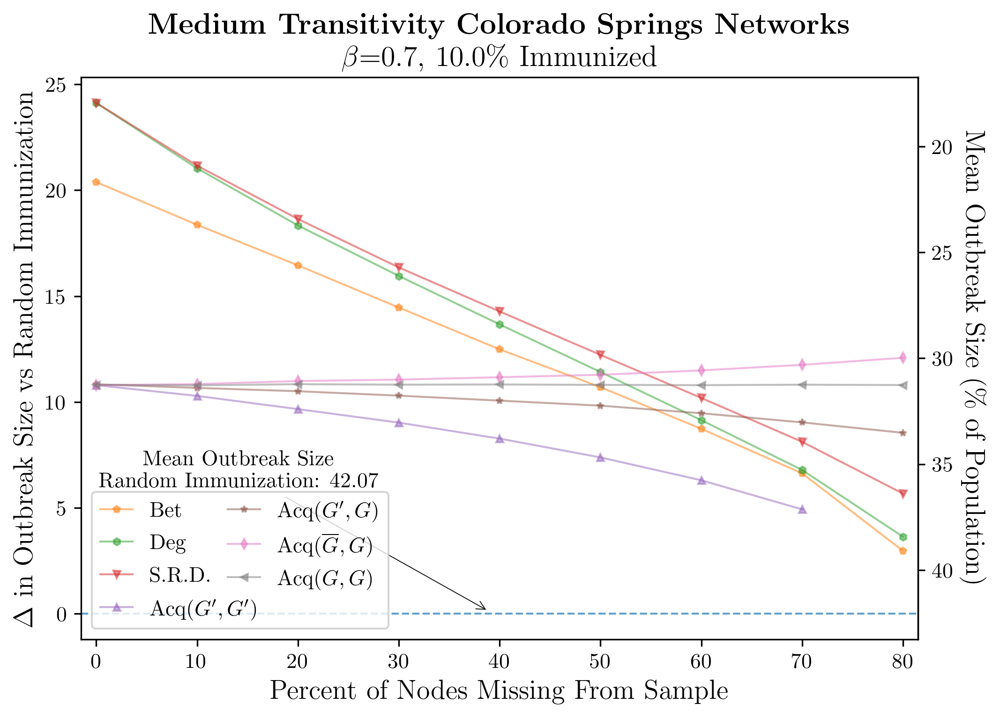

Mean Pct Infected with No Immunization:  58.12
Mean Pct Infected with Random Immunization:  48.66
Mean R0:  4.85
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


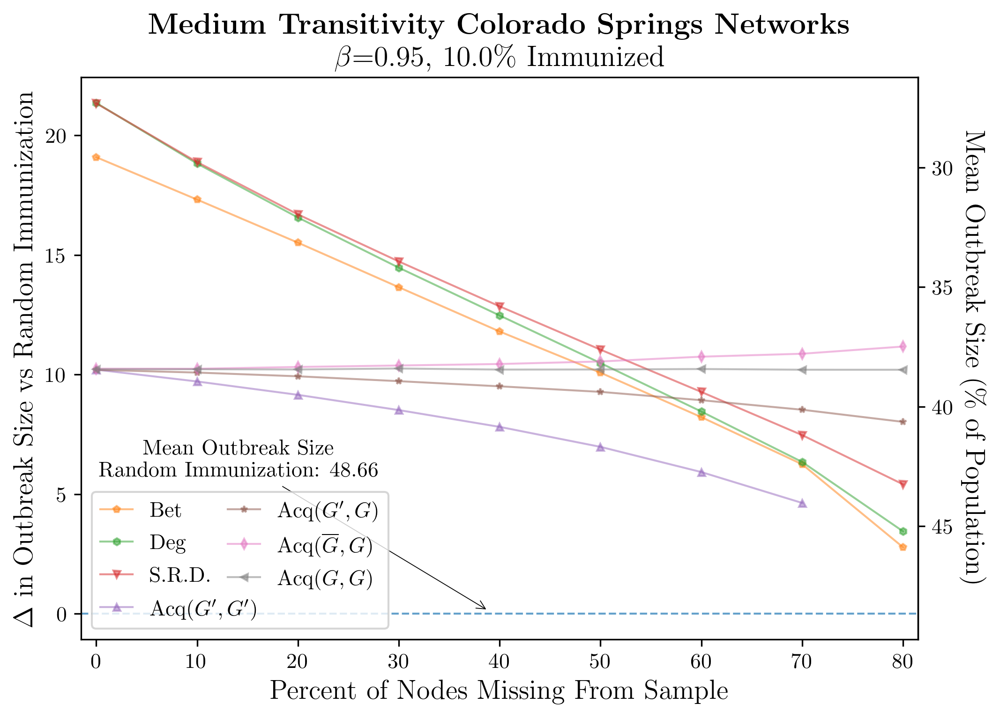

Mean Pct Infected with No Immunization:  63.28
Mean Pct Infected with Random Immunization:  53.29
Mean R0:  4.99
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


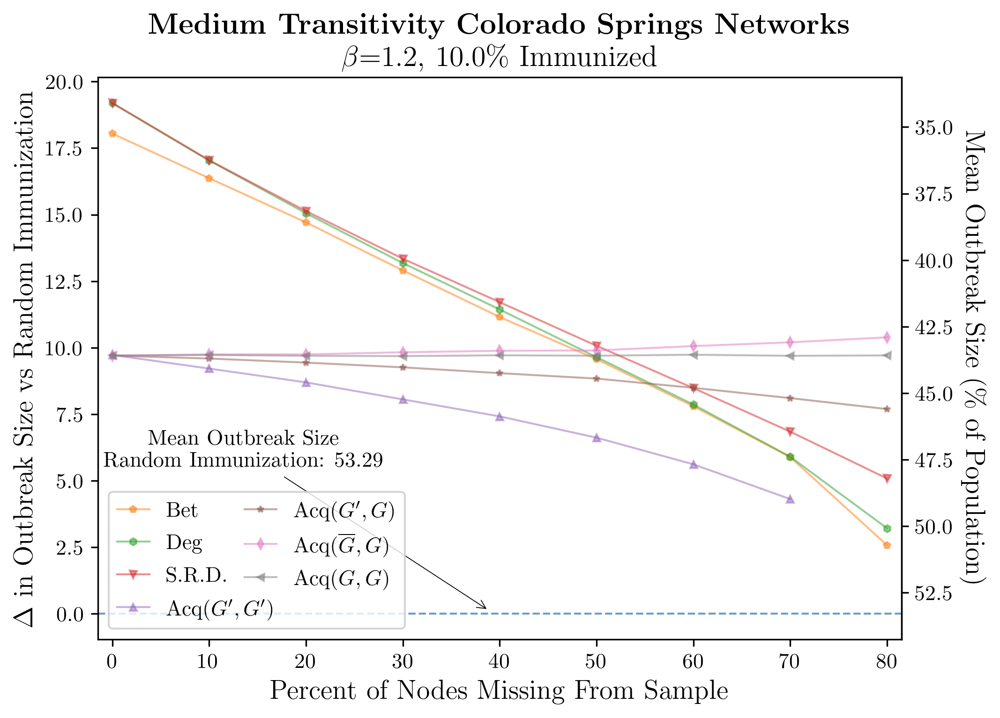

Mean Pct Infected with No Immunization:  67.09
Mean Pct Infected with Random Immunization:  56.72
Mean R0:  5.09
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


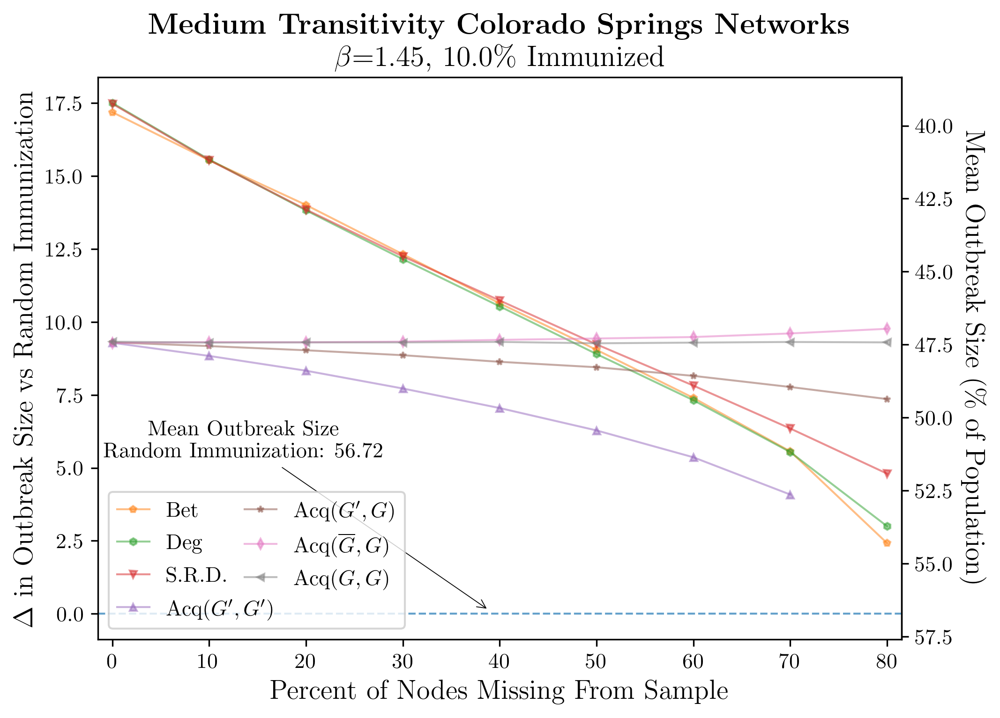

Mean Pct Infected with No Immunization:  70.02
Mean Pct Infected with Random Immunization:  59.37
Mean R0:  5.15
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


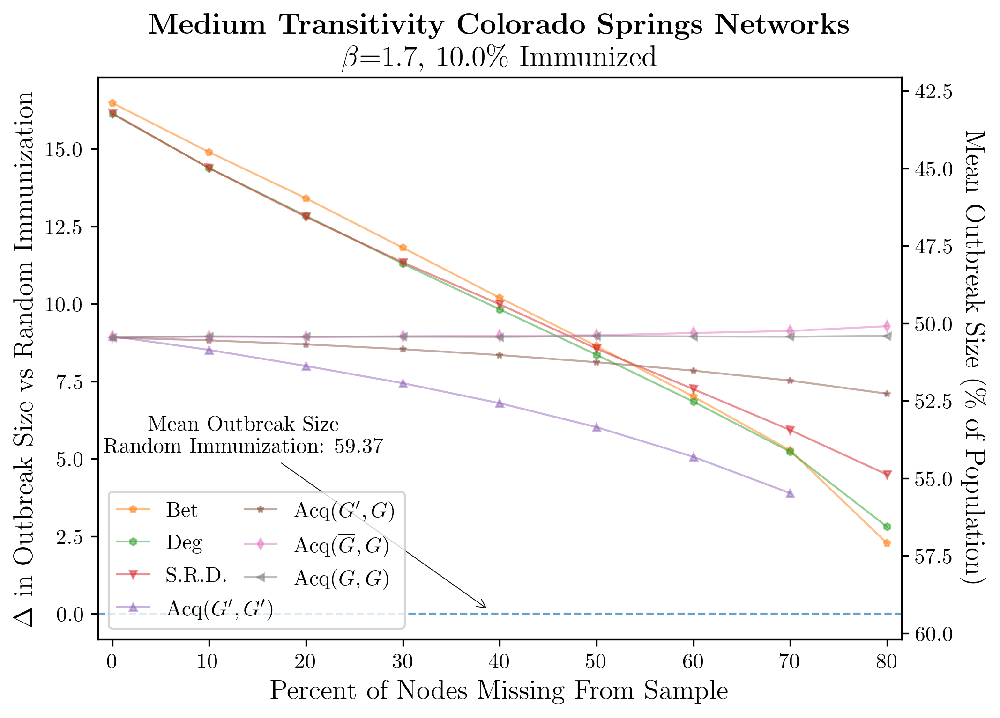

In [182]:
betas = [0.2, 0.45, 0.7, 0.95, 1.2, 1.45, 1.7]
arrowWidth = 0.42
gamma = 1.0
pctImmunized = 0.1
ylims =  None


suptitle = "Medium Transitivity Colorado Springs Networks"
folder = 'newMedResults_gamma1_beta20to220'
netType = 'med'

for beta in betas:
    
    figFileName = "sweep"+netType+"_Gamma"+pointify(gamma)+"_Beta"+pointify(beta)+"_pctImmunized"+pointify(100*pctImmunized)
    

    makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation(figFileName = figFileName,
                             beta=beta,
                             gamma=gamma,
                             folderName= folder,
                             title='\\textbf{'+suptitle+'}\n $\\beta$='+str(beta)+', '+str(100*pctImmunized)+'\% Immunized',
                             legendLoc="lower left",
                             yLims = ylims, 
                             pctImmunized = pctImmunized)


### Section 2.3.3: High Transitivity Colorado Springs Networks

### Supp. Fig. 20

Mean Pct Infected with No Immunization:  14.63
Mean Pct Infected with Random Immunization:  12.47
Mean R0:  2.81
9
9
9
9
9
9
9
Mean Pct Infected with No Immunization:  52.58
Mean Pct Infected with Random Immunization:  48.11
Mean R0:  4.64
9
9
9
9
9
9
9
Mean Pct Infected with No Immunization:  61.91
Mean Pct Infected with Random Immunization:  57.07
Mean R0:  4.94
9
9
9
9
9
9
9
Mean Pct Infected with No Immunization:  14.64
Mean Pct Infected with Random Immunization:  10.49
Mean R0:  2.81
9
9
9
8
9
9
9
Mean Pct Infected with No Immunization:  52.58
Mean Pct Infected with Random Immunization:  43.65
Mean R0:  4.64
9
9
9
8
9
9
9
Mean Pct Infected with No Immunization:  61.91
Mean Pct Infected with Random Immunization:  52.28
Mean R0:  4.95
9
9
9
8
9
9
9
Mean Pct Infected with No Immunization:  14.64
Mean Pct Infected with Random Immunization:  8.66
Mean R0:  2.81
9
9
9
7
9
9
9
Mean Pct Infected with No Immunization:  52.58
Mean Pct Infected with Random Immunization:  39.26
Mean R0:  4.64

<function matplotlib.pyplot.show(*args, **kw)>

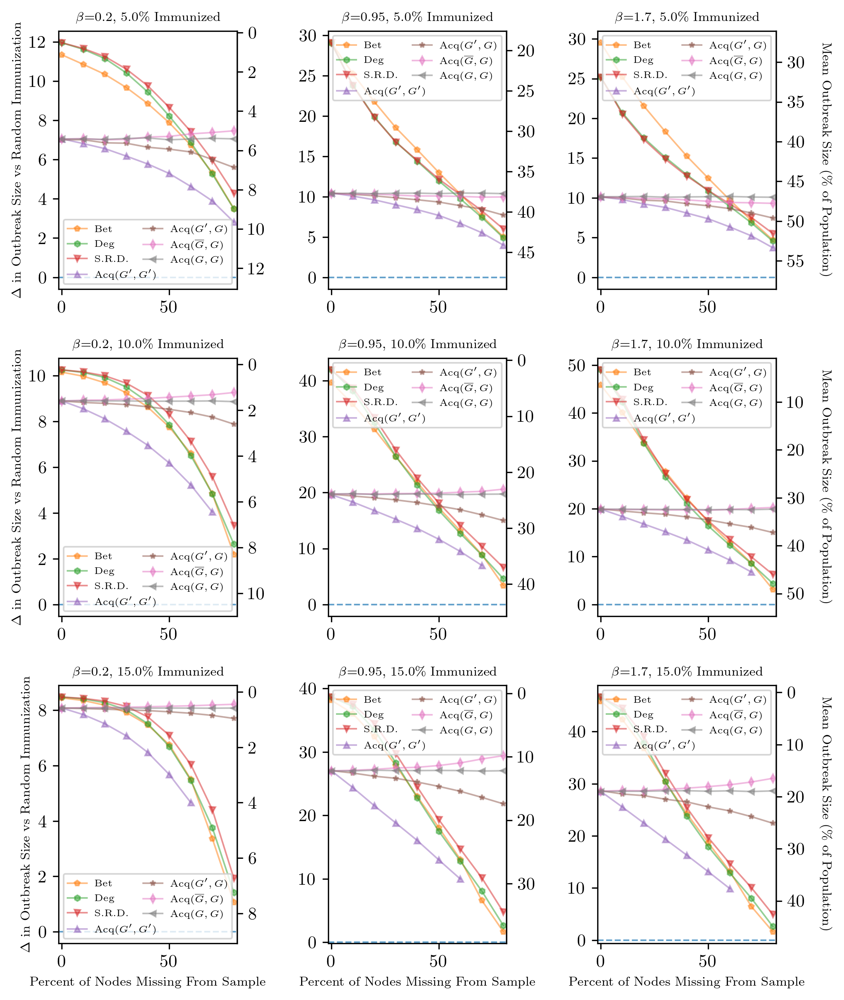

In [183]:
pctsImmunized = [0.05, 0.1, 0.15]
betas = [0.2, 0.95, 1.7]
gamma = 1
folders=['allHighResults5and15', 'newHighResults_gamma1_beta20to220']

fig, axes = plt.subplots(nrows=len(betas), ncols=len(pctsImmunized), figsize=(7.5, 8.75))

axs = []


plotNum = 1
for p, pctImmunized in enumerate(pctsImmunized):
    for b, beta in enumerate(betas):
        if pctImmunized in {0.05, 0.15}:
            folder = folders[0]
        else:
            folder = folders[1]
        
        subplotNum = plotNum
        if beta == 0.2:
            legendLoc="lower left"
        else:
            legendLoc="upper right"
        plt.subplot(len(pctsImmunized), len(betas), subplotNum)
        makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation_subplot(figFileName = None,
                         beta=beta,
                         gamma=gamma,
                         folderName= folder,
                         title=r'$\beta$='+str(beta)+", "+str(100*pctImmunized)+"\% Immunized",
                         legendLoc=legendLoc,
                         yLims = None,
                         pctImmunized = pctImmunized)
        
        plotNum +=1

fig.tight_layout()

plt.savefig(OUTDIR+'/highParamSweep_test.pdf')
plt.show




### Supp. Fig 21

Mean Pct Infected with No Immunization:  14.64
Mean Pct Infected with Random Immunization:  10.49
Mean R0:  2.81
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


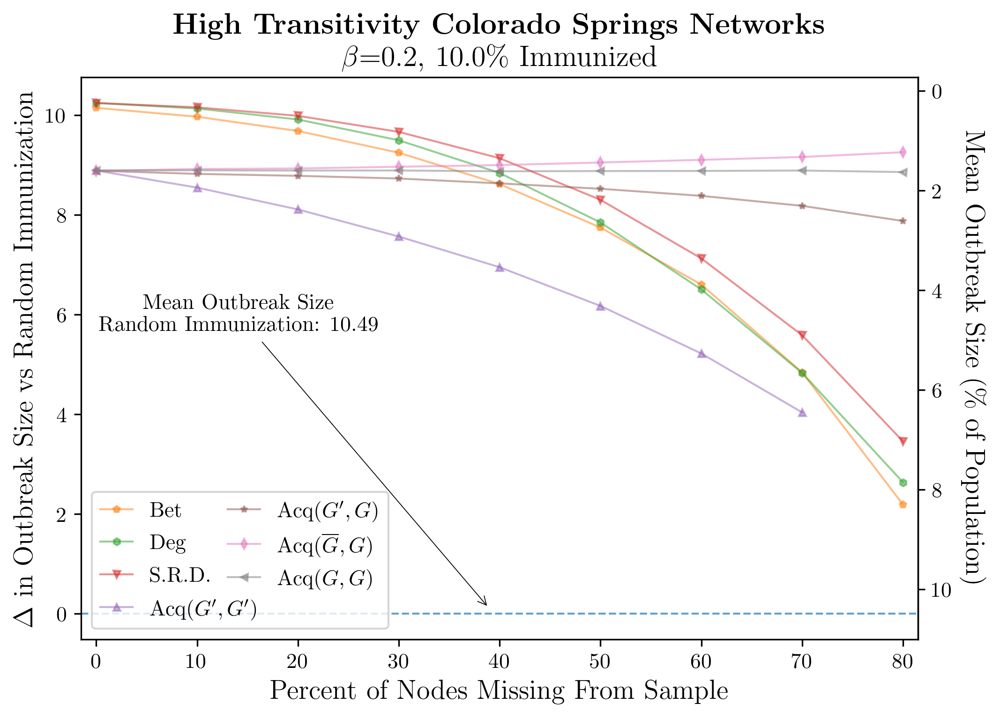

Mean Pct Infected with No Immunization:  35.55
Mean Pct Infected with Random Immunization:  28.23
Mean R0:  3.95
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


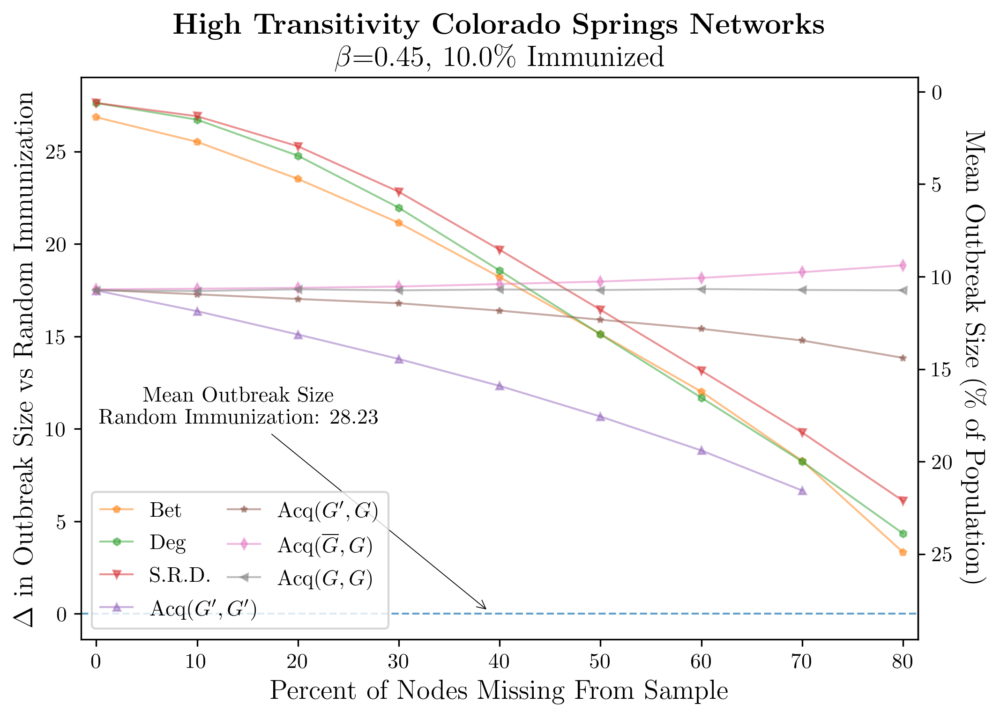

Mean Pct Infected with No Immunization:  46.27
Mean Pct Infected with Random Immunization:  37.87
Mean R0:  4.41
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


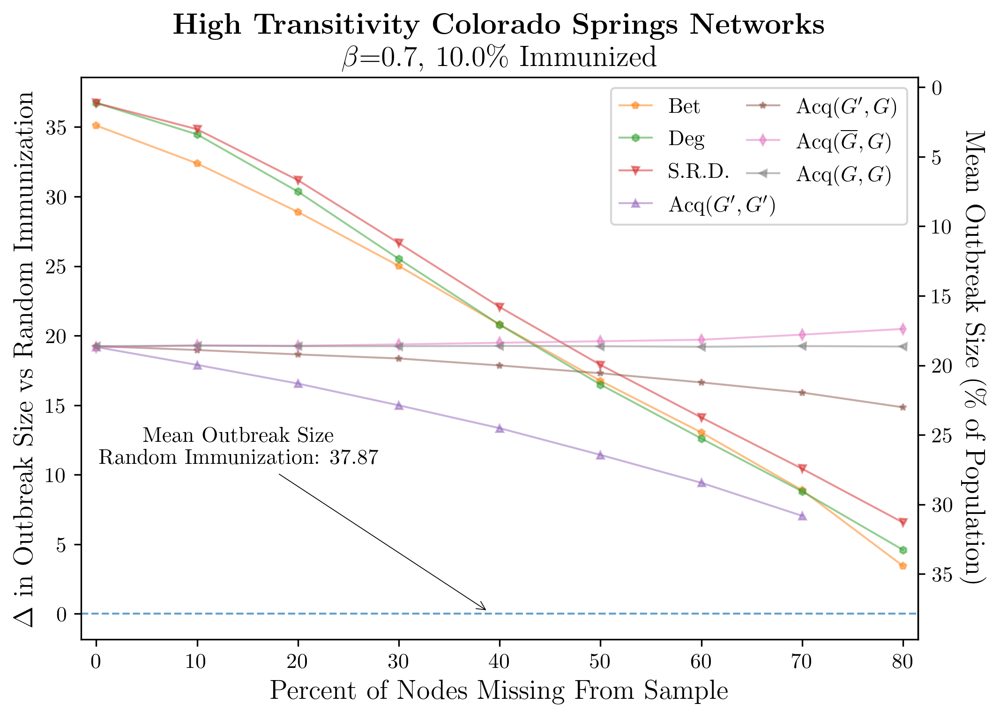

Mean Pct Infected with No Immunization:  52.58
Mean Pct Infected with Random Immunization:  43.65
Mean R0:  4.64
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


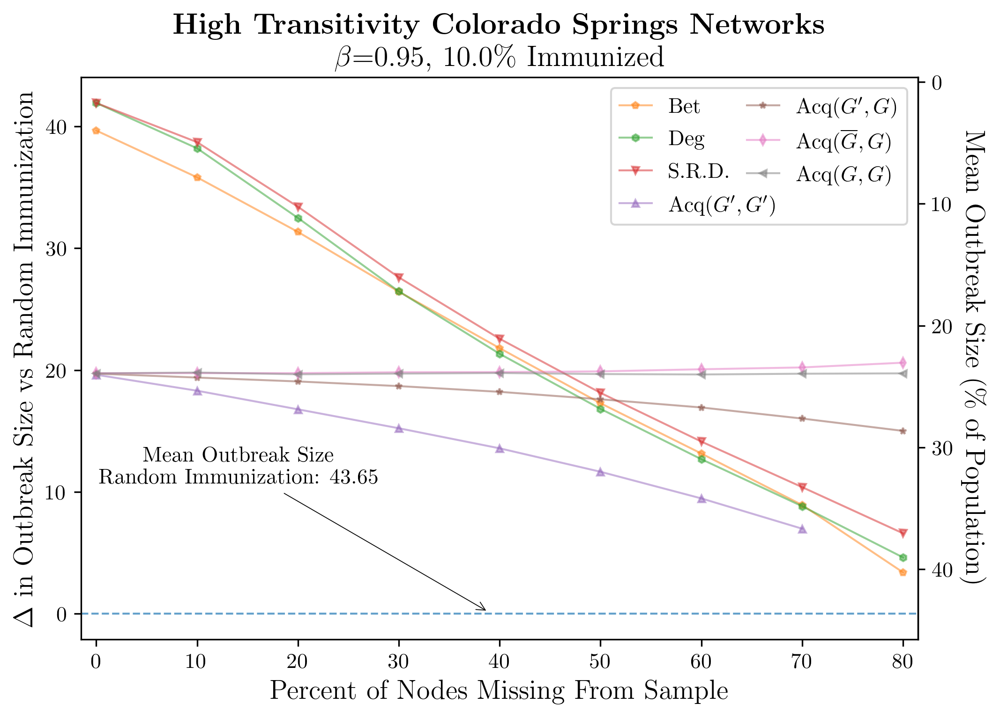

Mean Pct Infected with No Immunization:  56.76
Mean Pct Infected with Random Immunization:  47.49
Mean R0:  4.78
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


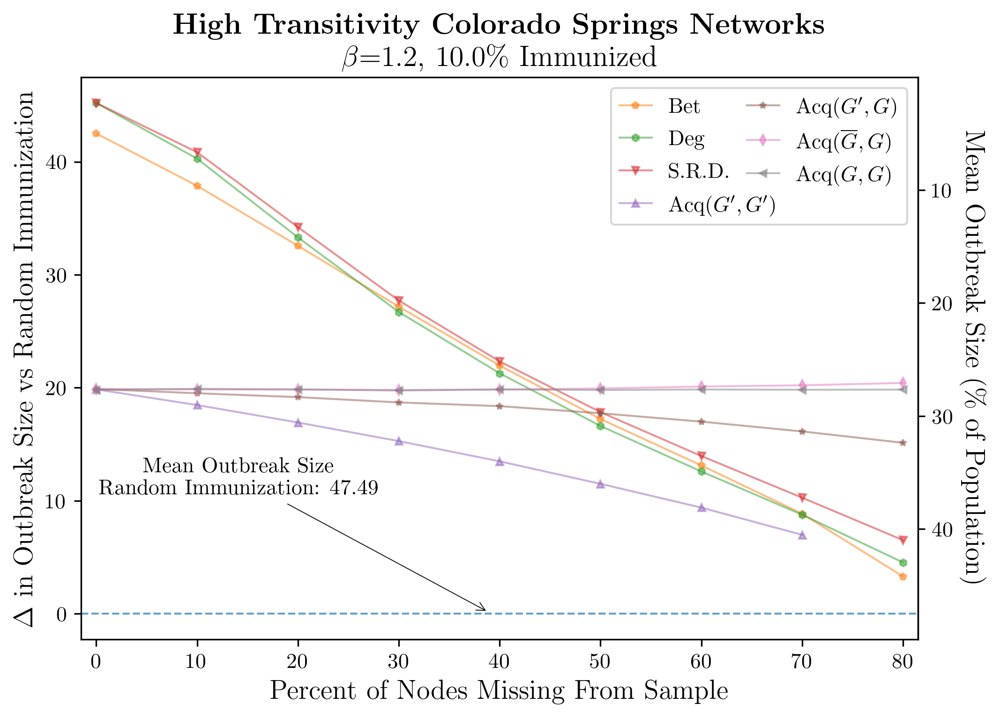

Mean Pct Infected with No Immunization:  59.71
Mean Pct Infected with Random Immunization:  50.24
Mean R0:  4.88
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


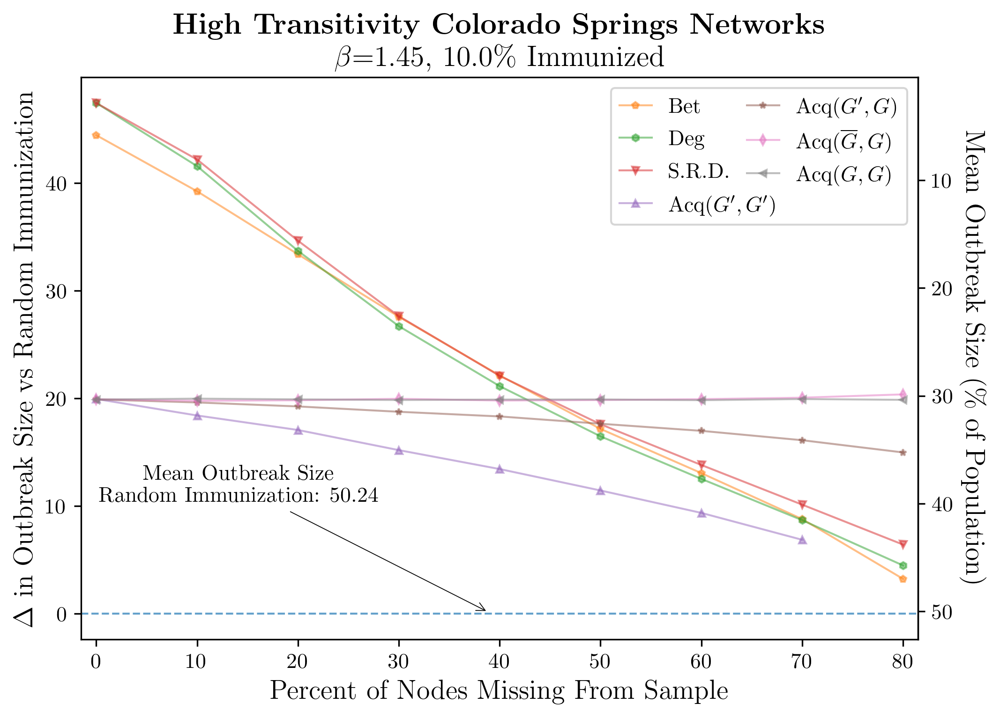

Mean Pct Infected with No Immunization:  61.91
Mean Pct Infected with Random Immunization:  52.28
Mean R0:  4.95
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


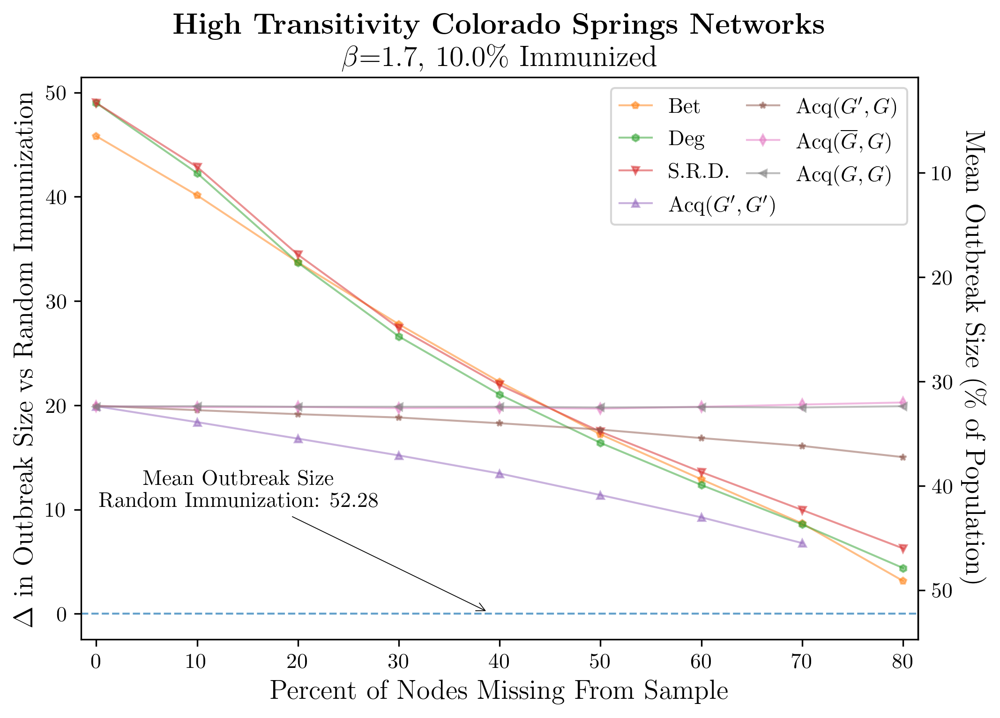

In [184]:

betas = [0.2, 0.45, 0.7, 0.95, 1.2, 1.45, 1.7]
#betas = [  0.95]
# betas = [1.45, 1.7, 1.95, 2.2]
arrowWidth = 0.42
gamma = 1.0
pctImmunized = 0.1
ylims =  None


suptitle = "High Transitivity Colorado Springs Networks"
folder = 'newHighResults_gamma1_beta20to220'
netType = 'high'

for beta in betas:
    
    figFileName = "sweep"+netType+"_Gamma"+pointify(gamma)+"_Beta"+pointify(beta)+"_pctImmunized"+pointify(100*pctImmunized)
    
    
    if  beta < 0.7:
        legendLoc = 'lower left'
    else:
        legendLoc = 'upper right'
    

    makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation(figFileName = figFileName,
                             beta=beta,
                             gamma=gamma,
                             folderName= folder,
                             title='\\textbf{'+suptitle+'}\n $\\beta$='+str(beta)+', '+str(100*pctImmunized)+'\% Immunized',
                             legendLoc=legendLoc,
                             yLims = ylims, 
                             pctImmunized = pctImmunized)


### Section 2.3.4 Add Health Networks

### Supp. Fig. 22

Mean Pct Infected with No Immunization:  11.20
Mean Pct Infected with Random Immunization:  7.97
Mean R0:  1.40
9
9
9
9
9
9
9
Mean Pct Infected with No Immunization:  75.68
Mean Pct Infected with Random Immunization:  70.14
Mean R0:  3.34
9
9
9
9
9
9
9
Mean Pct Infected with No Immunization:  86.23
Mean Pct Infected with Random Immunization:  80.73
Mean R0:  3.84
9
9
9
9
9
9
9
Mean Pct Infected with No Immunization:  11.12
Mean Pct Infected with Random Immunization:  5.32
Mean R0:  1.40
9
9
9
8
9
9
9
Mean Pct Infected with No Immunization:  75.68
Mean Pct Infected with Random Immunization:  64.54
Mean R0:  3.34
9
9
9
8
9
9
9
Mean Pct Infected with No Immunization:  86.23
Mean Pct Infected with Random Immunization:  75.18
Mean R0:  3.84
9
9
9
8
9
9
9
Mean Pct Infected with No Immunization:  11.20
Mean Pct Infected with Random Immunization:  3.32
Mean R0:  1.40
9
9
9
7
9
9
9
Mean Pct Infected with No Immunization:  75.68
Mean Pct Infected with Random Immunization:  58.92
Mean R0:  3.34
9

<function matplotlib.pyplot.show(*args, **kw)>

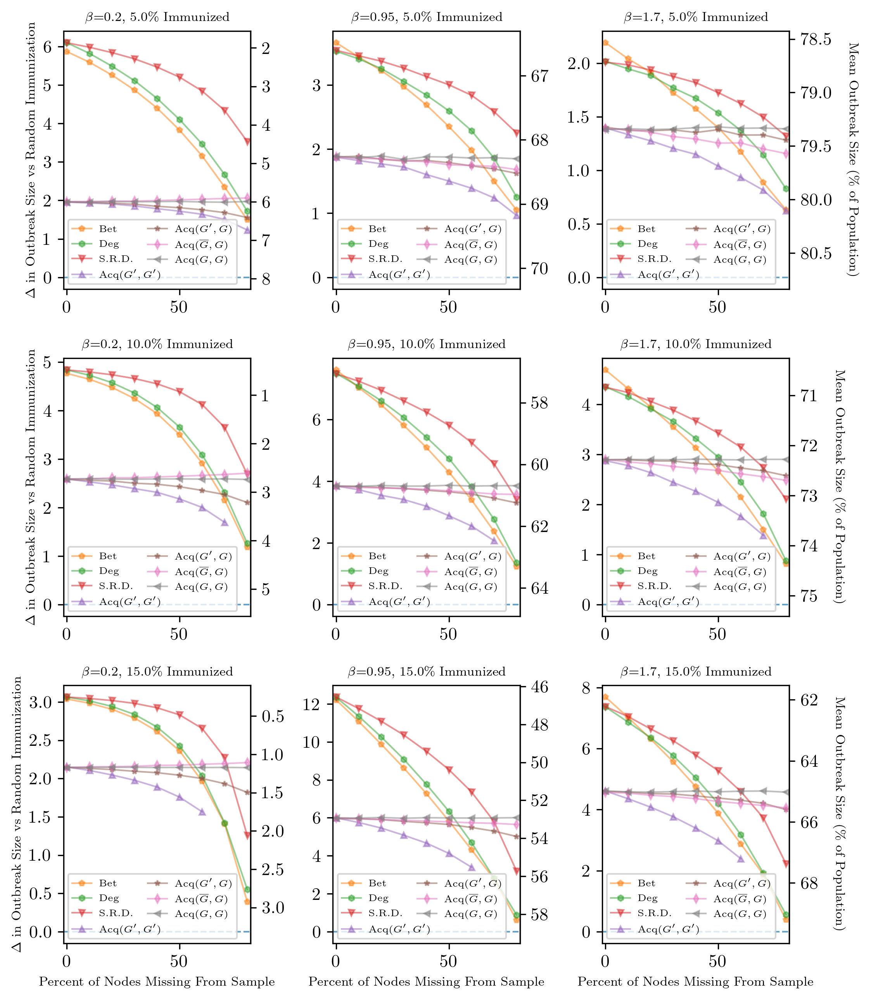

In [186]:
pctsImmunized = [0.05, 0.1, 0.15]
betas = [0.2, 0.95, 1.7]
gamma = 1
folders=['allSchoolResults5and15', 'schoolResults10_gamma1_newCode_beta20to220']


fig, axes = plt.subplots(nrows=len(betas), ncols=len(pctsImmunized), figsize=(7.5, 8.75))

axs = []


plotNum = 1
for p, pctImmunized in enumerate(pctsImmunized):
    for b, beta in enumerate(betas):
        if pctImmunized in {0.05, 0.15}:
            folder = folders[0]
        else:
            folder = folders[1]
        
        subplotNum = plotNum
        if beta == 0.2:
            legendLoc="lower left"
        else:
            legendLoc="lower left"
        plt.subplot(len(pctsImmunized), len(betas), subplotNum)
        #makeMainFigure_subplot(figFileName = figFileName+".tiff", transLevel = transLevel, folderName= 'finalResults'+transLevel, title=transLevel+' Transitivity, ',    pctImmunized = pctImmunized, beta = beta, gamma = gamma, legendLoc=legendLoc)
        #makeMainFigure_subplot( transLevel , folderName ,  pctImmunized , beta , gamma , legendLoc, plotNum, b, g )
        makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation_subplot(figFileName = None,
                         beta=beta,
                         gamma=gamma,
                         folderName= folder,
                         title=r'$\beta$='+str(beta)+", "+str(100*pctImmunized)+"\% Immunized",
                         legendLoc=legendLoc,
                         yLims = None,
                         pctImmunized = pctImmunized)
        
        plotNum +=1

#plt.suptitle('Low Transitivity Colorado Springs Networks:\n', fontsize=15)
fig.tight_layout()

plt.savefig(OUTDIR+'/schoolParamSweep.pdf')
plt.show




### Supp. Fig. 23

Mean Pct Infected with No Immunization:  11.12
Mean Pct Infected with Random Immunization:  5.32
Mean R0:  1.40
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


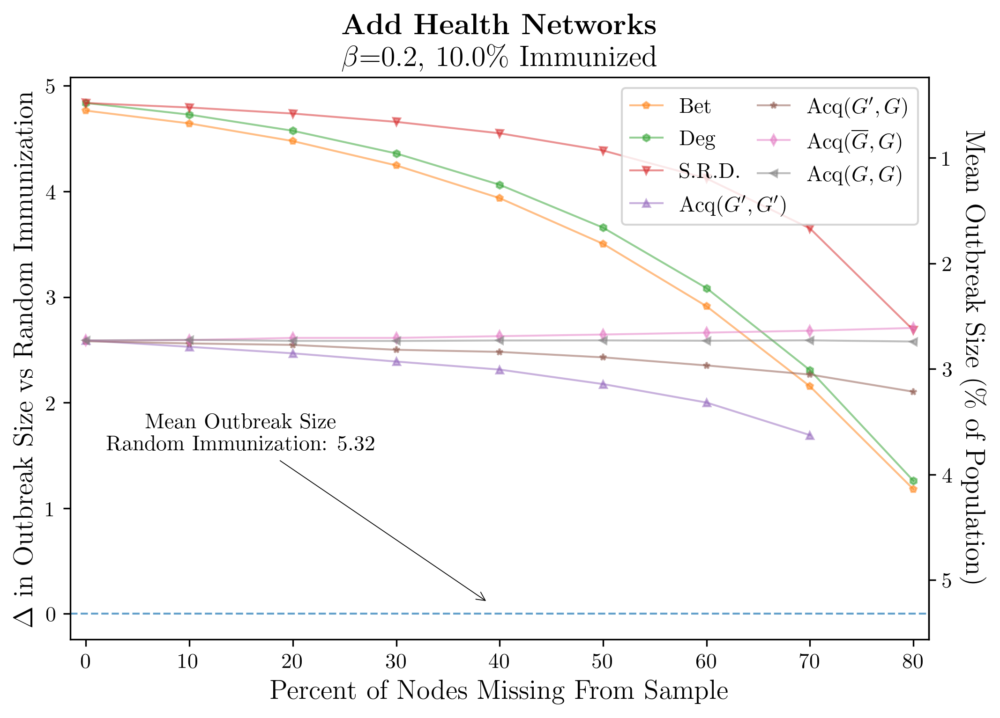

Mean Pct Infected with No Immunization:  51.30
Mean Pct Infected with Random Immunization:  40.48
Mean R0:  2.43
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


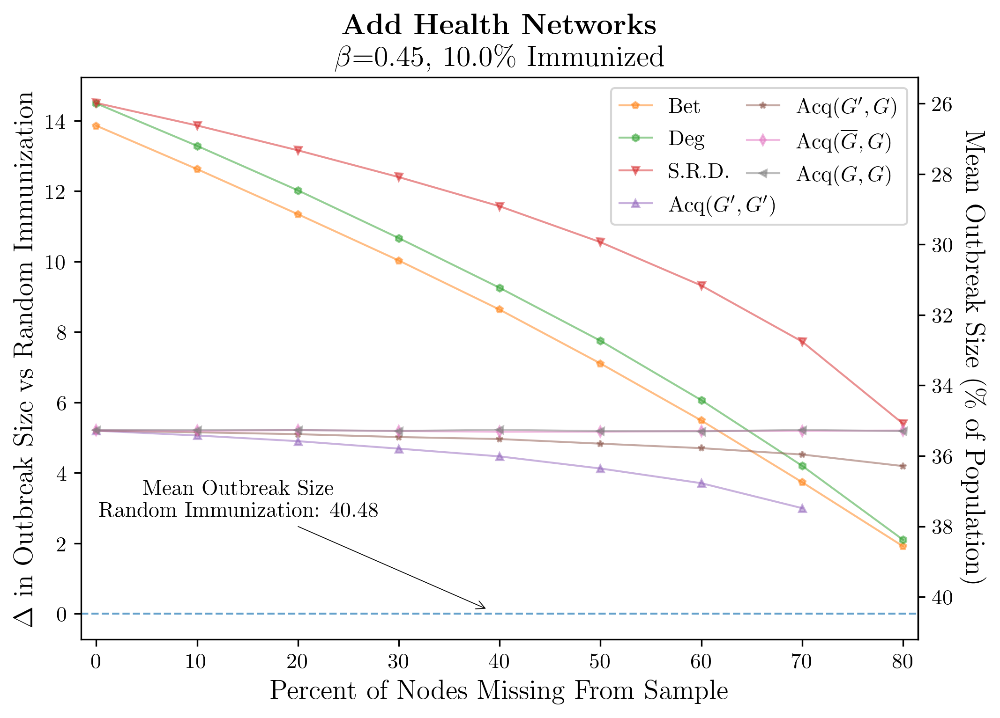

Mean Pct Infected with No Immunization:  67.50
Mean Pct Infected with Random Immunization:  56.33
Mean R0:  3.00
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


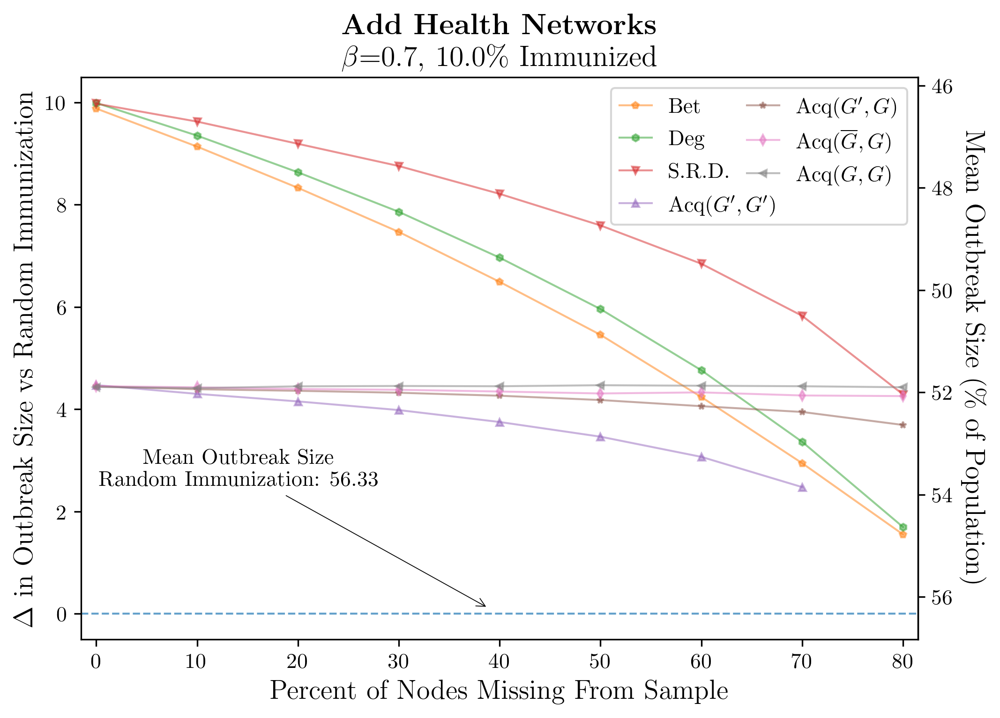

Mean Pct Infected with No Immunization:  75.68
Mean Pct Infected with Random Immunization:  64.54
Mean R0:  3.34
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


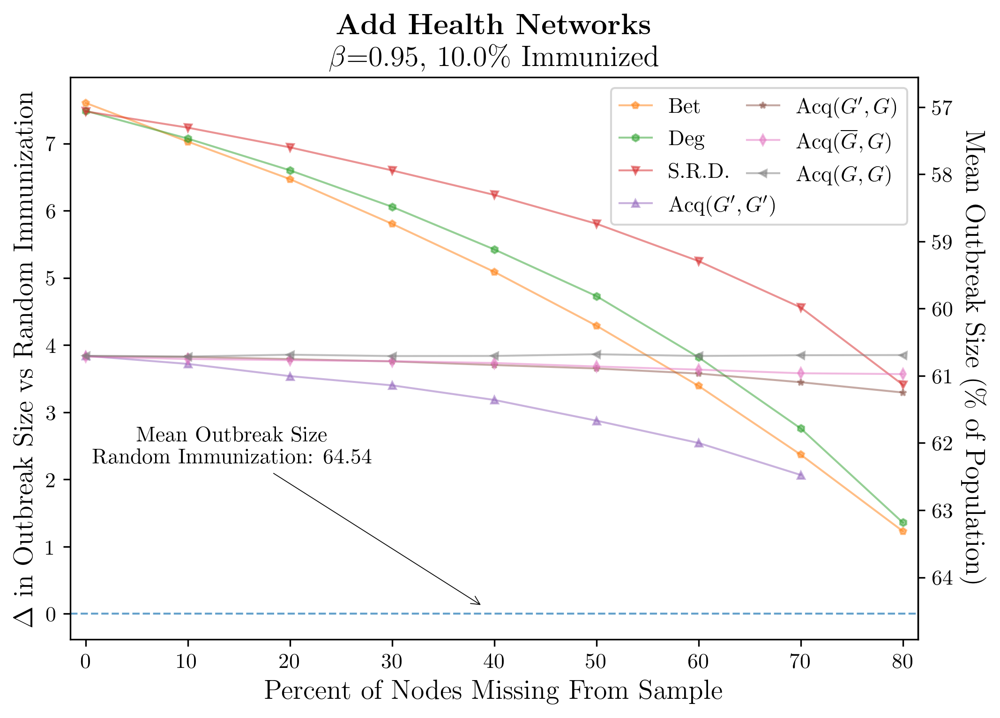

Mean Pct Infected with No Immunization:  80.64
Mean Pct Infected with Random Immunization:  69.51
Mean R0:  3.57
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


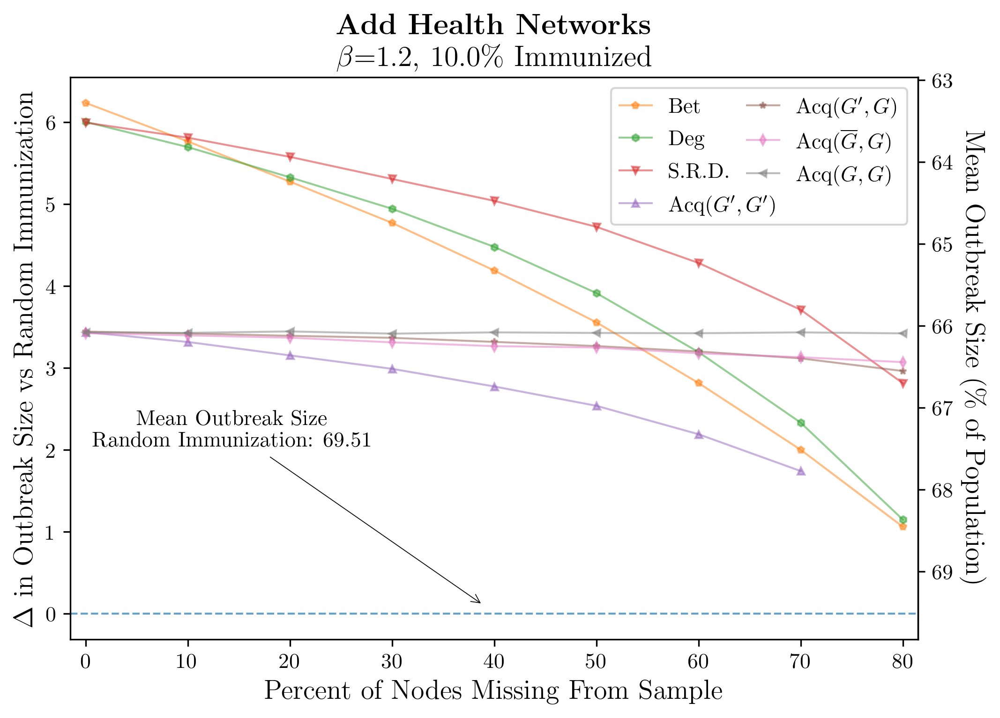

Mean Pct Infected with No Immunization:  83.92
Mean Pct Infected with Random Immunization:  72.83
Mean R0:  3.73
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


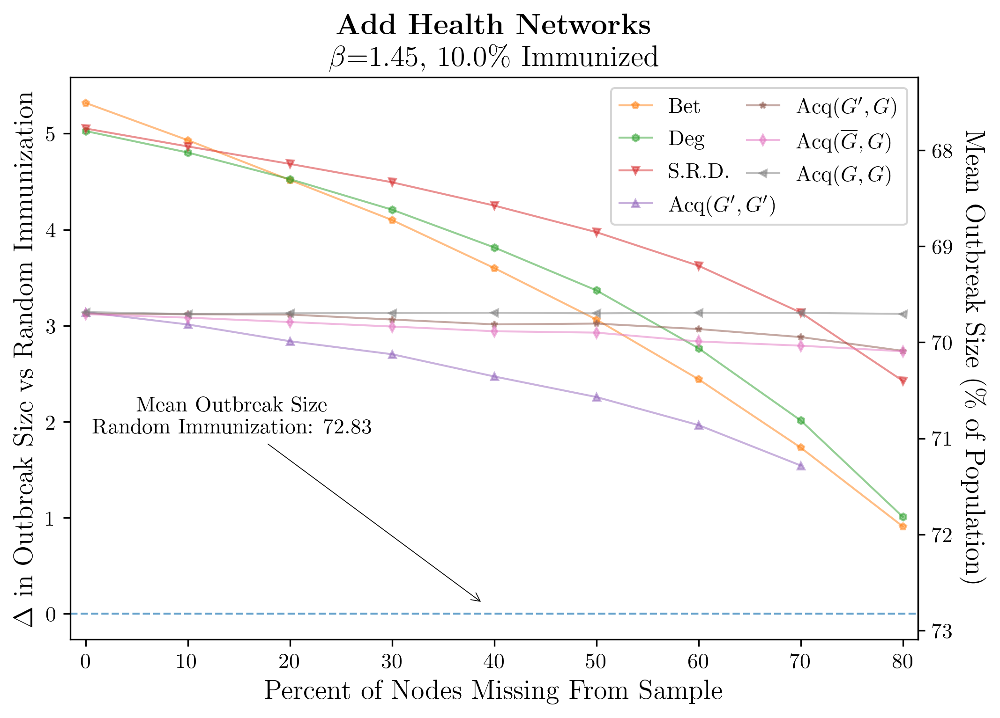

Mean Pct Infected with No Immunization:  86.23
Mean Pct Infected with Random Immunization:  75.18
Mean R0:  3.84
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


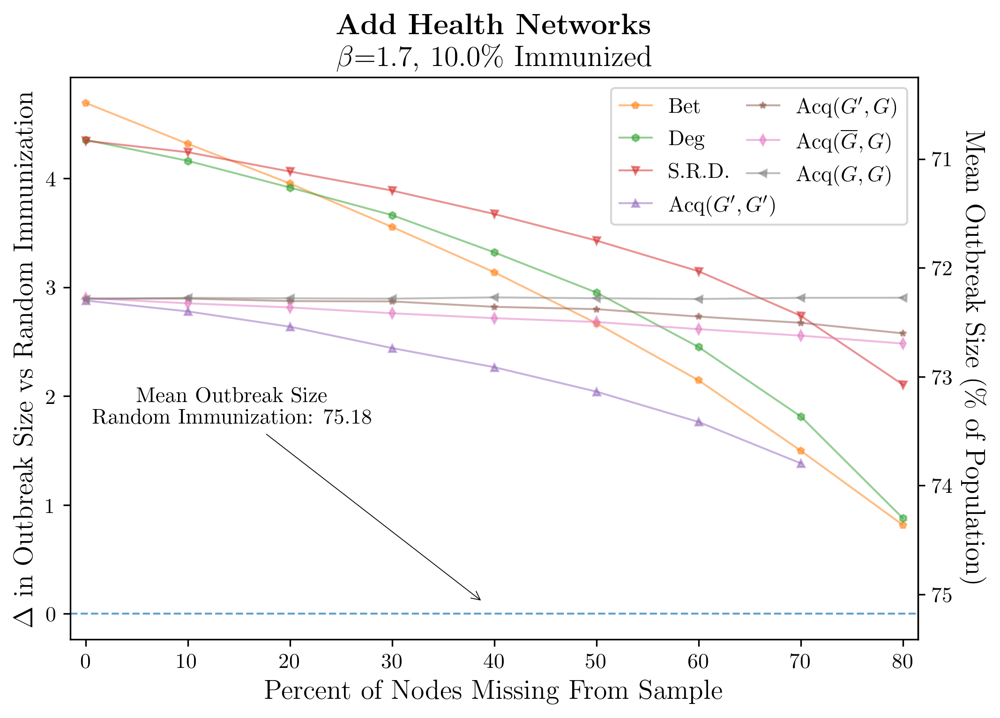

In [188]:

betas = [0.2, 0.45, 0.7, 0.95, 1.2, 1.45, 1.7]
#betas = [  0.95]
# betas = [1.45, 1.7, 1.95, 2.2]
gamma = 1.0
pctImmunized = 0.1
#ylims =  (-0.2, 7.8)
ylims =  None
folder = 'schoolResults10_gamma1_newCode_beta20to220'

for beta in betas:
    netType = 'schoolnet'
    figFileName = "sweep"+netType+"_Gamma"+pointify(gamma)+"_Beta"+pointify(beta)+"_pctImmunized"+pointify(100*pctImmunized)
    
    legendLoc = 'lower right'
    

    makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation(figFileName = figFileName,
                             beta=beta,
                             gamma=gamma,
                             folderName= folder,
                             title='\\textbf{Add Health Networks}\n $\\beta$='+str(beta)+', '+str(100*pctImmunized)+'\% Immunized',
                             legendLoc="upper right",
                             yLims = ylims,
                             pctImmunized = pctImmunized)


# Section 3: Additional Limited Analyses

In [191]:
from matplotlib.transforms import Transform
from matplotlib.ticker import (
    AutoLocator, AutoMinorLocator)

def makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation_flexibleXaxis(figFileName ,  folderName , title,  legendLoc, yLims, beta , gamma, pctImmunized, fracMissingHigh=0.4, text_y='auto',text_x='auto', extension='.pdf' ):

    
    
    all_filenames = [i for i in glob.glob(INDIR+"/"+folderName+'/*Beta={}Gamma={}*pctsImmunized{}.csv'.format(str(beta), str(gamma), str(pctImmunized)))]
    
    obsDF = pd.concat([pd.read_csv(f, usecols = ['strategy', 'fracMissing', 'pctImmunized', 'beta',  'gamma', 'pctTotalPopInf', 'R0_empirical']) for f in all_filenames ], sort=False)

    
    strategies = [ "Bet",   "DegKK",      "Srd" ,      "acqKK2", "acqKG2", "acqKG2_up", "acqGG2"]

    stratNameMap = {'Rand':'Rand', 'RandSamp':'Rand','Bet':'Bet', 'DegKK':"Deg","Srd":"S.R.D.", "acqKK2":"Acq($G^\prime, G^\prime$)", "acqGG2":"Acq($G, G$)", "acqKG2":"Acq($G^\prime,G$)", "acqKG2_up":"Acq($\overline{G},G$)"}

    plt.rcParams['text.usetex'] = True
    plt.rcParams.update({'font.size': 11})

    obsDFmean = obsDF.groupby(['strategy', 'fracMissing', 'pctImmunized', 'beta', 'gamma'], as_index=False).mean()

    randObs =  obsDFmean.loc[(obsDFmean['strategy']=="RandSamp")&(obsDFmean['pctImmunized']==pctImmunized)&(obsDFmean['beta']==beta)&(obsDFmean['gamma']==gamma)]
    randDist = randObs['pctTotalPopInf'].values
    randMean = 100*np.mean(randDist)
    
    noImmObs =  obsDFmean.loc[(obsDFmean['strategy']=="No_imm")&(obsDFmean['pctImmunized']==pctImmunized)&(obsDFmean['beta']==beta)&(obsDFmean['gamma']==gamma)]
    noImmDist = noImmObs['pctTotalPopInf'].values
    noImmMean = 100*np.mean(noImmDist) #Pool these to get a more accurate value for no_immunization
    
    
    R0_emp = float(np.mean(obsDF['R0_empirical'].values))


    
    print("Mean Pct Infected with No Immunization: ", format(noImmMean, '0.2f'))
    print("Mean Pct Infected with Random Immunization: ", format(randMean, '0.2f'))
    print("Mean R0: ",format(R0_emp, '0.2f'))


    for strat in strategies:
            totalTrials = len(obsDF.loc[(obsDF['strategy']==strat)&(obsDF['fracMissing']==fracMissingHigh)&(obsDF['pctImmunized']==pctImmunized)&(obsDF['beta']==beta)&(obsDF['gamma']==gamma)])
            print('trials for strategy '+ strat + 'at highest level of missing data: ' + str(totalTrials))

    
    


    
    
    
    
    fig, ax = plt.subplots(figsize=(7, 5), constrained_layout=True)

    
    minLineAboveText = 9999 #start with a big number
    for i, strat in enumerate(strategies):
        relevantObs = obsDFmean.loc[(obsDFmean['strategy']==strat)&(obsDFmean['pctImmunized']==pctImmunized)&(obsDFmean['beta']==beta)&(obsDFmean['gamma']==gamma)]
        x = list(100*relevantObs['fracMissing'].values)
        pctInf  = list(relevantObs['pctTotalPopInf'].values) #make this a list to make it easy to slice for the next thing

        if strat == "acqKK2" and pctImmunized==0.1:
            x = x[0:8]
            pctInf = pctInf[0:8]
            
        y = [randMean - 100*pctInf[j] for j in range(len(pctInf))]
        
        if y[1] < minLineAboveText:
            minLineAboveText = y[1]

        
        

        lines = ax.plot(x,y,'-o', markersize=3.6, marker=stratMarkerMap[strat], label=stratNameMap[strat], alpha=0.5, linewidth=1, color=stratColorMap[strat])

        
    if text_y == 'auto':
        text_y = 0.75*minLineAboveText  #Put the text between 0 and the first line above it
        
    if text_x == 'auto':
        text_x = 0.29*x[-1]  #Put the text between 0 and the first line above it

    
    
    
    
    
    ax.axhline(0, color=stratColorMap["RandSamp"], ls='--', linewidth=1, alpha=0.69)
    
    info = "Mean Outbreak Size\nRandom  Immunization: "+format(randMean, '0.2f')
    ax.annotate(info,fontsize=11,multialignment='center',
                   xy=(x[-1]/2-1, 0.1),  xycoords='data',
                   xytext=(text_x, text_y), textcoords='data',
                   arrowprops=dict(lw=arrowWidth, arrowstyle="->",connectionstyle="arc3"),
                   horizontalalignment='right', verticalalignment='top', annotation_clip=False
                  )

    
    

        
        
        
        
    plt.title(title, fontsize=15)    
    

    plt.xlim(-0.02*x[-1], x[-1]*1.02)
    
    
    if yLims != None:
        plt.ylim(*yLims)
    
    plt.xlabel(r"Percent of Nodes Missing From Sample",  fontsize=14)
    plt.ylabel('$\Delta$ in Outbreak Size vs Random Immunization',  fontsize=14)

    plt.legend(fancybox=True, ncol=2, loc=legendLoc, columnspacing=-1.42, handlelength=1.5)
    
    
    
    
    
    
    
    def pctReduction2raw(pctReduction):
        return randMean - pctReduction


    def raw2pctReduction(raw):
        return  randMean - raw

    secax = ax.secondary_yaxis('right', functions=(pctReduction2raw, raw2pctReduction))
    locs, labels = secax.get_xticks(minor=True), secax.get_xticklabels(which='minor')           # Get locations and labels
    print("locs:", locs)
    print("labels:", list(labels))

    locs, labels = secax.get_xticks(minor=False), secax.get_xticklabels(which='major')           # Get locations and labels
    print("locs:", locs)
    print("labels:", list(labels))

    
    
    secax.set_ylabel('Mean Outbreak Size (\% of Population)', rotation=270, labelpad=17, fontsize=14)

    
    
    if figFileName != None:
        plt.savefig(OUTDIR+"/"+figFileName+"secondAxis_withAnnotation"+extension, dpi=600, bbox_inches = 'tight', pad_inches = 0)
    plt.show()

### Supp. Fig. 24

Mean Pct Infected with No Immunization:  67.50
Mean Pct Infected with Random Immunization:  12.90
Mean R0:  3.00
trials for strategy Betat highest level of missing data: 5000
trials for strategy DegKKat highest level of missing data: 5000
trials for strategy Srdat highest level of missing data: 5000
trials for strategy acqKK2at highest level of missing data: 5000
trials for strategy acqKG2at highest level of missing data: 5000
trials for strategy acqKG2_upat highest level of missing data: 5000
trials for strategy acqGG2at highest level of missing data: 5000
locs: []
labels: []
locs: []
labels: []


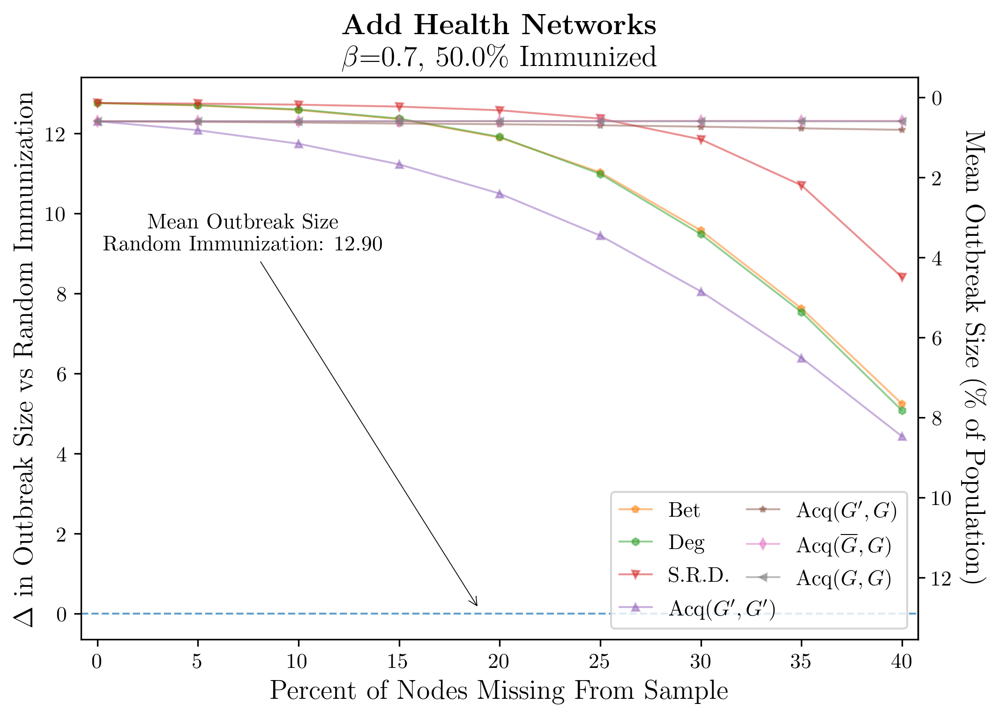

In [195]:
betas = [.7]
gamma = 1.0
pctImmunized = 0.50
ylims =  None
folder = 'schoolResults_imnz50_gamma1_beta070'

for beta in betas:
    netType = 'schoolnet'
    figFileName = netType+"_Gamma"+pointify(gamma)+"_Beta"+pointify(beta)+"_pctImmunized"+pointify(100*pctImmunized)
        

    makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation_flexibleXaxis(figFileName = figFileName,
                             beta=beta,
                             gamma=gamma,
                             folderName= folder,
                             title='\\textbf{Add Health Networks}\n $\\beta$='+str(beta)+', '+str(100*pctImmunized)+'\% Immunized',
                             legendLoc="lower right",
                             yLims = ylims,
                             pctImmunized = pctImmunized, text_x = 14.2, text_y=10, extension='.png' )


Mean Pct Infected with No Immunization:  89.31
Mean Pct Infected with Random Immunization:  32.33
Mean R0:  4.00
trials for strategy Betat highest level of missing data: 5000
trials for strategy DegKKat highest level of missing data: 5000
trials for strategy Srdat highest level of missing data: 5000
trials for strategy acqKK2at highest level of missing data: 5000
trials for strategy acqKG2at highest level of missing data: 5000
trials for strategy acqKG2_upat highest level of missing data: 5000
trials for strategy acqGG2at highest level of missing data: 5000
locs: []
labels: []
locs: []
labels: []


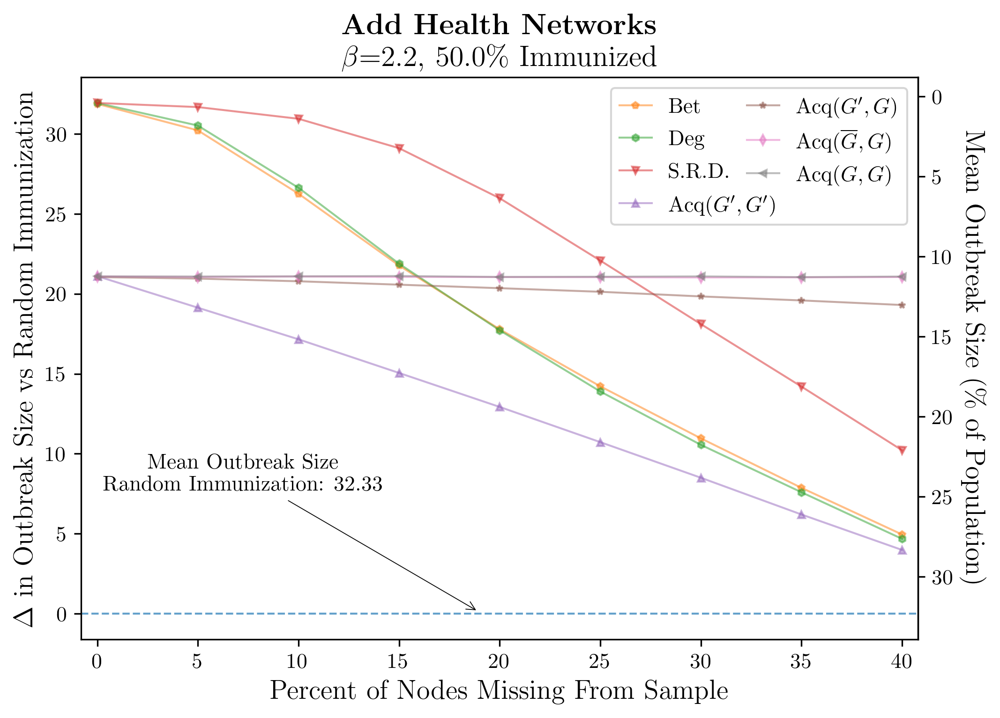

In [194]:
betas = [2.2]
gamma = 1.0
pctImmunized = 0.50
ylims =  None
folder = 'schoolResults_imnz50_gamma1_beta220'

for beta in betas:
    netType = 'schoolnet'
    figFileName = netType+"_Gamma"+pointify(gamma)+"_Beta"+pointify(beta)+"_pctImmunized"+pointify(100*pctImmunized)
        

    makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation_flexibleXaxis(figFileName = figFileName,
                             beta=beta,
                             gamma=gamma,
                             folderName= folder,
                             title='\\textbf{Add Health Networks}\n $\\beta$='+str(beta)+', '+str(100*pctImmunized)+'\% Immunized',
                             legendLoc="upper right",
                             yLims = ylims,
                             pctImmunized = pctImmunized, text_x = 14.2, text_y=10, extension='.png' )


### Supp. Fig. 25: Demonstration that  only relative values matter for beta and gamma

Mean Pct Infected with No Immunization:  58.12
Mean Pct Infected with Random Immunization:  48.67
Mean R0:  4.85
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


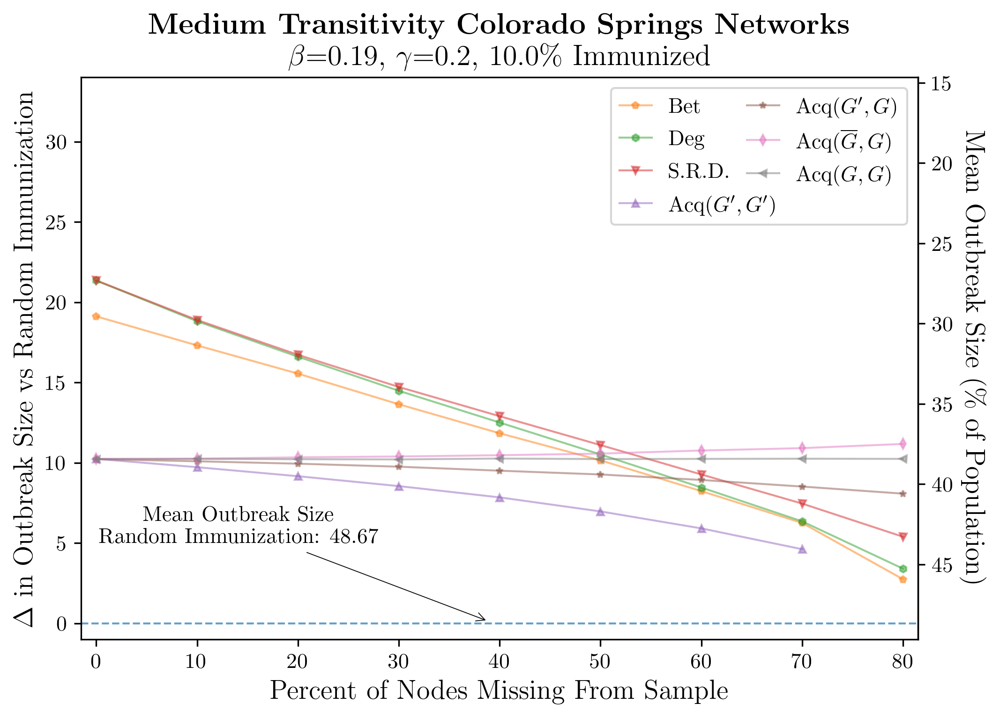

Mean Pct Infected with No Immunization:  58.12
Mean Pct Infected with Random Immunization:  48.66
Mean R0:  4.85
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


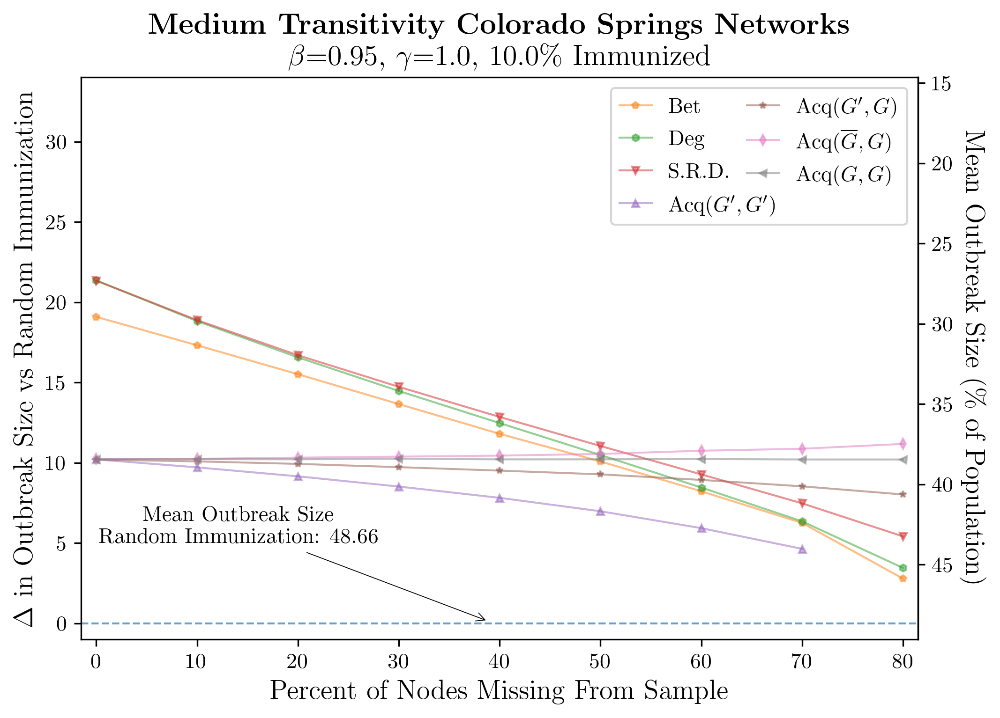

In [197]:

beta = 0.19
gamma = 0.2
legend = "upper right"
ylims=(-1, 34)
arrowWidth = 0.42
suptitle = "Medium Transitivity Colorado Springs Networks"
netType = 'med'







pctImmunized = 0.1
folder = 'newMedResults_gamma02_beta019'

#This is to prevent me from overwriting a file with the same parameters but a different yscale
if ylims == None:
    yscale = 'None'
else:
    yscale = pointify(ylims[1]-ylims[0])

figFileName = netType+"_Gamma"+pointify(gamma)+"_Beta"+pointify(beta)+"_pctImmunized"+pointify(100*pctImmunized)+"_yScale"+yscale

makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation(figFileName = figFileName,
                         beta=beta,
                         gamma=gamma,
                         folderName= folder,
                         title='\\textbf{'+suptitle+'}\n $\\beta$='+str(beta)+', '+'$\gamma$='+str(gamma)+', '+str(100*pctImmunized)+'\% Immunized',
                         legendLoc="upper right",
                         yLims = ylims,
                         pctImmunized = pctImmunized, extension='.pdf')



beta = 0.95
gamma = 1.0
pctImmunized = 0.1
folder = 'newMedResults_gamma1_beta20to220'



figFileName = netType+"_Gamma"+pointify(gamma)+"_Beta"+pointify(beta)+"_pctImmunized"+pointify(100*pctImmunized)+"_yScale"+yscale

makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation(figFileName = figFileName,
                         beta=beta,
                         gamma=gamma,
                         folderName= folder,
                         title='\\textbf{'+suptitle+'}\n $\\beta$='+str(beta)+', '+'$\gamma$='+str(gamma)+', '+str(100*pctImmunized)+'\% Immunized',
                         legendLoc="upper right",
                         yLims = ylims,
                         pctImmunized = pctImmunized, extension='.pdf')



### Supp. Fig. 26 Imperfect Immunization

Mean Pct Infected with No Immunization:  58.13
Mean Pct Infected with Random Immunization:  43.35
Mean R0:  4.85
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


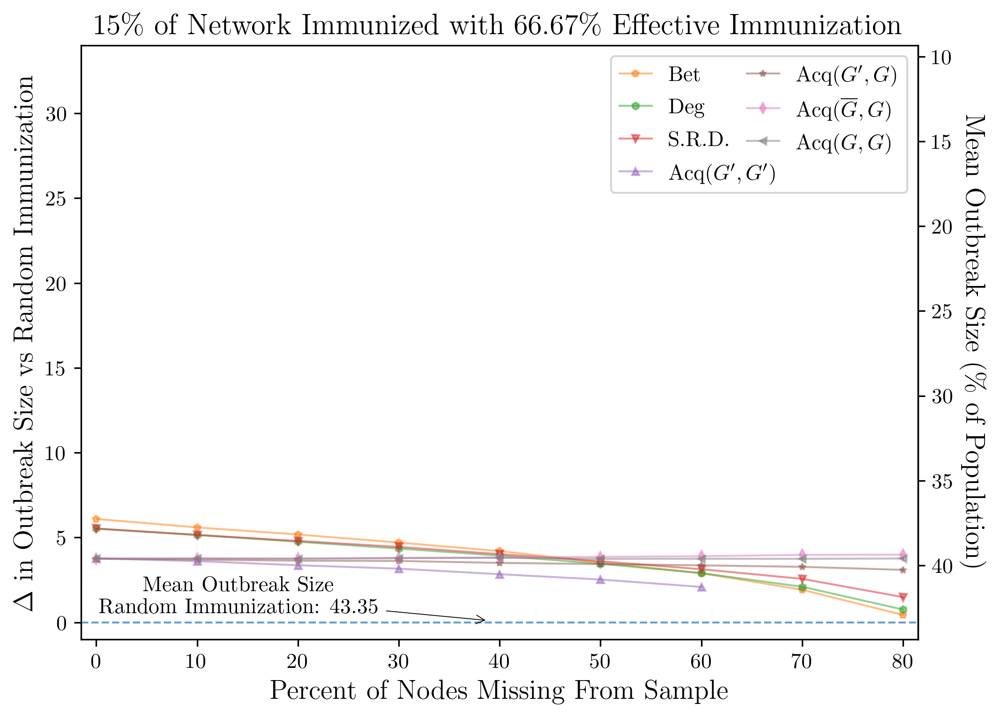

Mean Pct Infected with No Immunization:  58.12
Mean Pct Infected with Random Immunization:  48.66
Mean R0:  4.85
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


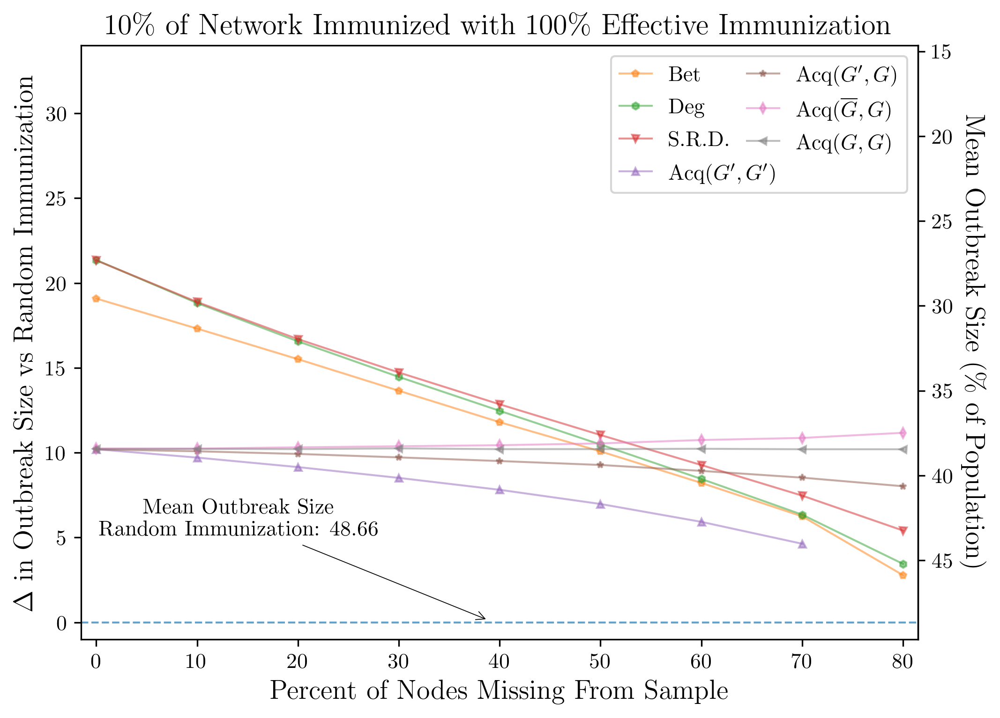

Mean Pct Infected with No Immunization:  58.13
Mean Pct Infected with Random Immunization:  44.04
Mean R0:  4.85
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


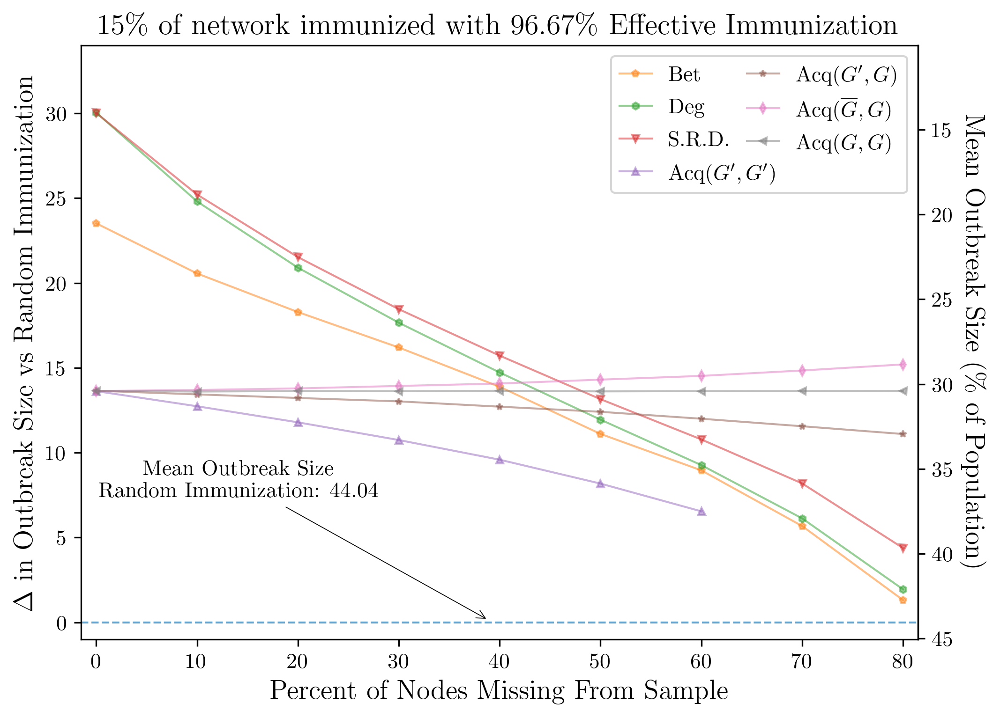

Mean Pct Infected with No Immunization:  58.13
Mean Pct Infected with Random Immunization:  44.09
Mean R0:  4.85
trials for strategy  Bet :  5000
trials for strategy  DegKK :  5000
trials for strategy  Srd :  5000
trials for strategy  acqKK2 :  5000
trials for strategy  acqKG2 :  5000
trials for strategy  acqKG2_up :  5000
trials for strategy  acqGG2 :  5000


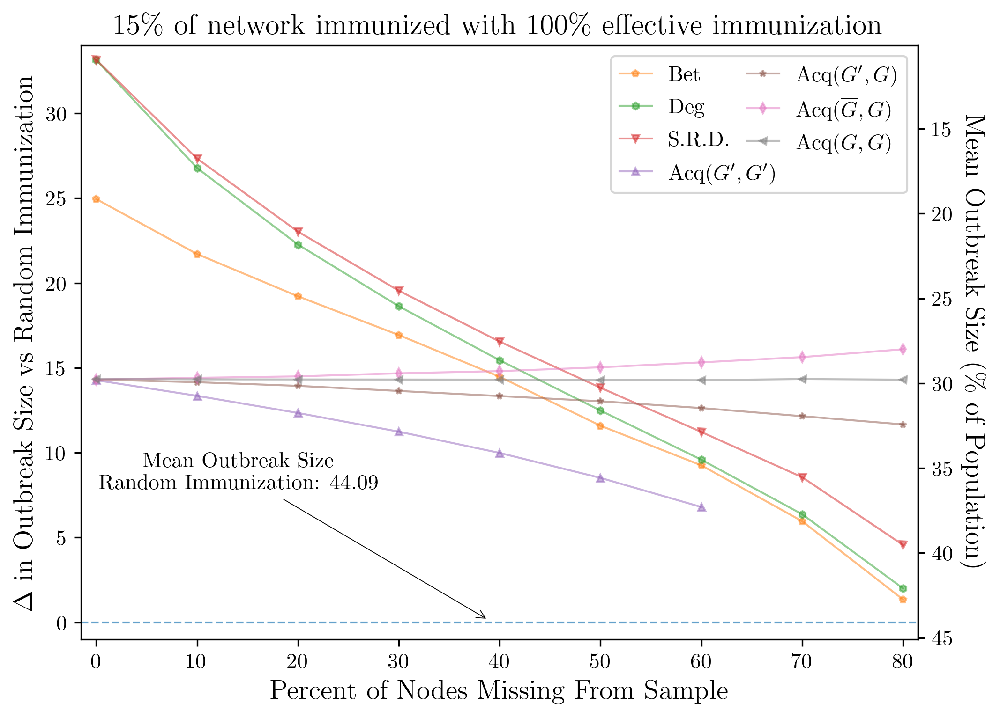

In [196]:

beta = 0.95
gamma = 1.0
legend = "upper right"
ylims=(-1, 34)
arrowWidth = 0.42
suptitle = "Medium Transitivity Colorado Springs Networks"
netType = 'med'







pctImmunized = 0.15
folder = 'imperfectImm067_med_tryimnz_15_beta095_Results'


figFileName = folder

makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation(figFileName = figFileName,
                         beta=beta,
                         gamma=gamma,
                         folderName= folder,
                         title='15\% of Network Immunized with 66.67\% Effective Immunization',
                         legendLoc="upper right",
                         yLims = ylims,
                         pctImmunized = pctImmunized)



pctImmunized = 0.10
folder = 'newMedResults_gamma1_beta20to220'


figFileName = netType+"_Gamma"+pointify(gamma)+"_Beta"+pointify(beta)+"_pctImmunized"+pointify(100*pctImmunized)

makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation(figFileName = figFileName,
                         beta=beta,
                         gamma=gamma,
                         folderName= folder,
                         title='10\% of Network Immunized with 100\% Effective Immunization',
                         legendLoc="upper right",
                         yLims = ylims,
                         pctImmunized = pctImmunized)



pctImmunized = 0.15
folder = 'imperfectImm09667_med_tryimnz_15_beta095_Fixed_results'


figFileName = folder

makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation(figFileName = figFileName,
                         beta=beta,
                         gamma=gamma,
                         folderName= folder,
                         title='15\% of network immunized with 96.67\% Effective Immunization',
                         legendLoc="upper right",
                         yLims = ylims,
                         pctImmunized = pctImmunized)



pctImmunized = 0.15
folder = 'allMedResults5and15'



figFileName = netType+"_Gamma"+pointify(gamma)+"_Beta"+pointify(beta)+"_pctImmunized"+pointify(100*pctImmunized)

makeMainFigure_pctReduction_vsRandom_secondAxis_withAnnotation(figFileName = figFileName,
                         beta=beta,
                         gamma=gamma,
                         folderName= folder,
                         title='15\% of network immunized with 100\% effective immunization',
                         legendLoc="upper right",
                         yLims = ylims,
                         pctImmunized = pctImmunized)



